# Data Preprocessing

In [54]:
import pandas as pd

# Load the parquet file into a pandas DataFrame
file_path = "/home/bathsheba/Downloads/stock_sample_data.parquet"
df = pd.read_parquet(file_path)  # Use file_path instead of 'data.parquet'


output_file_path = "/home/bathsheba/Downloads/stock_sample_data.xlsx"
df.to_csv(output_file_path, sep='\t', index=False)  # Save as tab-separated values

print(f"Data saved to {output_file_path}")

Data saved to /home/bathsheba/Downloads/stock_sample_data.xlsx


# Assignment

In [30]:
import pandas as pd

# Load the dataset (make sure to specify the correct file path)
file_path = "/home/bathsheba/Downloads/stock_sample_data.xlsx" # Adjust this to your file location
data = pd.read_csv(file_path, sep='\t', header=None)

# Assign appropriate column names
data.columns = ['date', 'open', 'high', 'low', 'close', 'volume', 'context_id', 'day']


/tmp/ipykernel_17033/2070849963.py:5: DtypeWarning: Columns (1,2,3,4,5,7) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv(file_path, sep='\t', header=None)


# Check and remove null and missiing values

In [31]:
# Display the entire dataset
print("Full dataset:")
print(data)

# Get basic information about the dataset
print("Dataset Info:")
print(data.info())

# Check for missing values
print("Missing Values:")
print(data.isnull().sum())


Full dataset:
               date                open                high  \
0              date                open                high   
1        2000-01-03   56.33047103881836   56.46459197998047   
2        2000-01-03  0.9363840222358704   1.004464030265808   
3        2000-01-03  15.823756217956543  16.160432815551758   
4        2000-01-03  1.4097219705581665  1.4166669845581055   
...             ...                 ...                 ...   
2770136  2024-10-15          137.630005          138.469894   
2770137  2024-10-15          134.210007          134.669998   
2770138  2024-10-15          103.510002          105.970001   
2770139  2024-10-15           376.73999          380.034393   
2770140  2024-10-15          192.279999          195.809998   

                        low               close     volume  context_id  day  
0                       low               close     volume  context_id  day  
1            48.19384765625  43.463035583496094    4674353           A   

# Convert columns into Numerics
- Having data stored as "object" means the data is likely in a non-numeric format, which can hinder analysis. Converting these columns to their appropriate types can enhance performance and allow for more straightforward data analysis. 

-  If you encounter a column as an object type, it's usually a sign to check the data for consistency and apply necessary conversions for effective analysis.



In [32]:
import pandas as pd

# Load the dataset (make sure to specify the correct file path)
file_path = "/home/bathsheba/Downloads/stock_sample_data.xlsx"  # Adjust this to your file location
data = pd.read_csv(file_path, sep='\t')  # Use the appropriate separator

# Assign column names
data.columns = ['date', 'open', 'high', 'low', 'close', 'volume', 'context_id', 'day']

# Convert relevant columns to numeric, handling non-numeric values
data['open'] = pd.to_numeric(data['open'], errors='coerce')
data['high'] = pd.to_numeric(data['high'], errors='coerce')
data['low'] = pd.to_numeric(data['low'], errors='coerce')
data['close'] = pd.to_numeric(data['close'], errors='coerce')
data['volume'] = pd.to_numeric(data['volume'], errors='coerce')

# Display all rows of the dataset
print("All rows of the dataset:")
display(data)  # Display the entire DataFrame

# Get basic information about the dataset
print("\nBasic information about the dataset:")
df_info = data.info()  # Get information about the DataFrame
display(pd.DataFrame(df_info))  # Convert info to DataFrame and display

# Check for missing values
print("\nMissing values in the dataset:")
df_missing = data.isnull().sum()  # Check for missing values
display(pd.DataFrame(df_missing, columns=['Missing Values']))


All rows of the dataset:


,date,open,high,low,close,volume,context_id,day
0,2000-01-03,56.330471,56.464592,48.193848,43.463036,4674353,A,0
1,2000-01-03,0.936384,1.004464,0.907924,0.844004,535796800,AAPL,0
2,2000-01-03,15.823756,16.160433,15.599306,8.327244,10635087,ABT,0
3,2000-01-03,1.409722,1.416667,1.263889,1.277778,433800,ACGL,0
4,2000-01-03,16.812500,16.875000,16.062500,16.274672,7384400,ADBE,0
...,...,...,...,...,...,...,...,...
2770135,2024-10-15,137.630005,138.469894,137.210007,137.785004,347338,XYL,1
2770136,2024-10-15,134.210007,134.669998,132.723999,133.779999,513843,YUM,1
2770137,2024-10-15,103.510002,105.970001,103.785004,105.294998,436167,ZBH,1
2770138,2024-10-15,376.739990,380.034393,374.040009,374.859985,143956,ZBRA,1



Basic information about the dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2770140 entries, 0 to 2770139
Data columns (total 8 columns):
 #   Column      Dtype  
---  ------      -----  
 0   date        object 
 1   open        float64
 2   high        float64
 3   low         float64
 4   close       float64
 5   volume      int64  
 6   context_id  object 
 7   day         int64  
dtypes: float64(4), int64(2), object(2)
memory usage: 169.1+ MB


""



Missing values in the dataset:


,Missing Values
date,0
open,0
high,0
low,0
close,0
volume,0
context_id,0
day,0


# Performing exploratory data analysis (EDA) 

- To understand distributions and relationships.
- Applying statistical models or machine learning algorithms for tasks like portfolio optimization.

# 1. Descriptive statistics for numerical columns

In [33]:

print(data.describe())


               open          high           low         close        volume  \
count  2.770140e+06  2.770140e+06  2.770140e+06  2.770140e+06  2.770140e+06   
mean   7.896540e+01  7.987578e+01  7.803579e+01  6.975346e+01  8.063554e+06   
std    1.772316e+02  1.793211e+02  1.752055e+02  1.743742e+02  4.729731e+07   
min    3.020800e-02  3.052100e-02  2.697900e-02  3.052100e-02  0.000000e+00   
25%    2.331474e+01  2.363000e+01  2.298500e+01  1.647646e+01  9.325000e+05   
50%    4.384000e+01  4.434167e+01  4.330993e+01  3.344446e+01  2.138809e+06   
75%    8.250000e+01  8.336308e+01  8.161000e+01  7.118000e+01  5.065600e+06   
max    9.839980e+03  9.912560e+03  9.791000e+03  9.892300e+03  9.230856e+09   

                day  
count  2.770140e+06  
mean   2.023398e+00  
std    1.399191e+00  
min    0.000000e+00  
25%    1.000000e+00  
50%    2.000000e+00  
75%    3.000000e+00  
max    4.000000e+00  


# 2. Stock Closing Prices Over Time

- Purpose: To illustrates how the closing prices of stocks evolve over time.

- Trend Identification: It helps identify long-term trends in stock prices, such as increasing or decreasing   
  patterns, which can be vital for making investment decisions.

- Seasonality: Observing seasonal trends can indicate specific times of the year when stock prices tend to rise or fall.

- Volatility: Variability in the price movements can signal the risk associated with the stock.

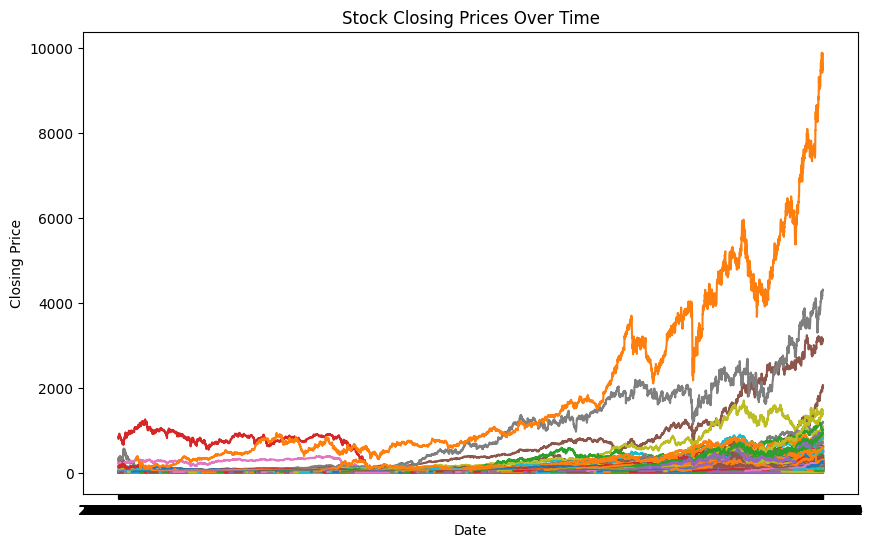

In [34]:
import matplotlib.pyplot as plt

# Plotting the closing prices of the stocks
plt.figure(figsize=(10, 6))
for ticker in data['context_id'].unique():
    subset = data[data['context_id'] == ticker]
    plt.plot(subset['date'], subset['close'], label=ticker)

plt.title('Stock Closing Prices Over Time')
plt.xlabel('Date')
plt.ylabel('Closing Price')
#plt.legend()
plt.show()


# 3.  Daily Returns Calculation

In [1]:
# Calculate daily returns using the close prices
data['Return'] = data.groupby('context_id')['close'].pct_change()

# Visualizing the daily returns
plt.figure(figsize=(10, 6))

for context_id in data['context_id'].unique():
    subset = data[data['context_id'] == context_id]
    plt.plot(subset['date'], subset['Return'], label=context_id)

plt.title('Daily Returns Over Time', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Return', fontsize=14)
plt.legend(title="Stock", bbox_to_anchor=(1.05, 1), loc='upper left')
#plt.legend(loc='best')
plt.show()


NameError: name 'data' is not defined

# 4.  Stock Closing Prices Over Time

/tmp/ipykernel_17033/418374007.py:18: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()  # Adjust layout to make room for the legend


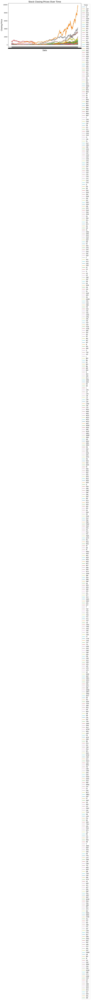

In [36]:
import matplotlib.pyplot as plt

# Create a dictionary to abbreviate the ticker names if necessary
ticker_abbr = {ticker: ticker[:3] for ticker in data['context_id'].unique()}  # Keeping only the first 3 characters for brevity

# Plotting the closing prices of the stocks
plt.figure(figsize=(10, 6))
for ticker in data['context_id'].unique():
    subset = data[data['context_id'] == ticker]
    plt.plot(subset['date'], subset['close'], label=ticker_abbr[ticker])  # Use abbreviated ticker

plt.title('Stock Closing Prices Over Time', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Closing Price', fontsize=14)

# Rotate and format legend for better readability
plt.legend(title='Ticker', loc='upper left', bbox_to_anchor=(1, 1), fontsize=10)
plt.tight_layout()  # Adjust layout to make room for the legend
plt.show()


In [37]:
# Install Seaborn if not already installed
!pip install seaborn

# 5. Correlation Matrix
 - The correlations between the numerical columns, indicating how closely related they are.

- Purpose: A heatmap visually represents the correlation between various numeric features in the dataset.

- Feature Relationships: It provides insights into how different features relate to each other. For instance, a strong positive correlation between 'high' and 'close' prices may indicate that when a stock reaches a higher price, it tends to close higher as well.

- Feature Selection: Understanding correlations helps in feature selection for modeling, as highly correlated features can lead to redundancy and multicollinearity issues in predictive models.

open      float64
high      float64
low       float64
close     float64
volume      int64
dtype: object


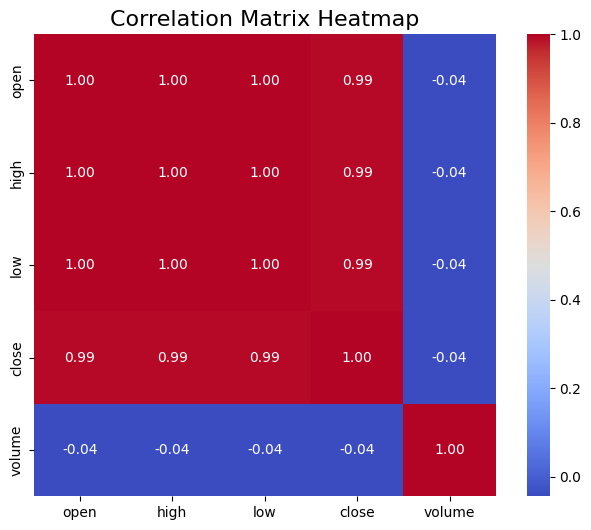

In [38]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'data' is your DataFrame and has already been loaded

# Convert relevant columns to numeric
columns_to_convert = ['open', 'high', 'low', 'close', 'volume']
for col in columns_to_convert:
    data[col] = pd.to_numeric(data[col], errors='coerce')  # Convert to numeric, set invalid parsing as NaN

# Check data types to confirm conversion
print(data[columns_to_convert].dtypes)

# Now calculate the correlation matrix
correlation_matrix = data[columns_to_convert].corr()

# Heatmap of the correlation matrix
plt.figure(figsize=(8, 6))
plt.title('Correlation Matrix Heatmap', fontsize=16)
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True)
plt.show()


# Correlation for the various Tickers

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


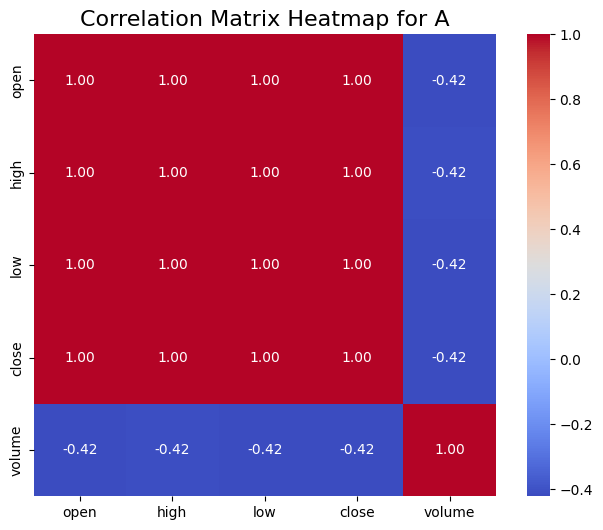

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


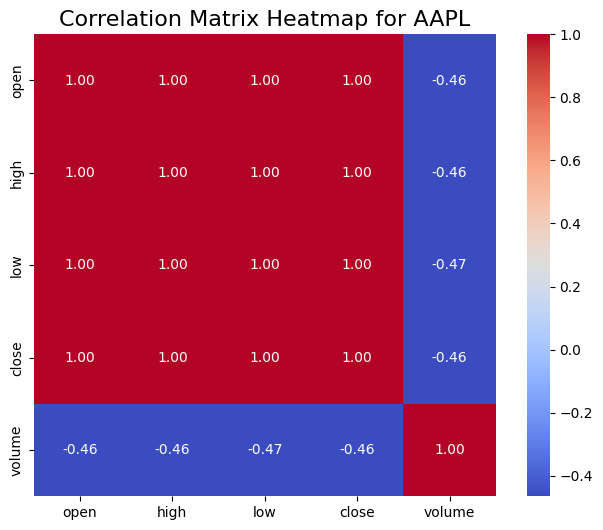

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


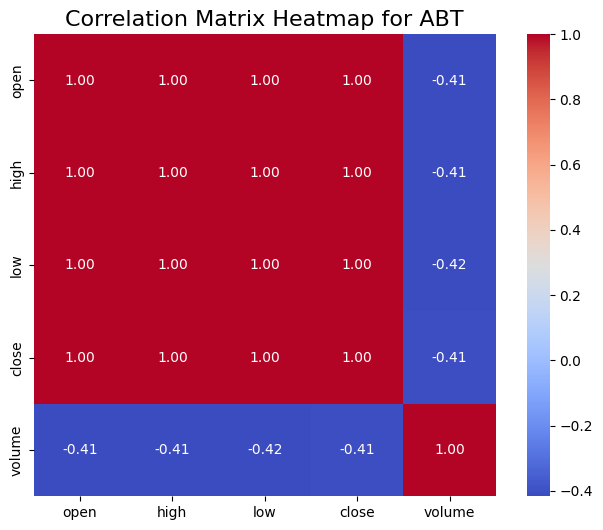

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


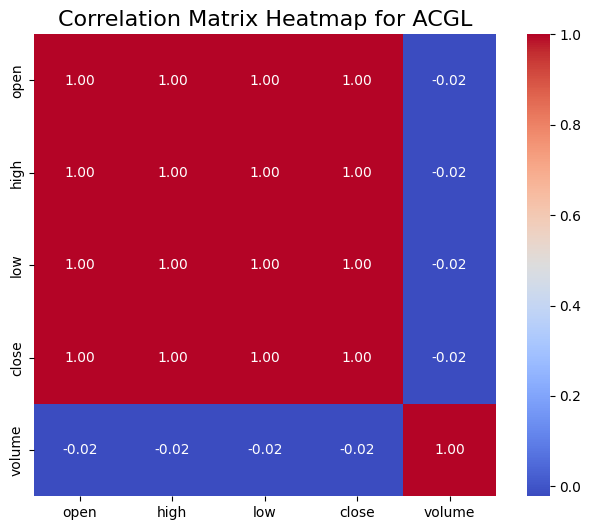

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


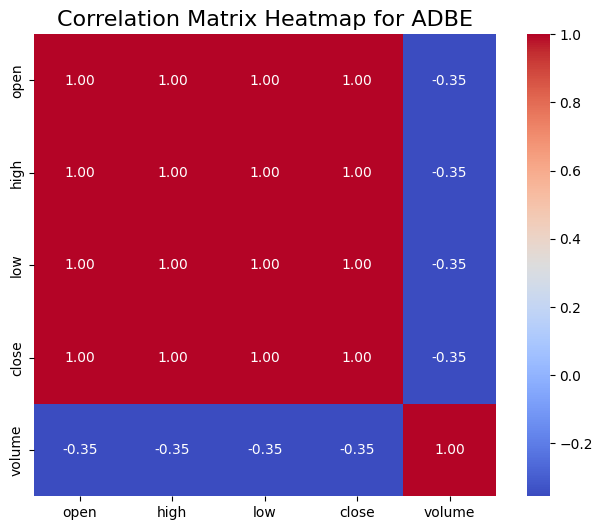

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


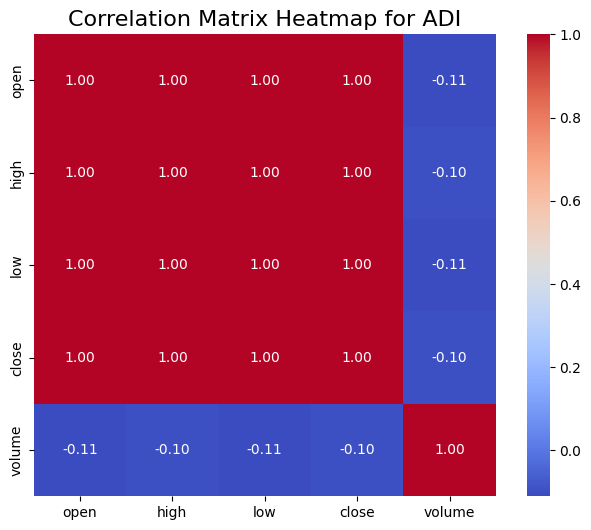

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


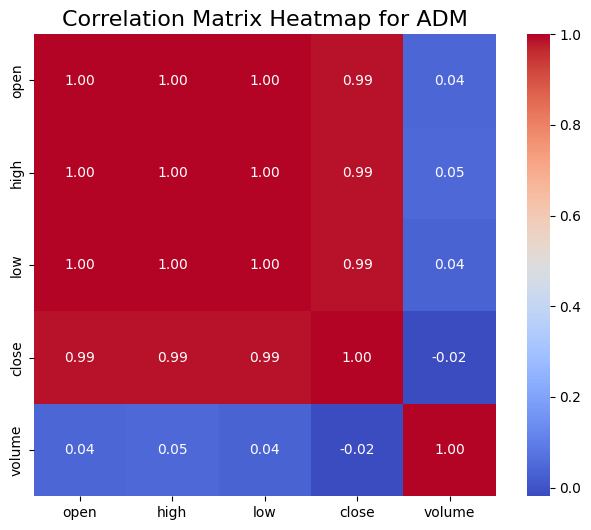

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


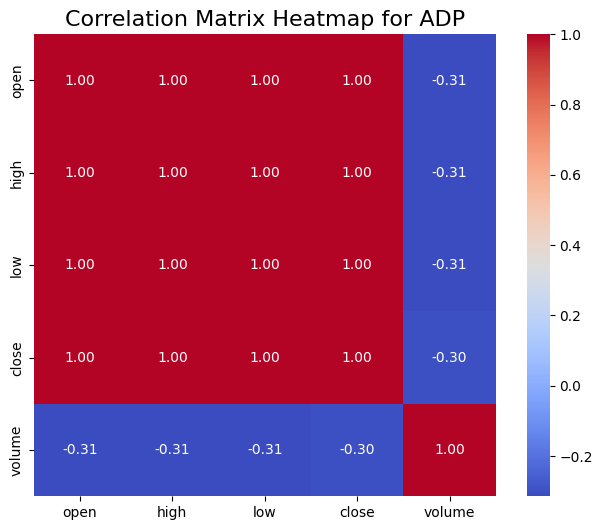

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


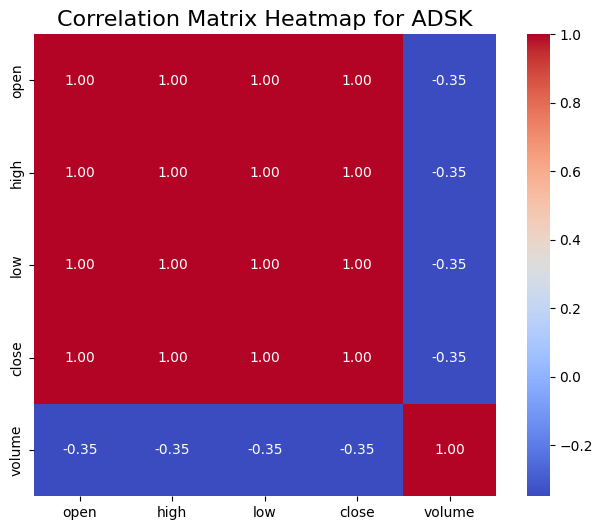

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


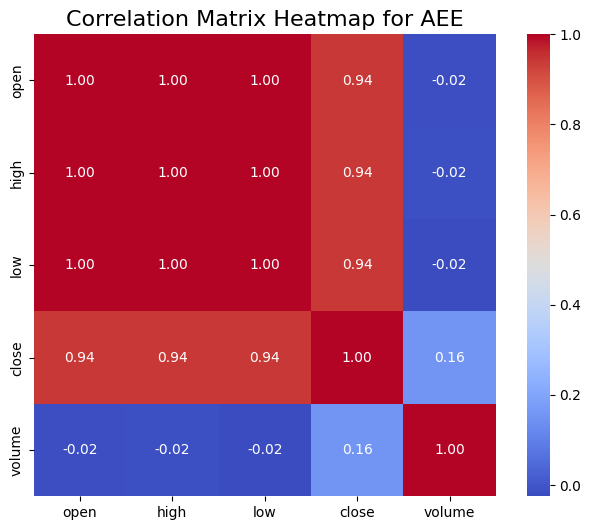

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


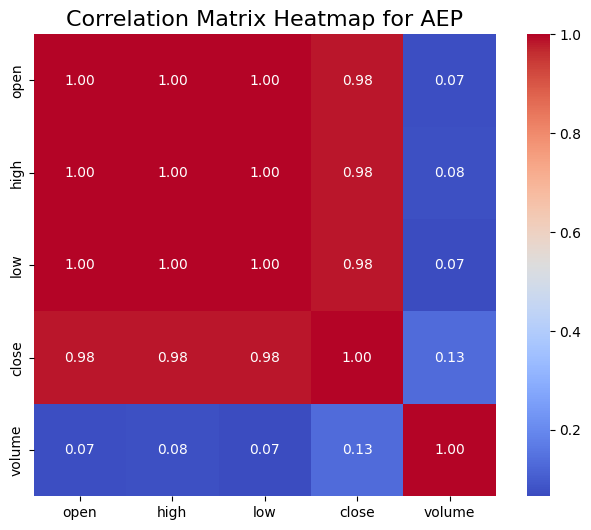

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


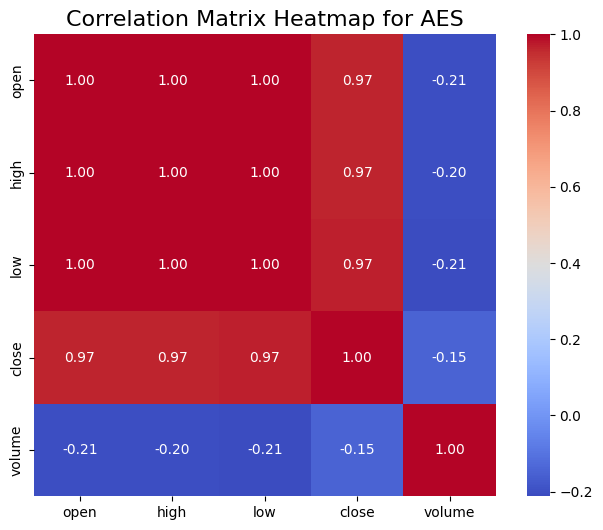

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


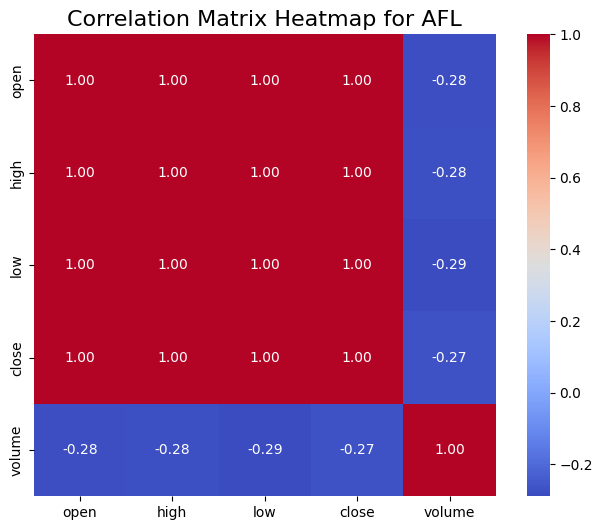

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


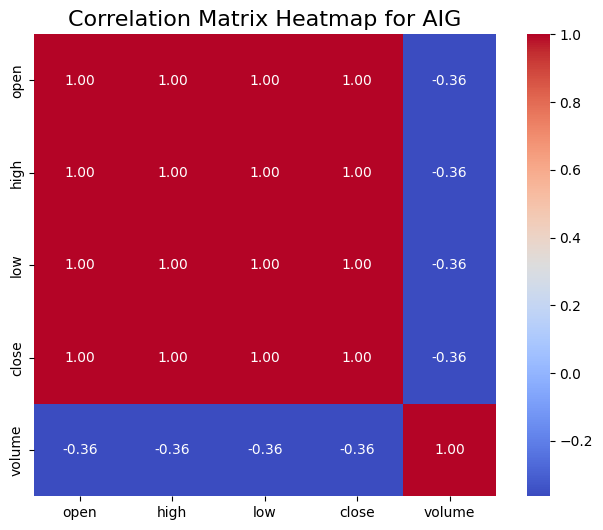

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


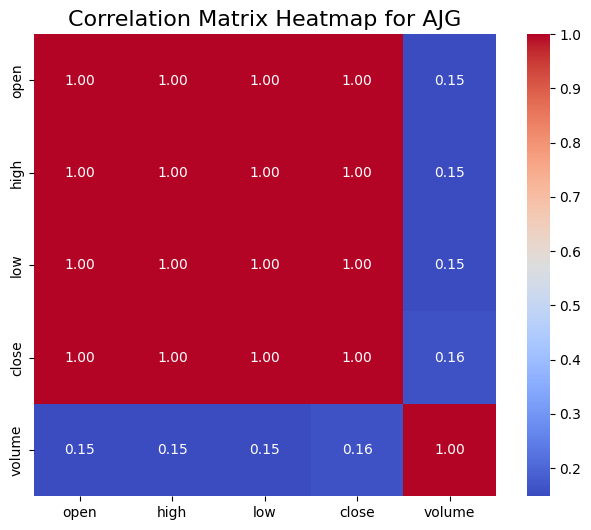

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


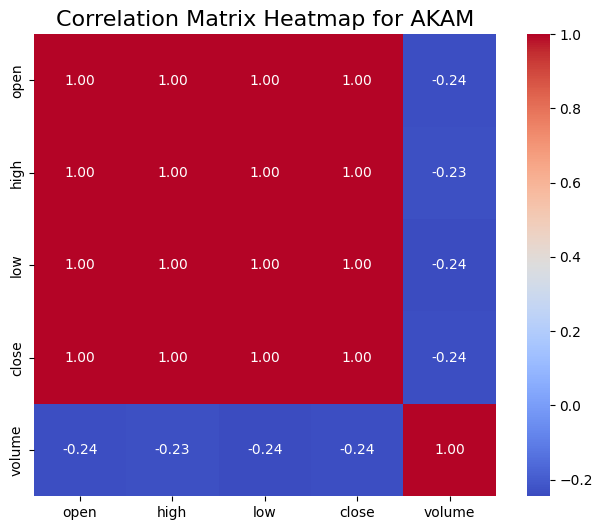

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


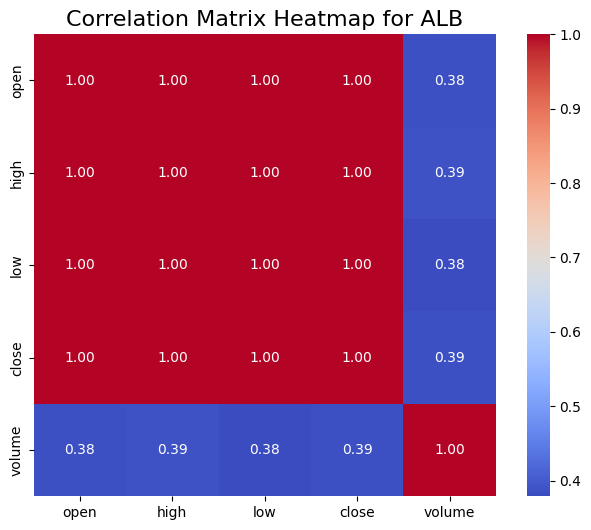

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


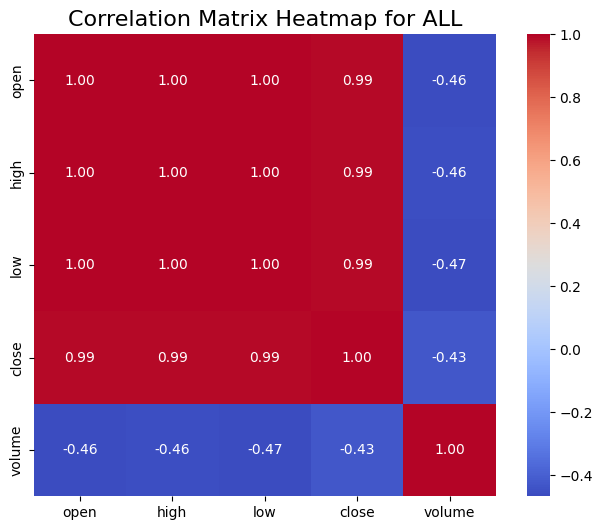

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


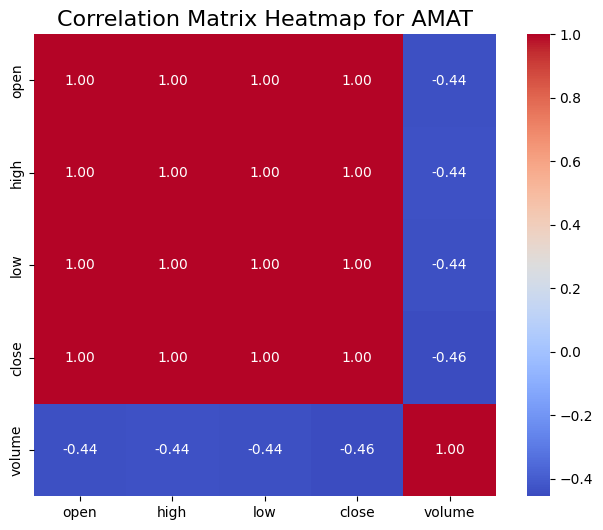

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


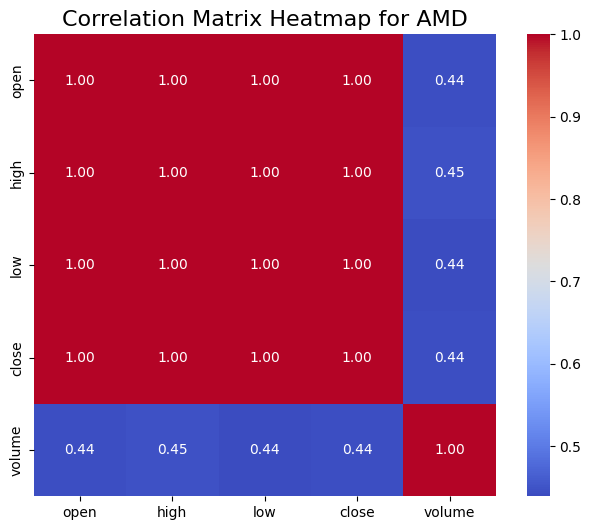

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


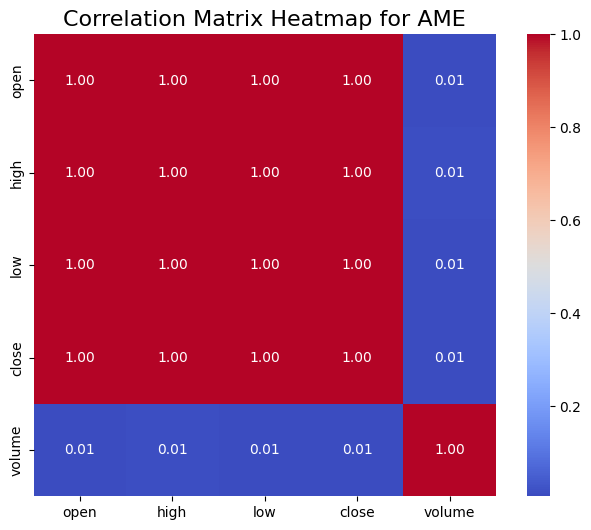

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


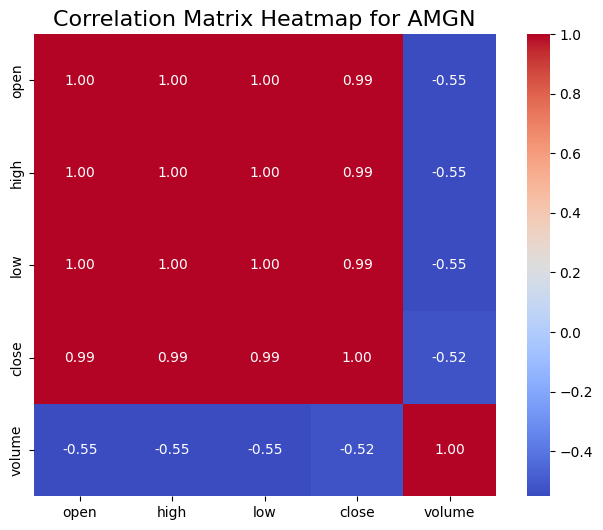

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


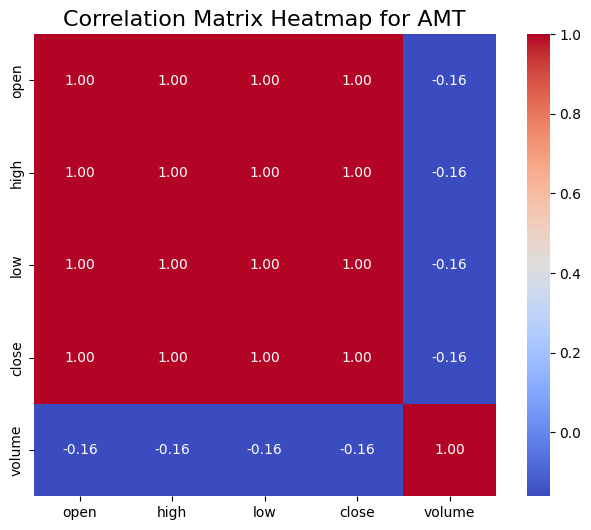

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


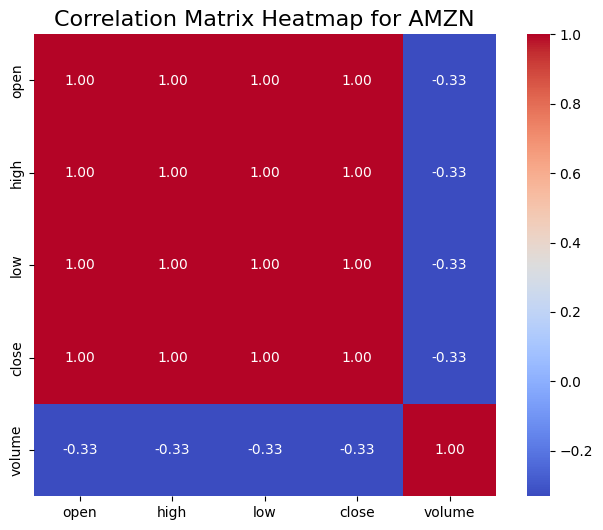

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


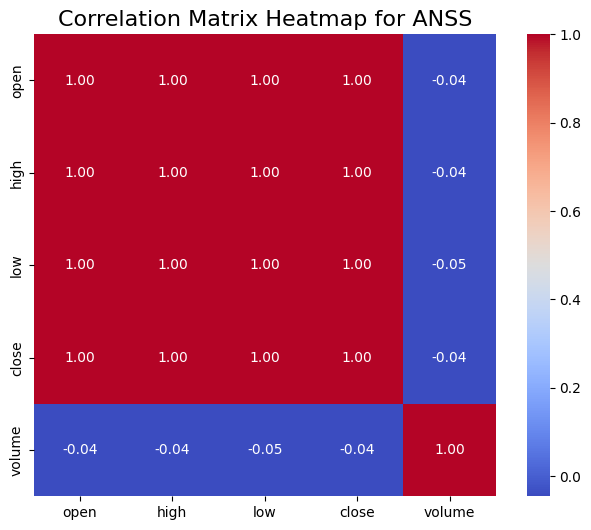

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


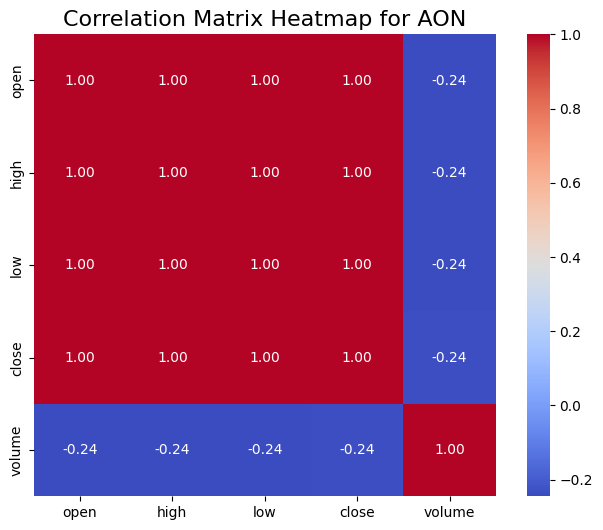

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


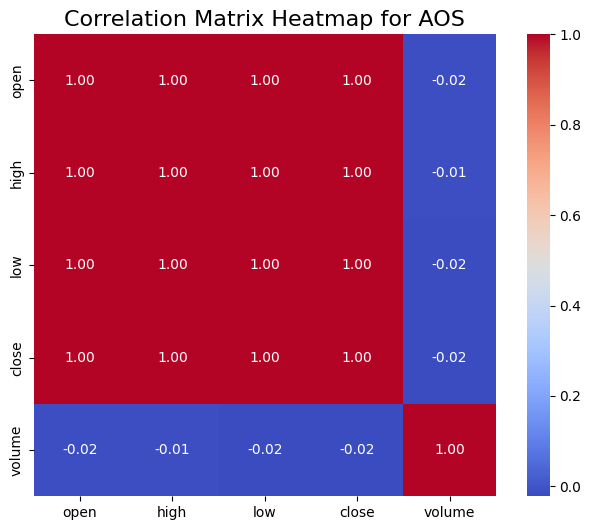

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


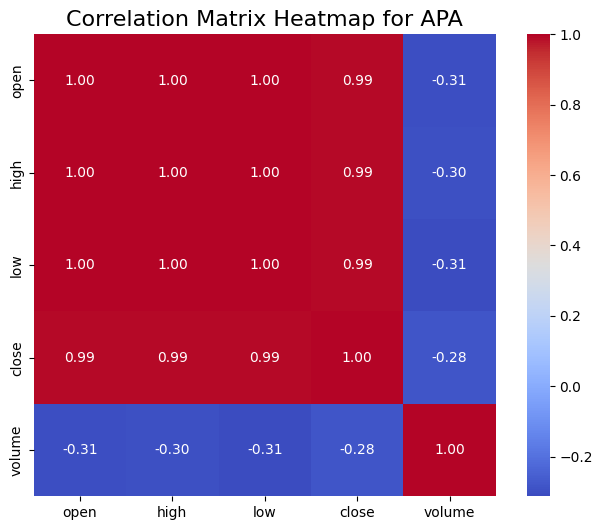

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


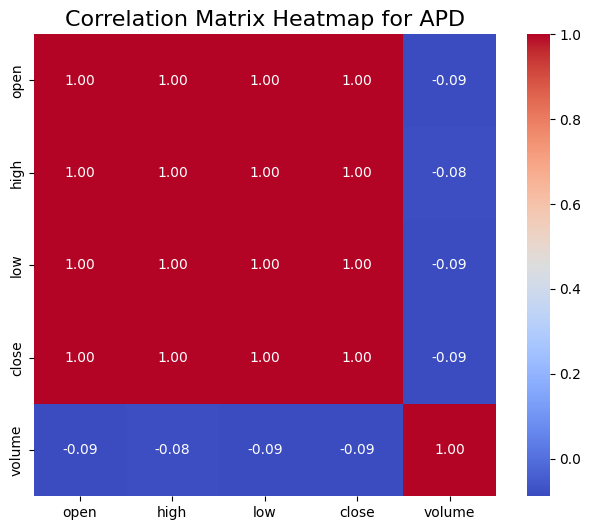

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


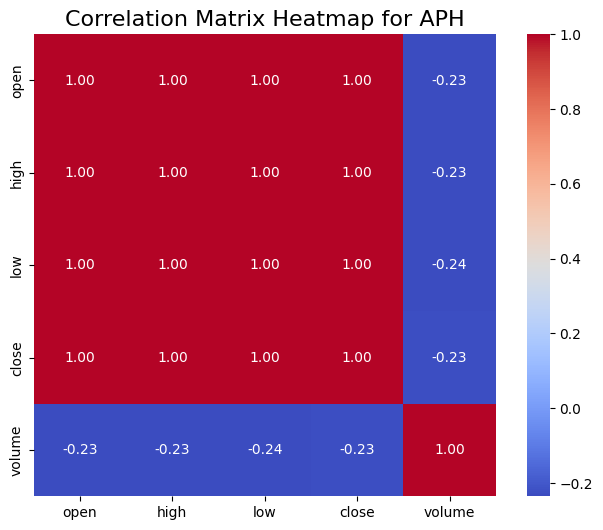

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


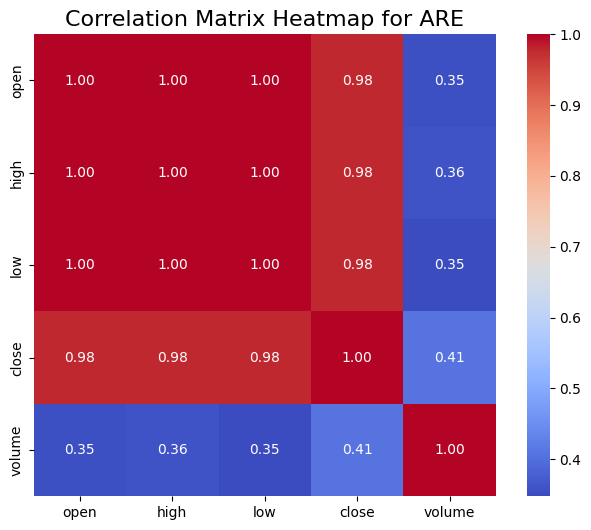

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


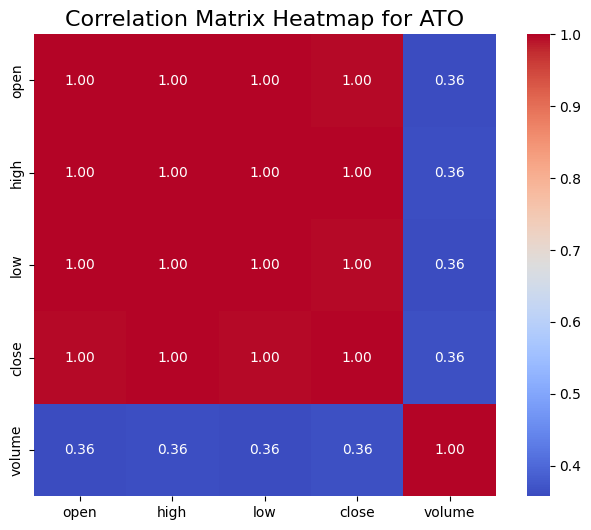

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


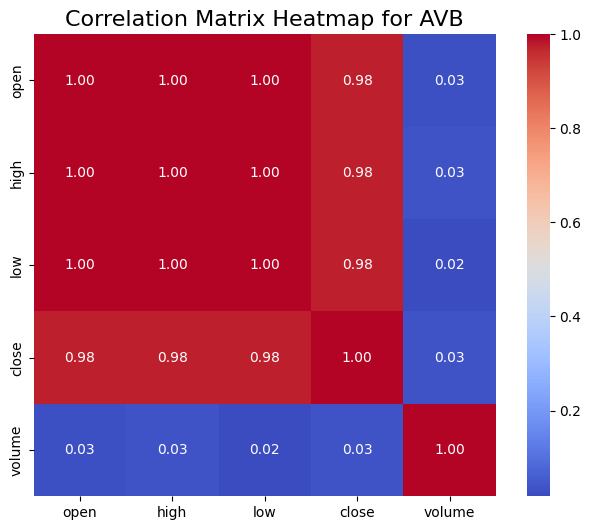

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


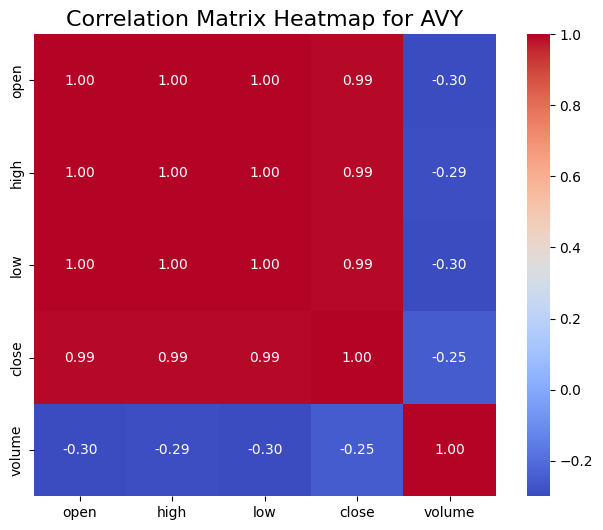

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


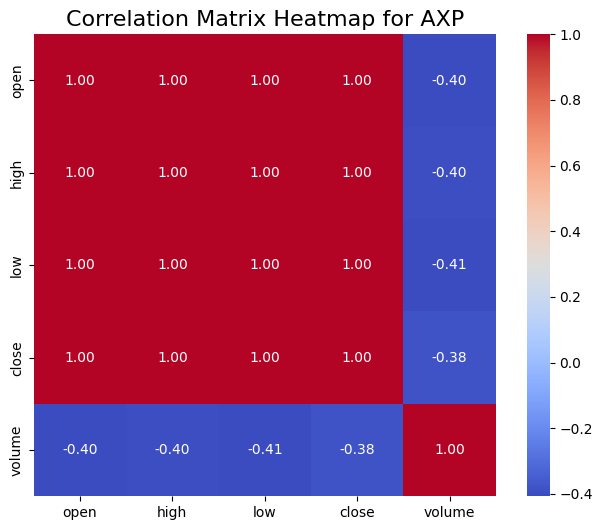

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


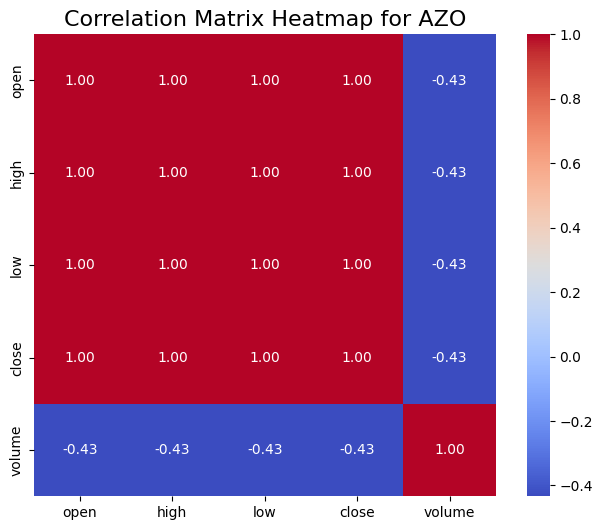

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


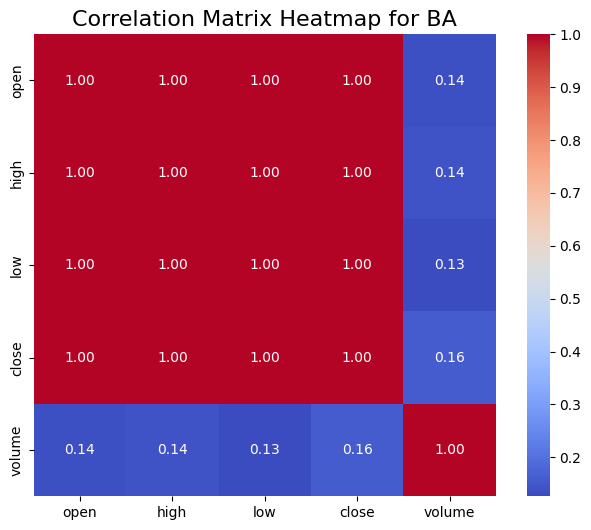

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


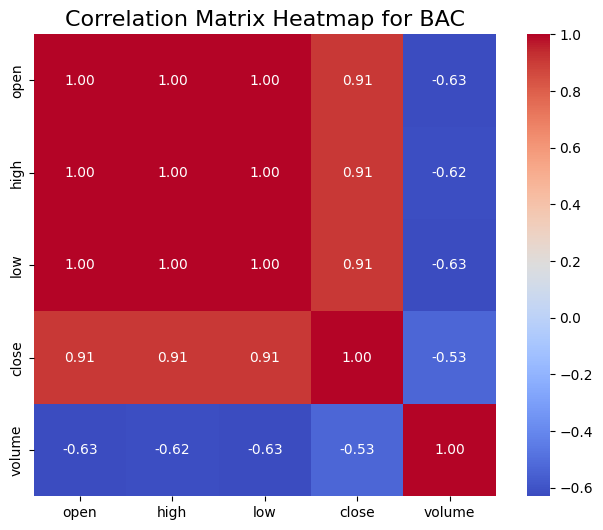

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


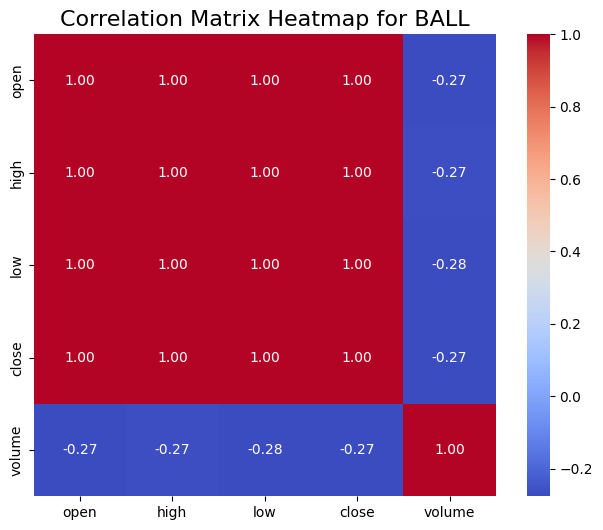

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


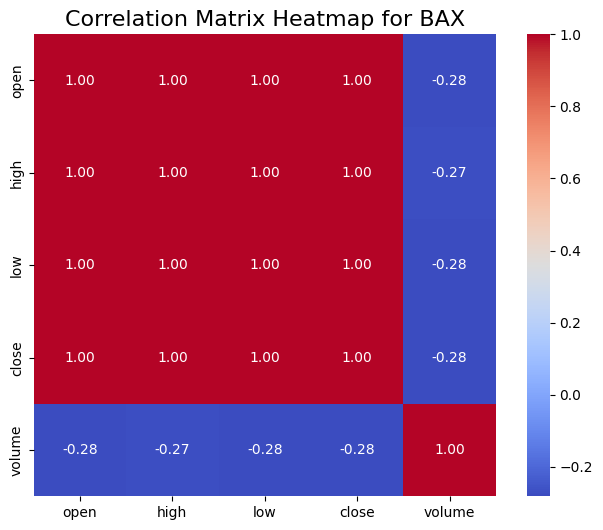

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


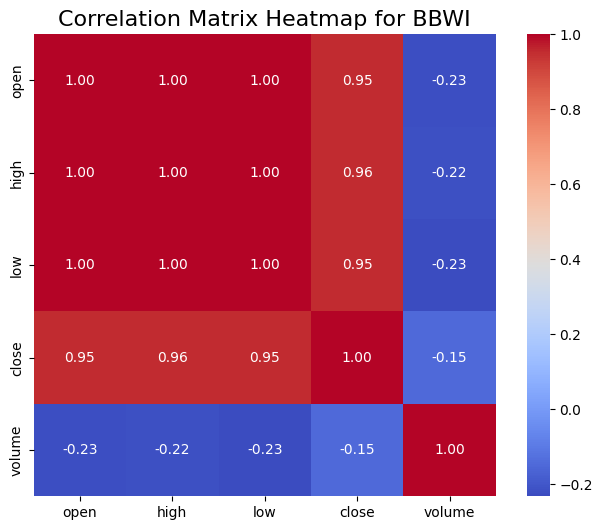

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


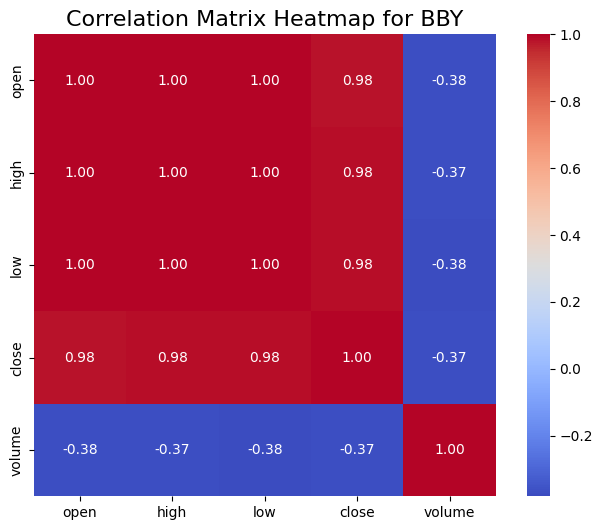

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


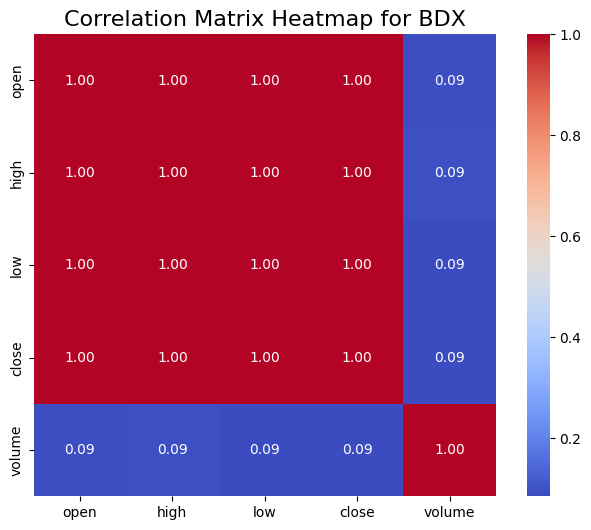

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


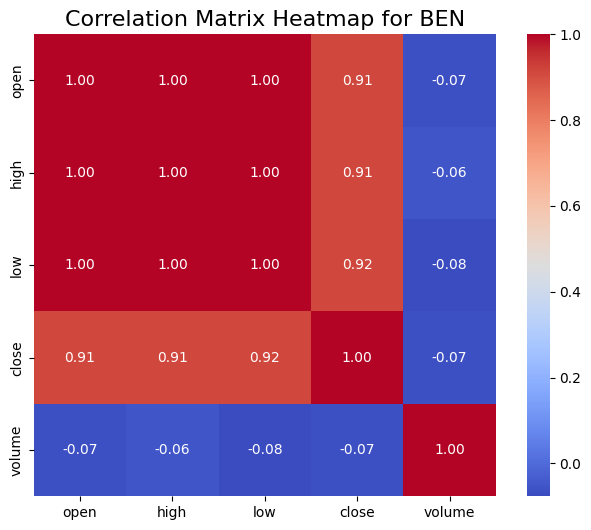

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


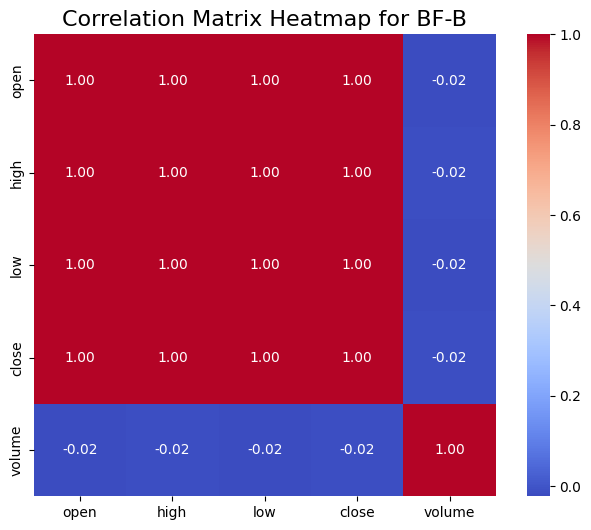

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


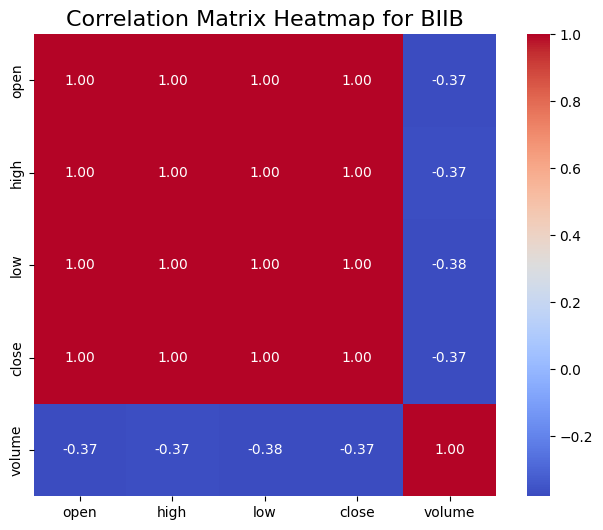

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


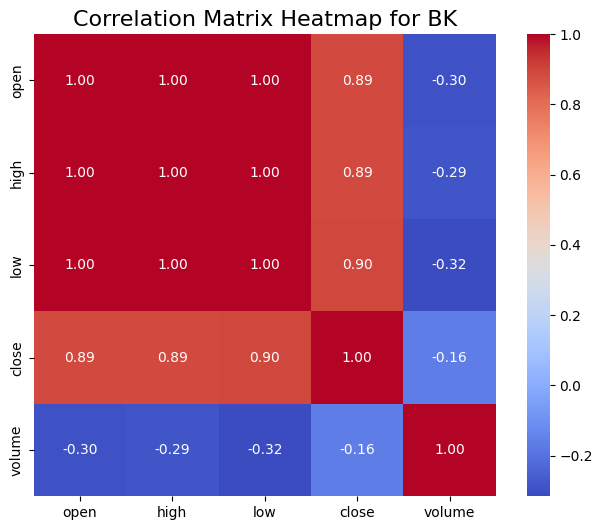

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


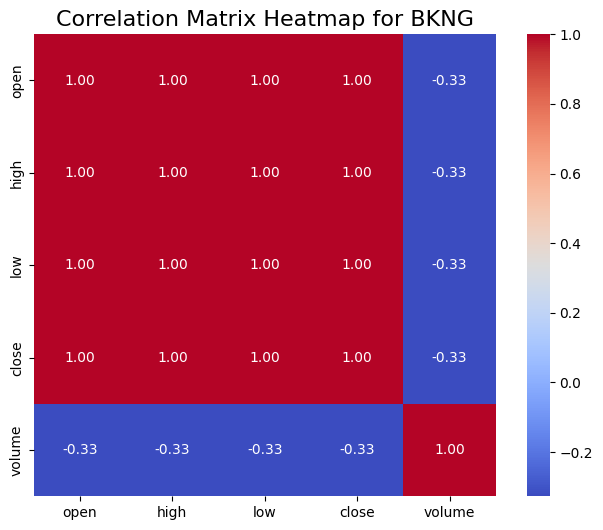

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


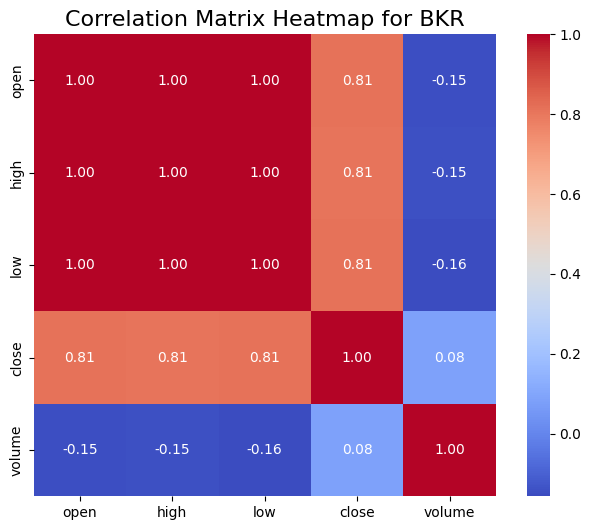

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


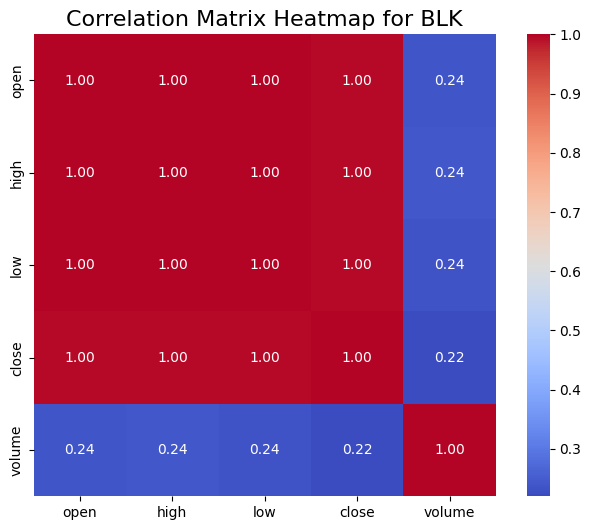

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


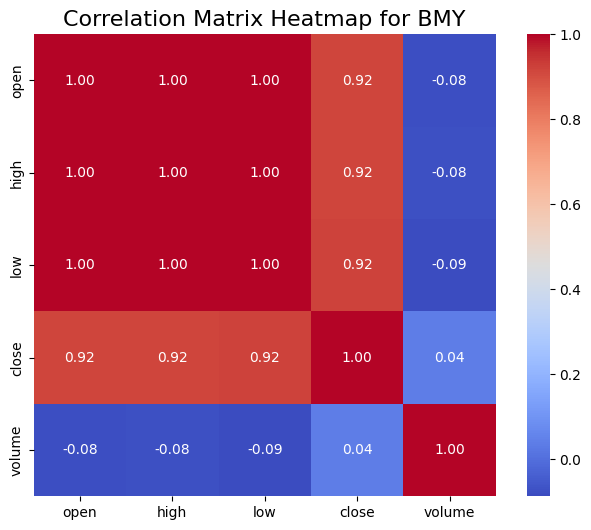

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


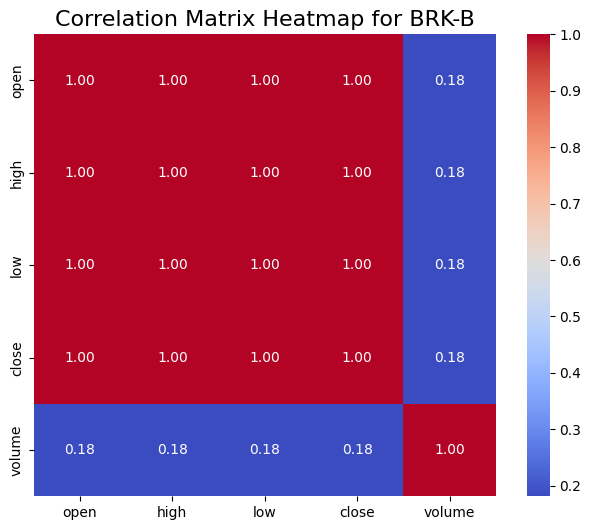

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


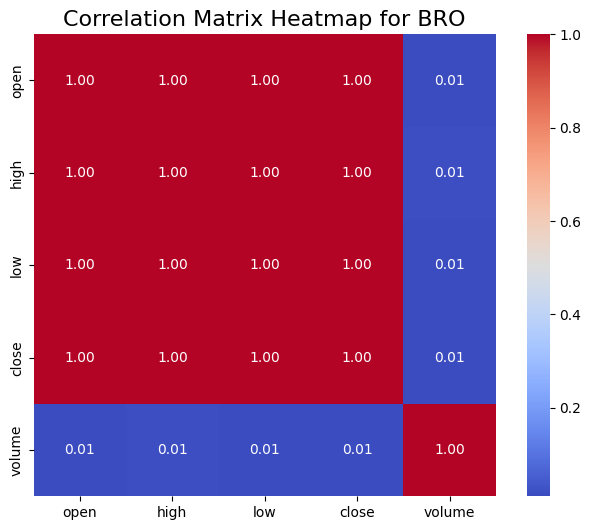

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


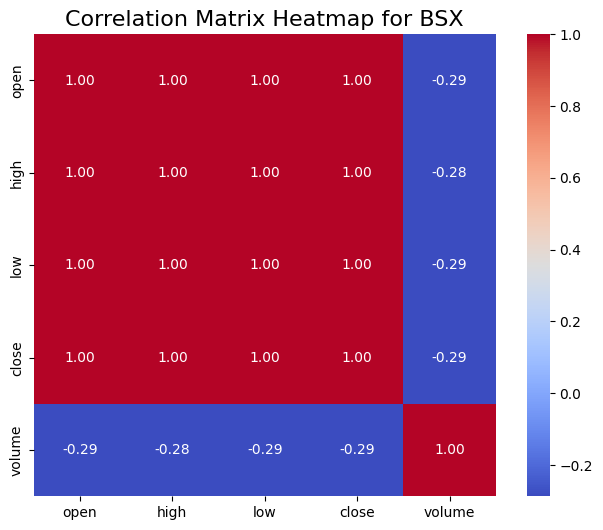

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


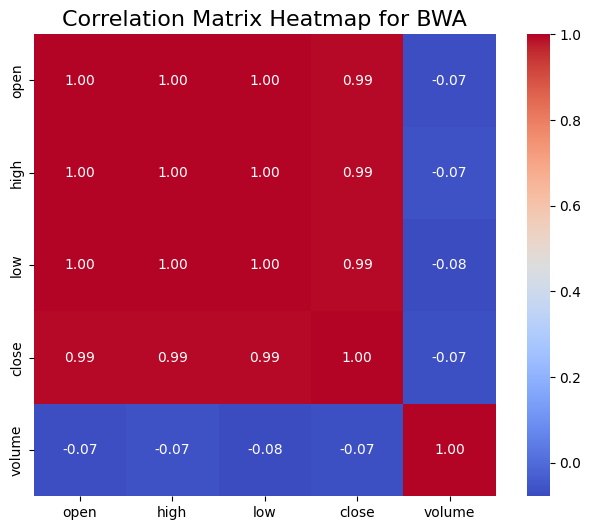

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


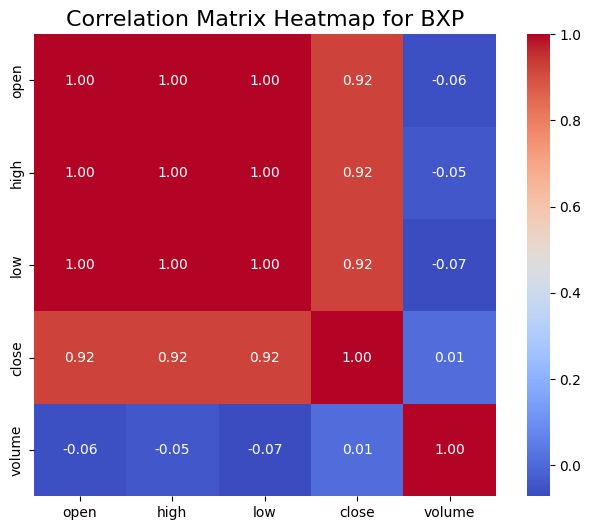

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


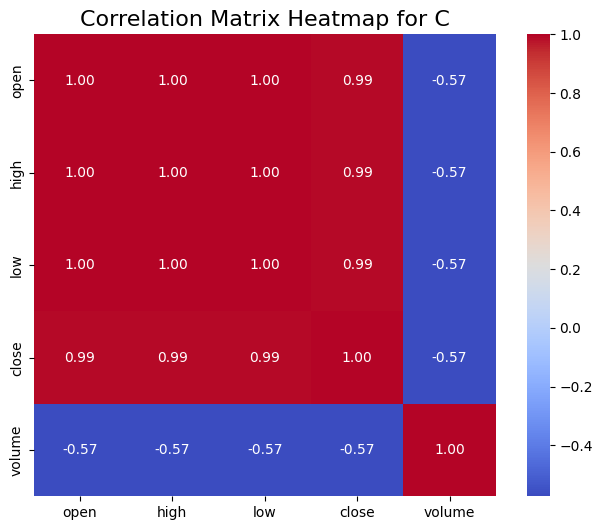

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


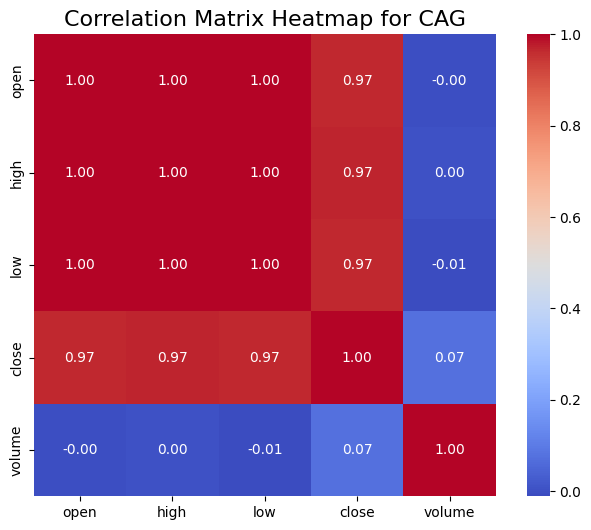

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


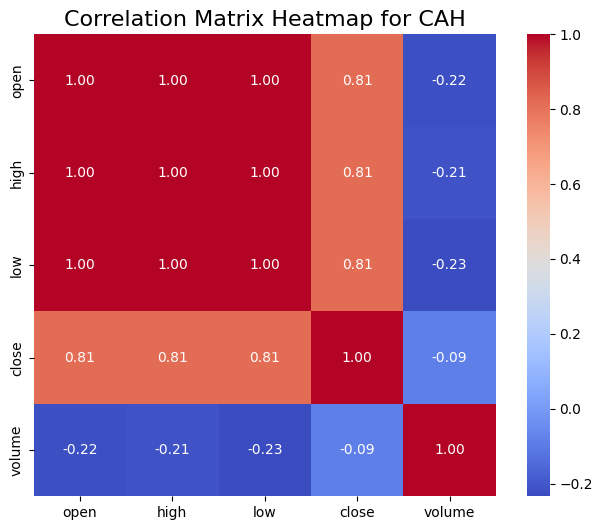

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


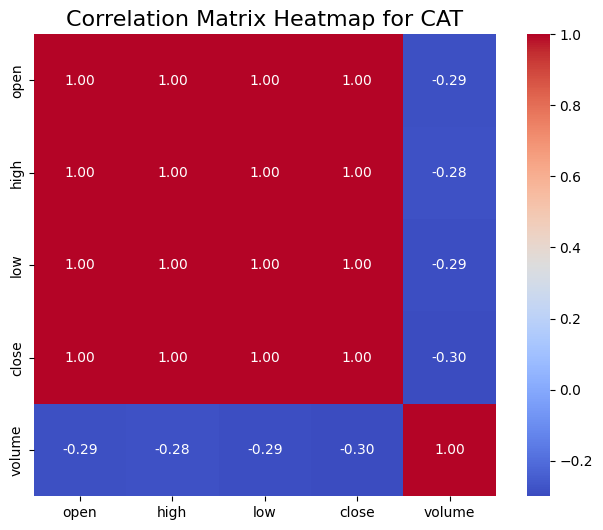

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


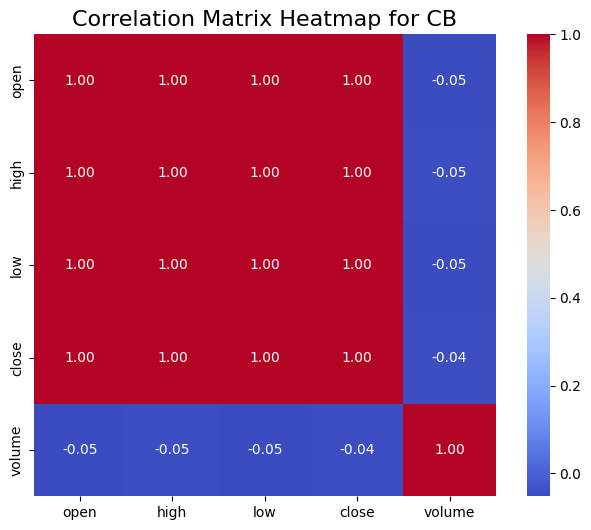

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


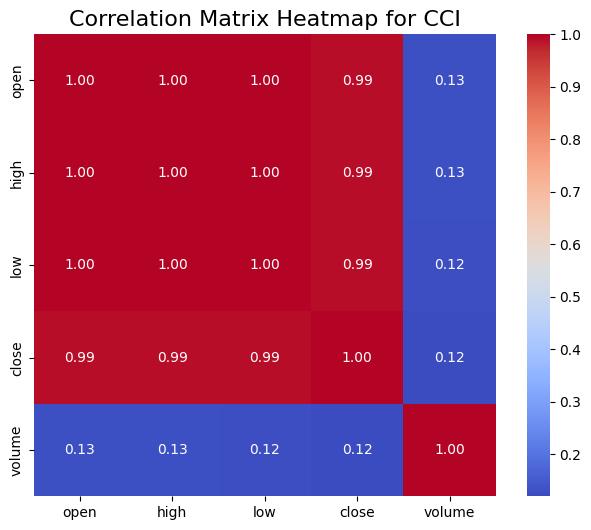

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


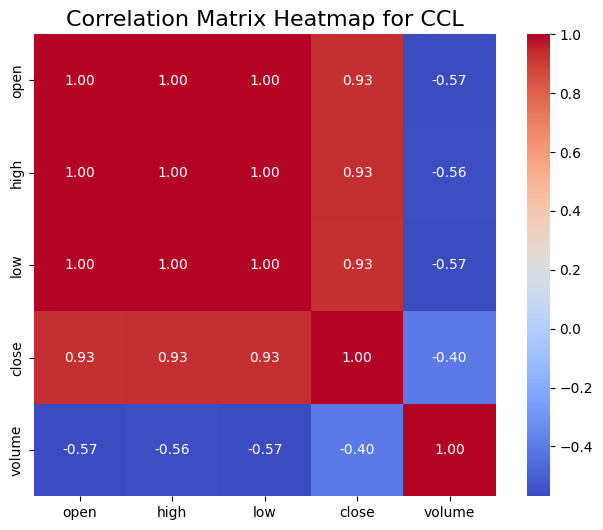

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


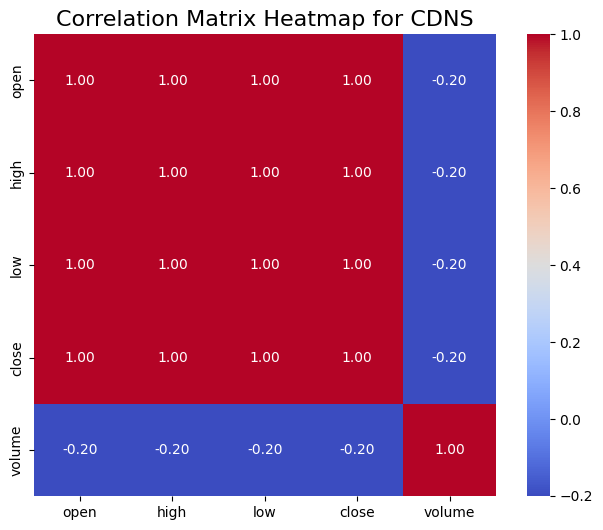

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


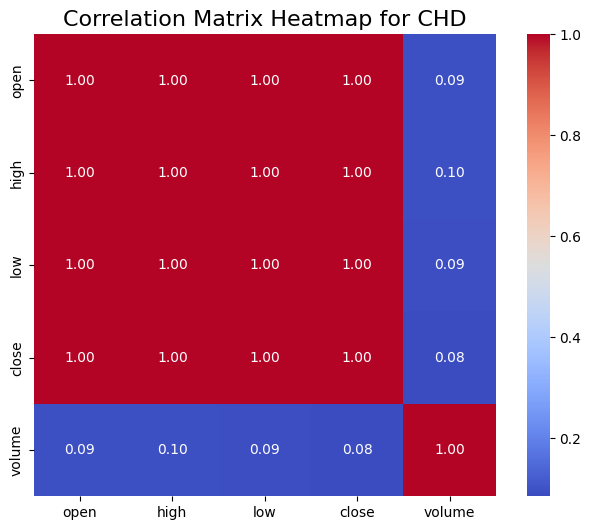

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


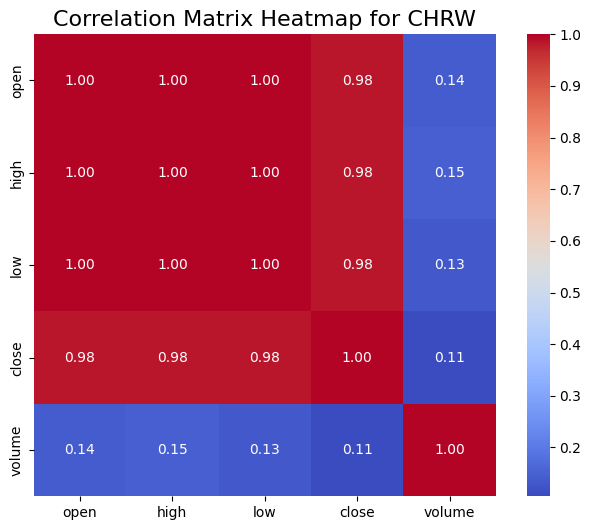

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


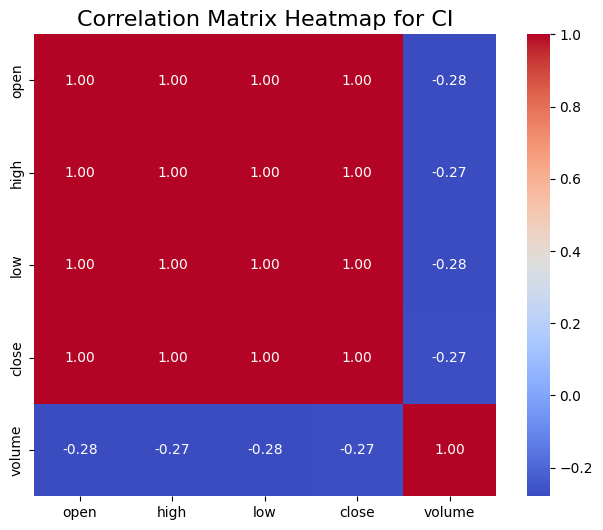

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


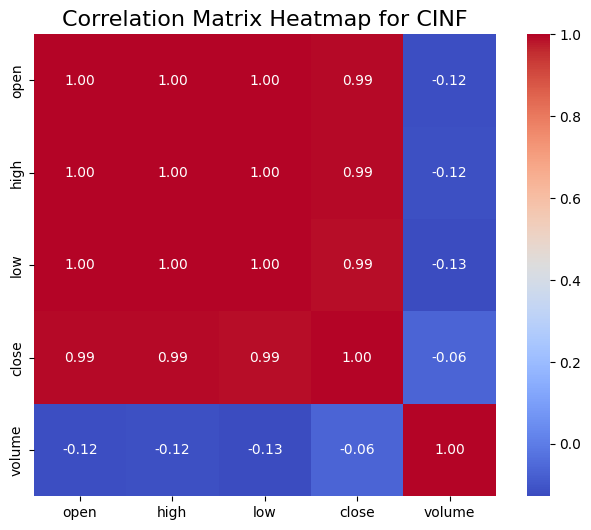

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


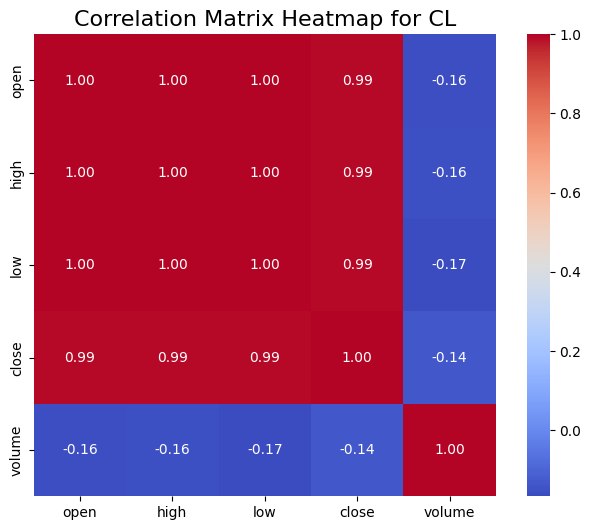

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


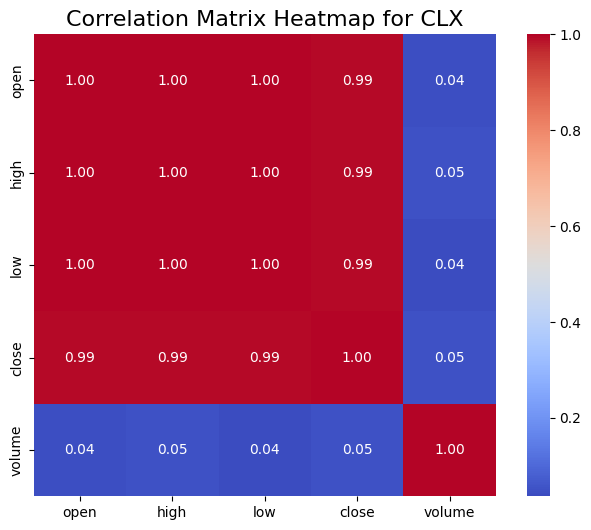

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


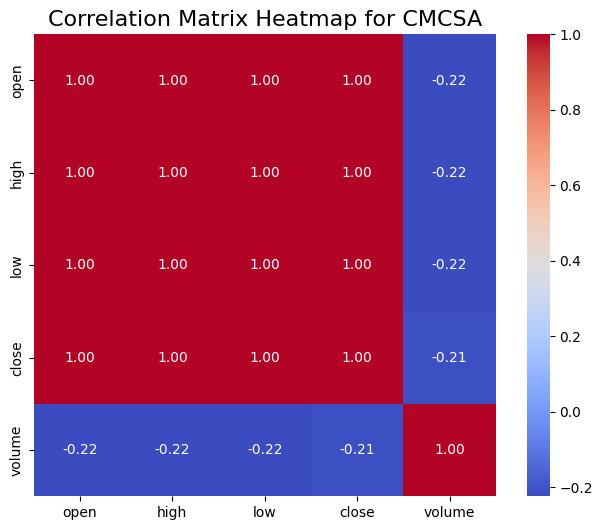

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


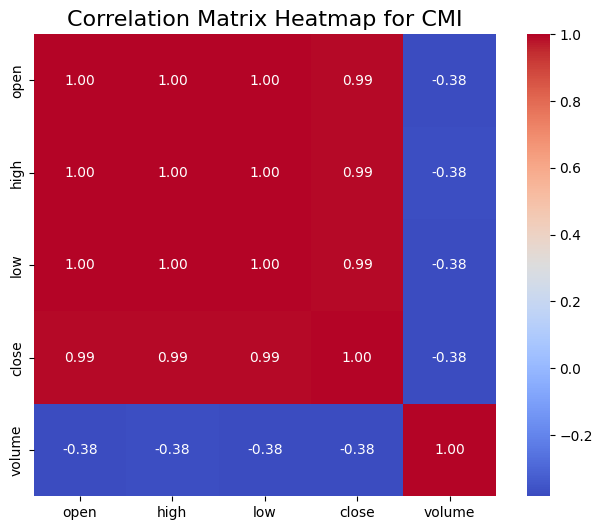

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


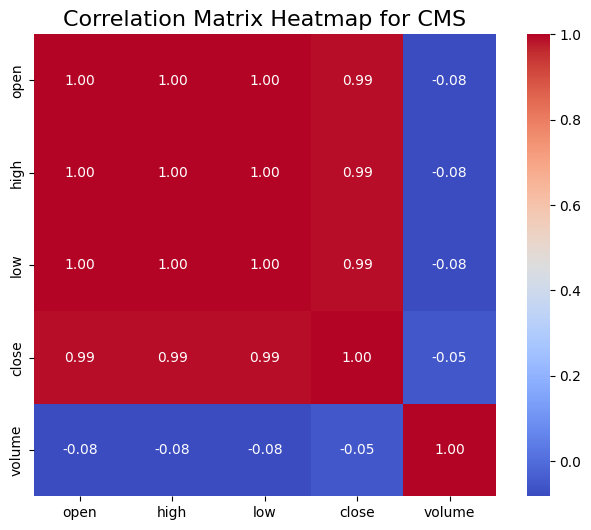

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


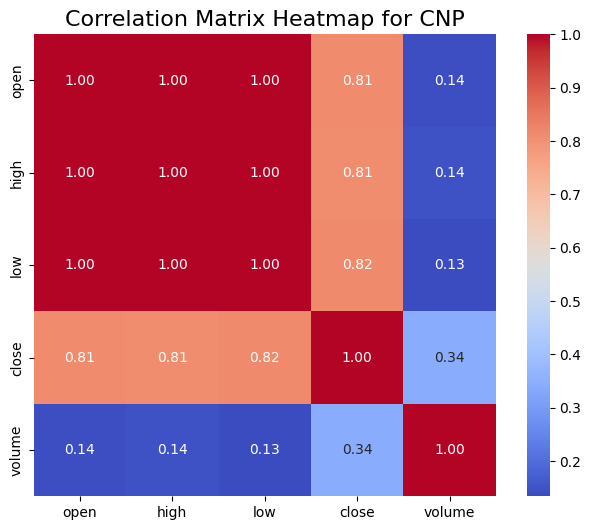

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


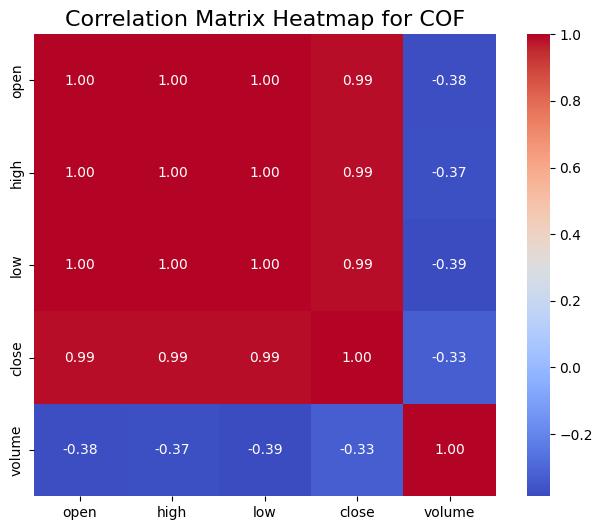

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


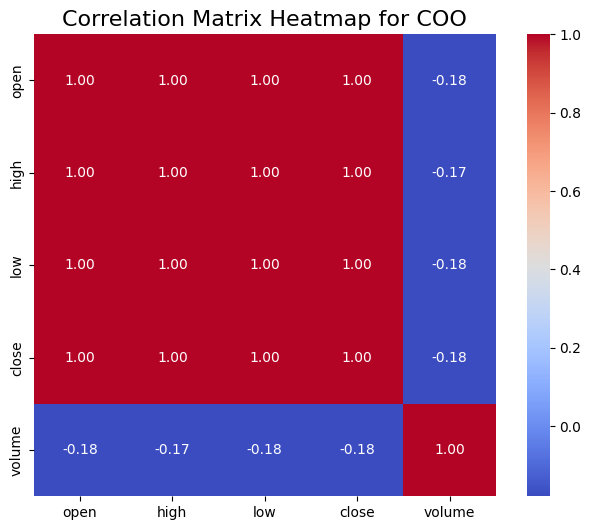

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


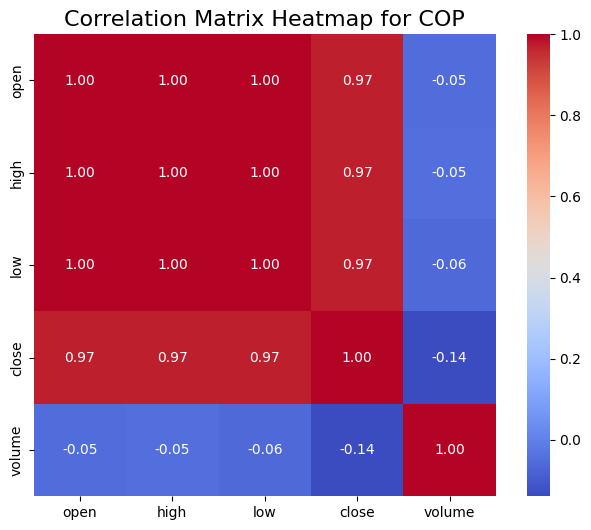

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


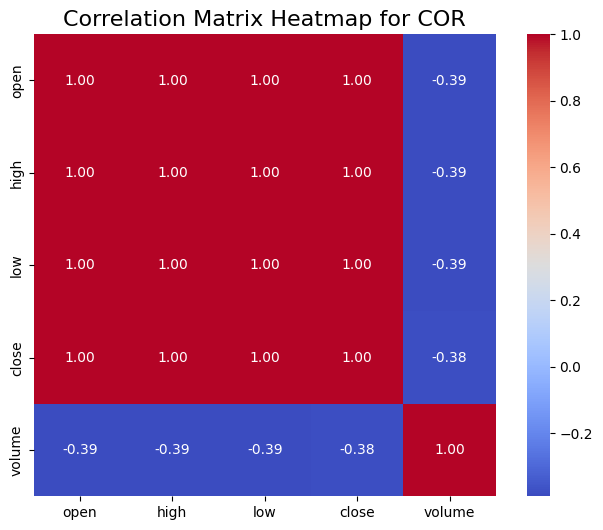

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


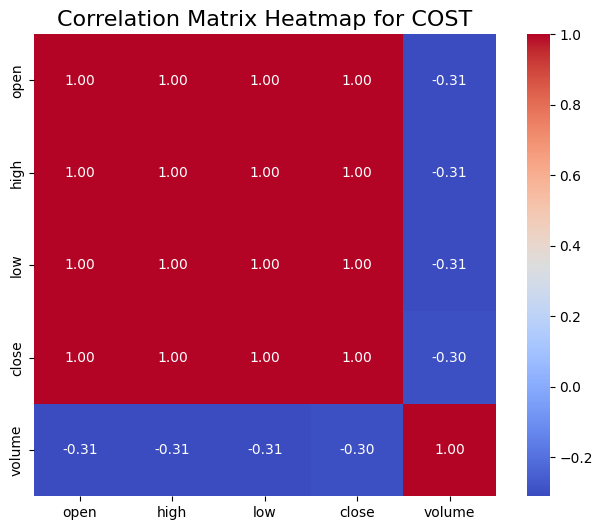

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


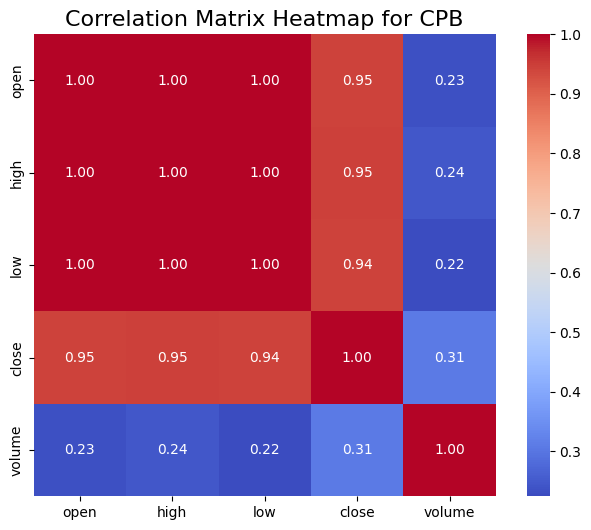

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


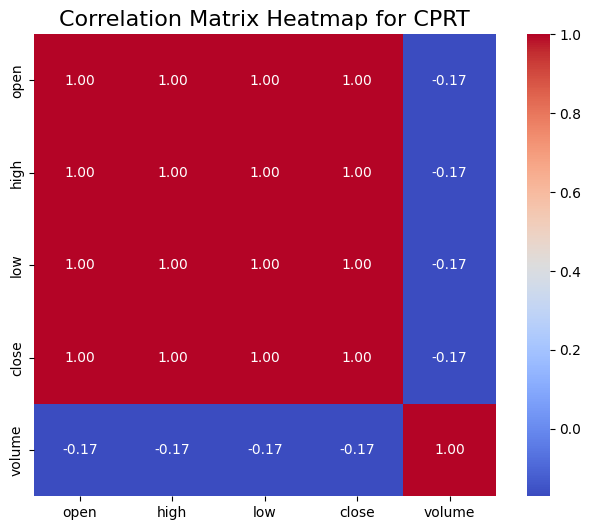

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


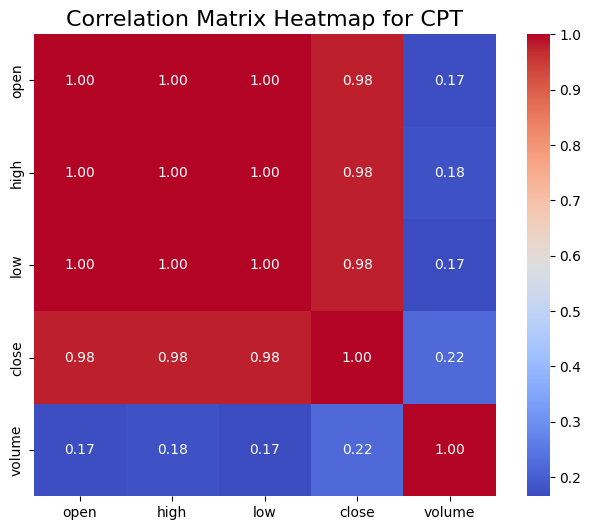

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


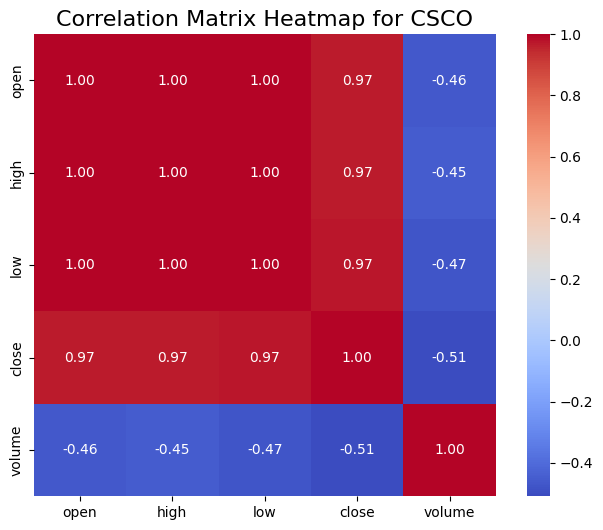

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


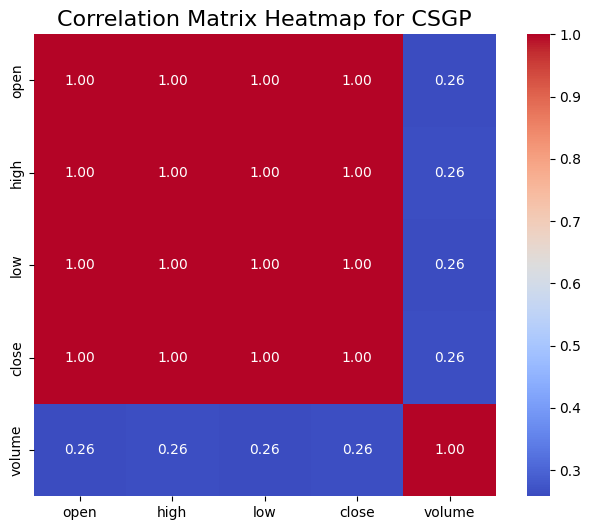

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


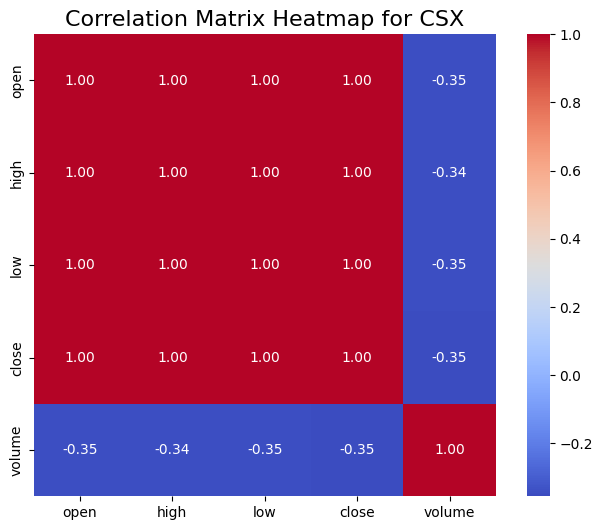

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


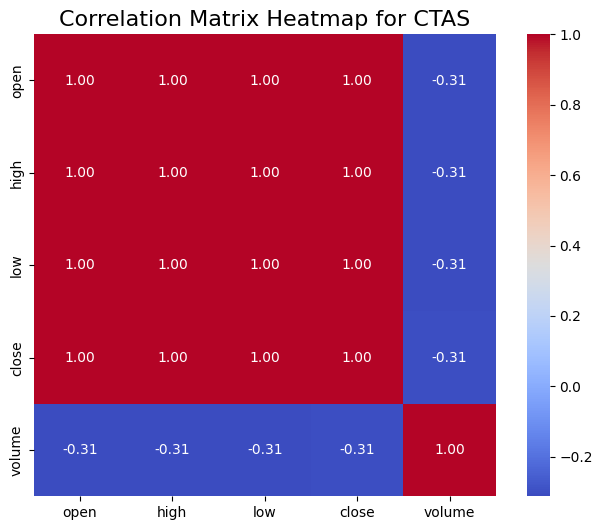

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


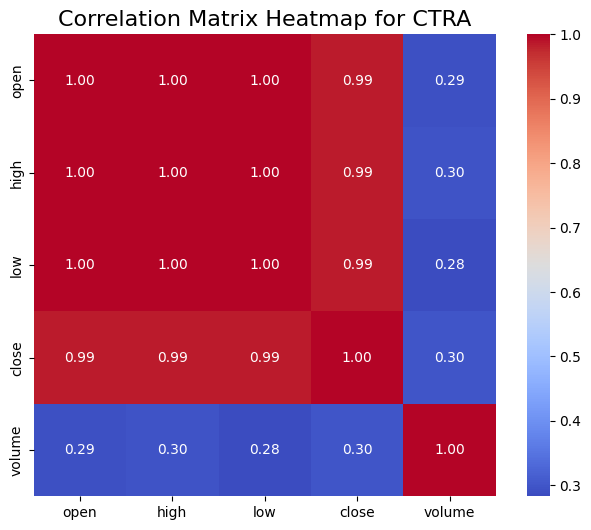

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


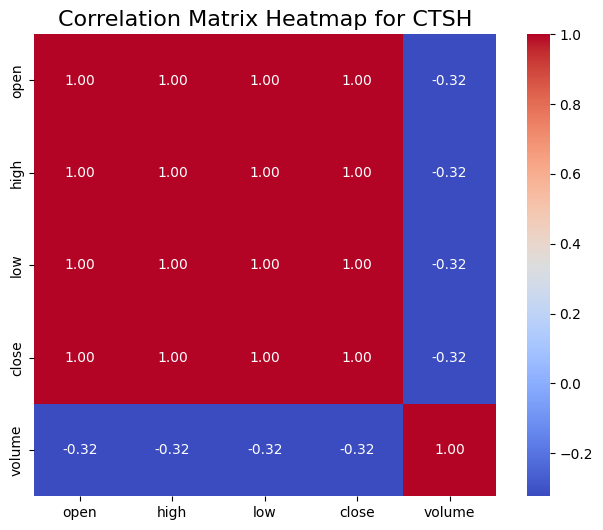

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


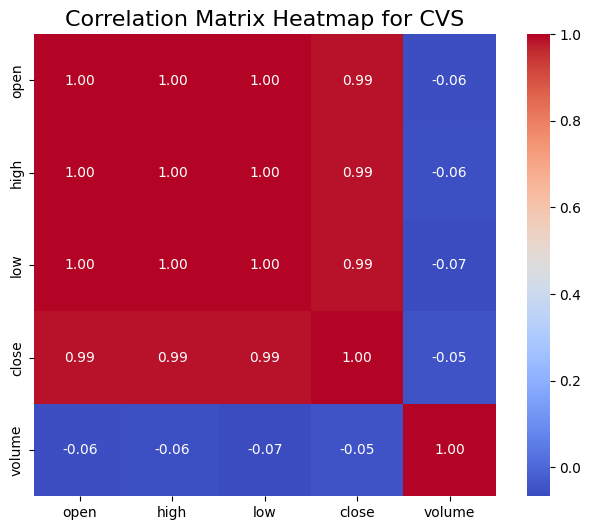

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


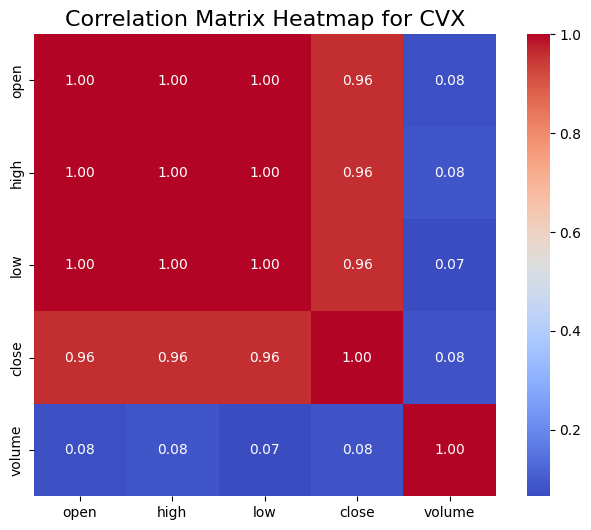

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


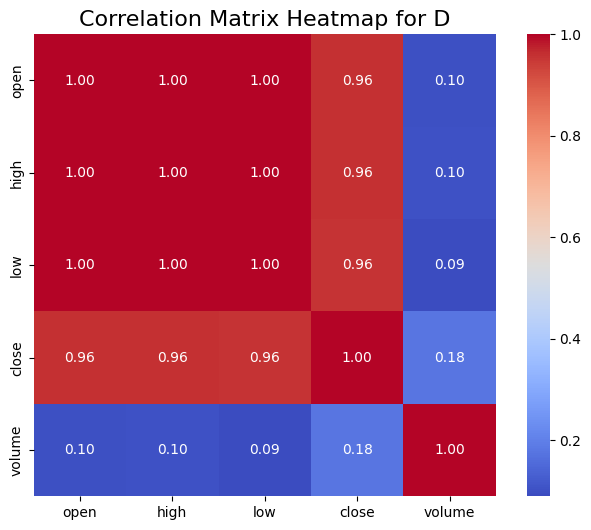

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


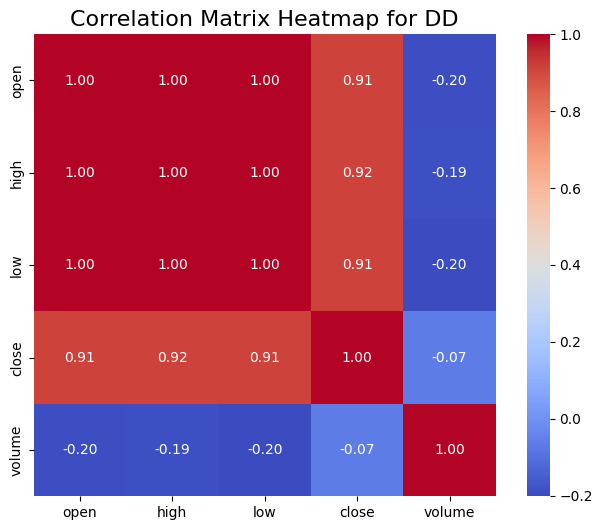

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


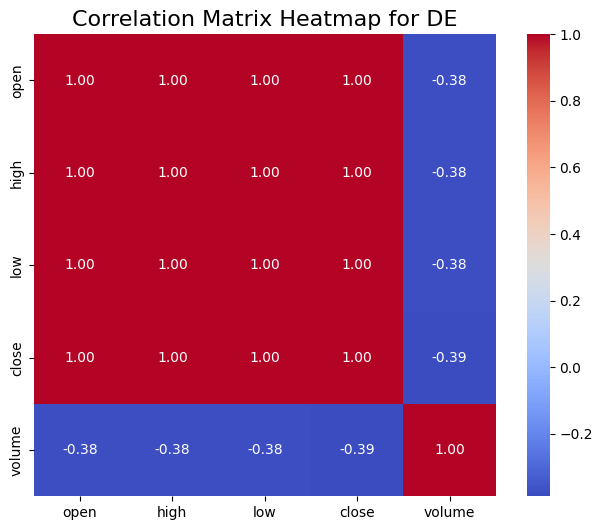

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


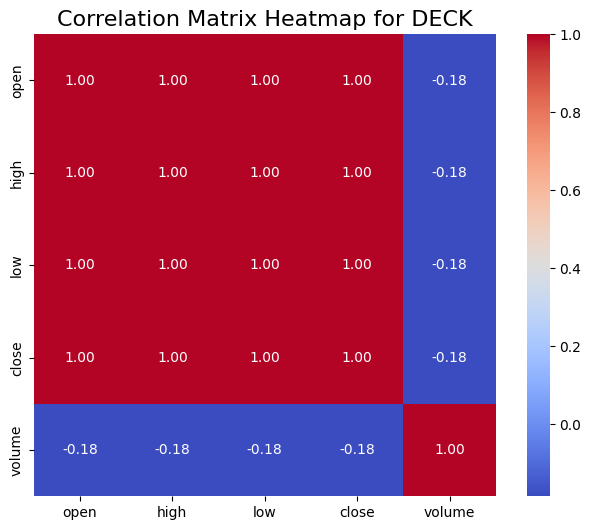

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


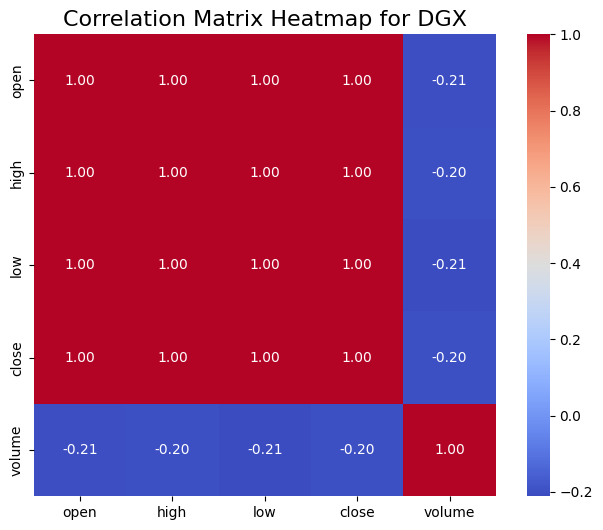

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


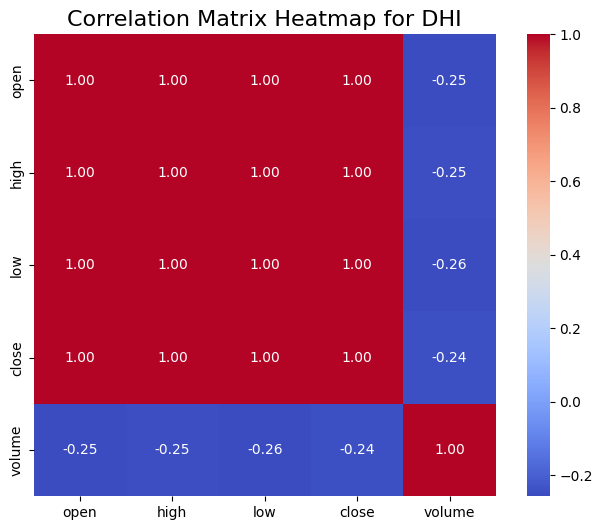

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


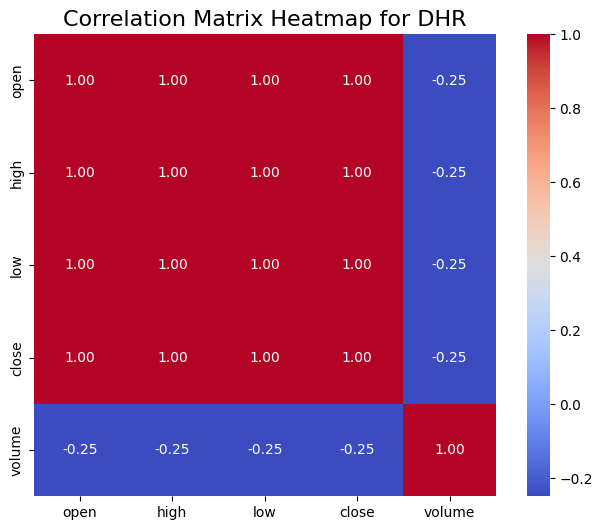

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


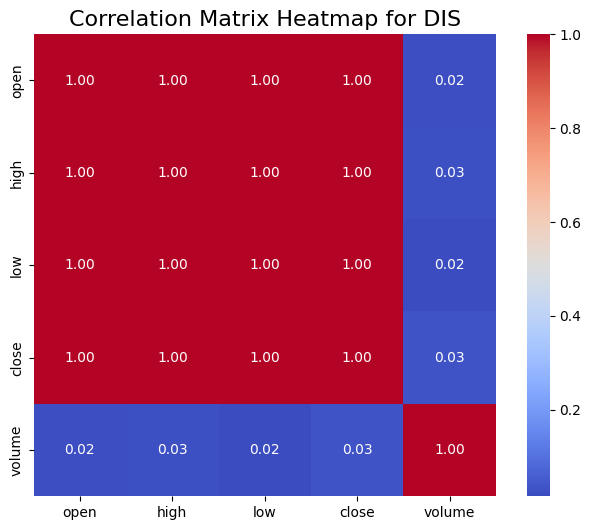

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


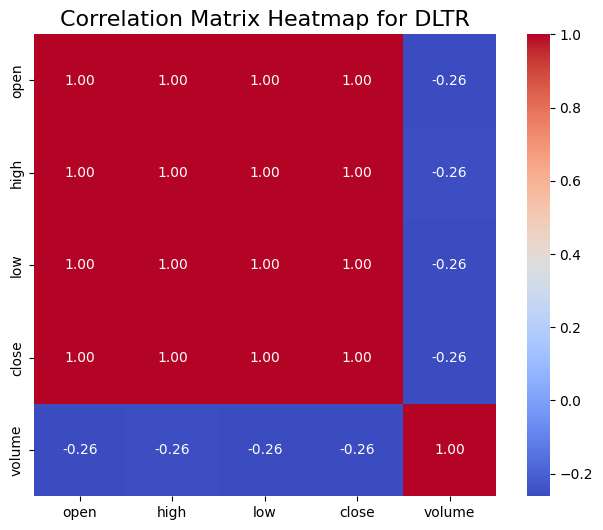

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


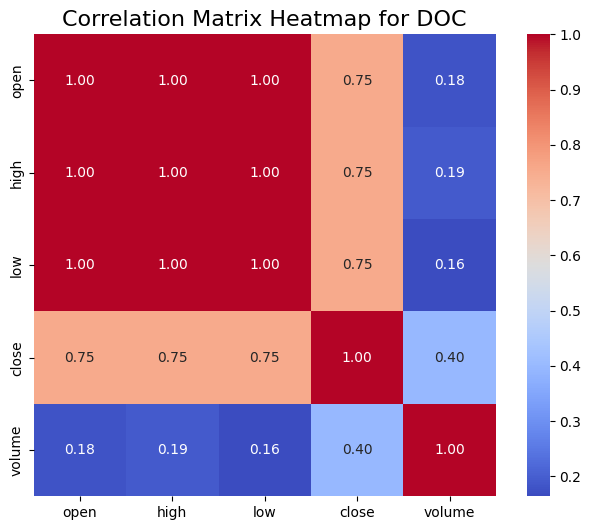

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


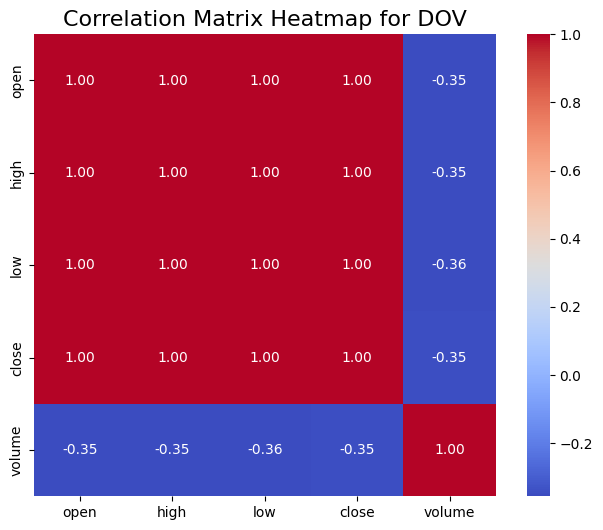

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


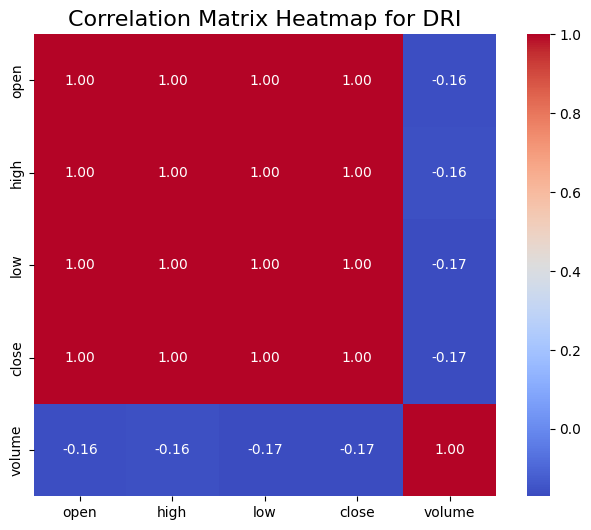

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


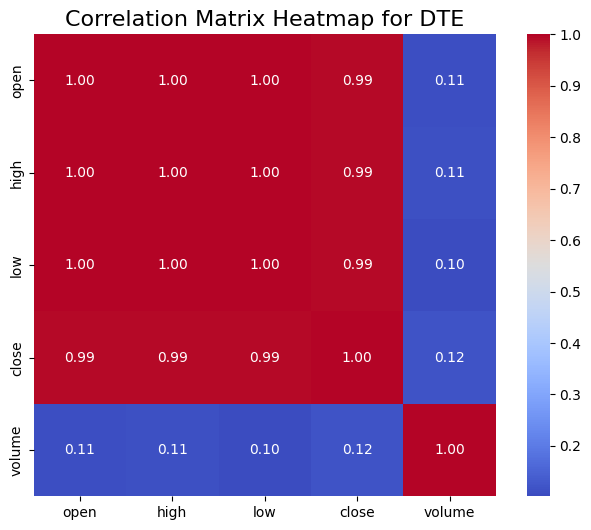

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


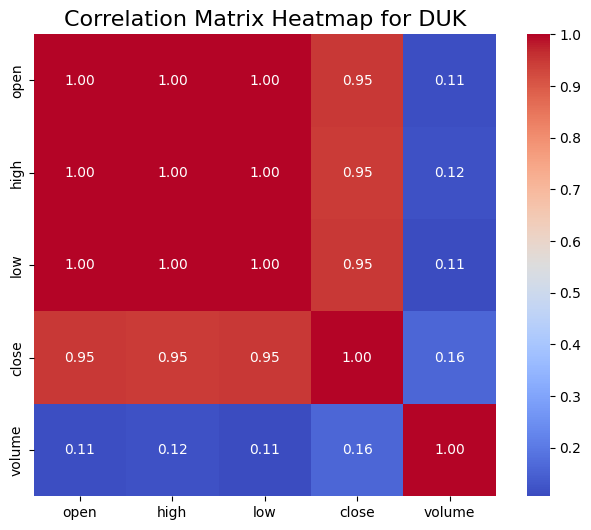

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


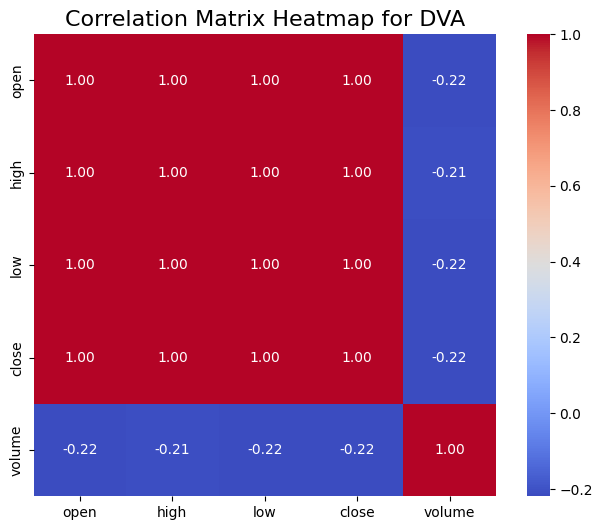

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


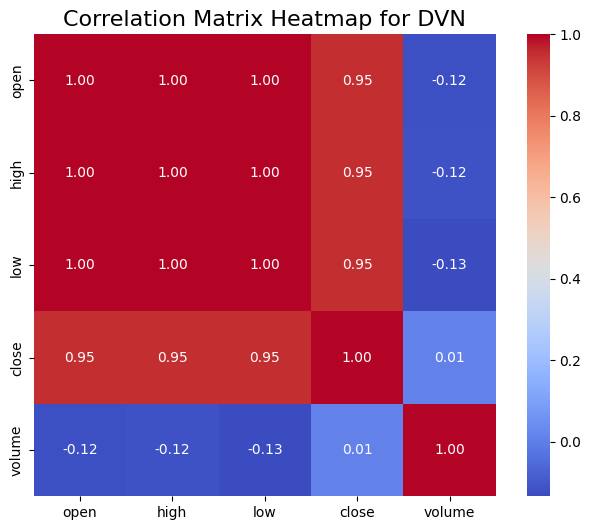

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


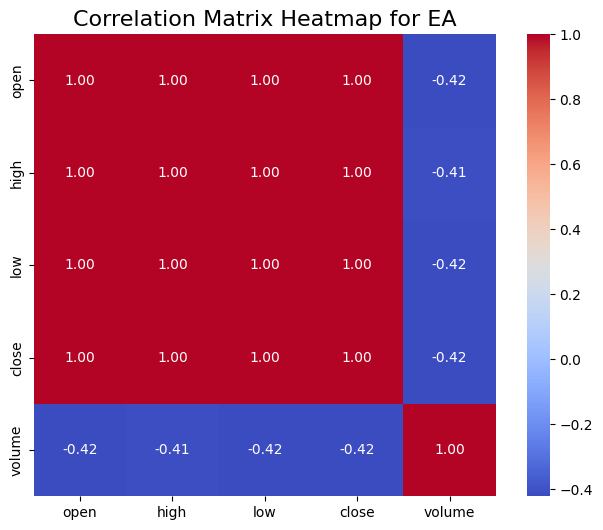

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


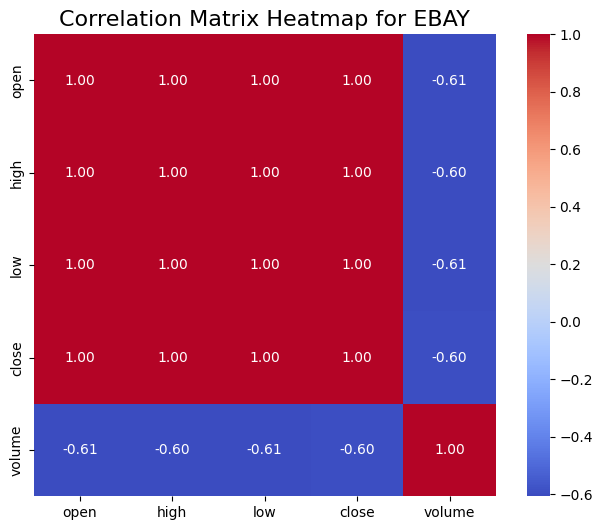

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


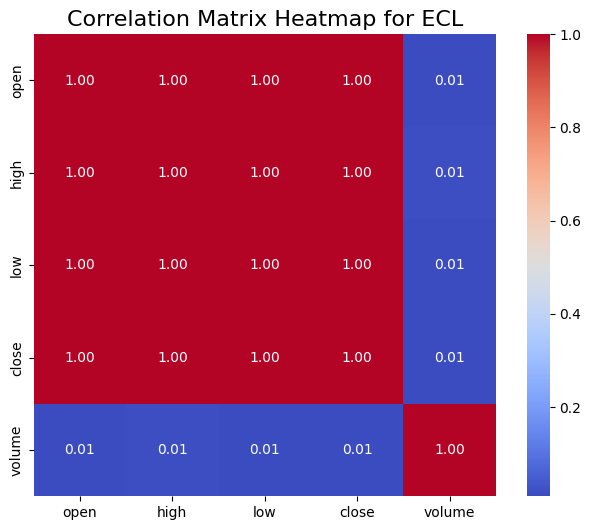

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


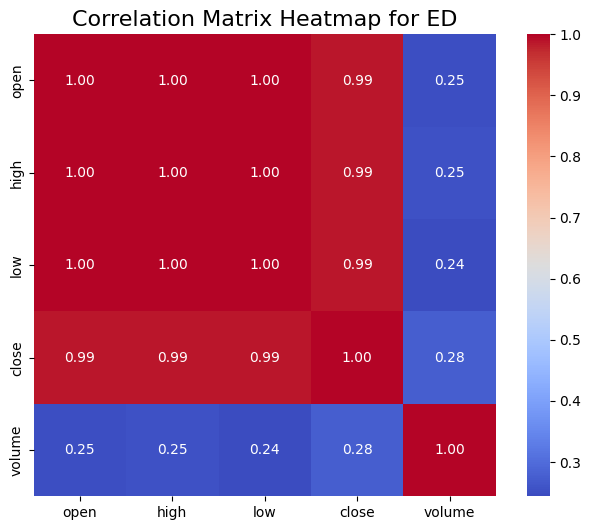

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


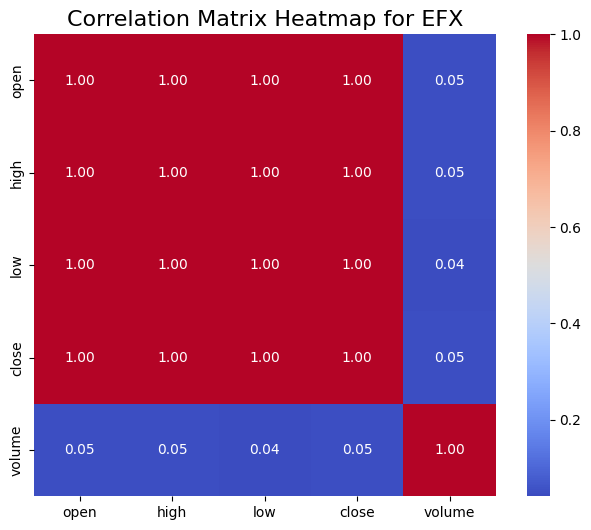

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


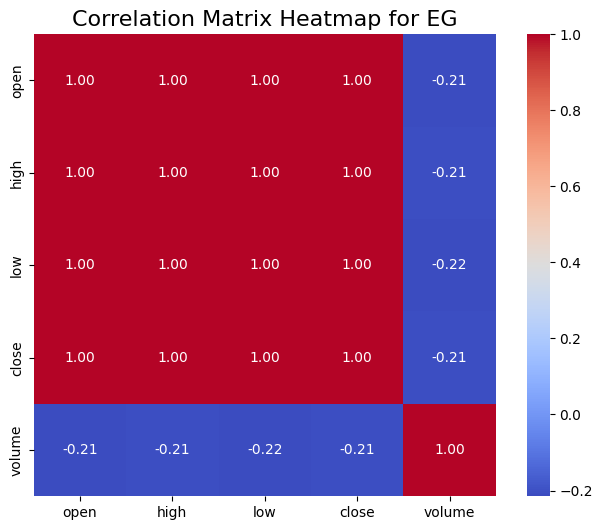

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


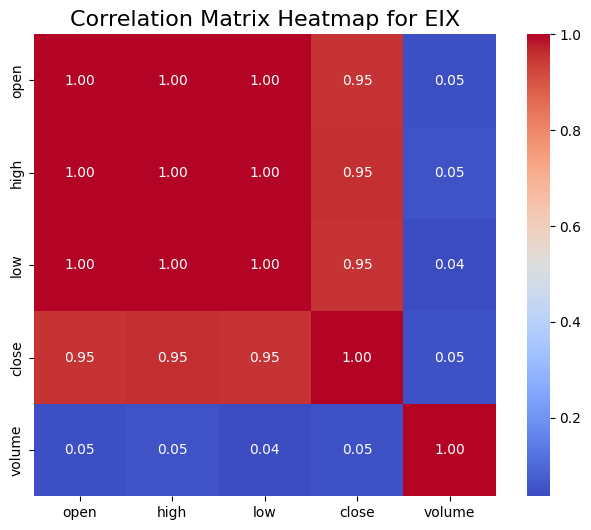

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


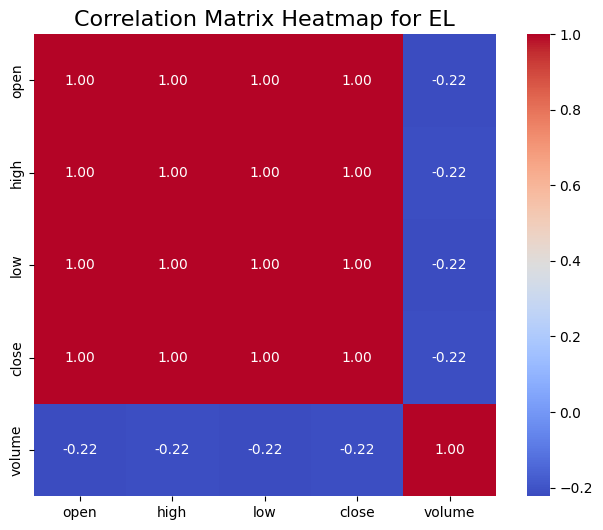

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


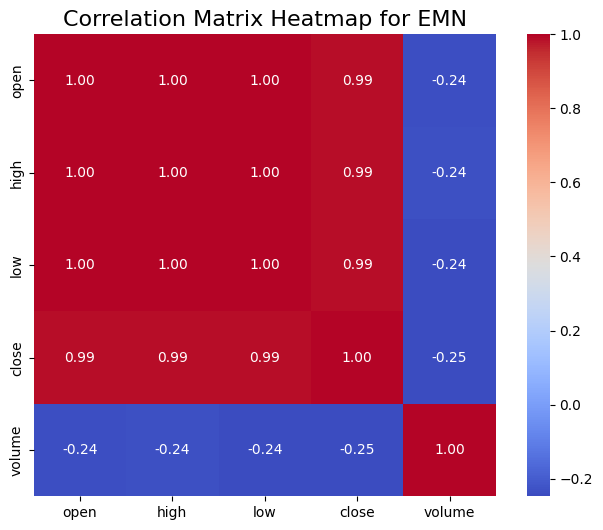

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


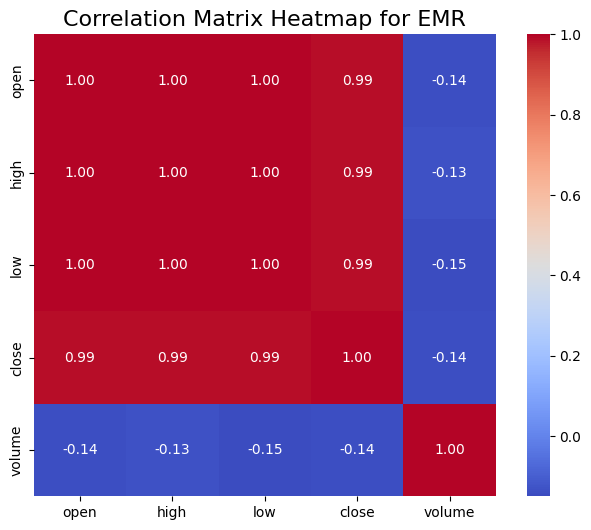

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


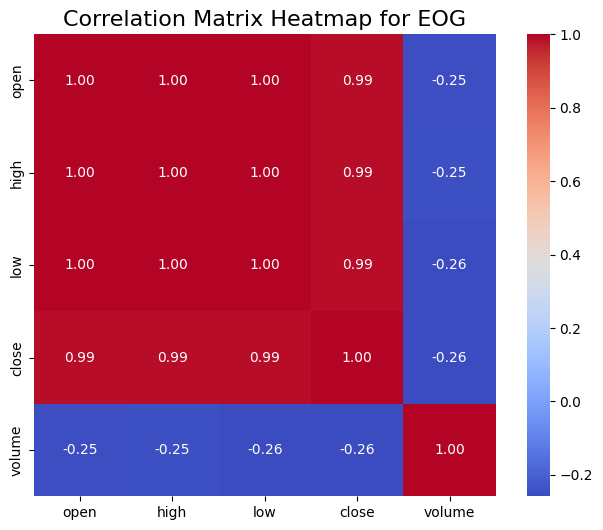

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


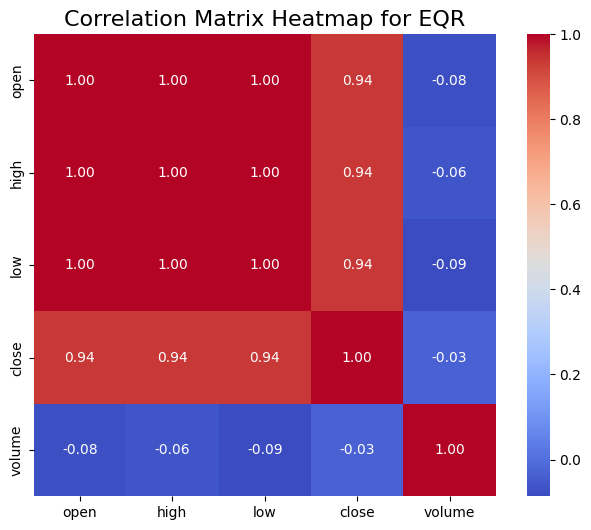

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


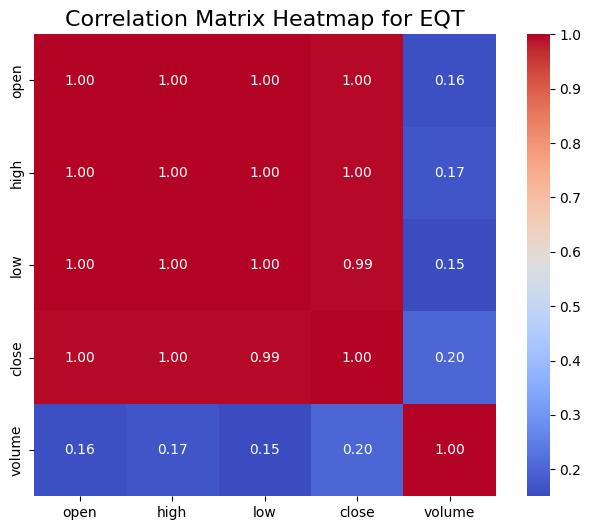

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


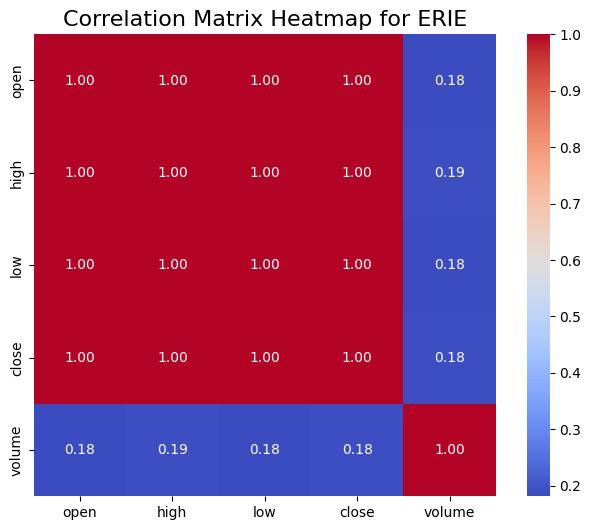

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


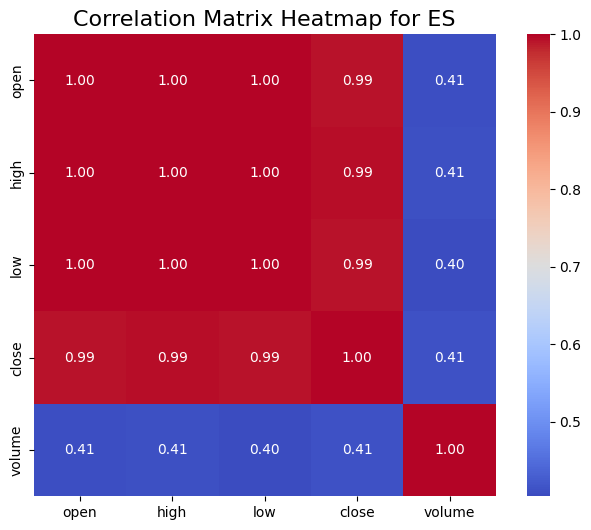

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


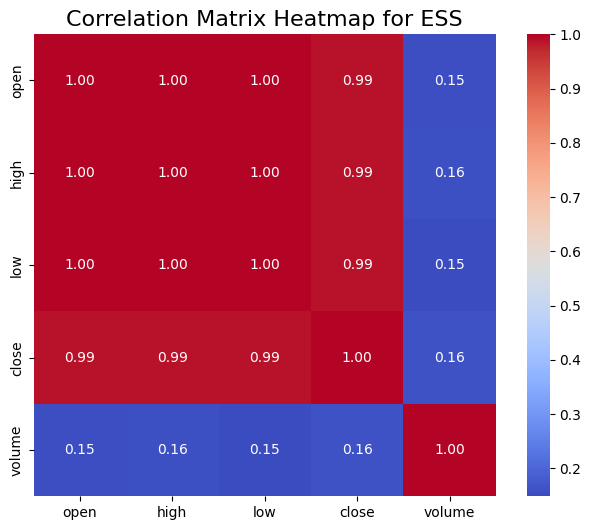

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


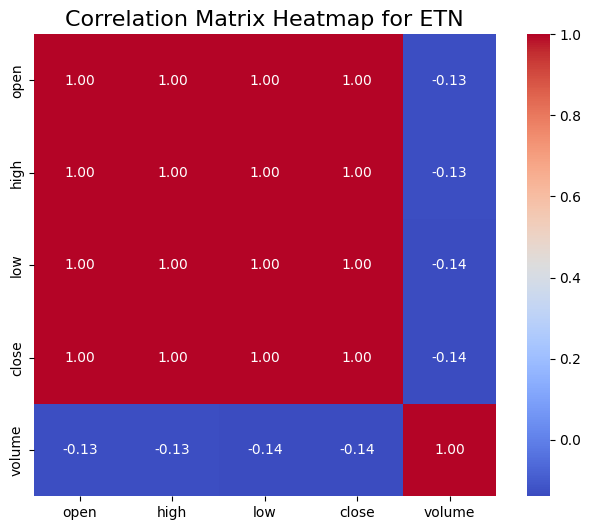

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


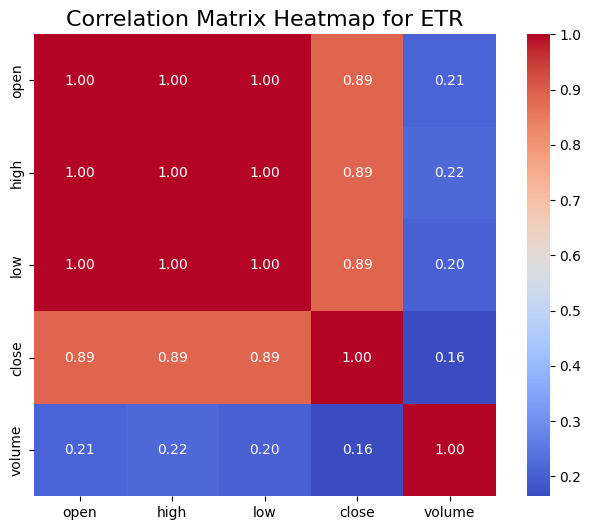

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


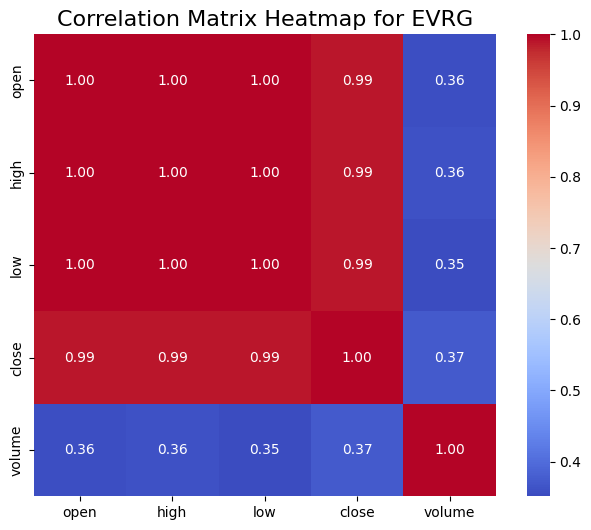

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


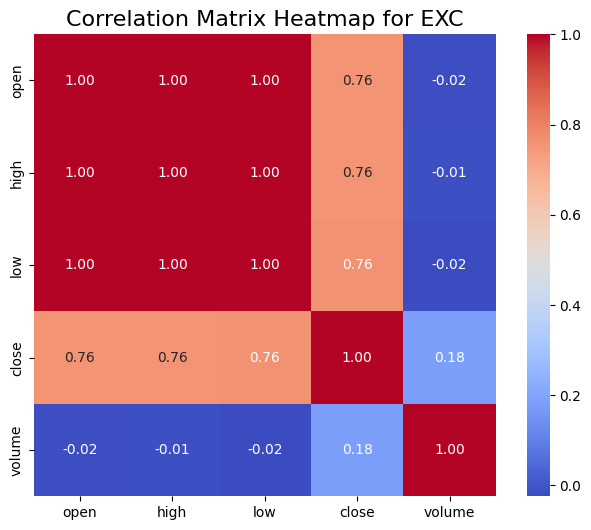

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


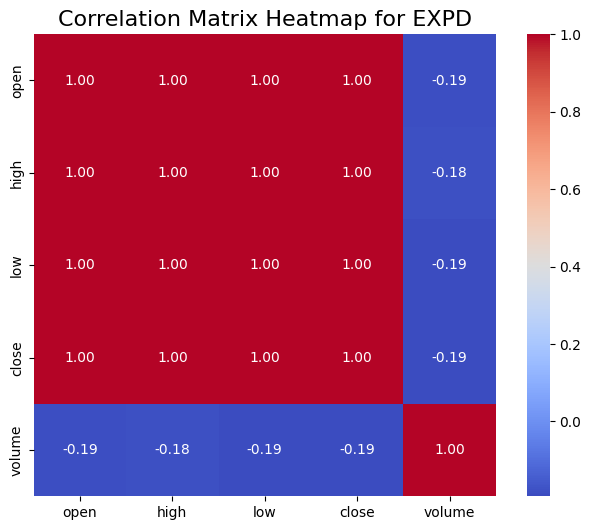

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


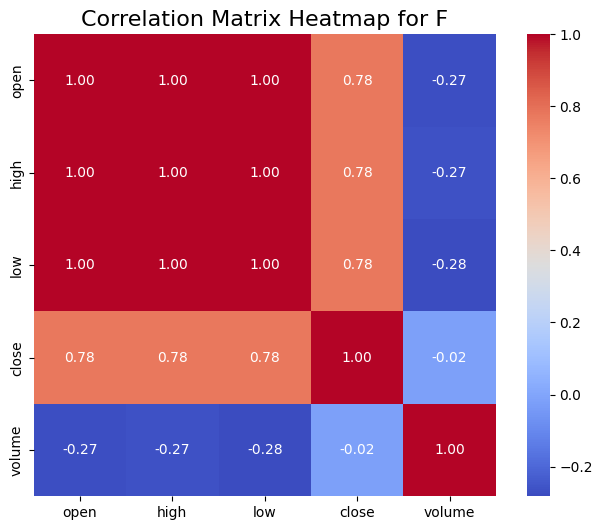

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


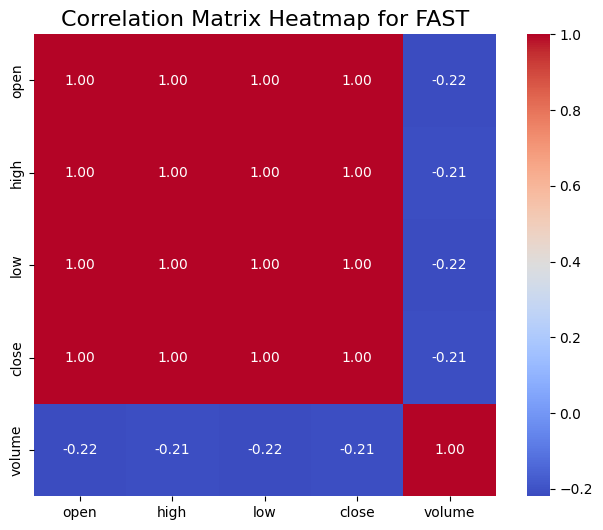

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


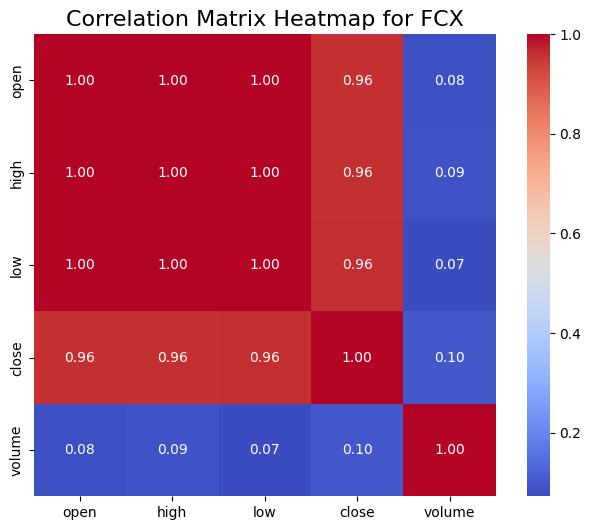

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


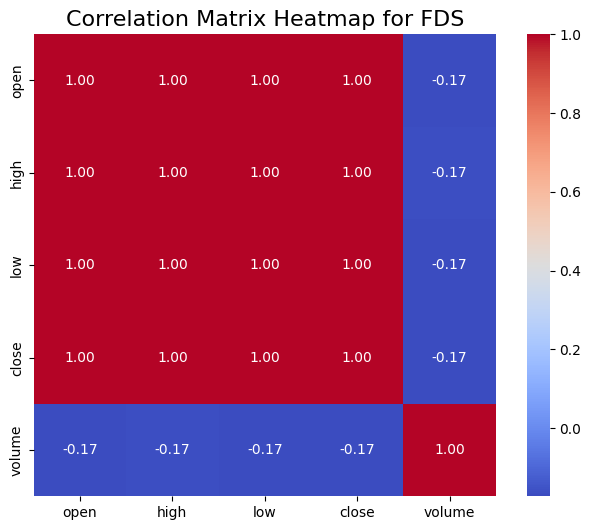

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


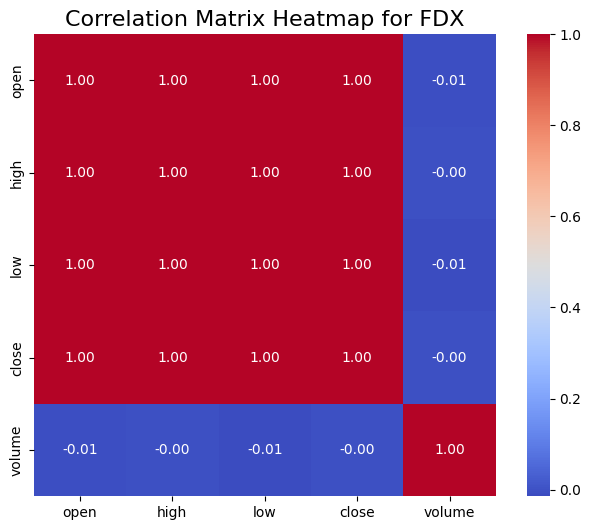

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


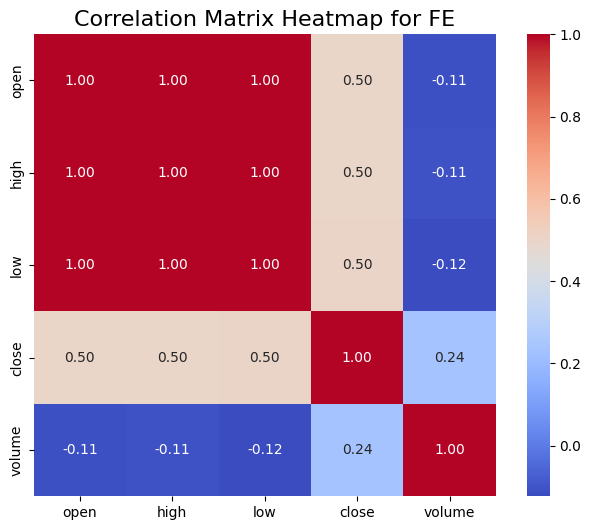

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


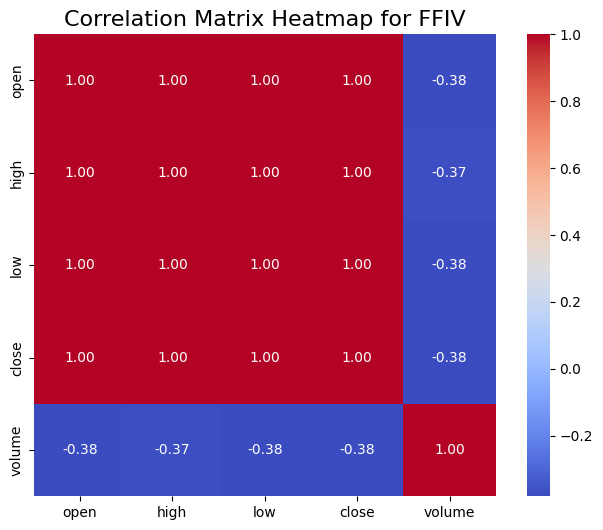

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


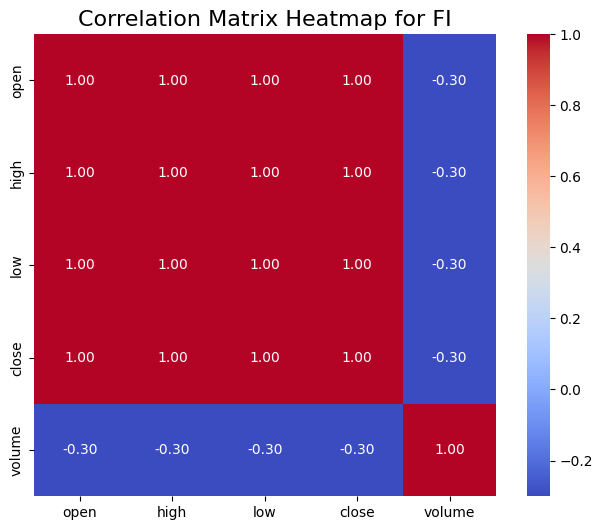

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


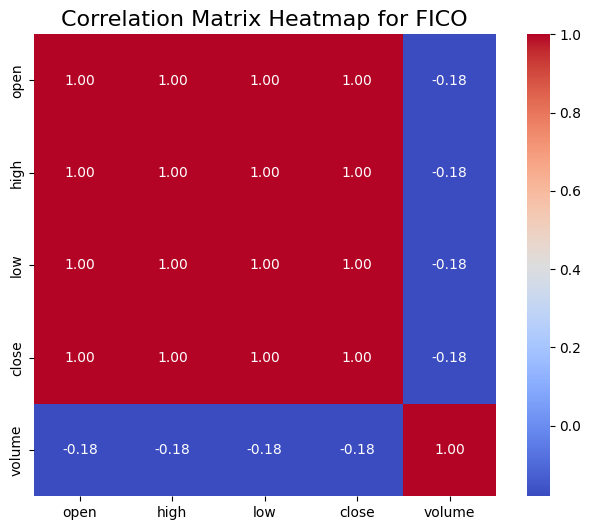

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


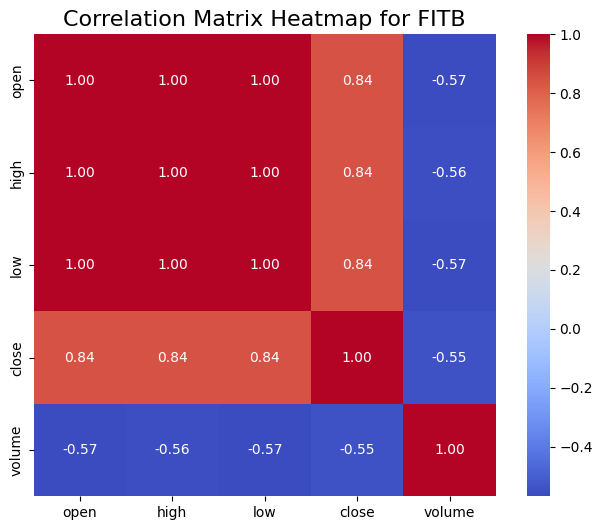

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


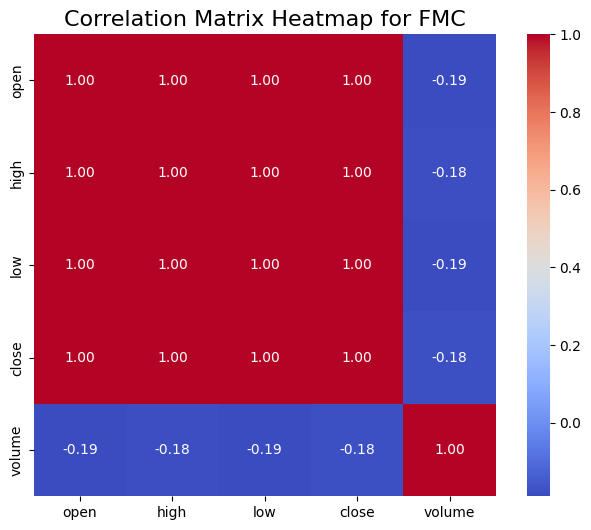

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


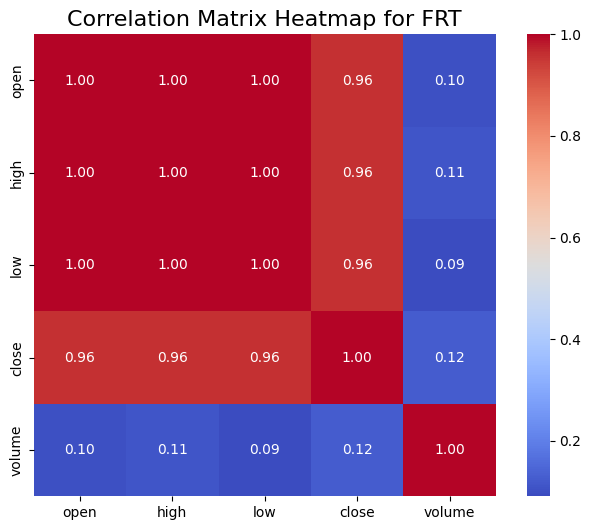

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


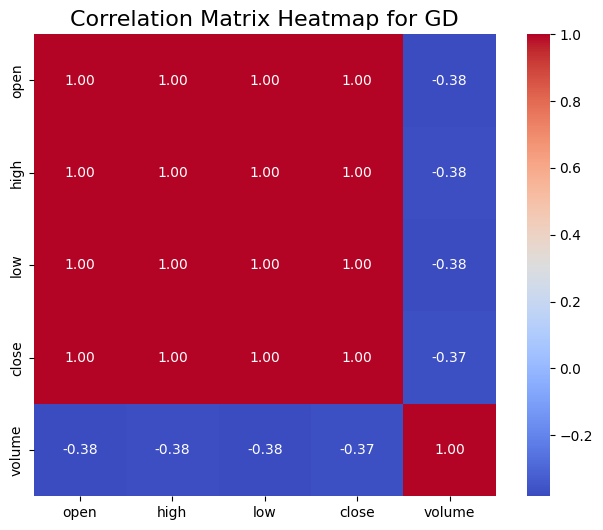

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


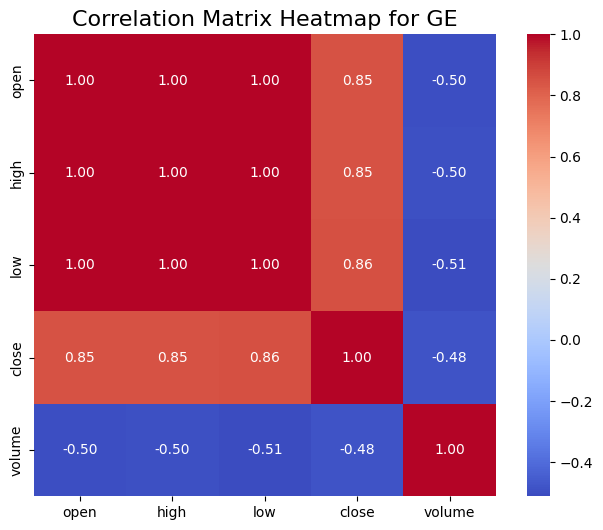

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


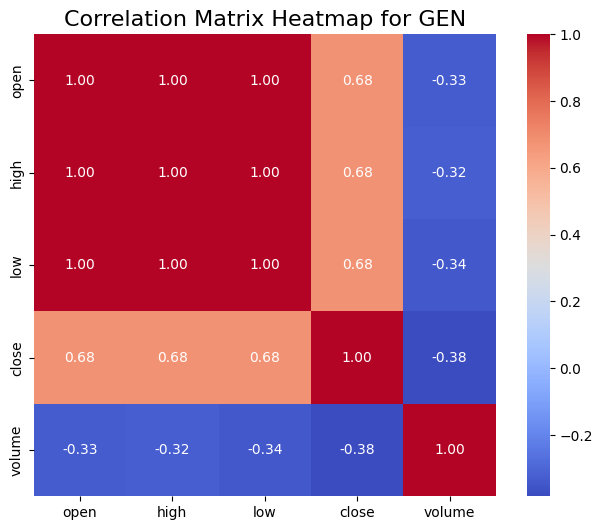

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


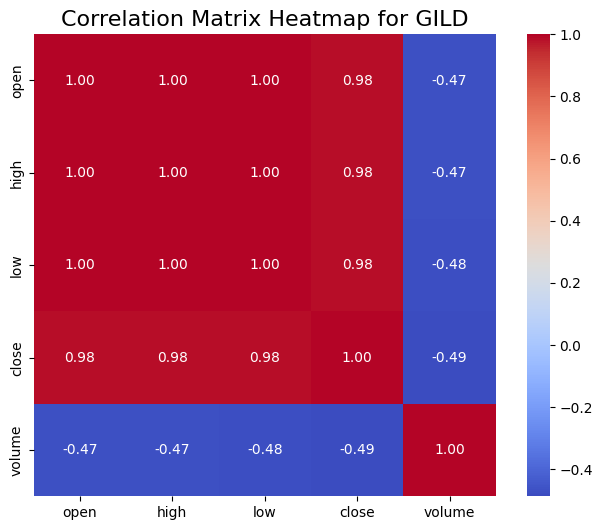

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


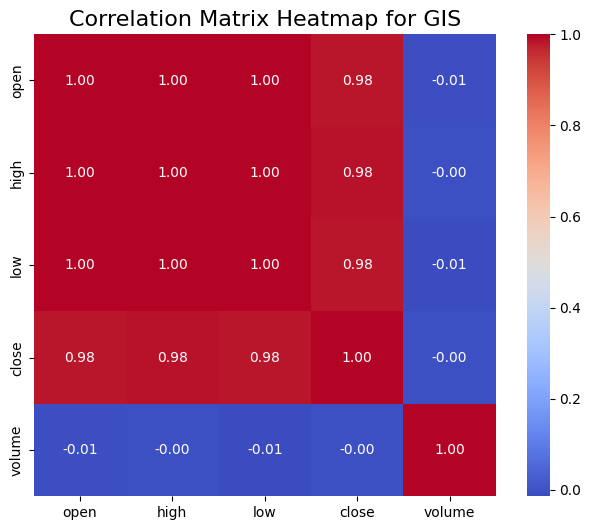

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


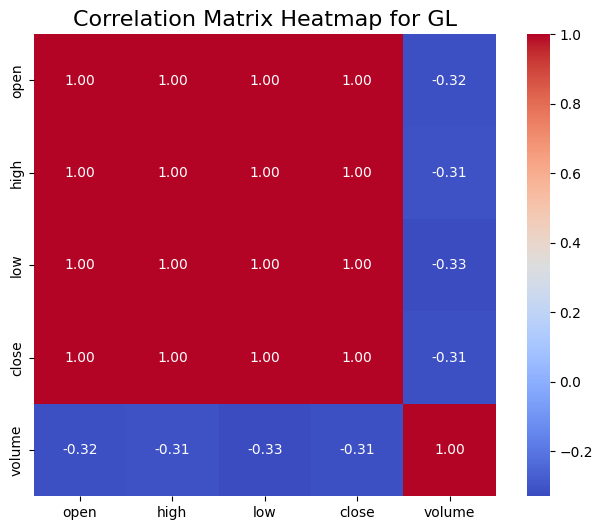

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


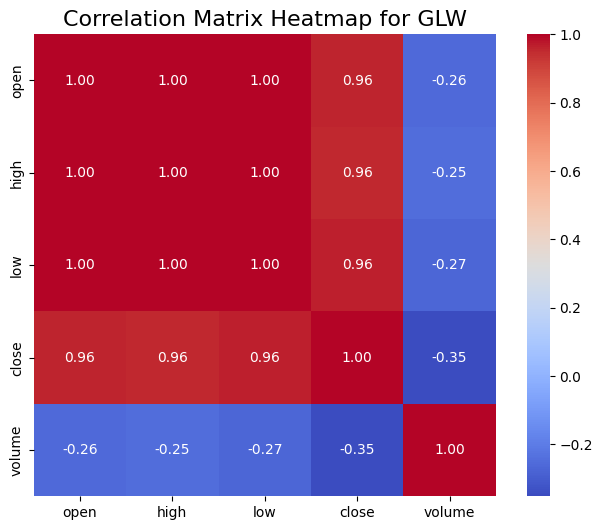

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


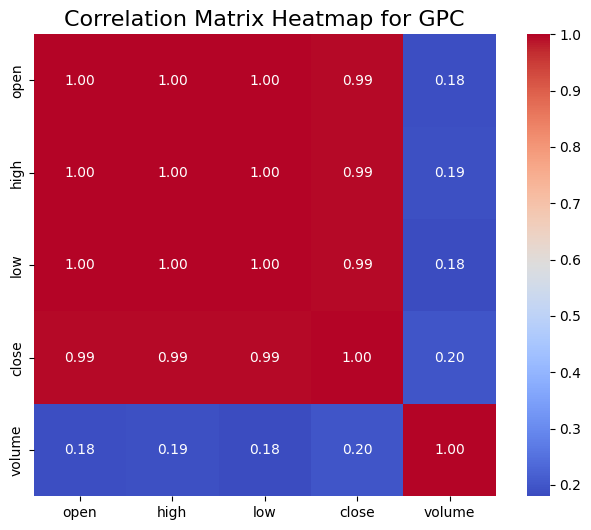

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


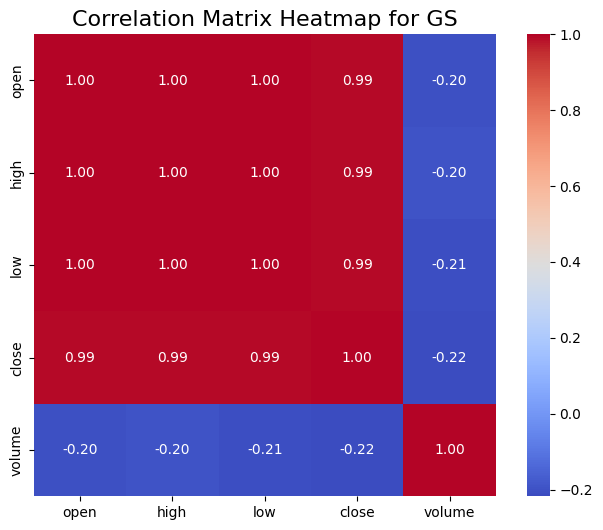

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


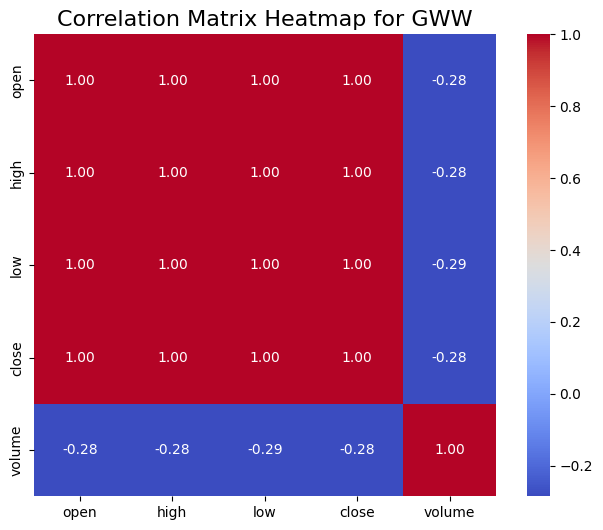

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


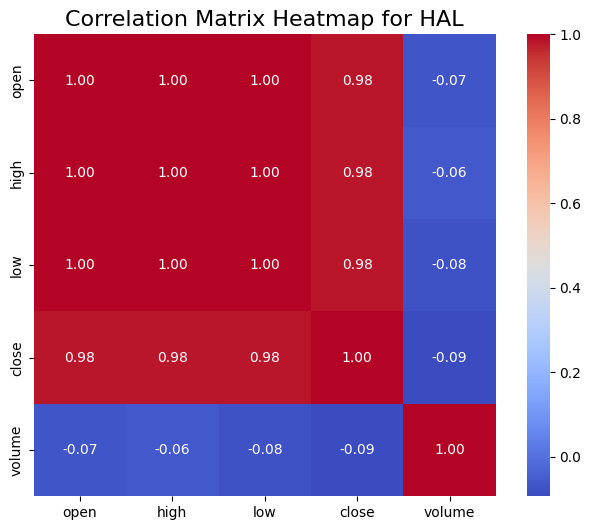

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


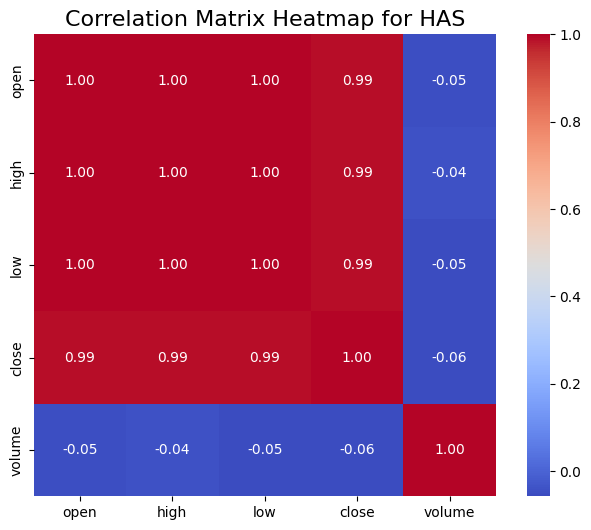

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


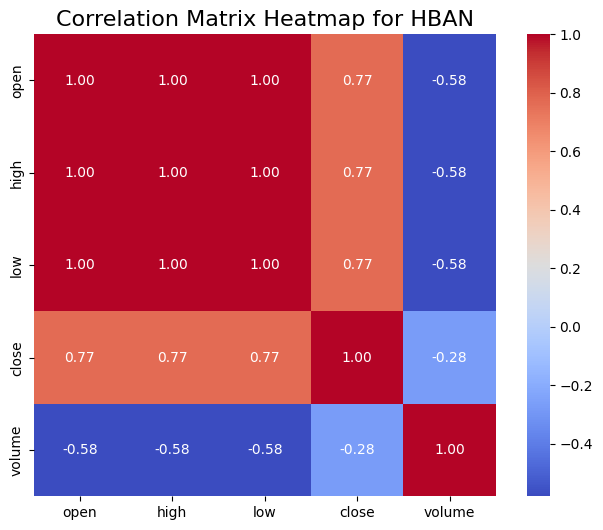

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


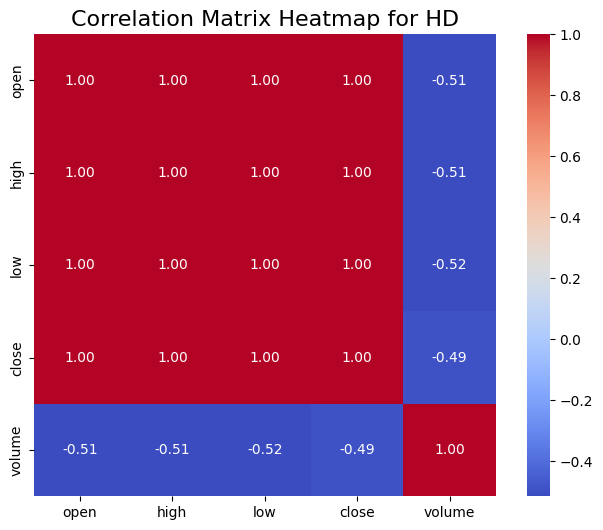

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


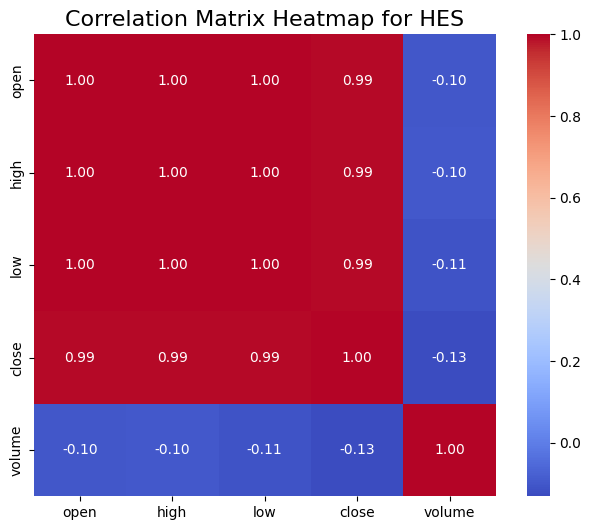

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


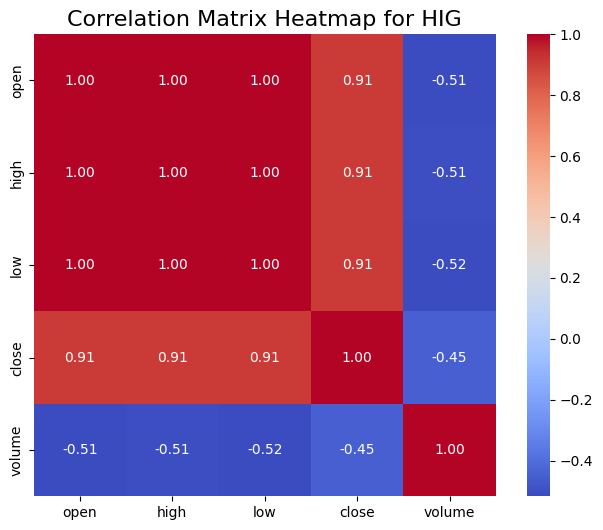

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


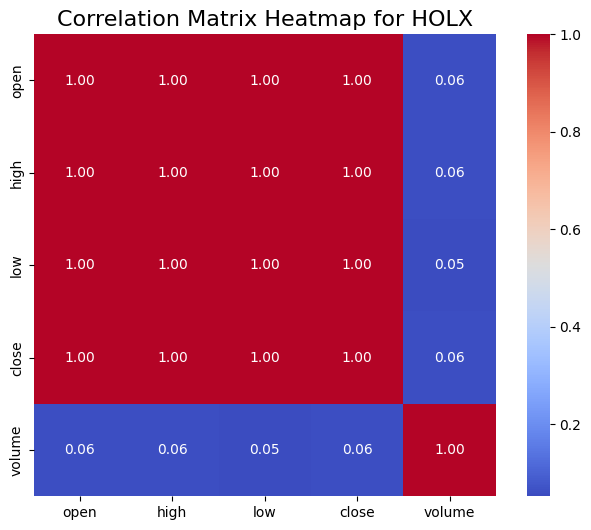

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


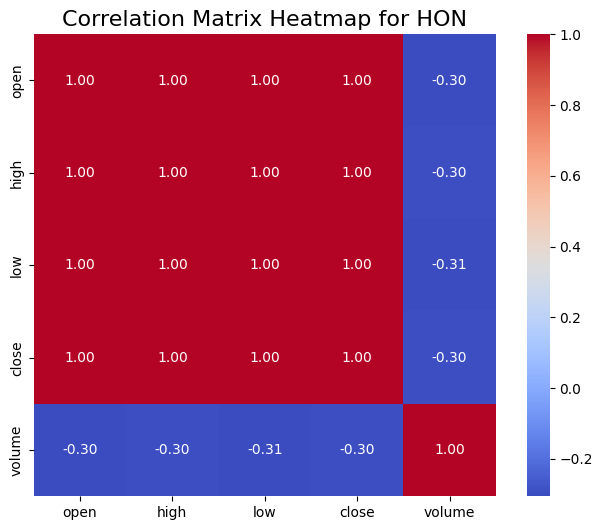

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


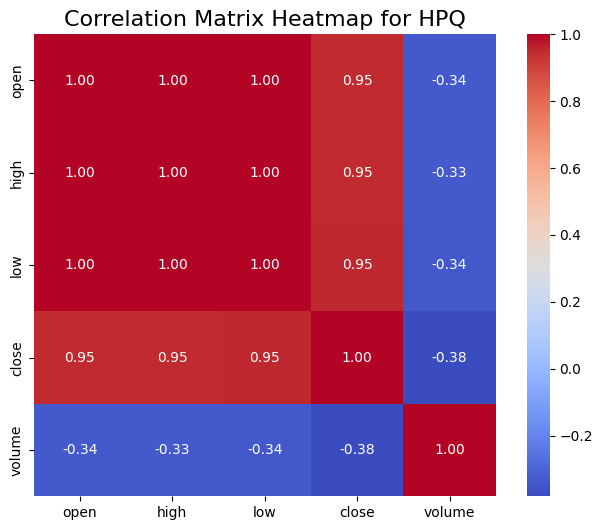

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


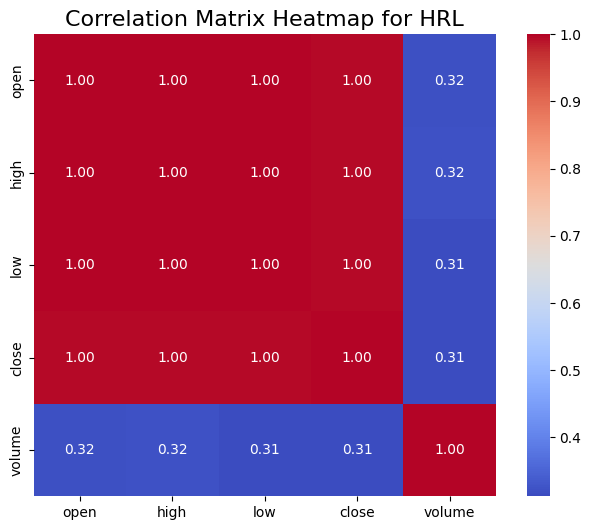

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


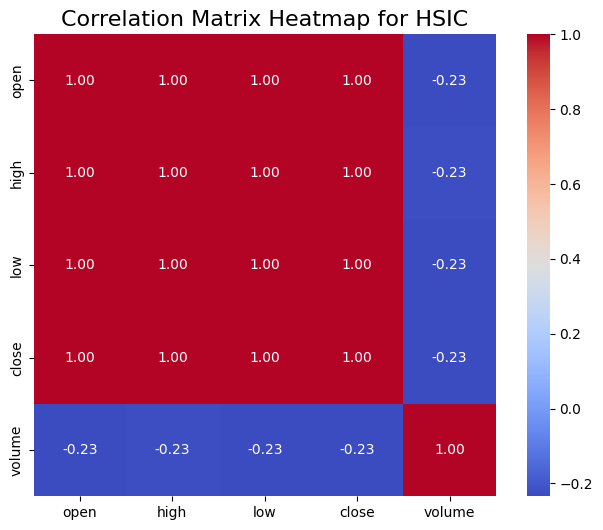

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


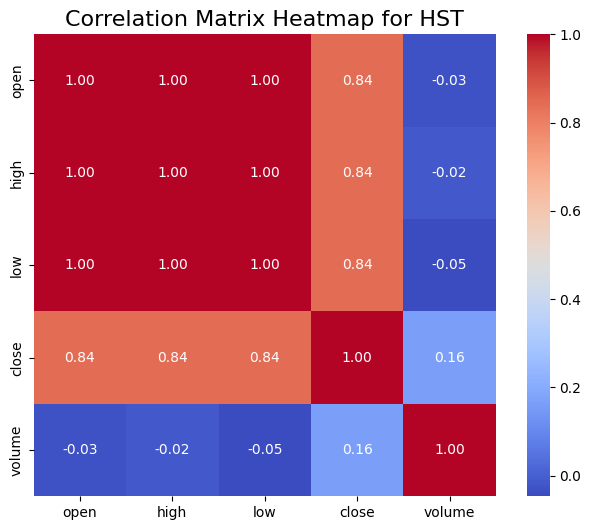

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


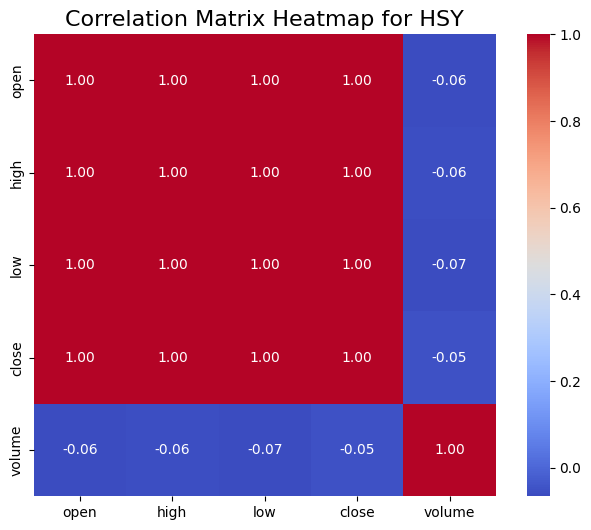

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


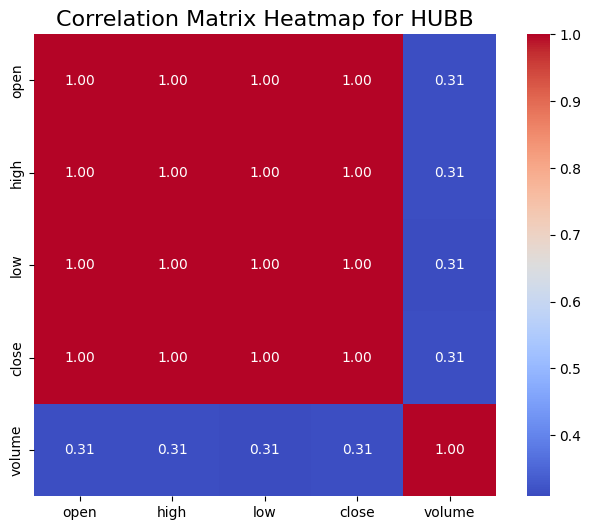

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


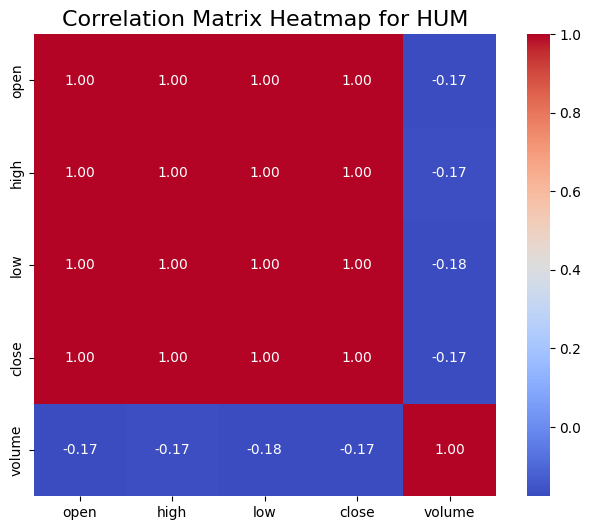

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


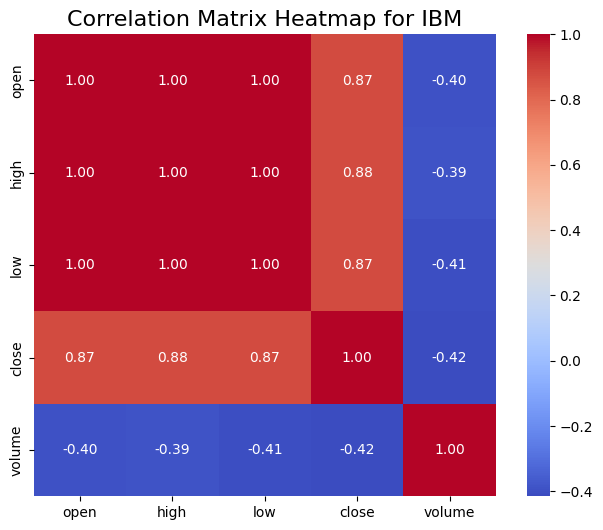

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


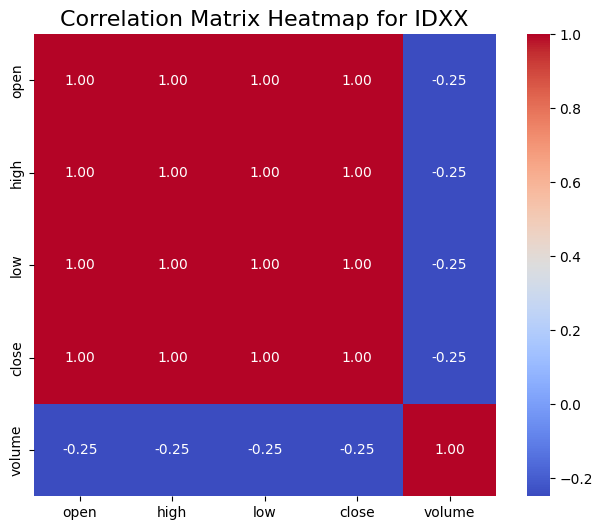

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


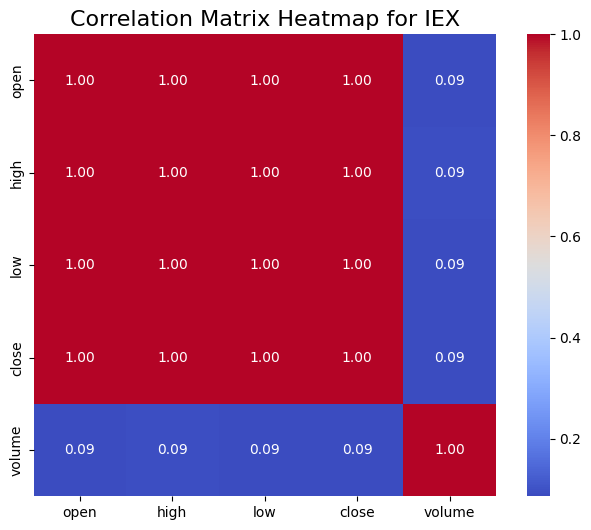

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


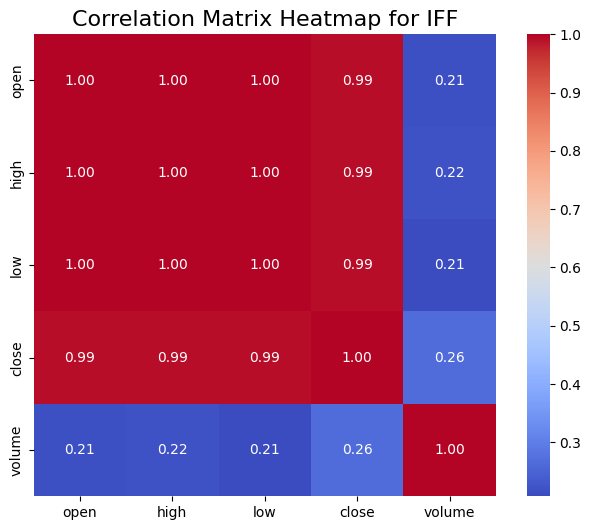

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


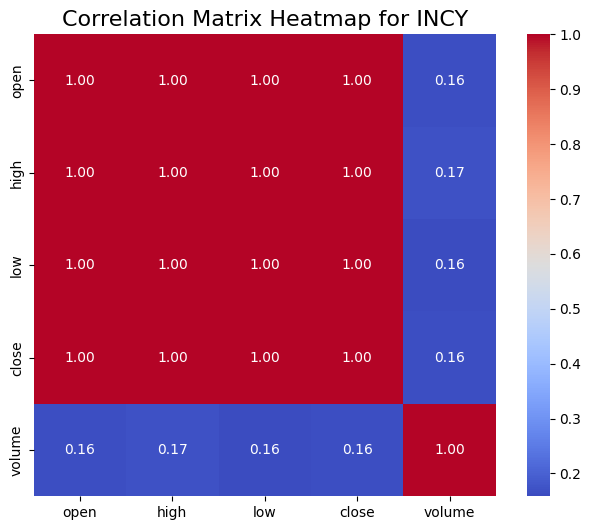

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


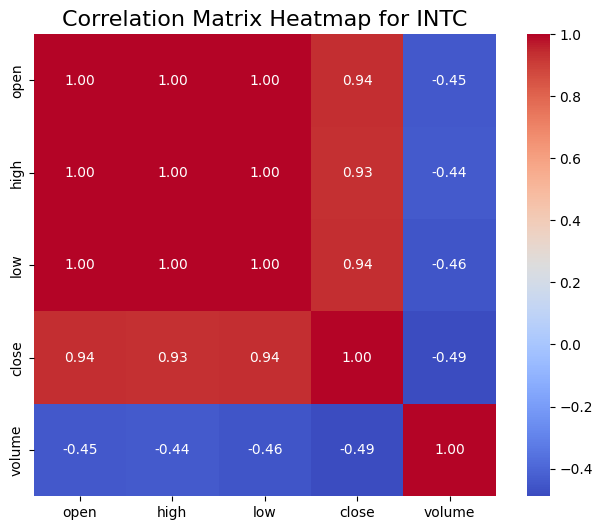

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


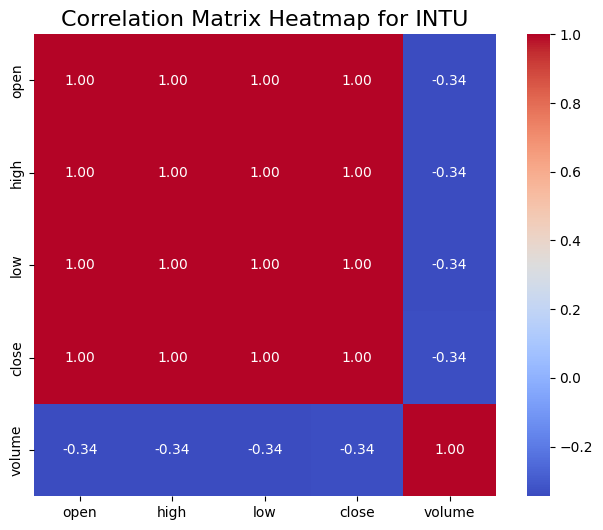

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


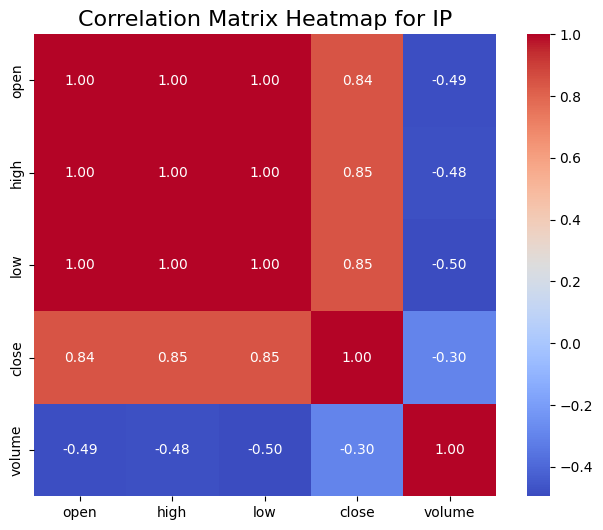

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


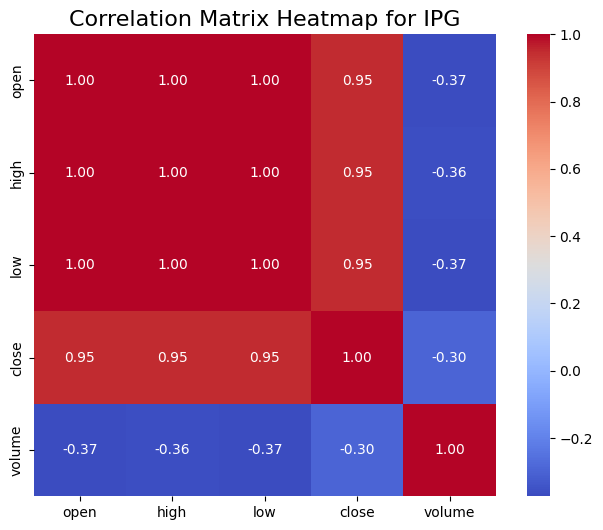

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


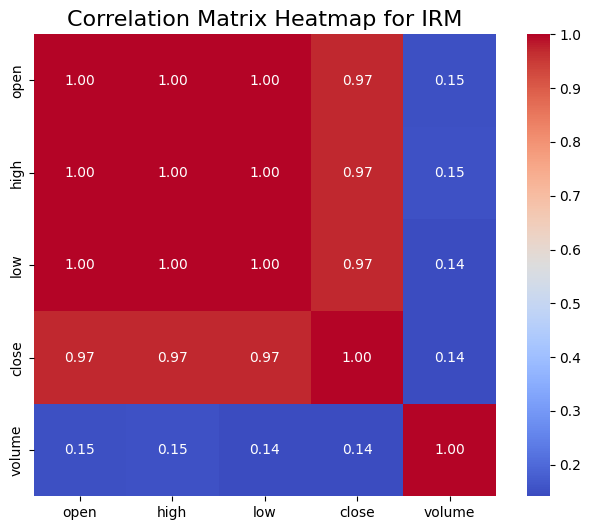

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


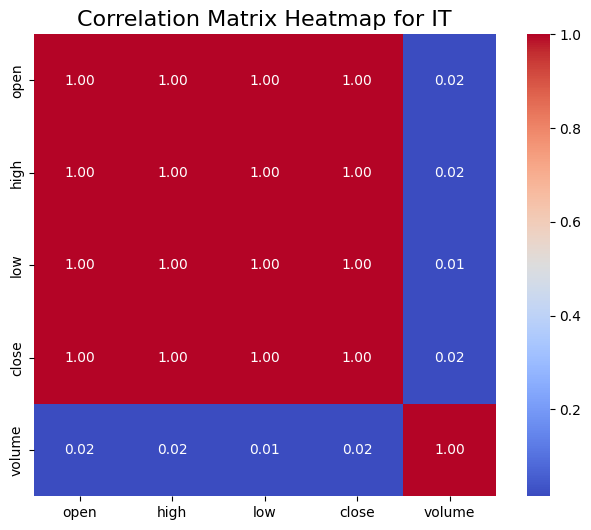

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


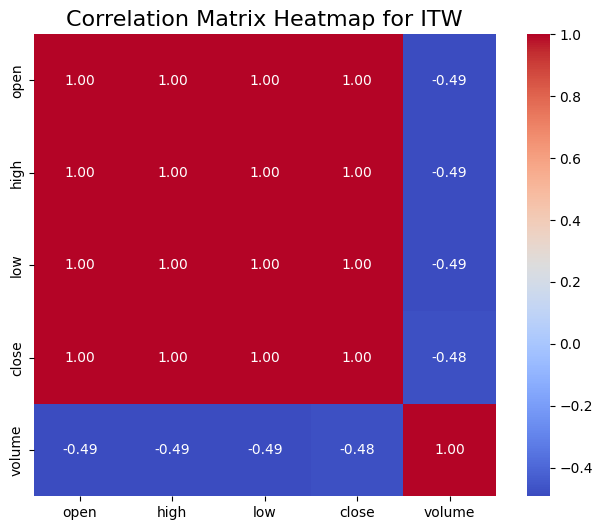

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


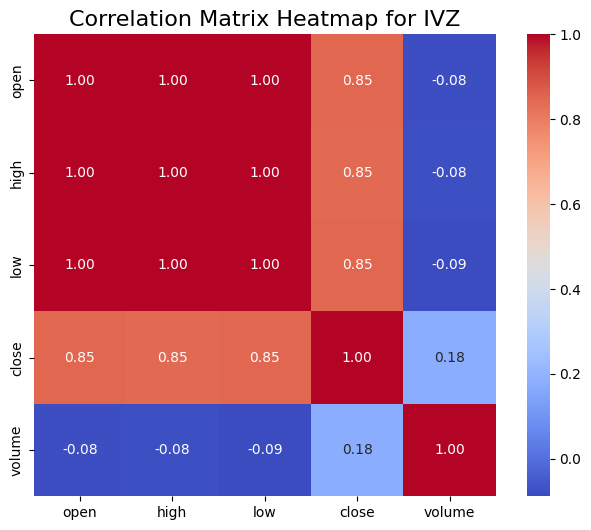

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


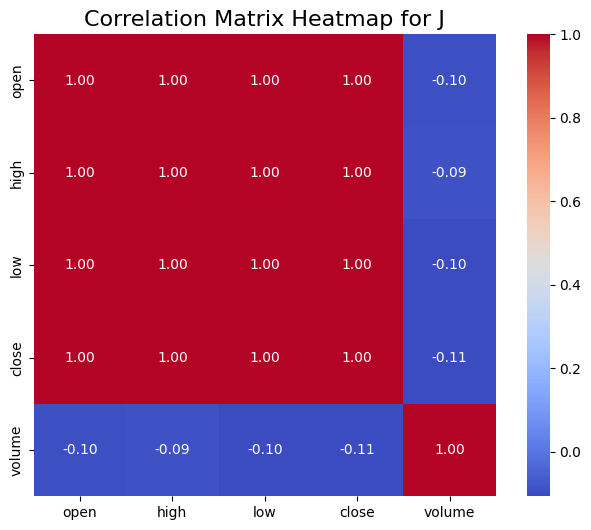

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


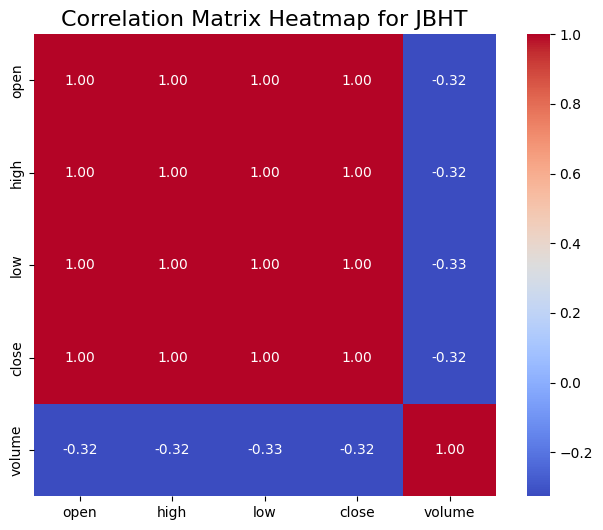

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


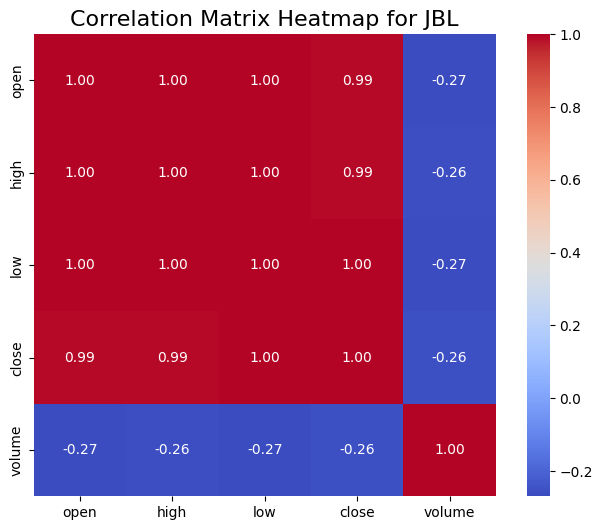

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


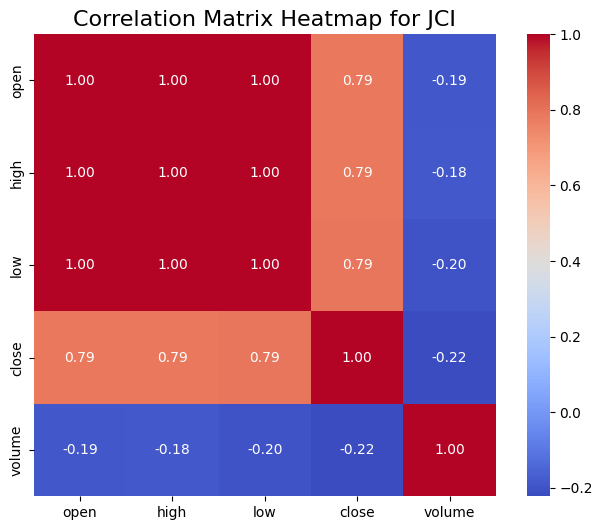

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


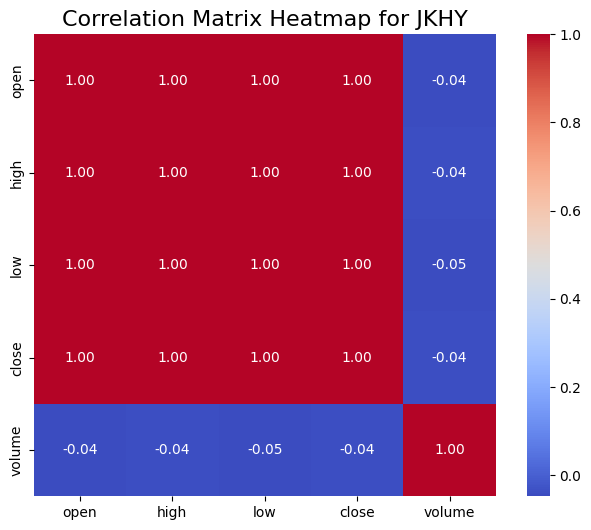

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


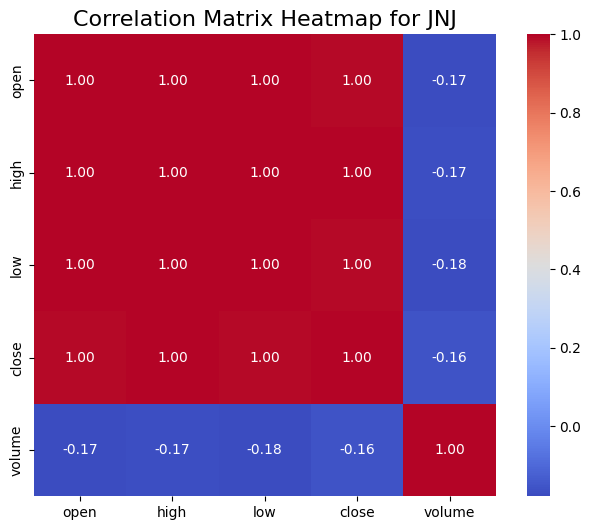

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


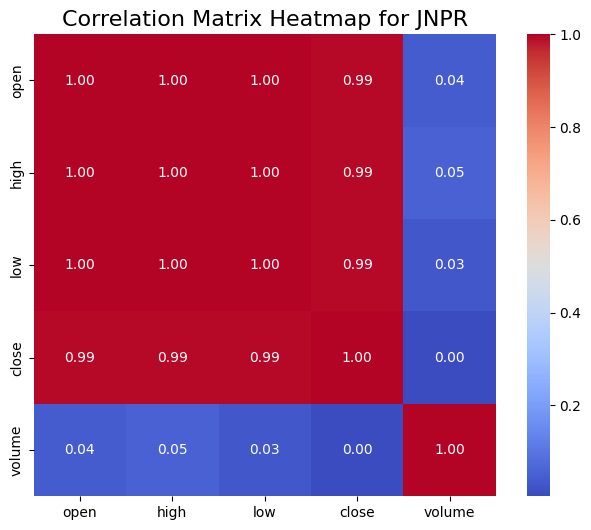

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


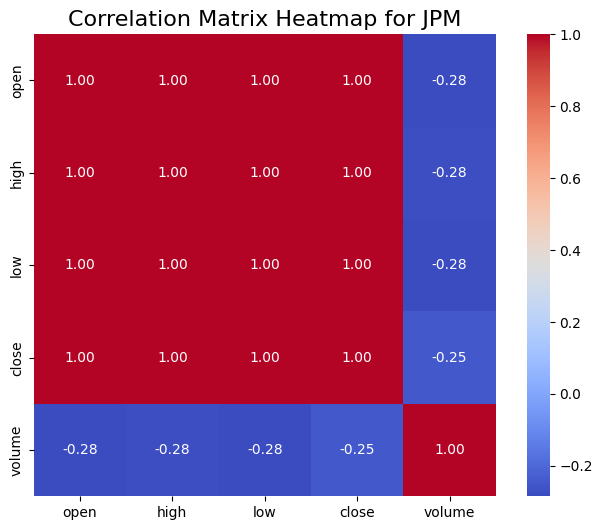

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


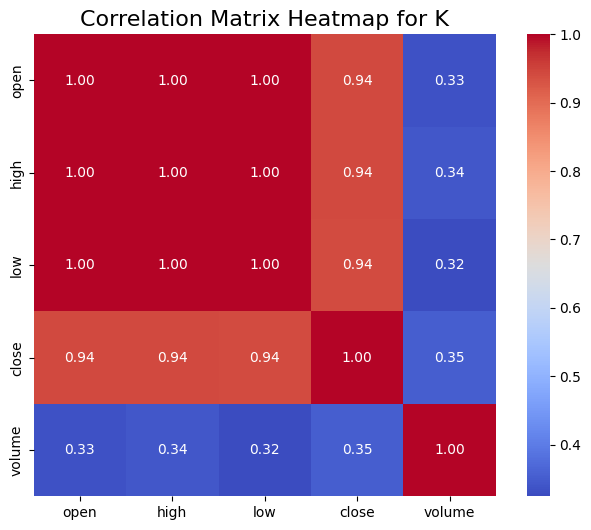

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


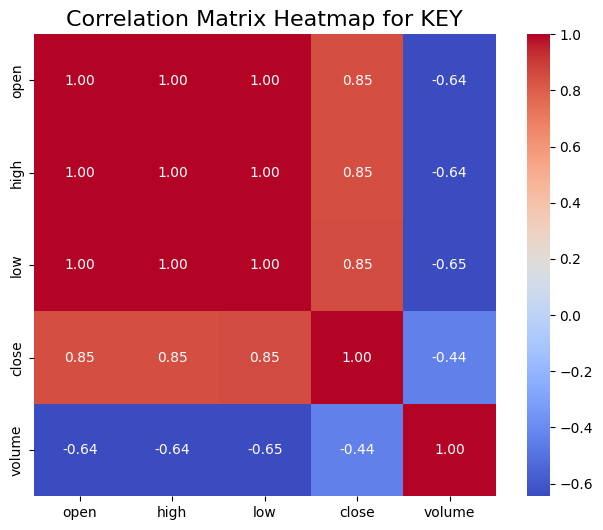

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


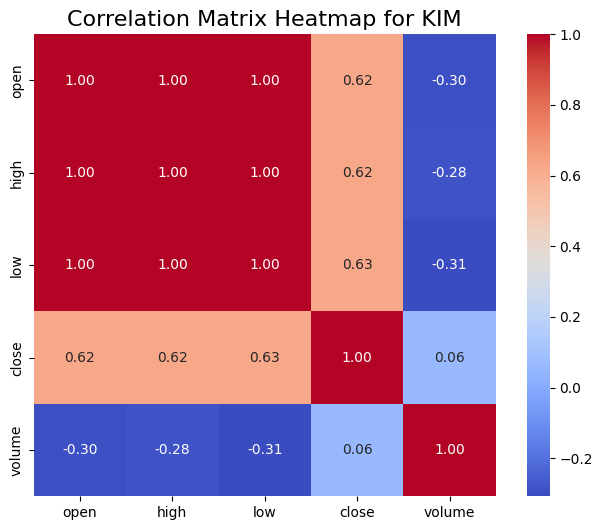

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


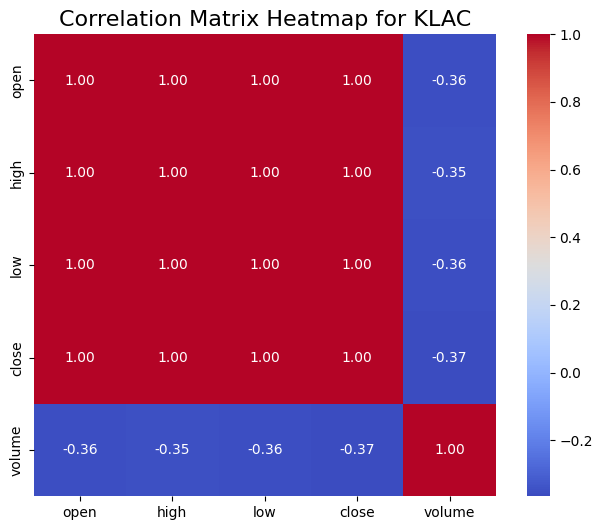

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


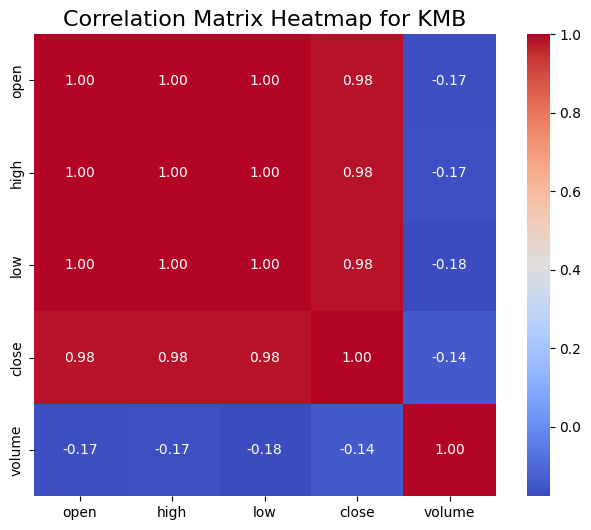

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


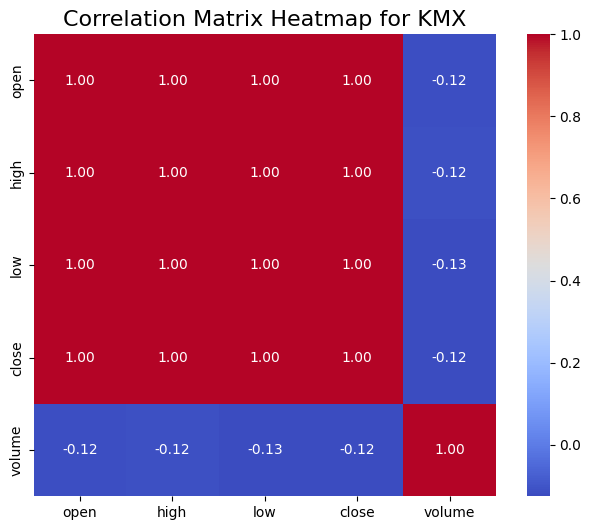

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


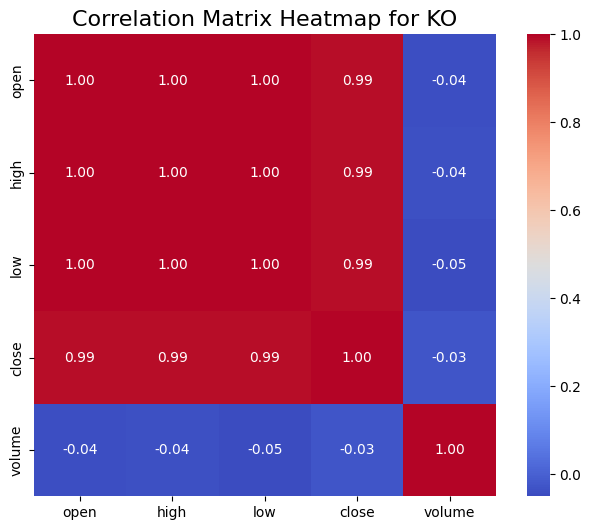

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


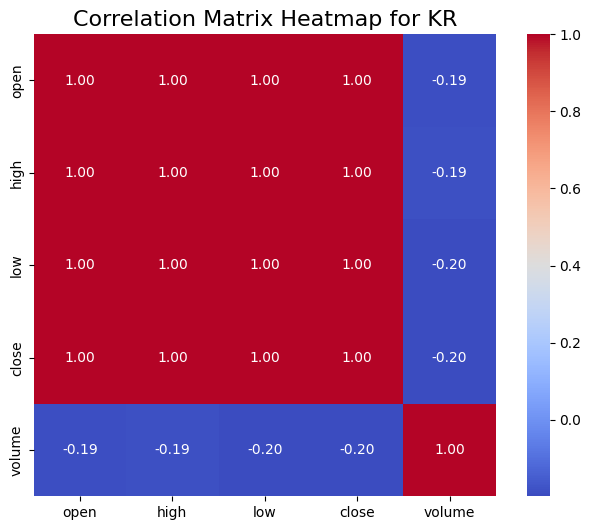

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


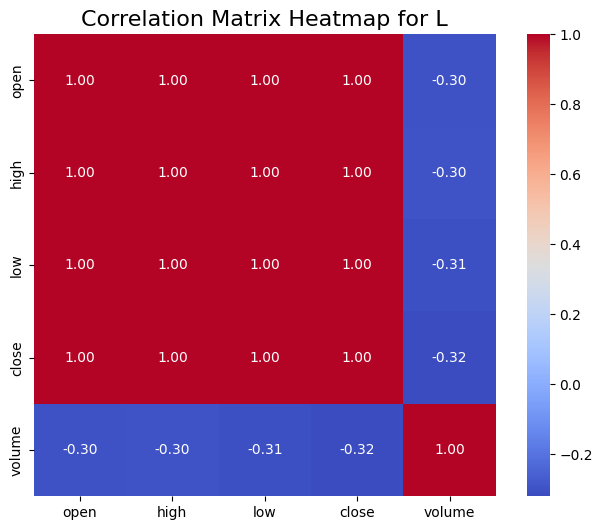

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


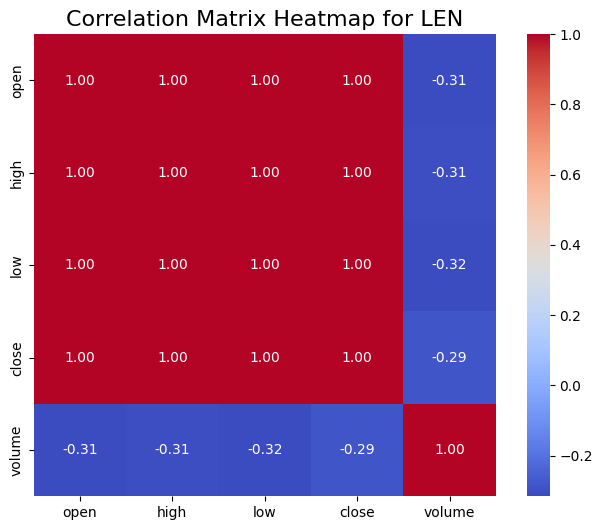

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


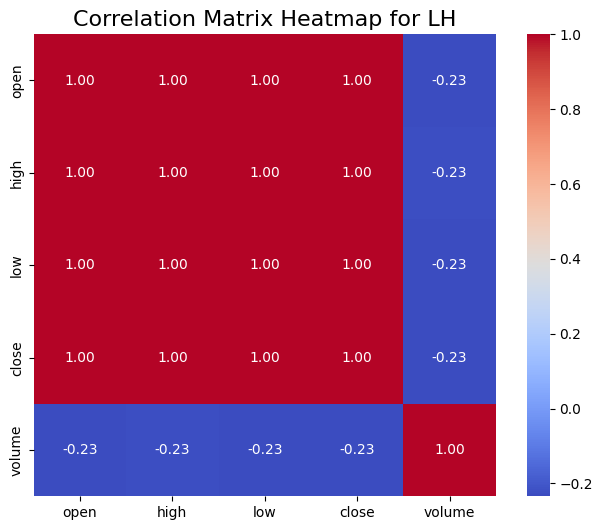

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


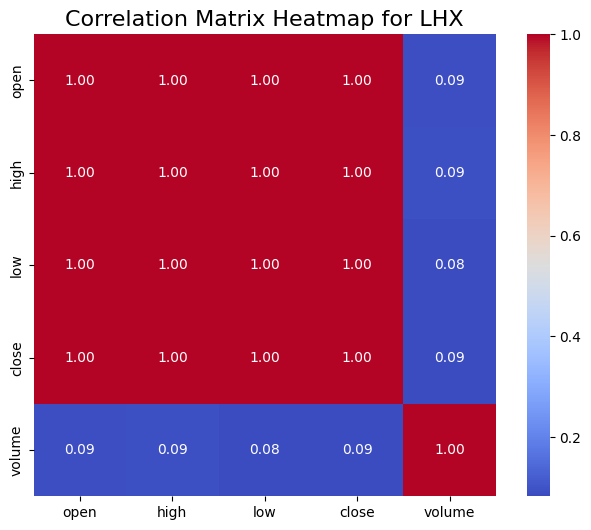

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


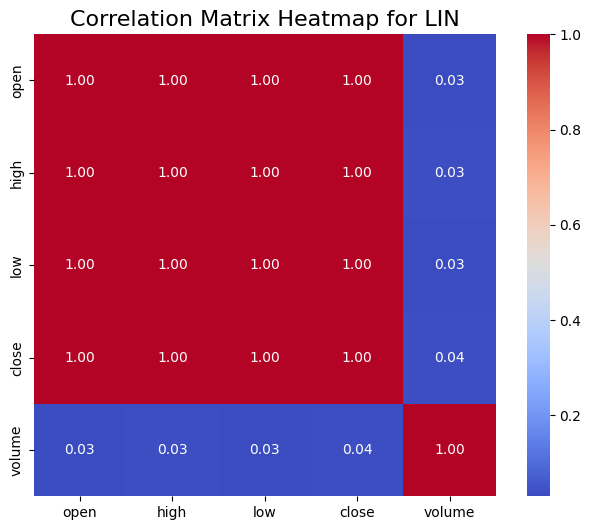

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


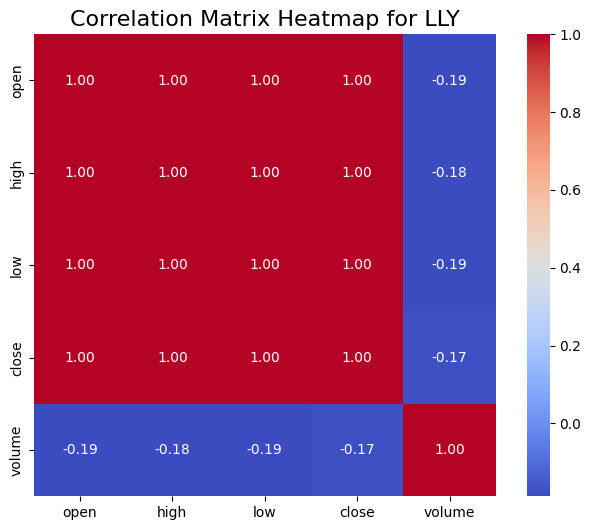

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


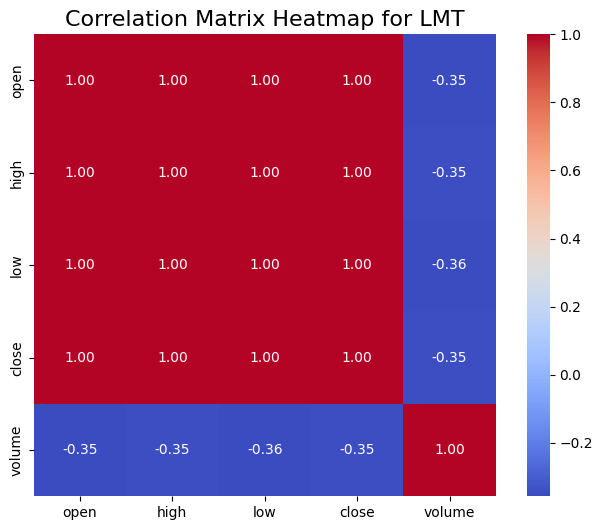

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


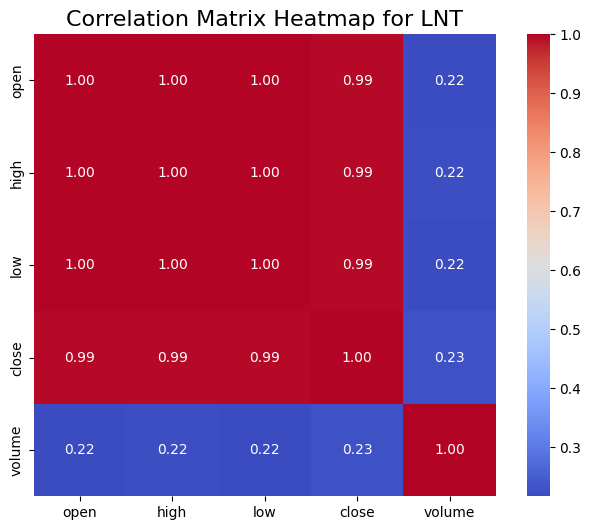

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


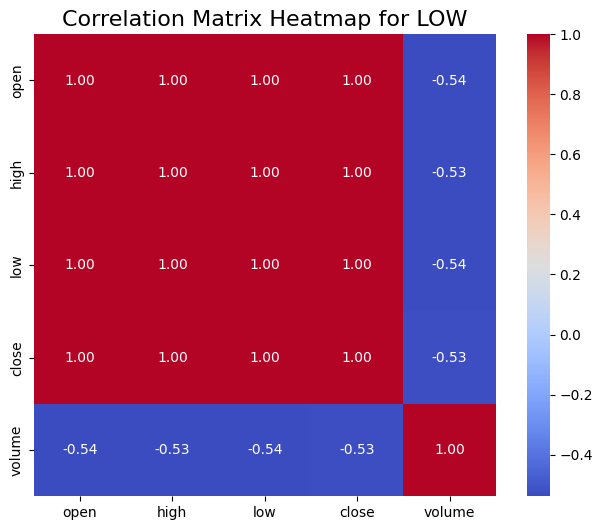

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


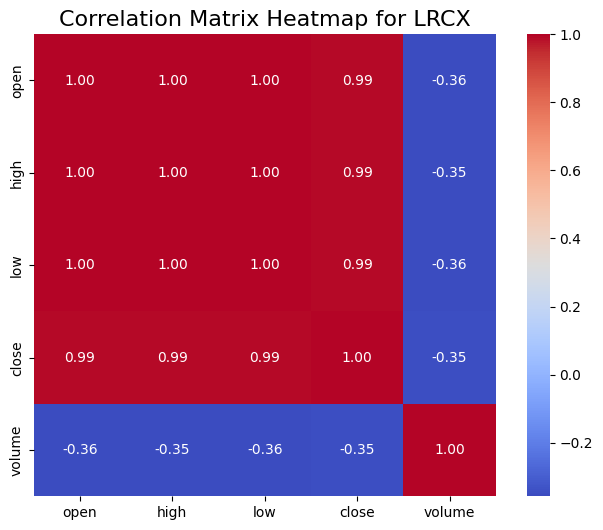

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


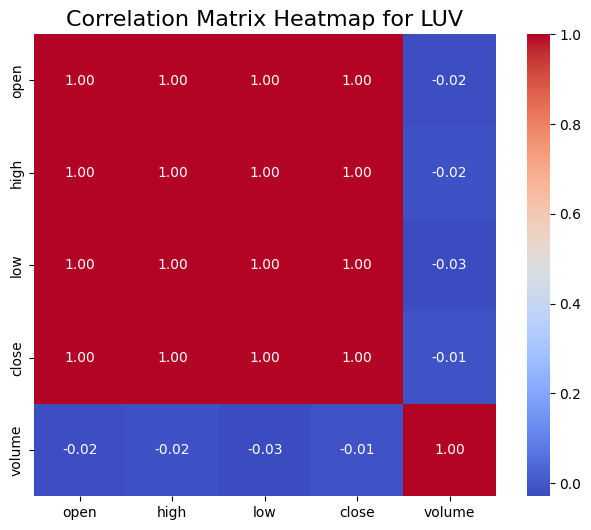

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


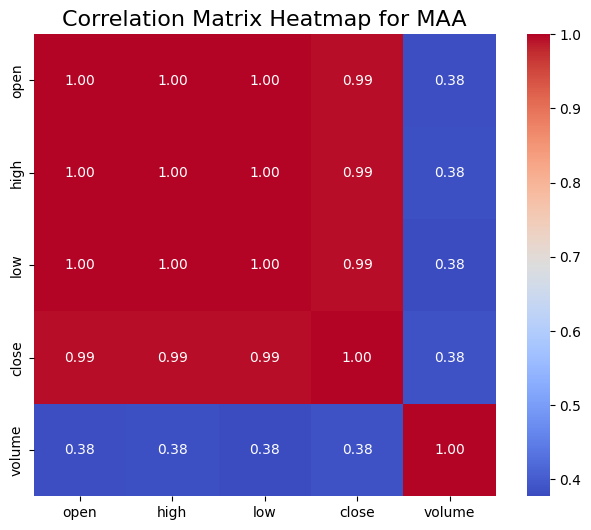

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


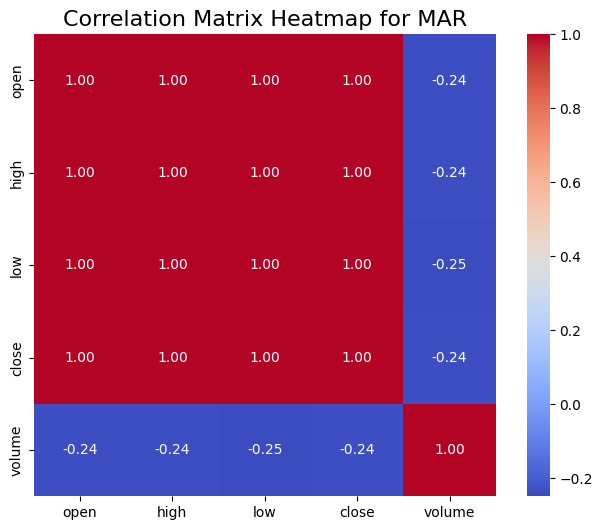

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


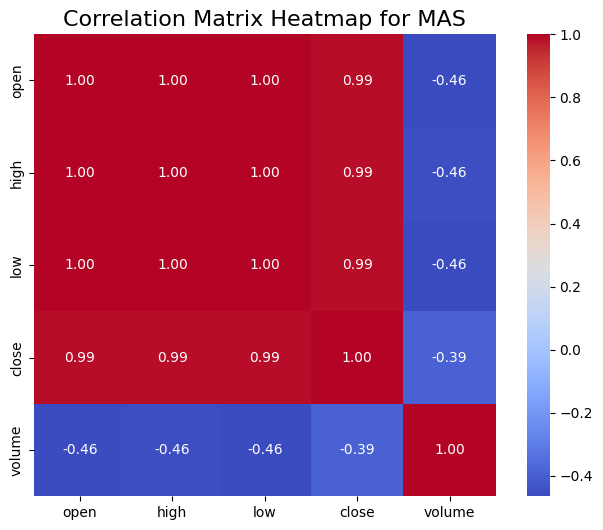

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


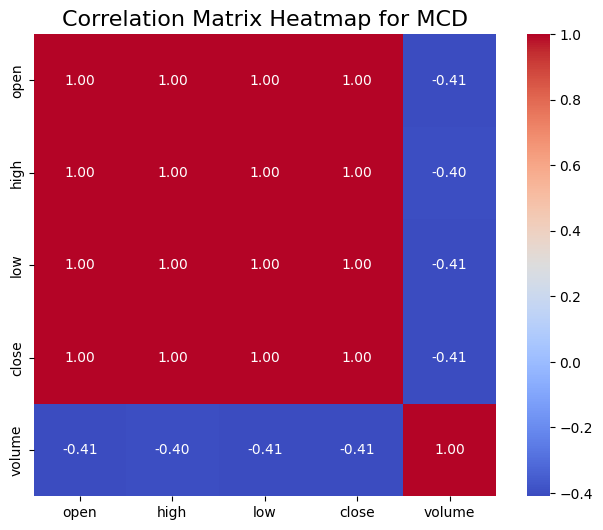

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


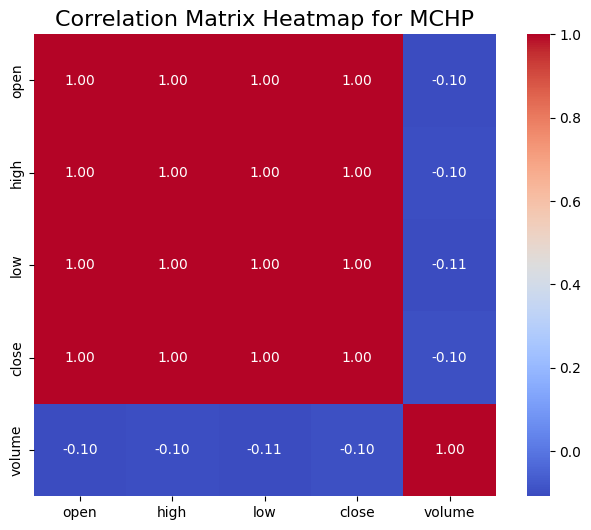

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


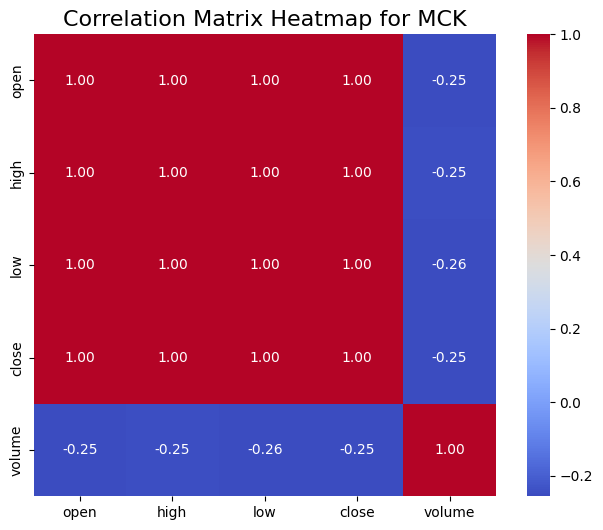

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


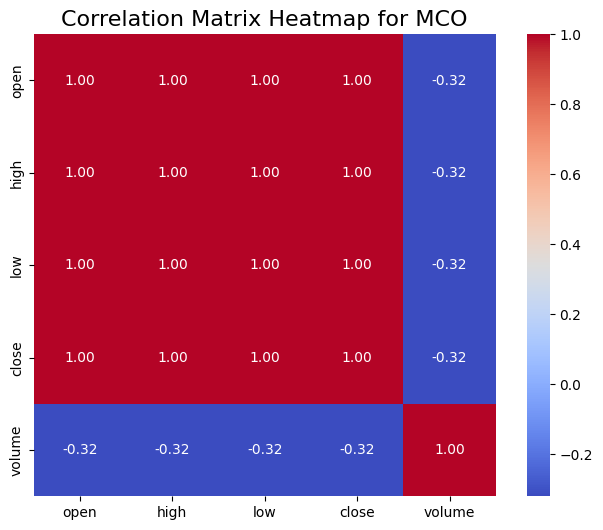

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


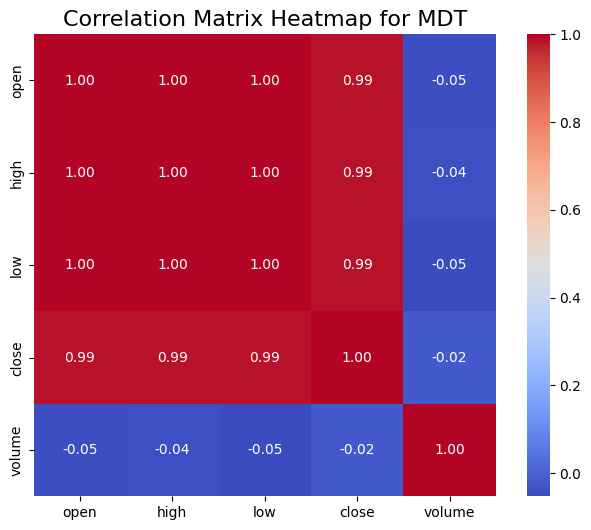

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


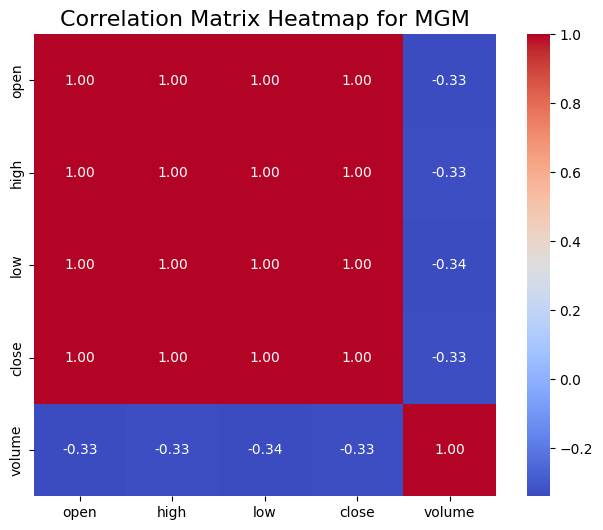

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


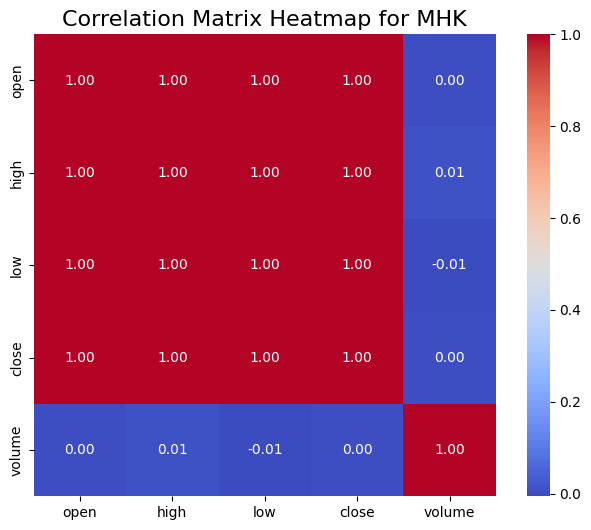

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


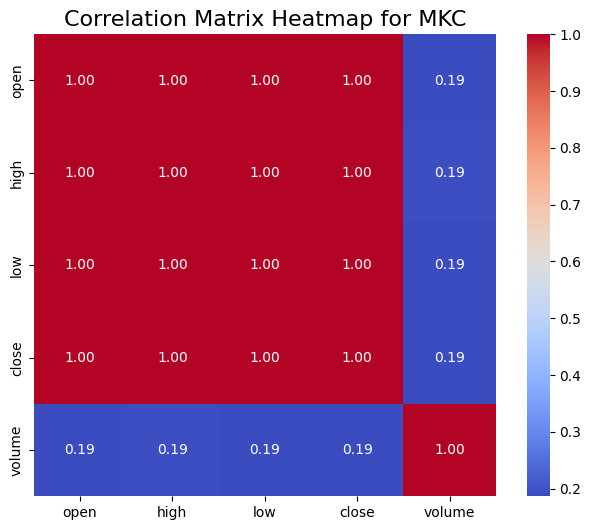

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


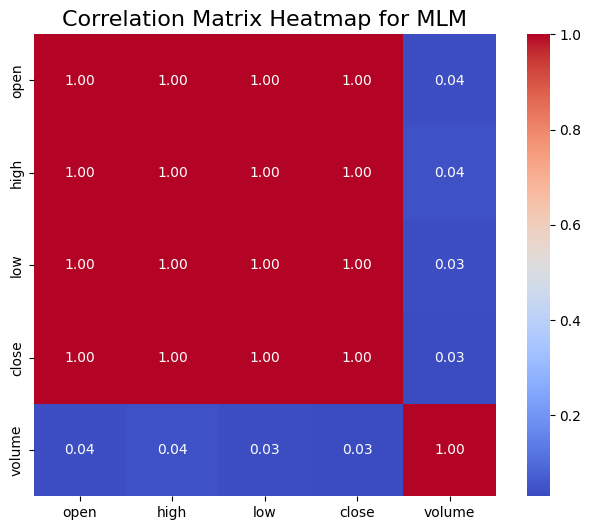

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


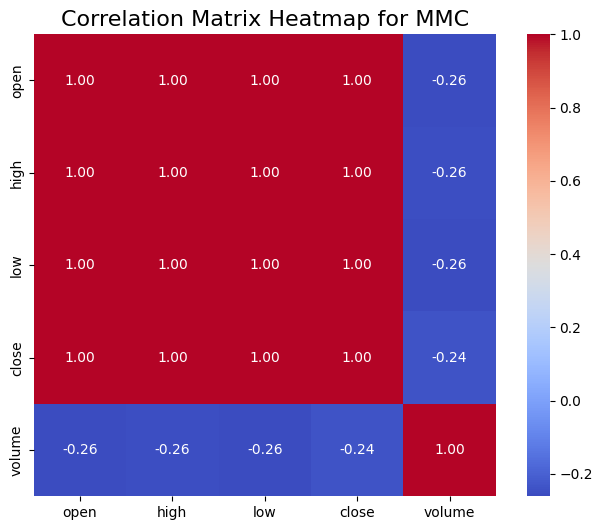

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


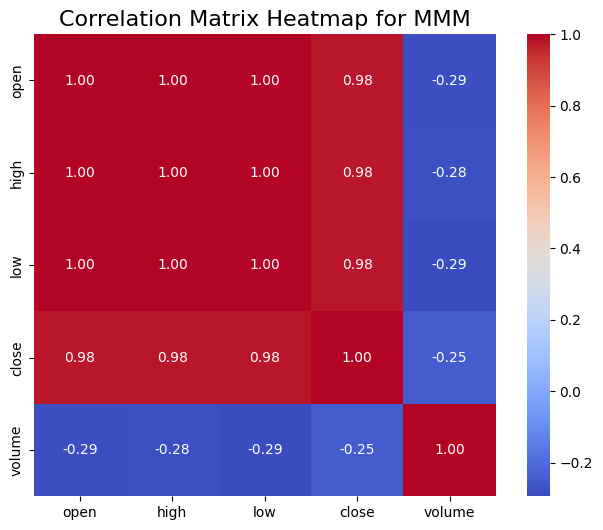

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


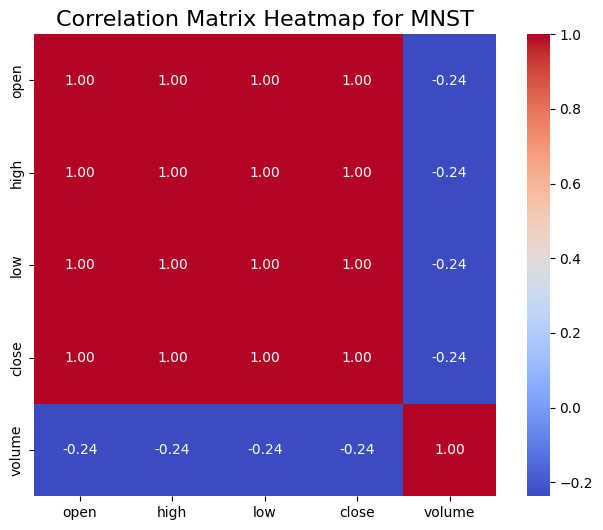

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


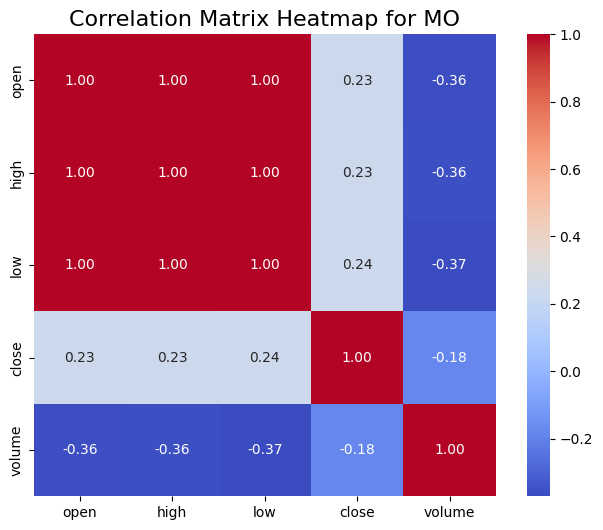

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


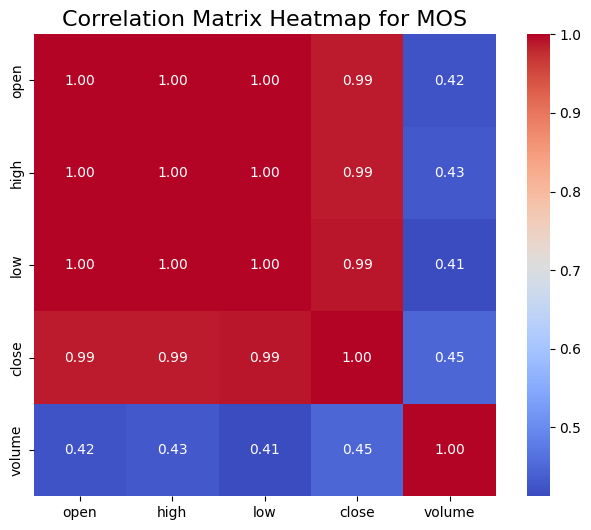

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


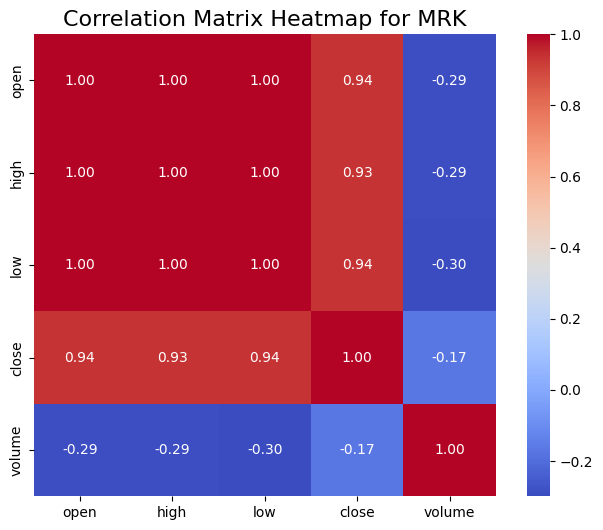

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


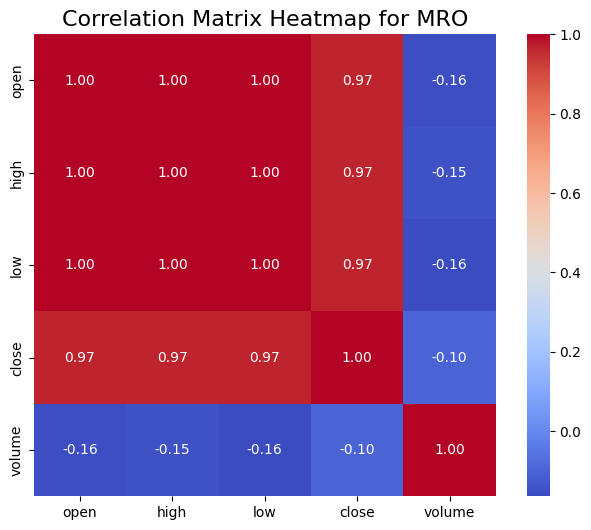

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


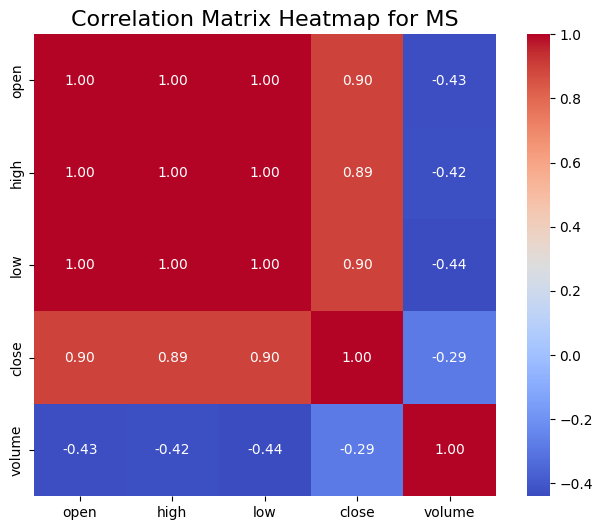

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


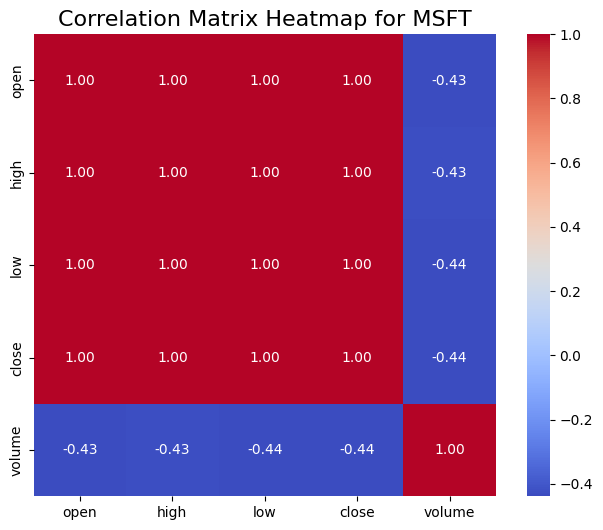

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


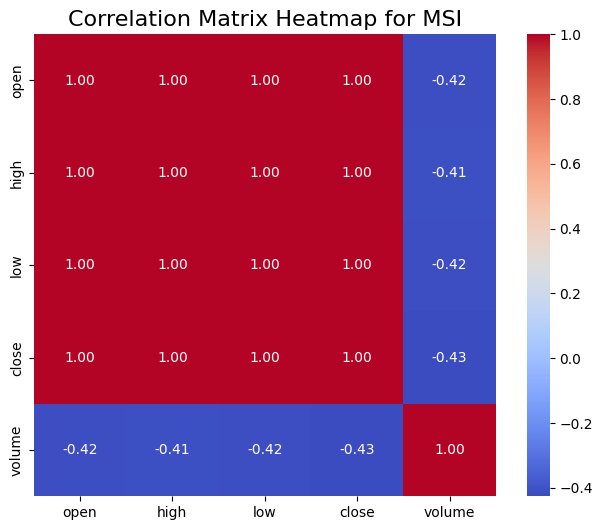

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


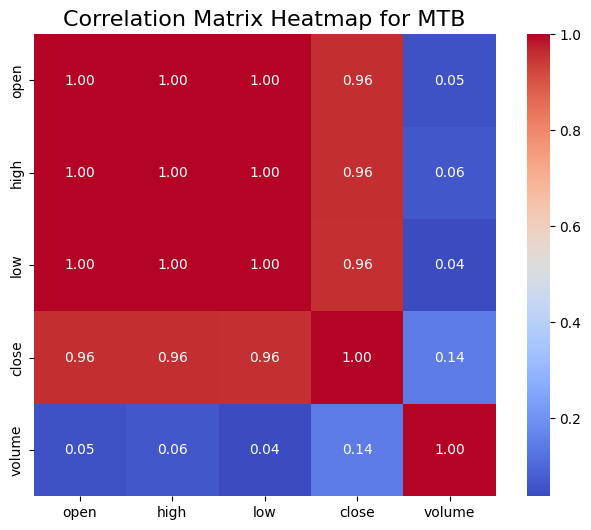

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


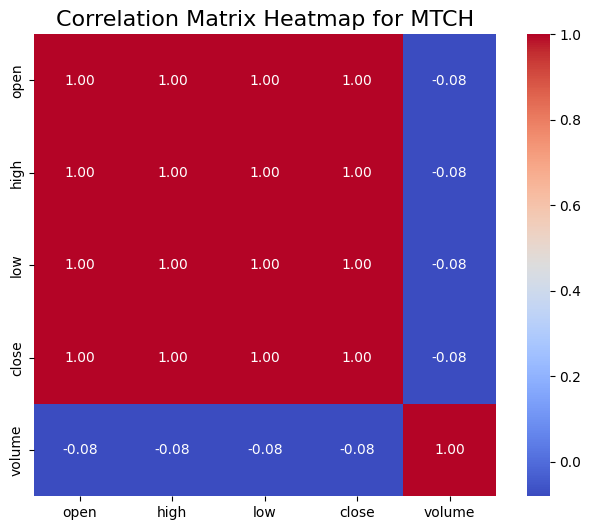

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


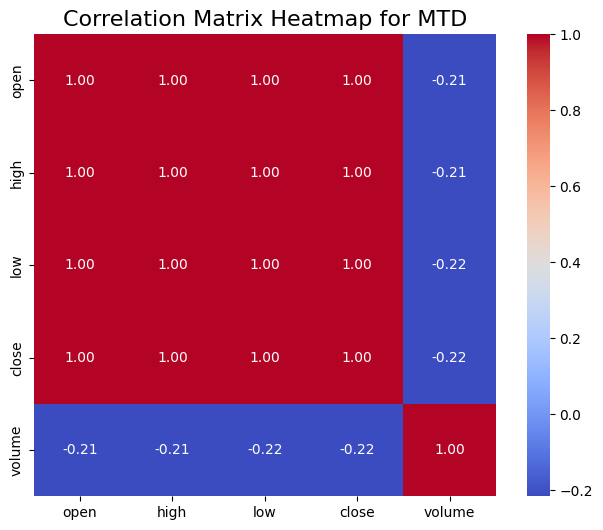

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


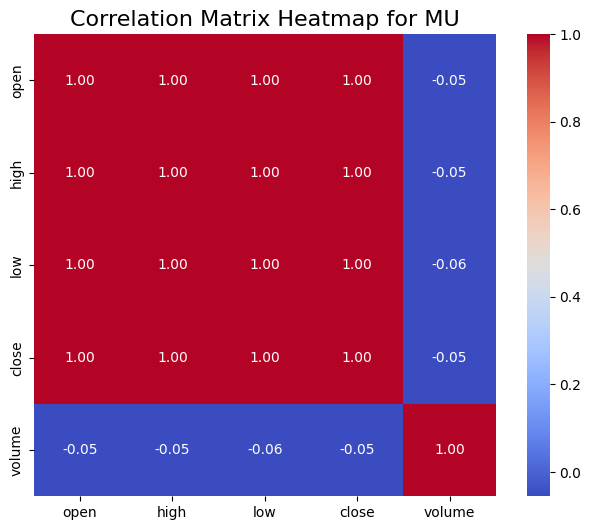

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


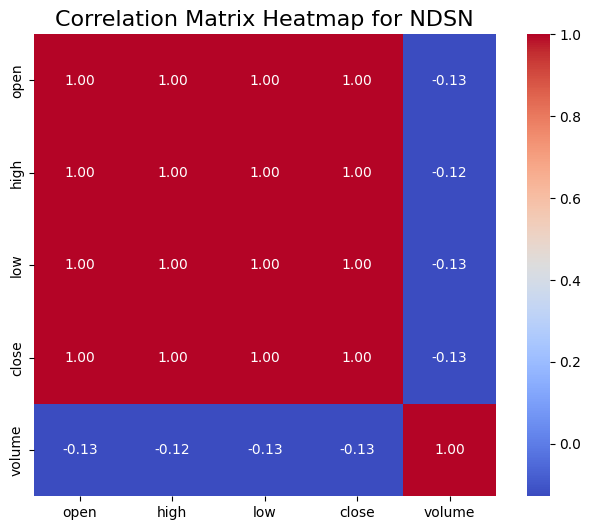

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


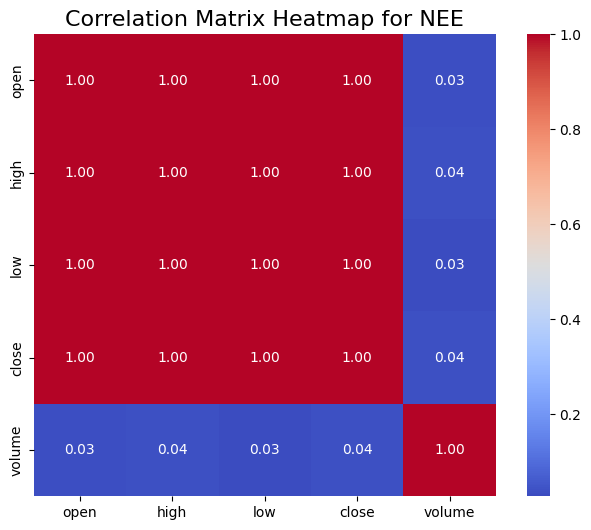

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


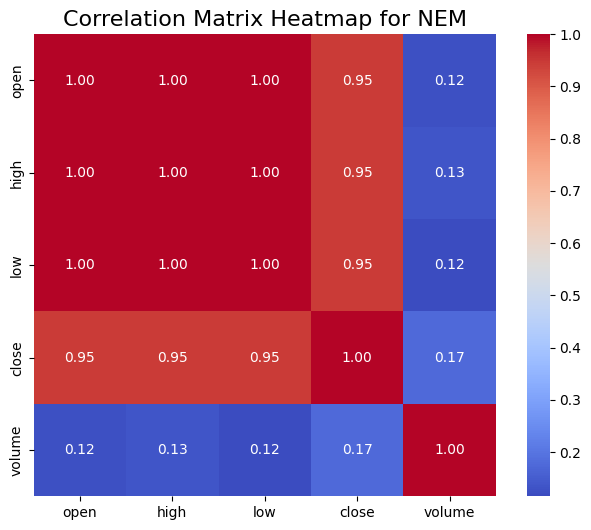

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


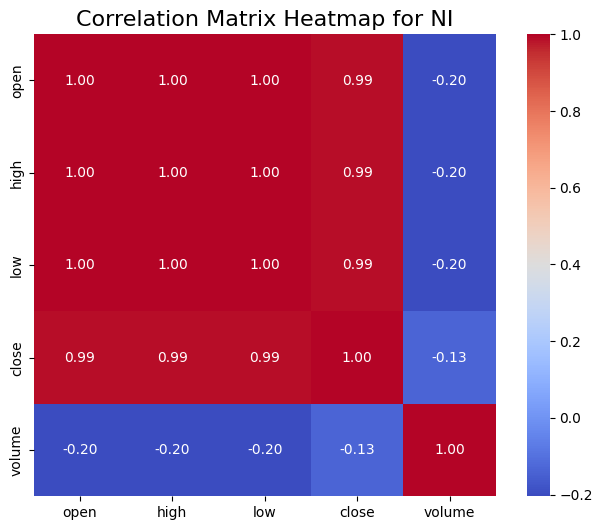

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


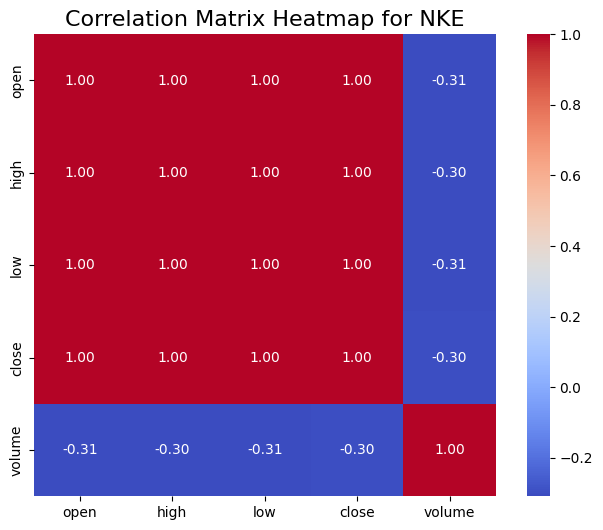

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


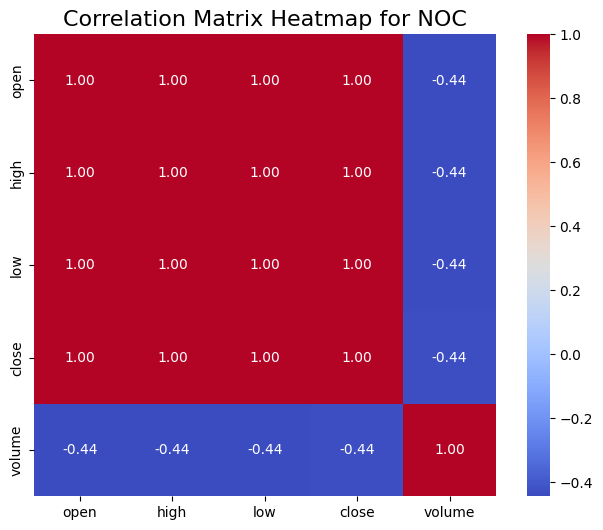

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


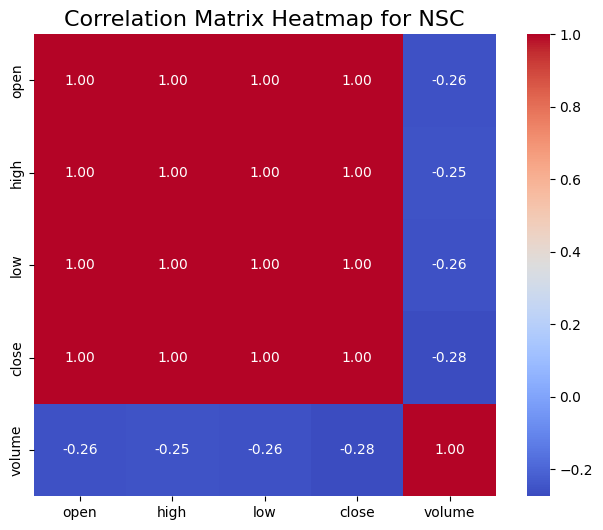

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


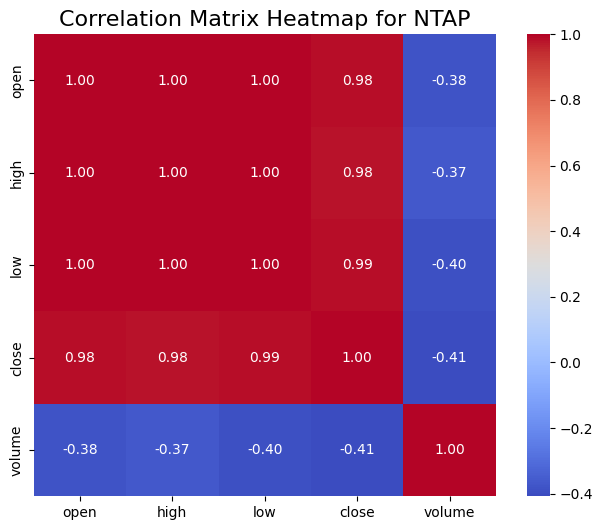

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


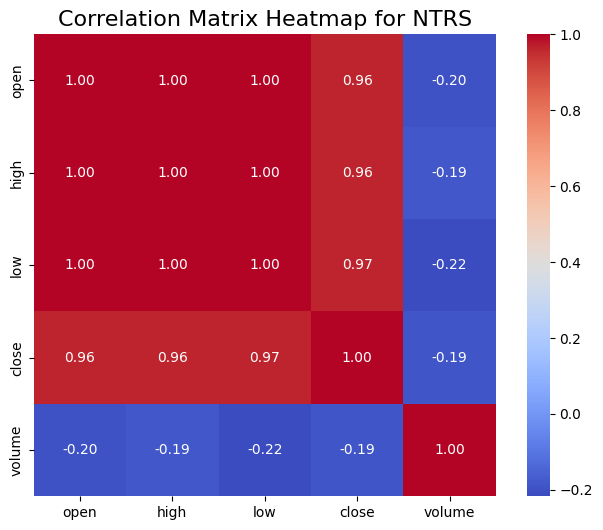

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


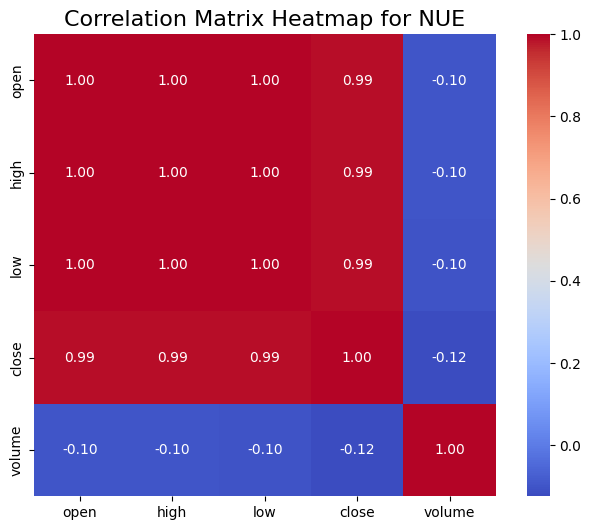

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


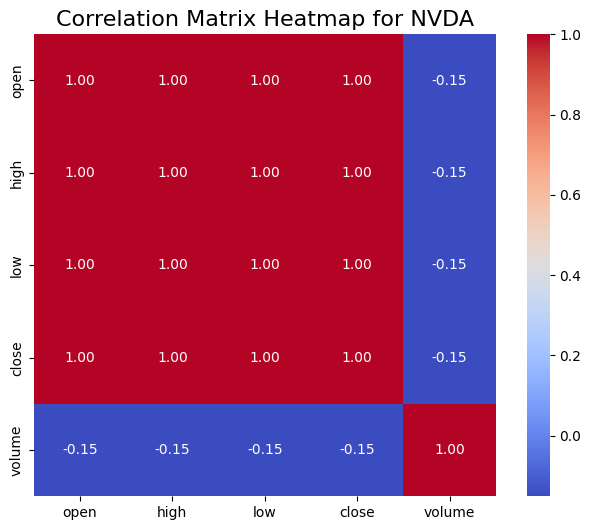

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


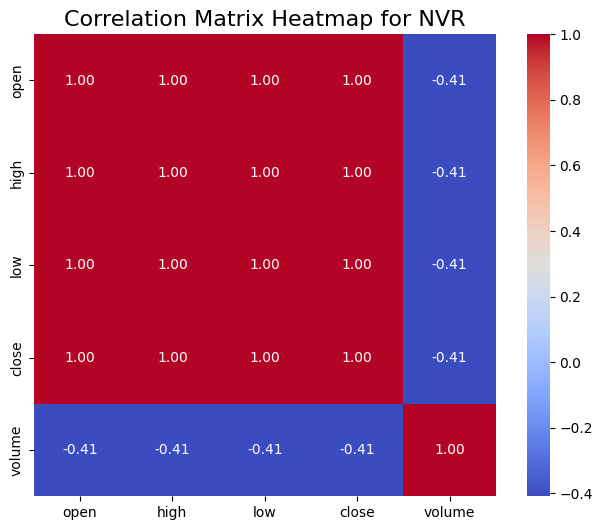

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


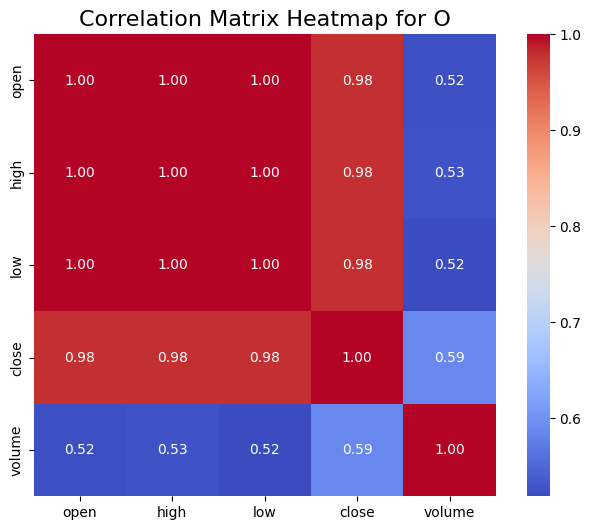

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


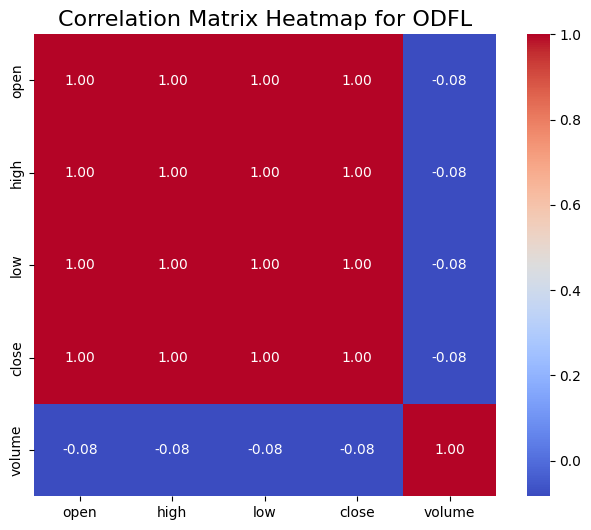

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


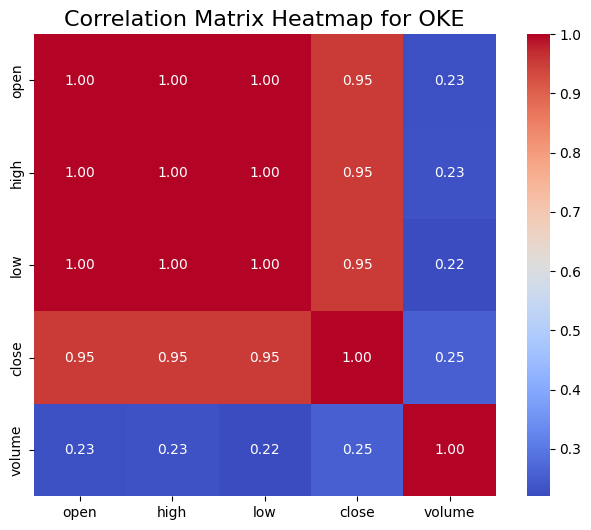

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


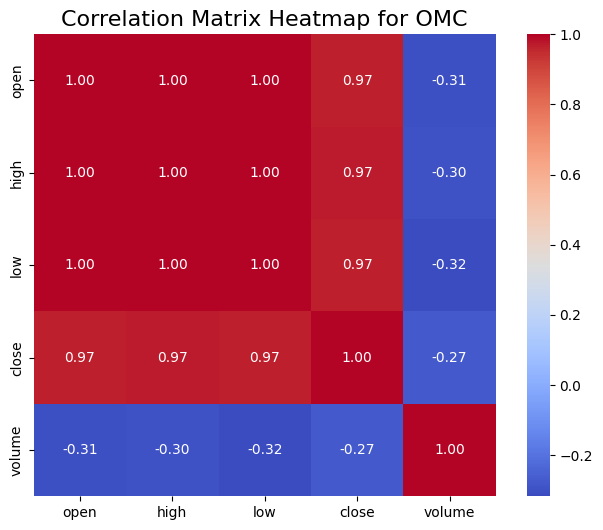

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


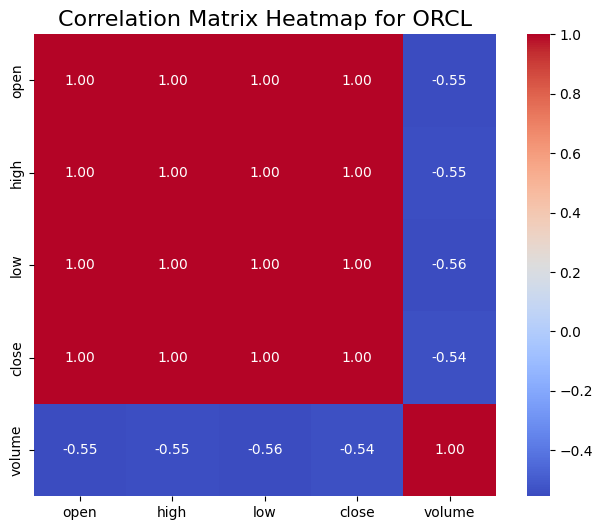

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


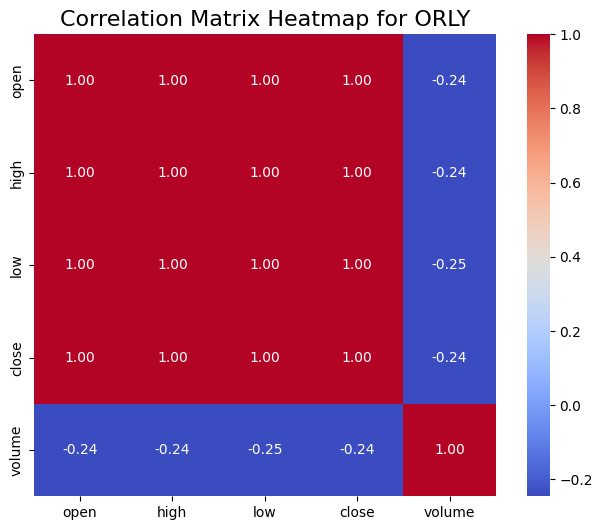

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


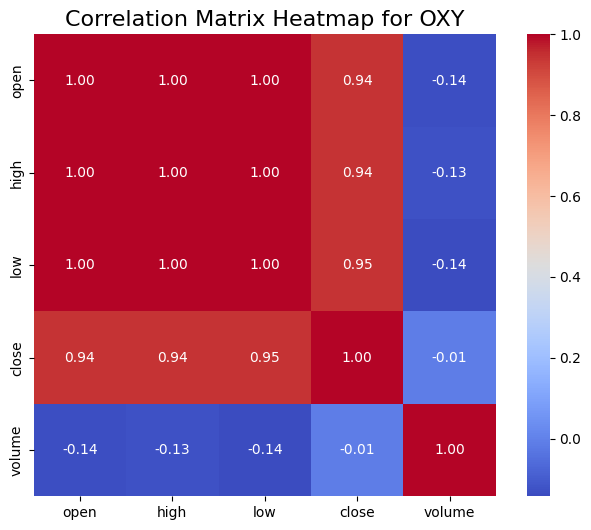

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


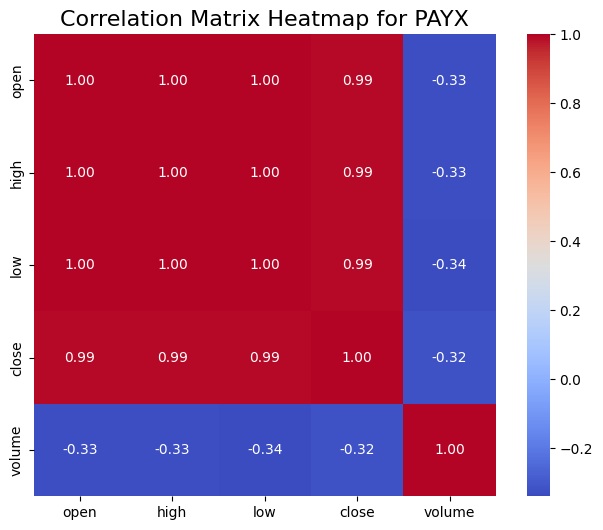

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


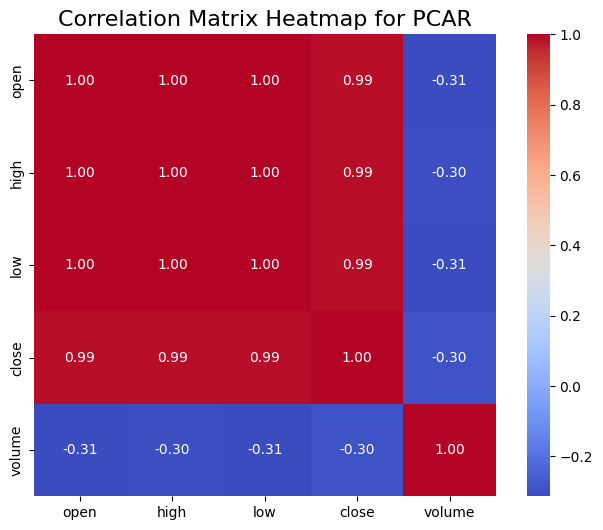

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


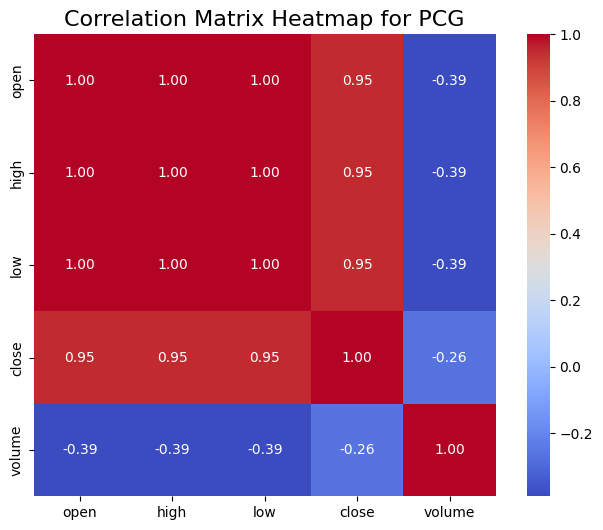

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


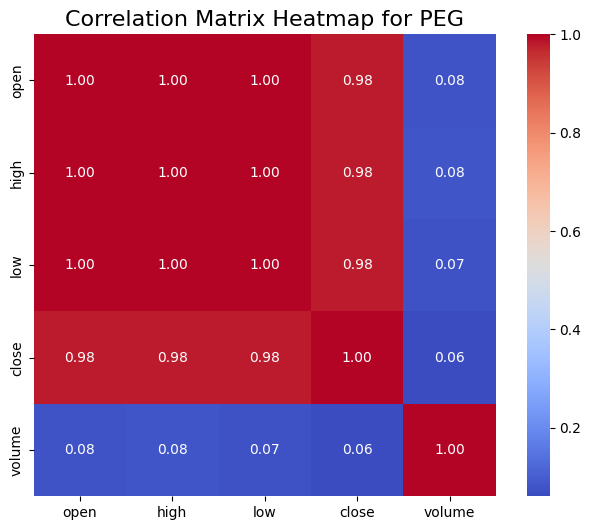

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


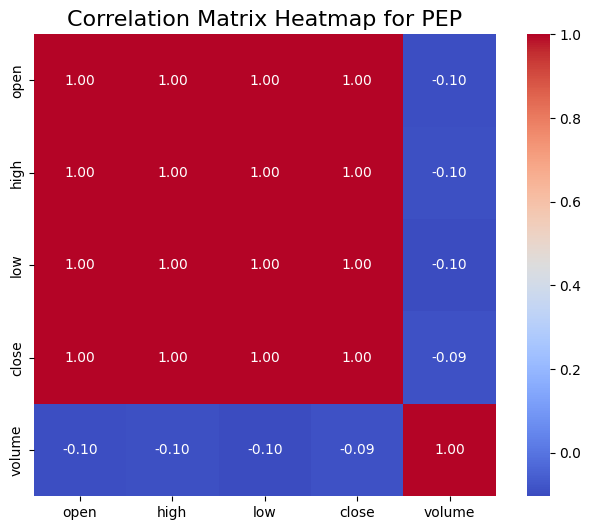

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


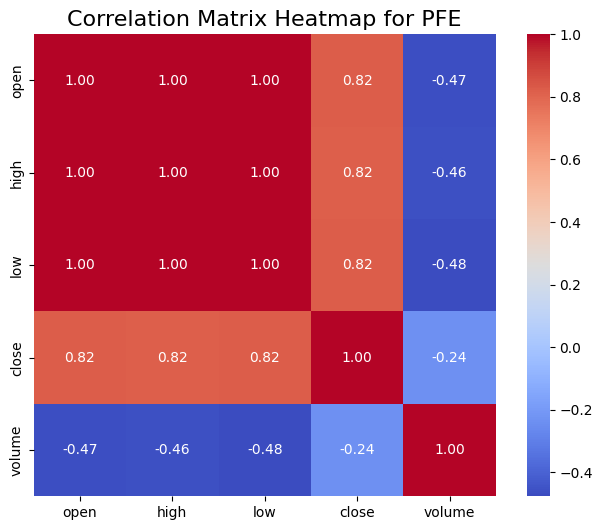

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


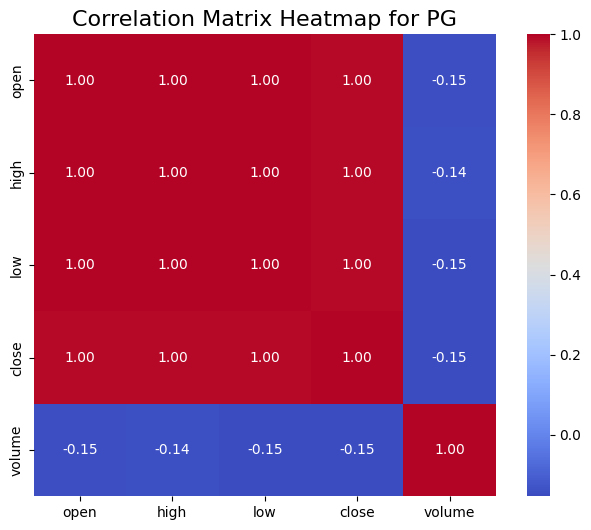

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


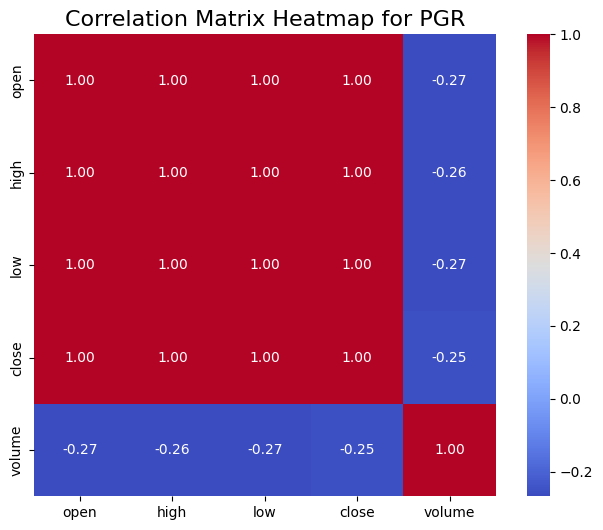

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


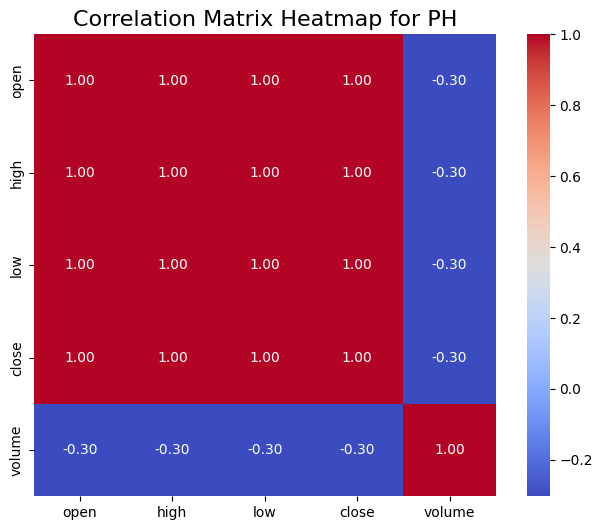

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


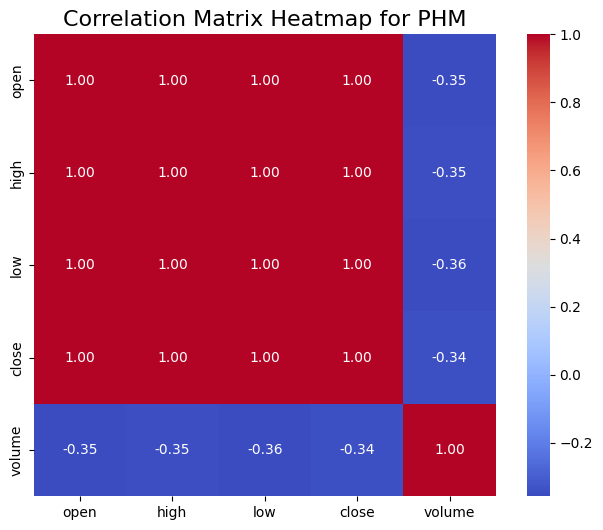

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


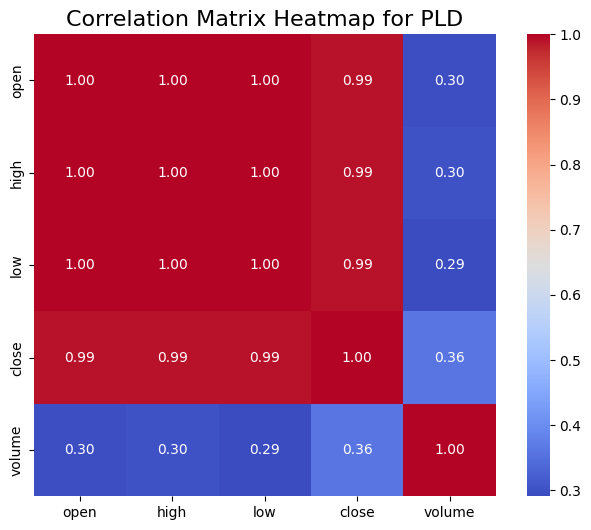

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


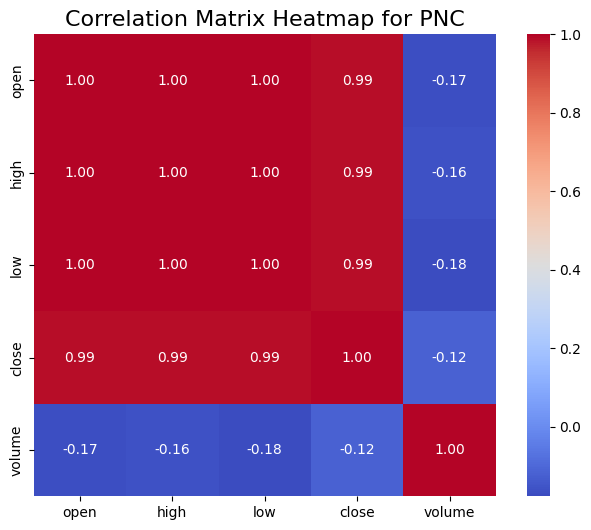

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


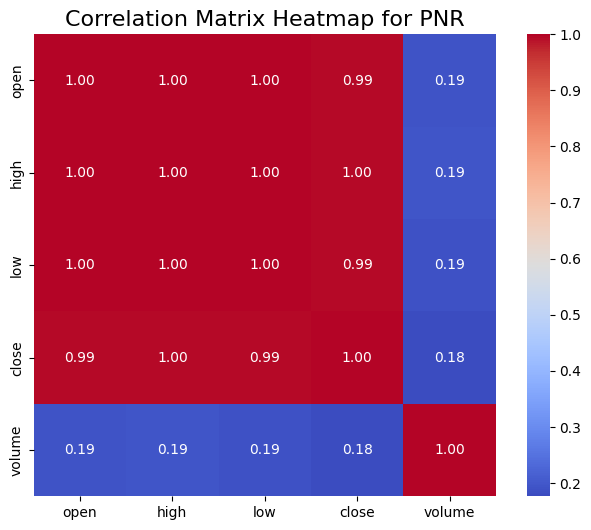

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


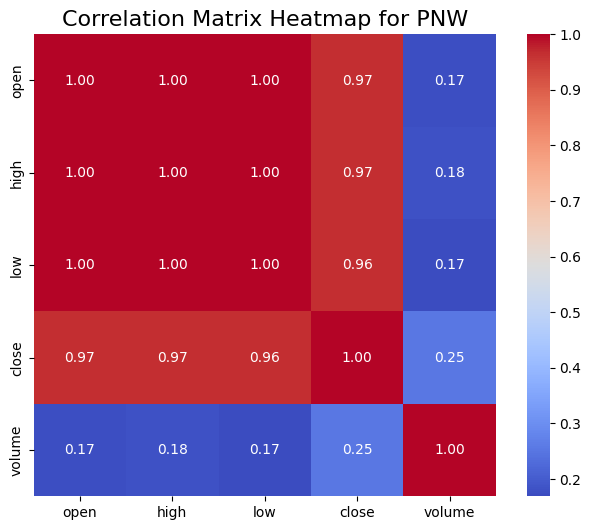

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


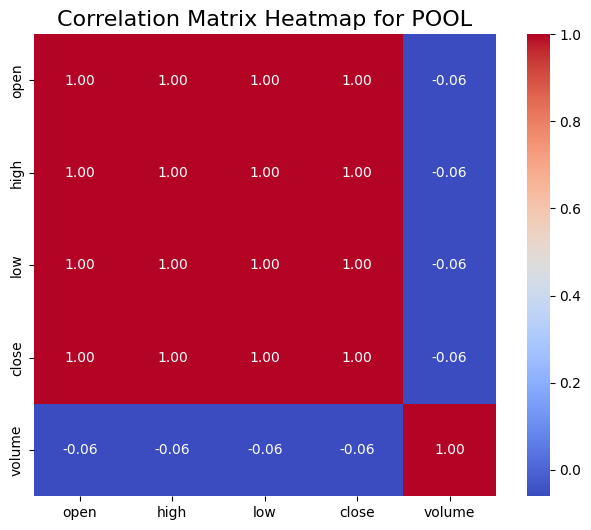

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


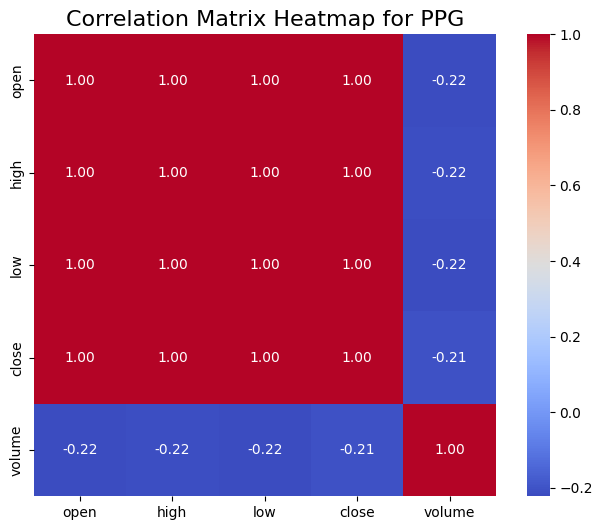

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


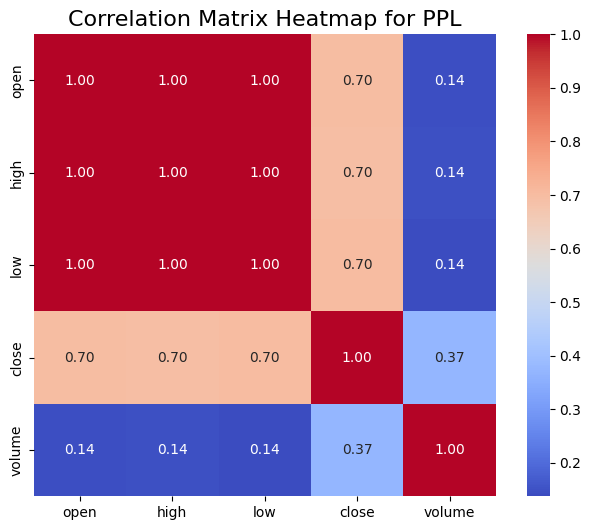

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


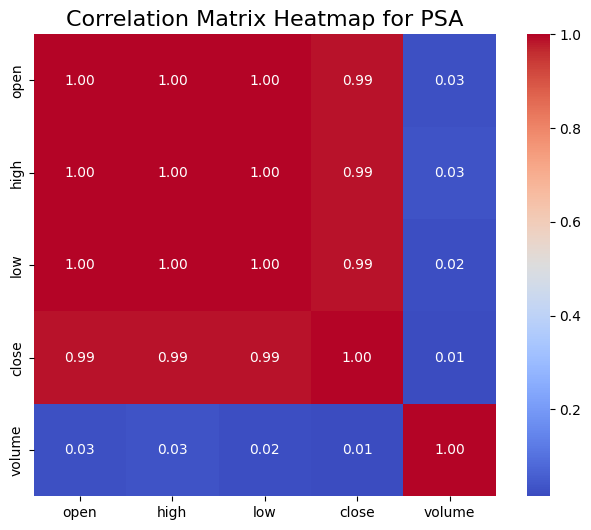

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


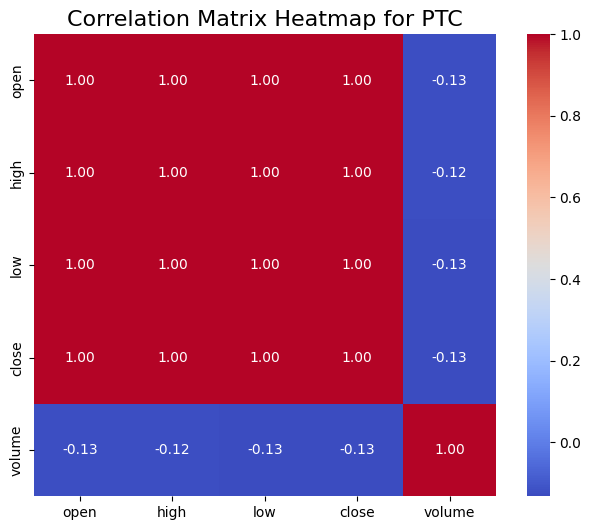

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


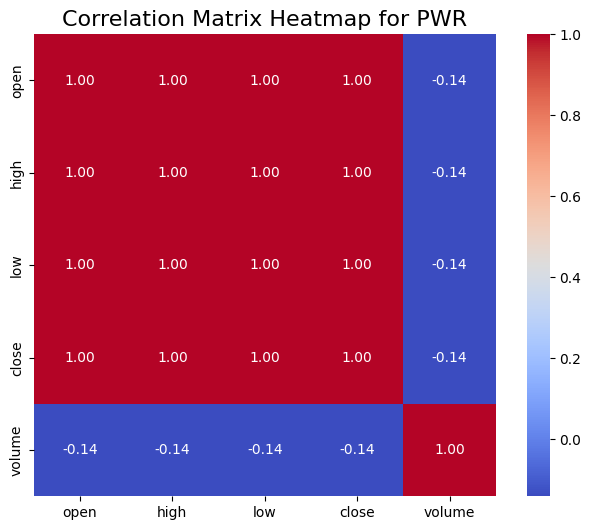

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


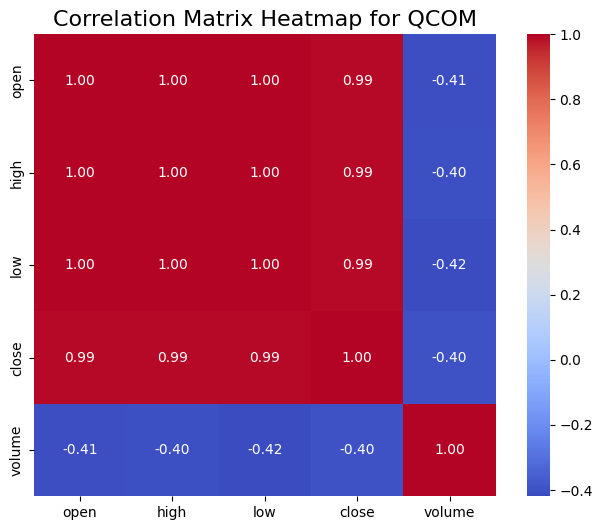

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


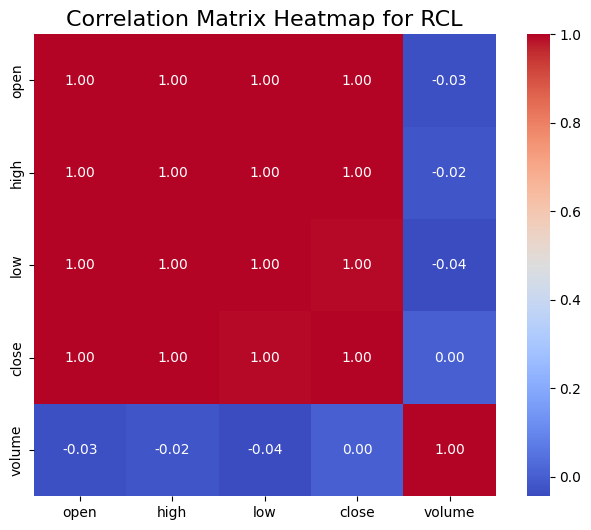

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


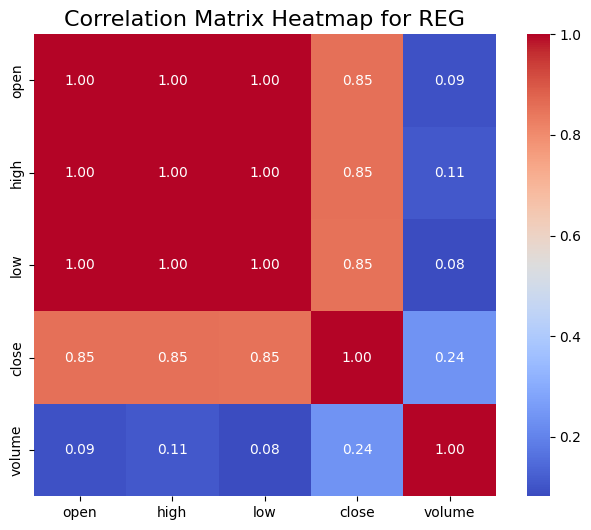

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


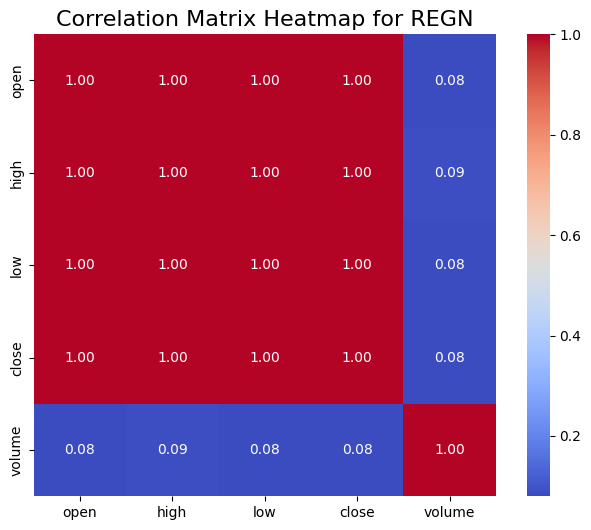

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


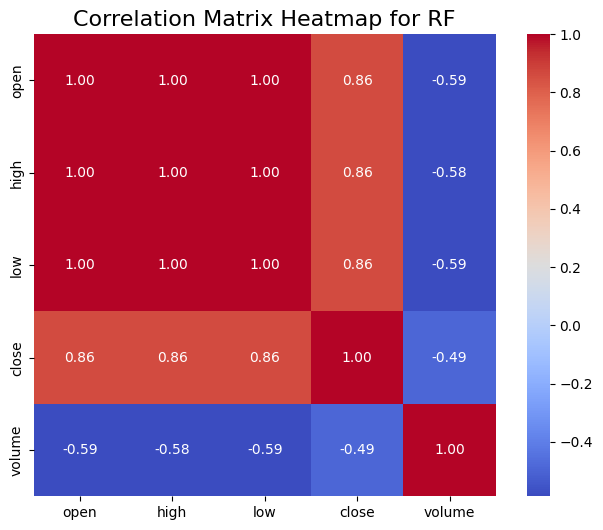

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


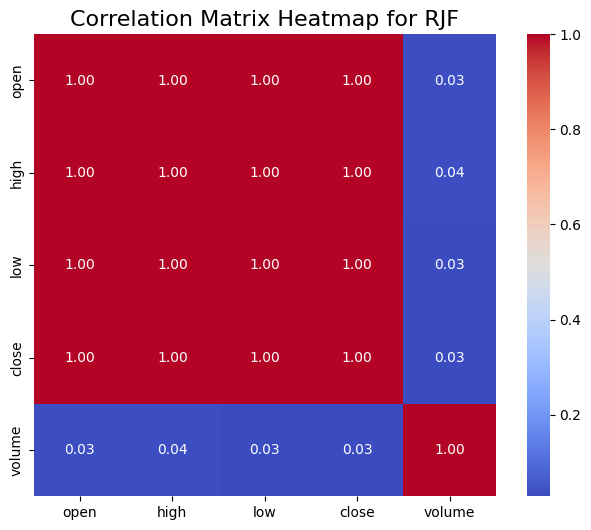

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


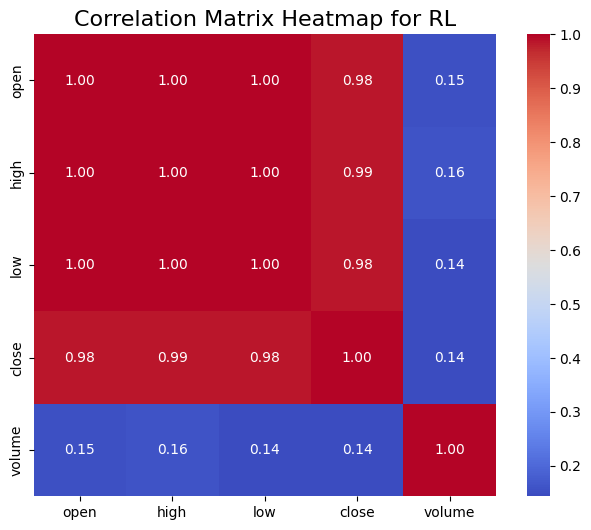

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


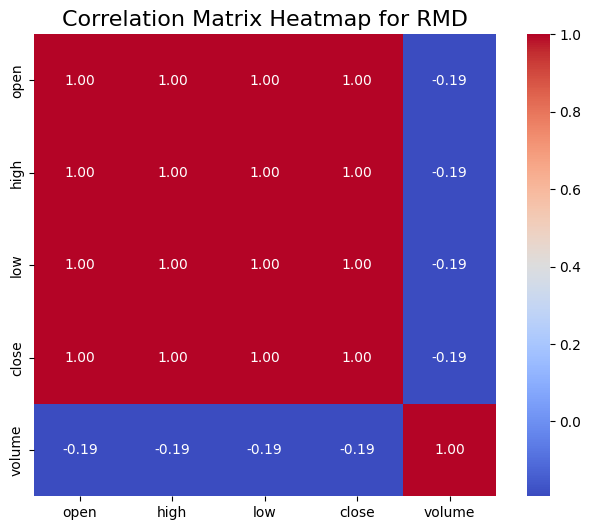

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


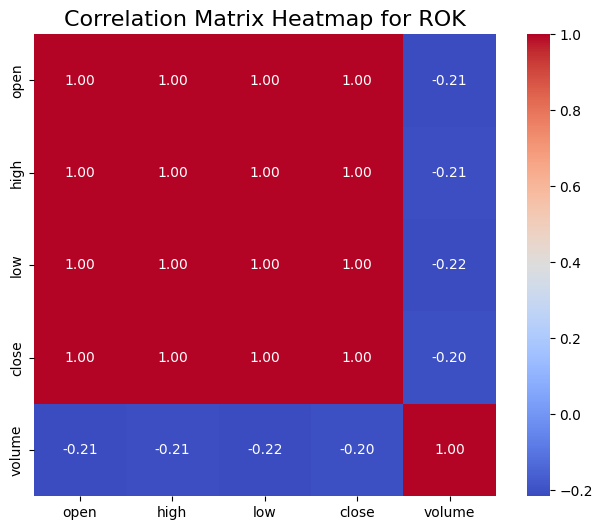

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


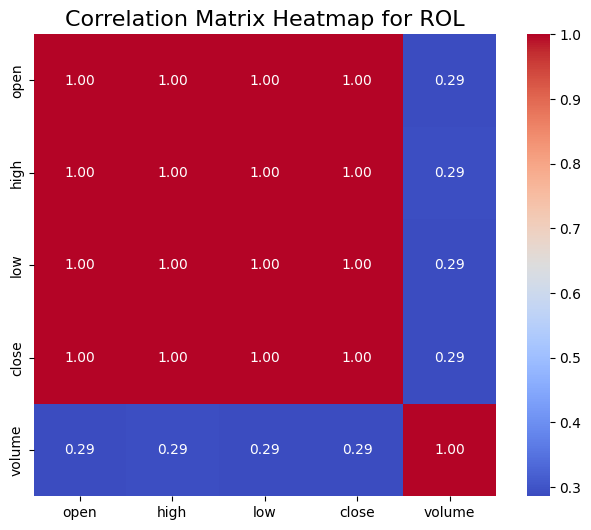

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


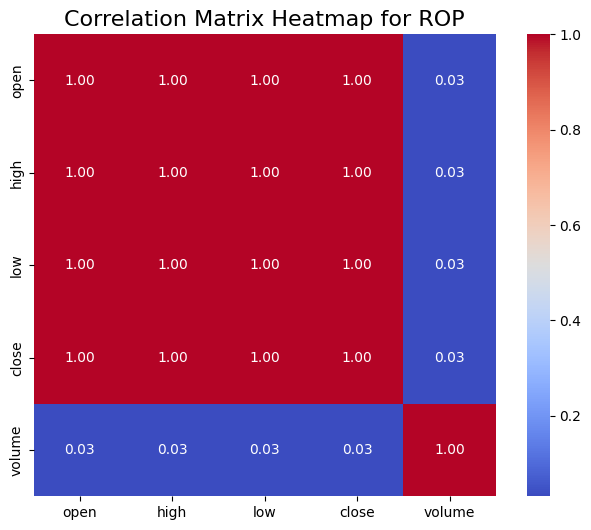

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


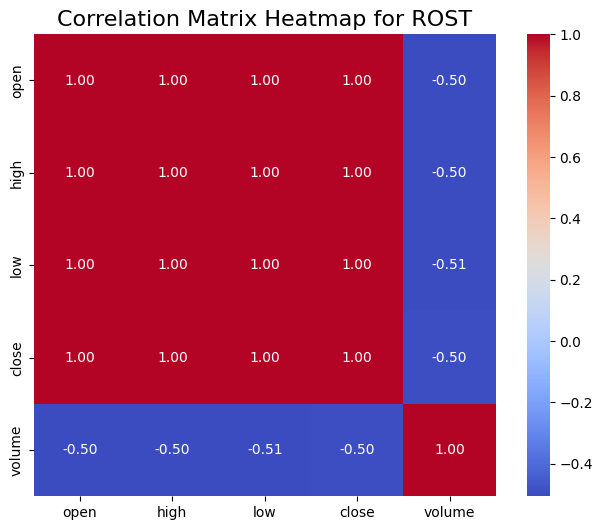

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


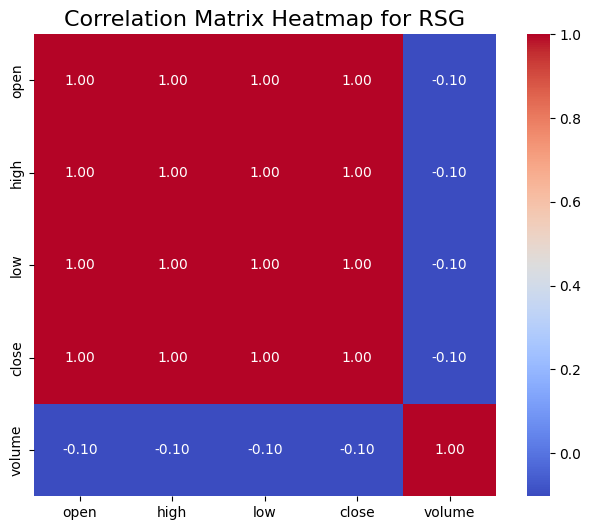

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


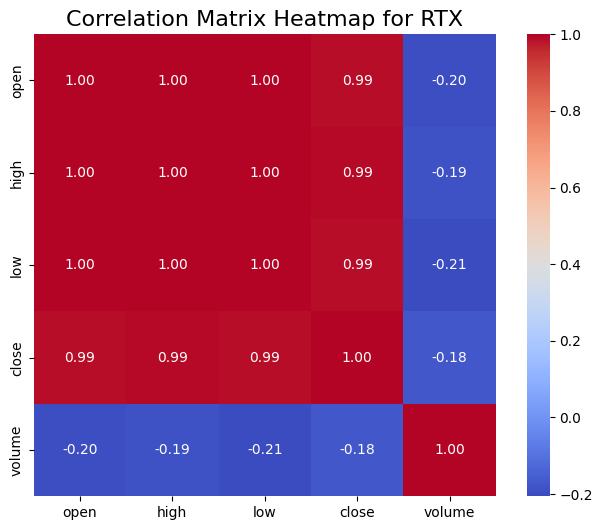

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


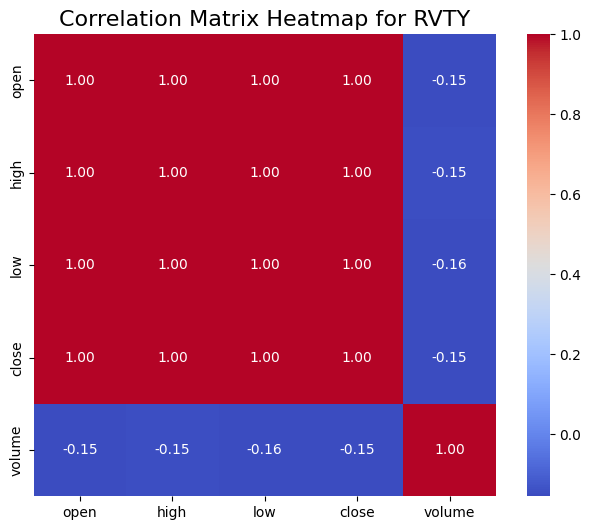

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


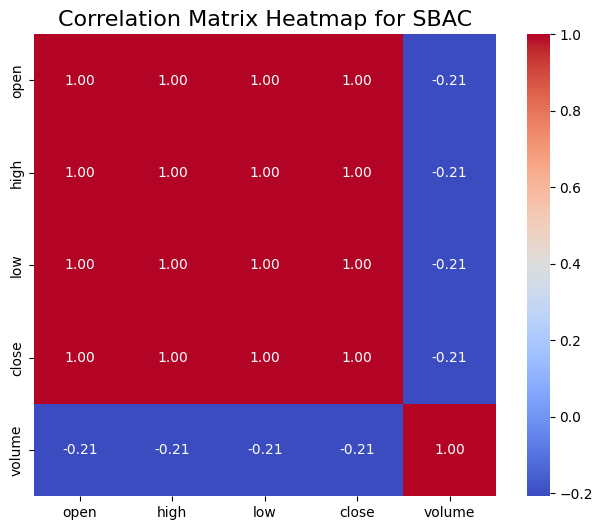

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


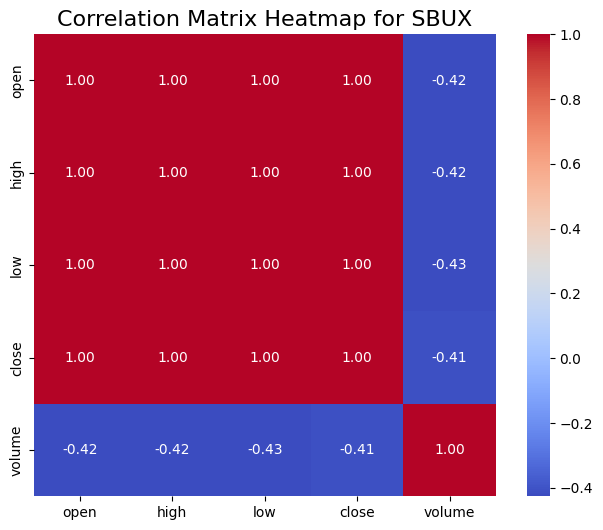

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


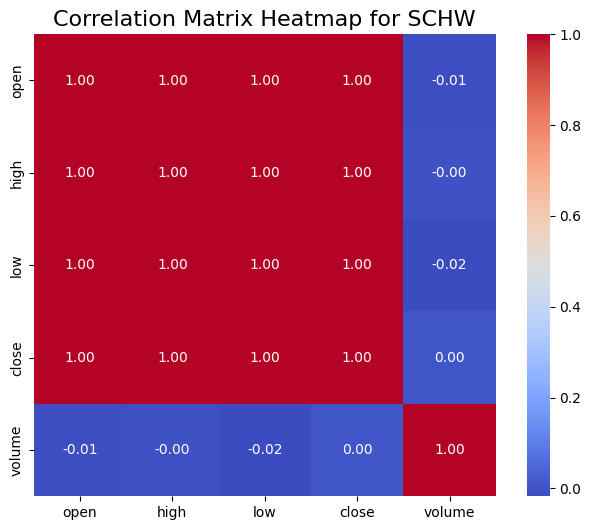

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


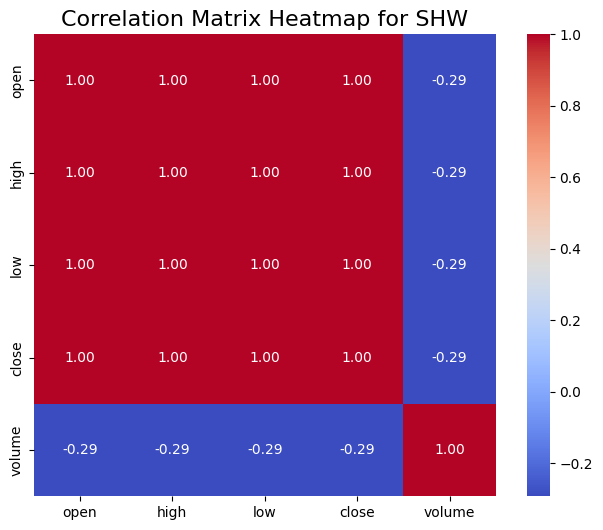

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


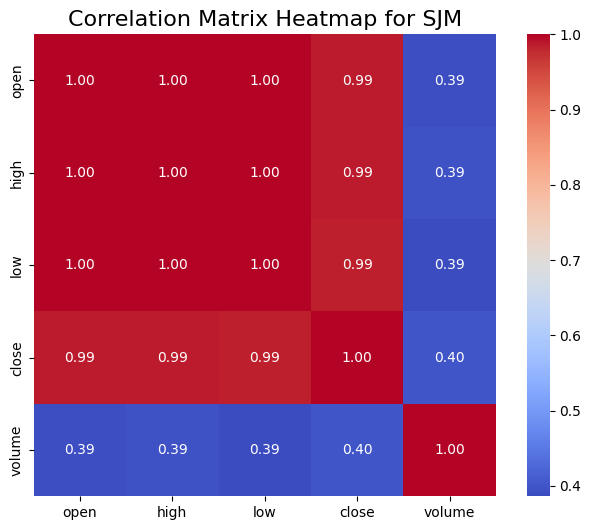

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


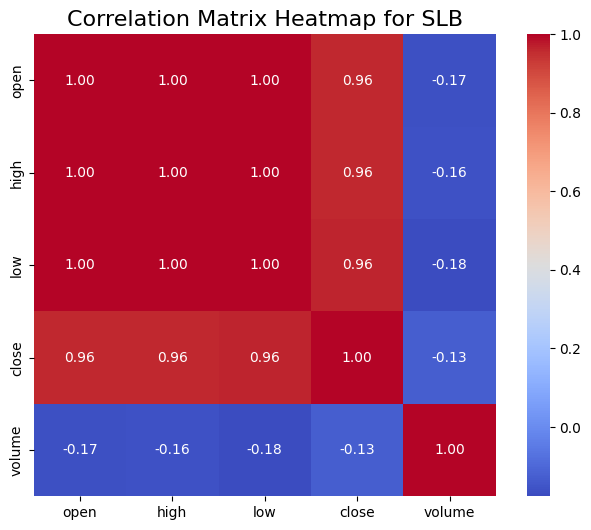

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


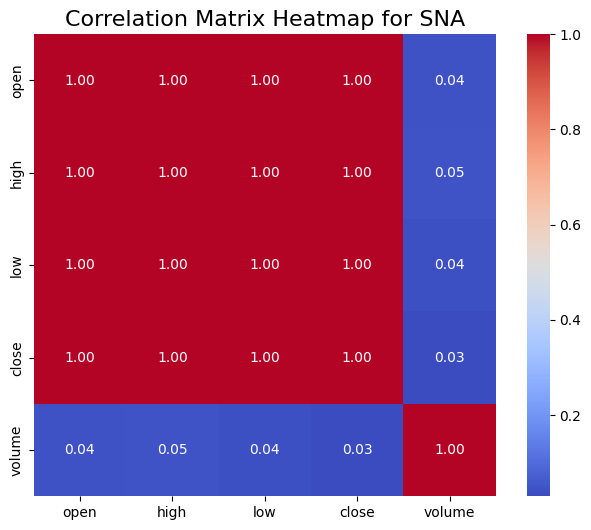

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


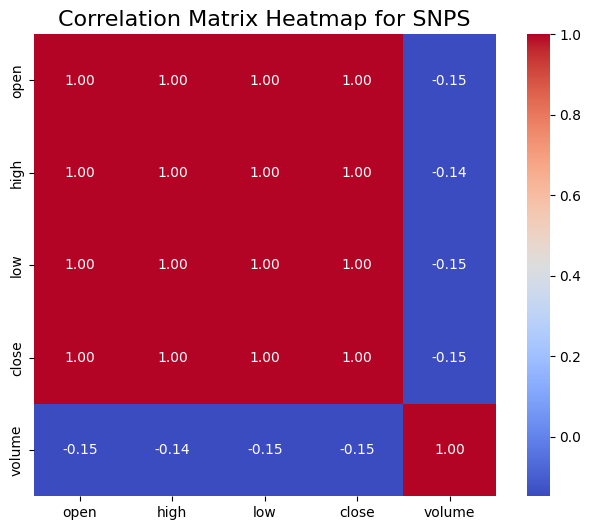

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


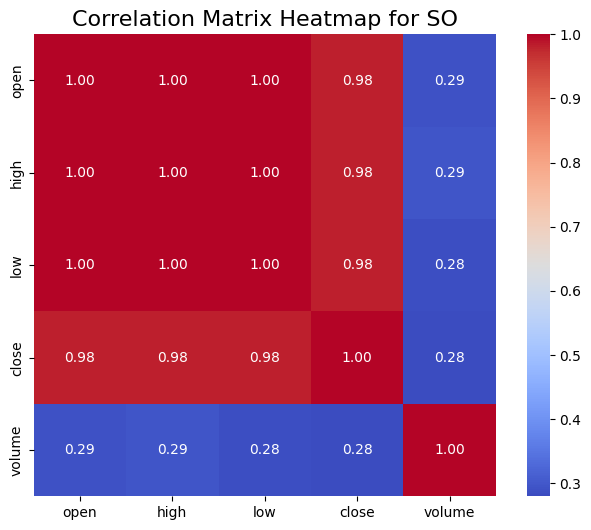

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


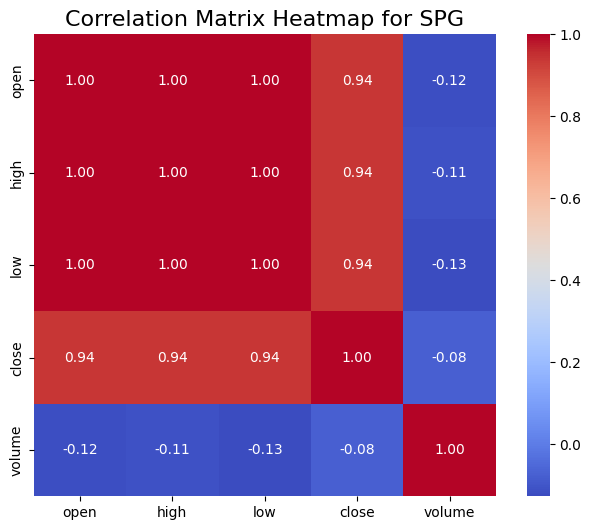

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


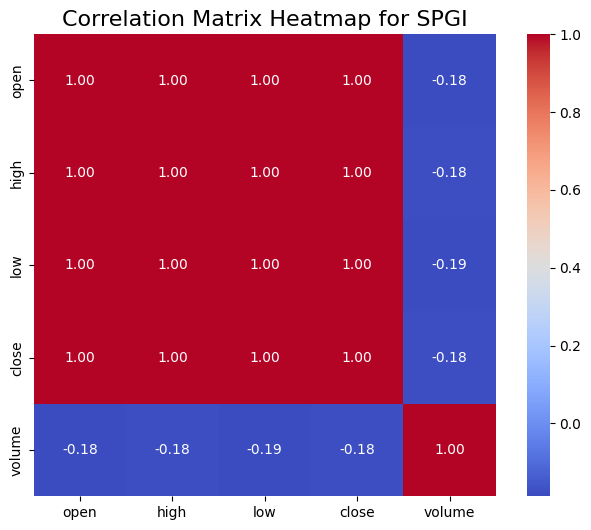

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


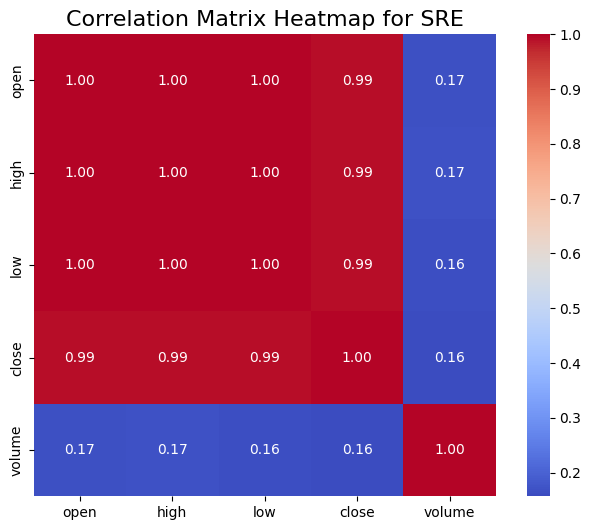

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


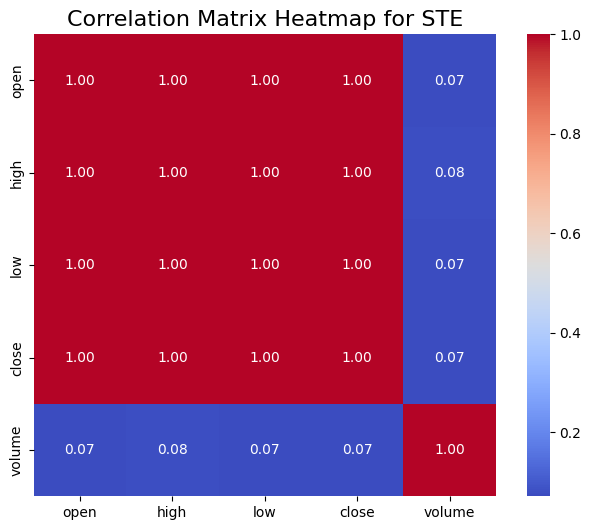

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


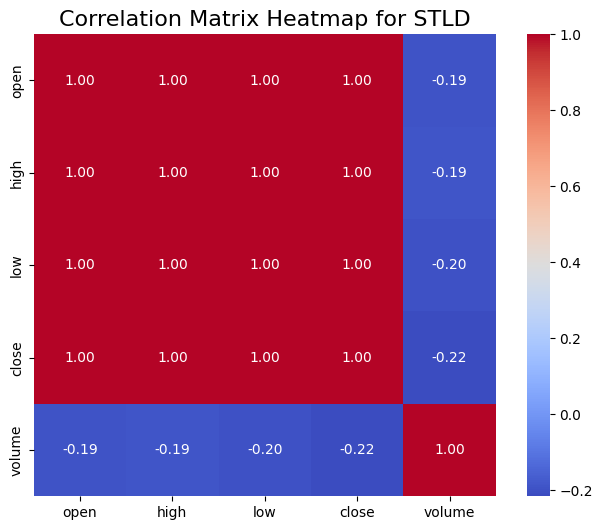

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


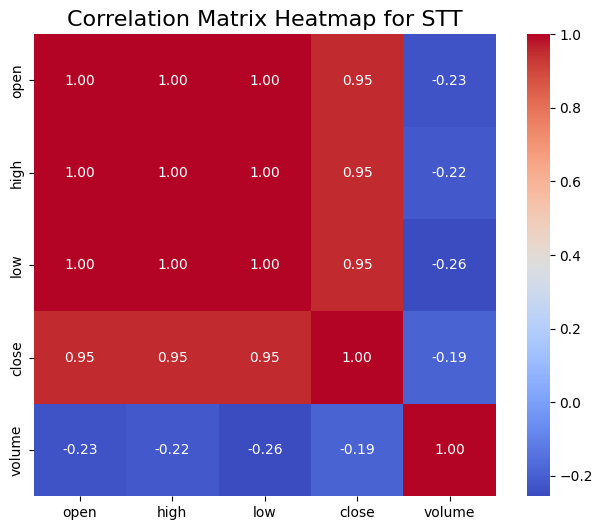

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


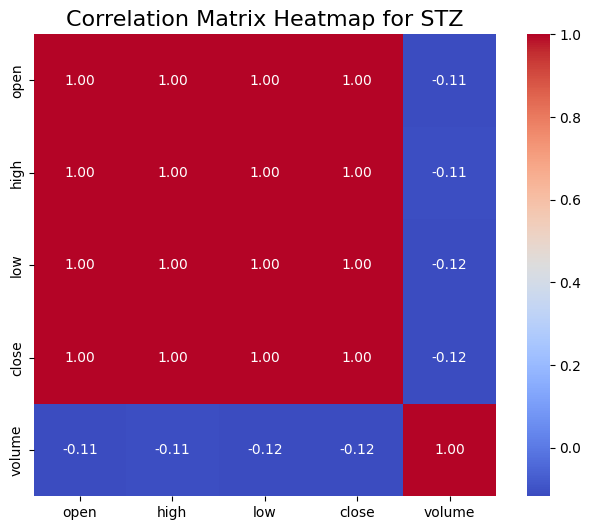

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


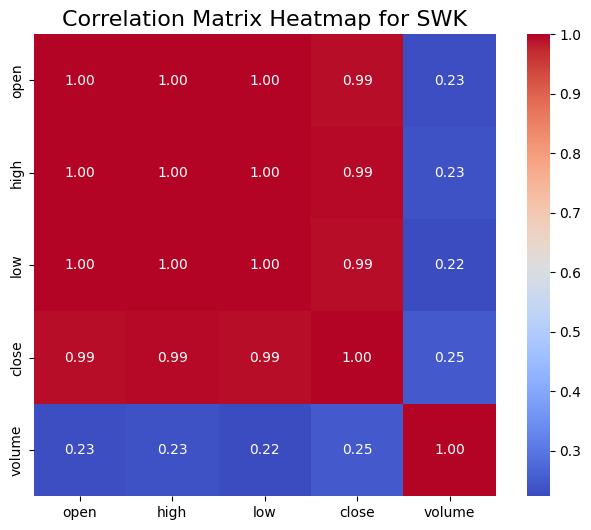

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


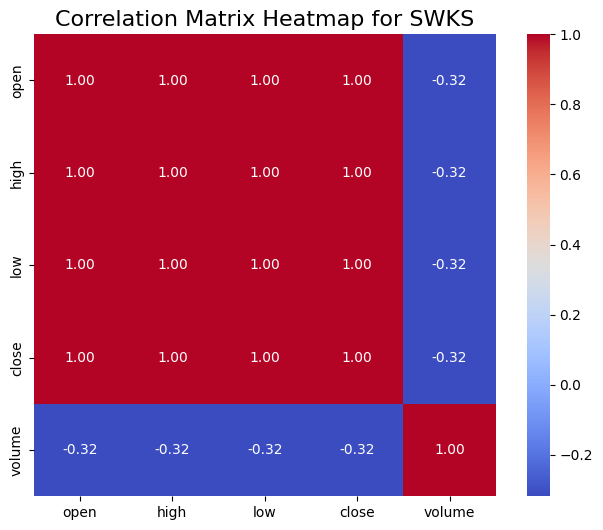

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


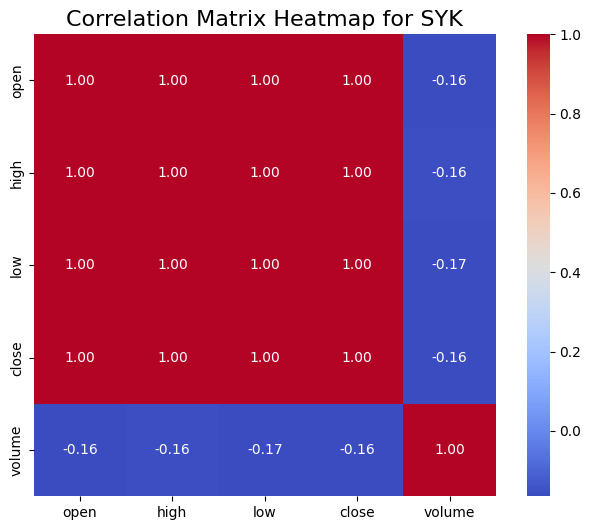

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


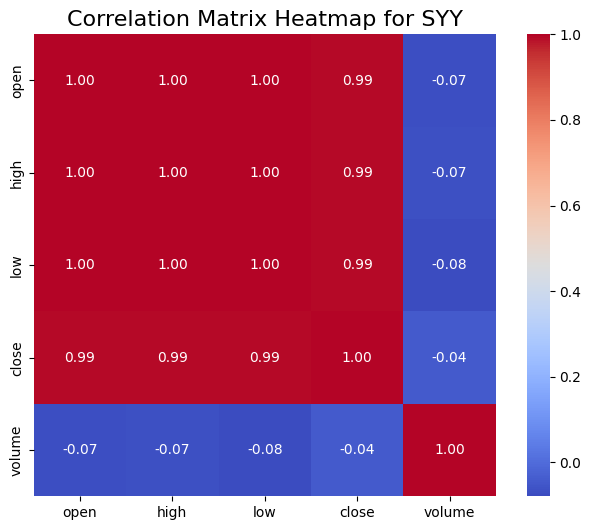

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


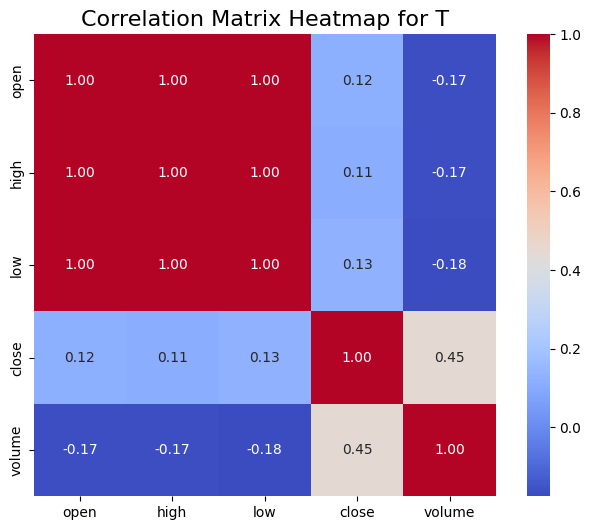

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


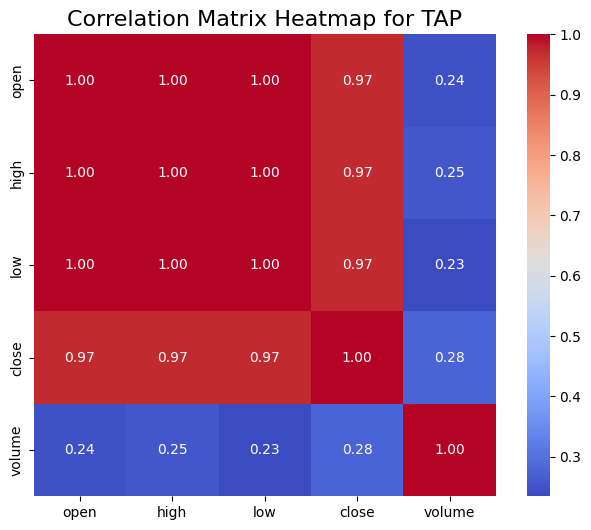

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


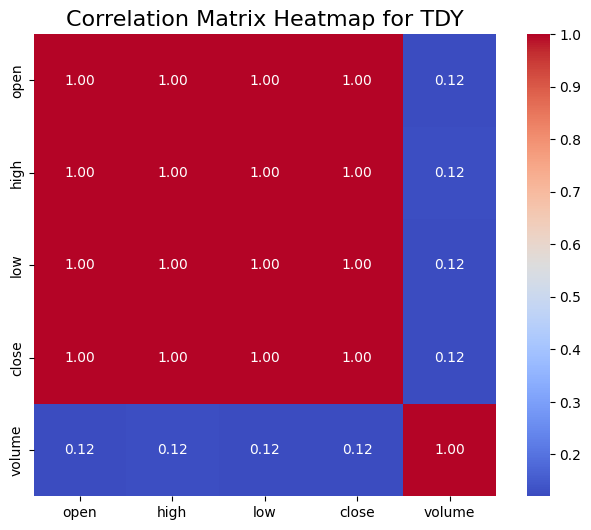

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


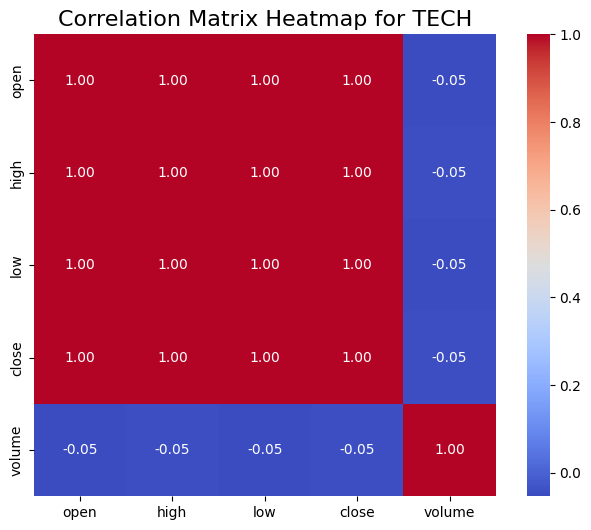

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


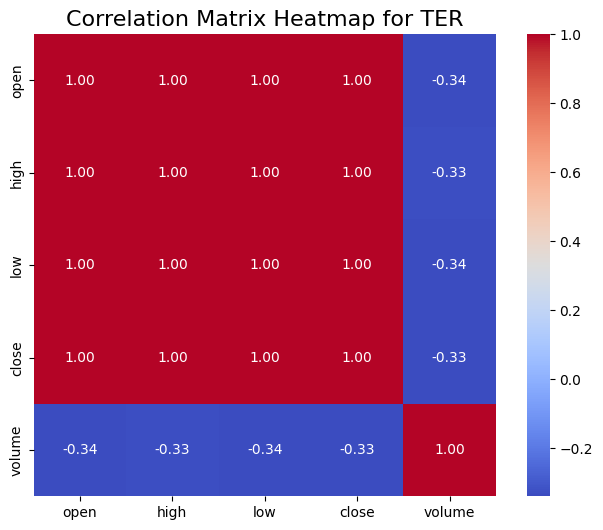

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


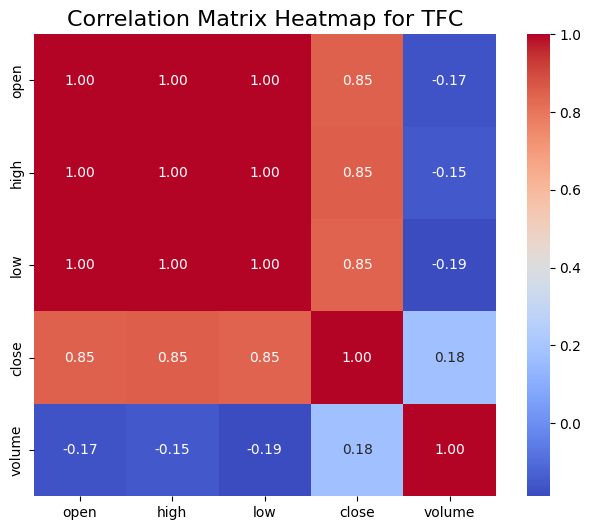

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


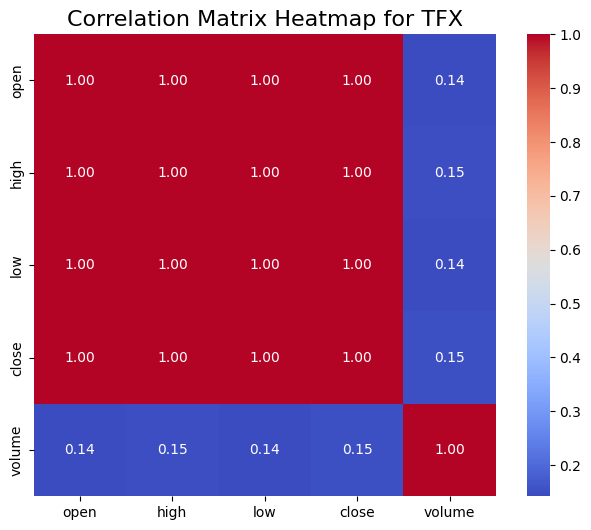

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


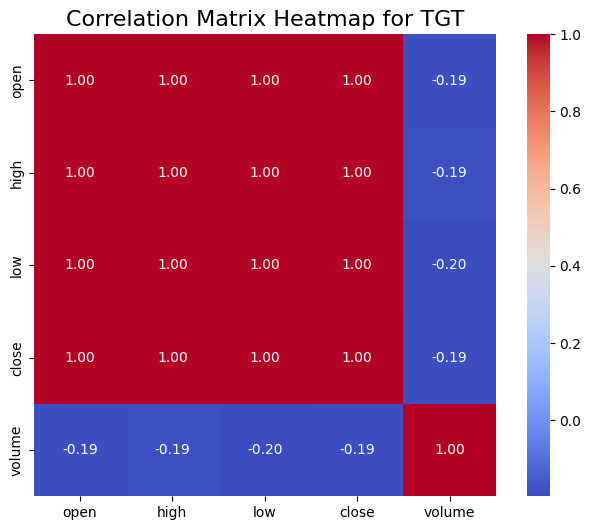

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


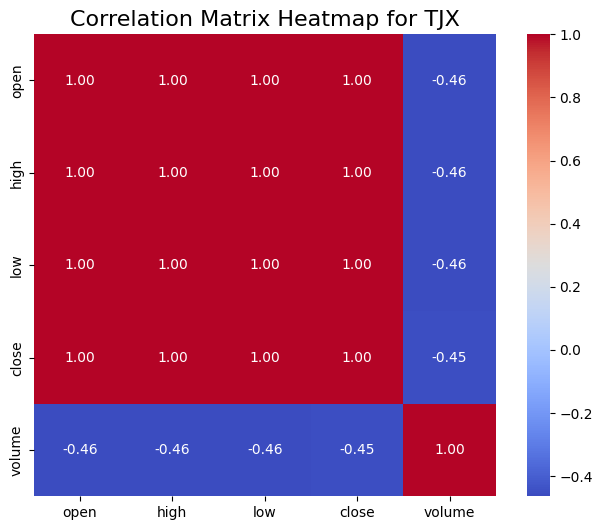

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


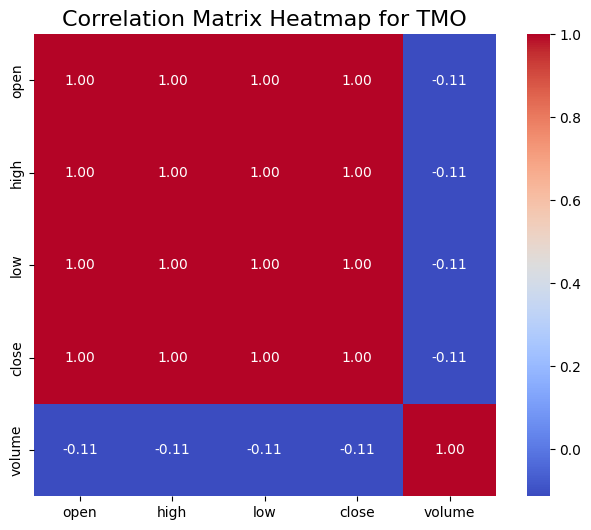

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


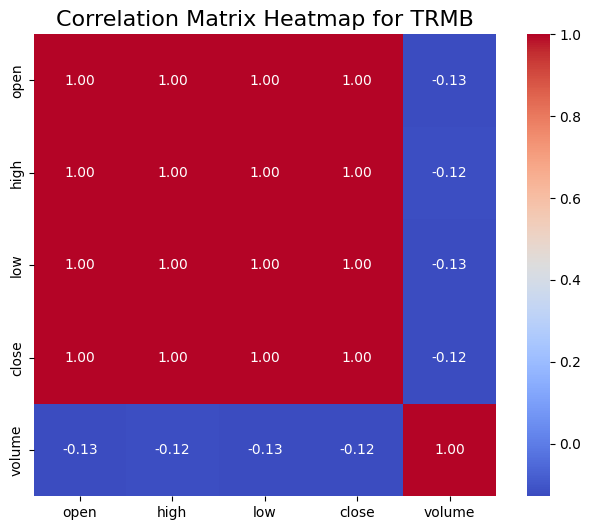

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


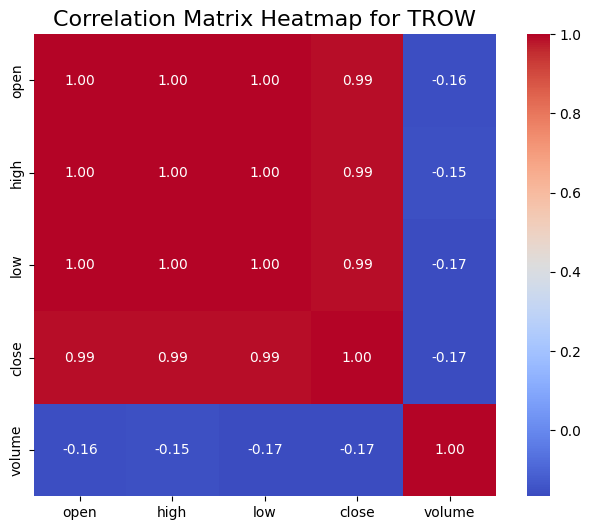

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


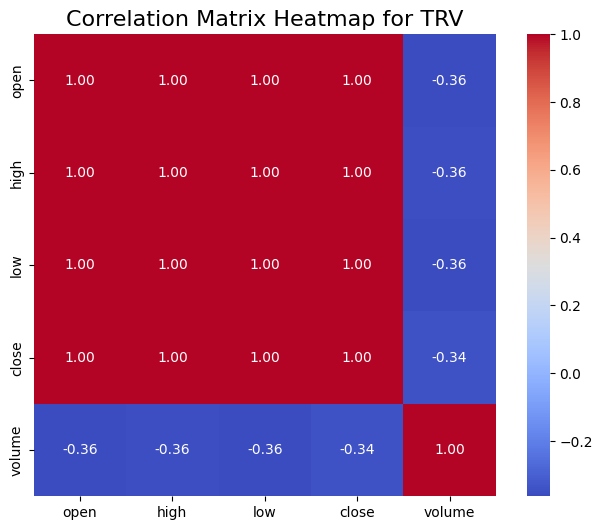

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


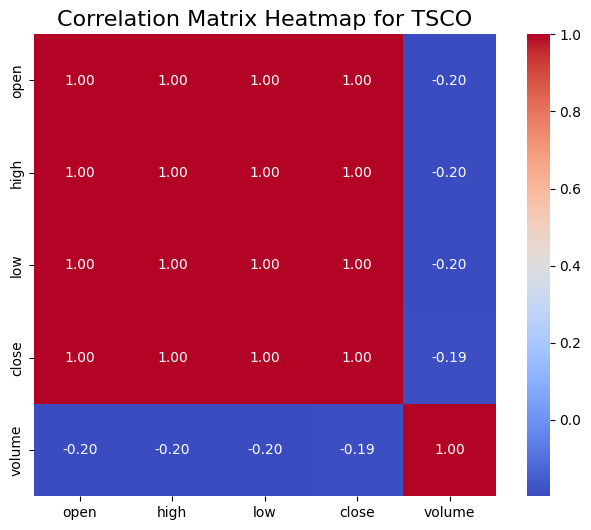

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


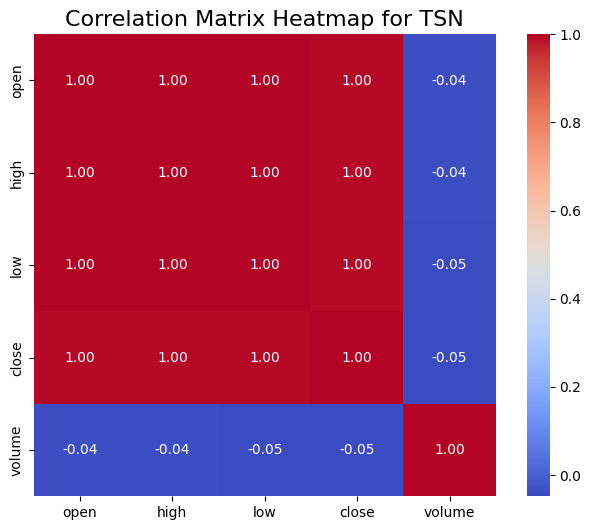

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


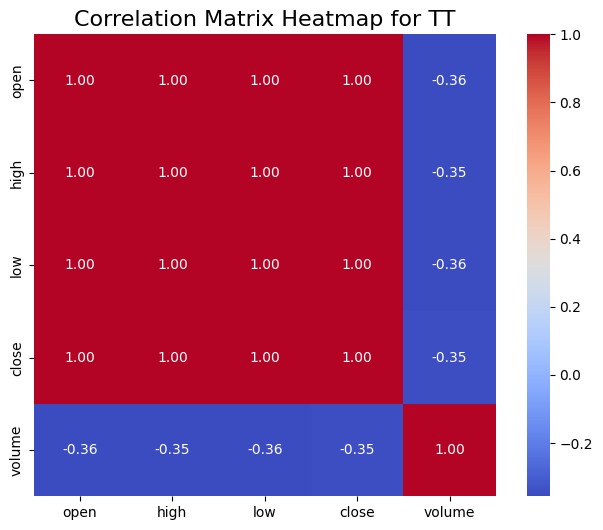

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


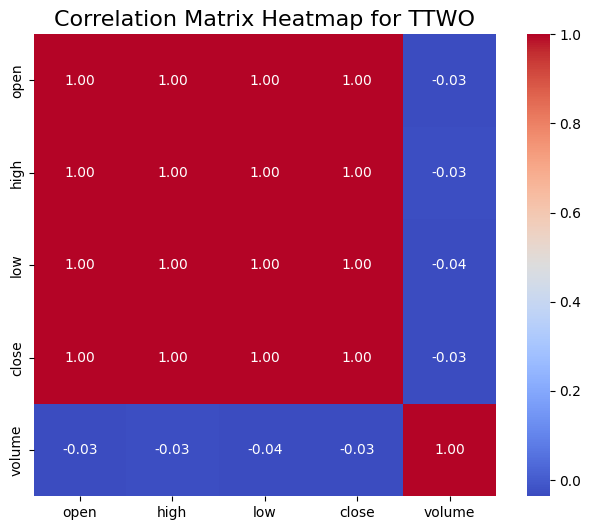

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


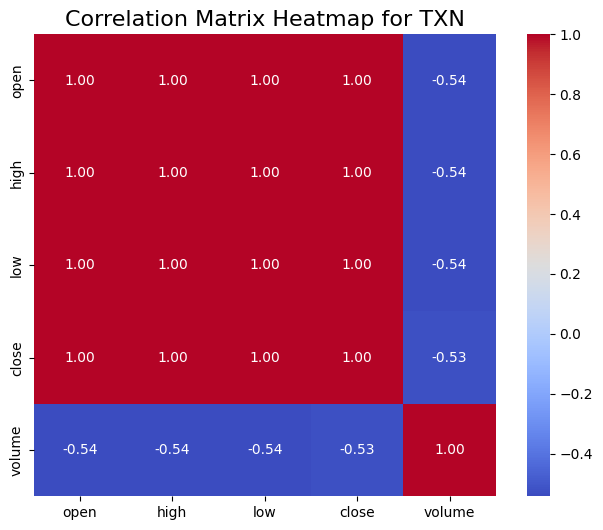

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


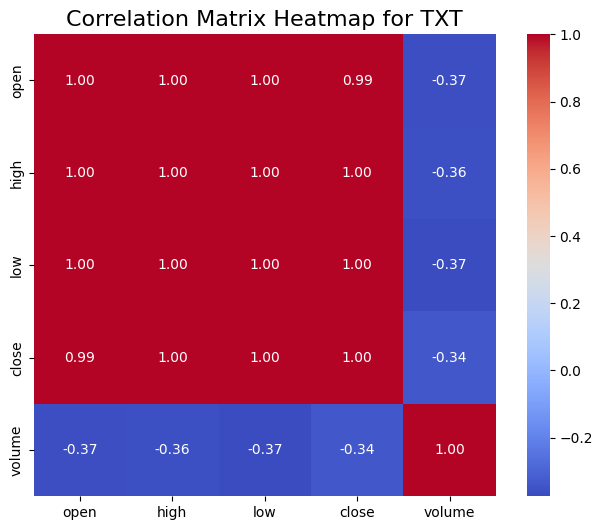

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


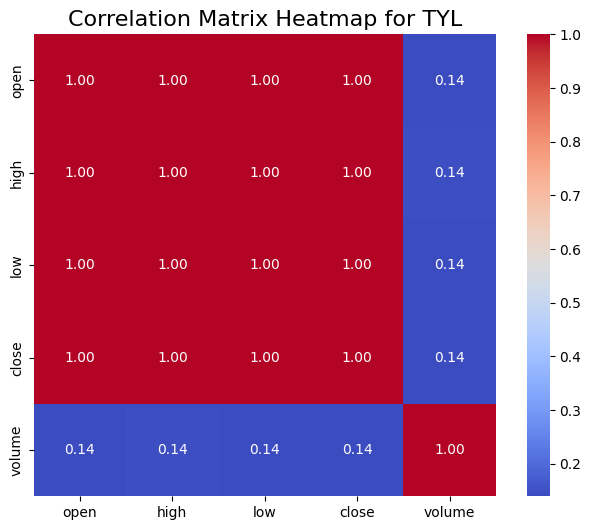

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


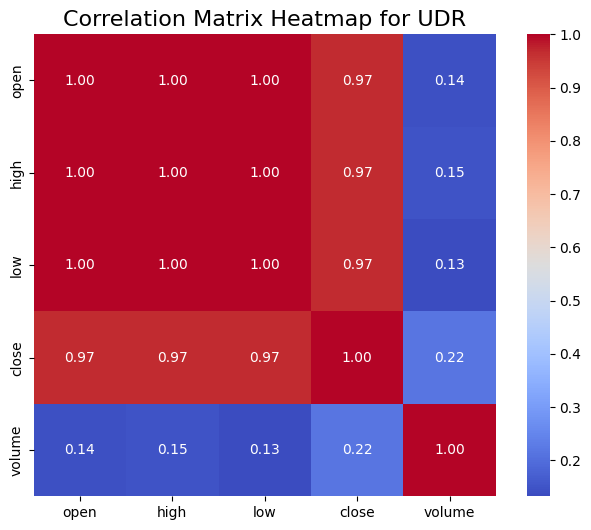

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


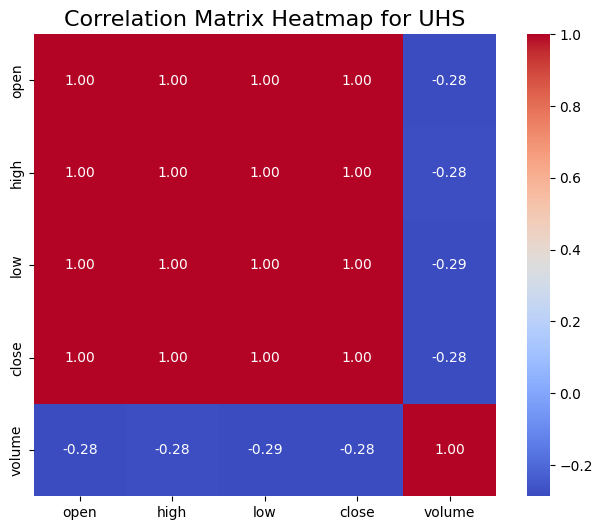

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


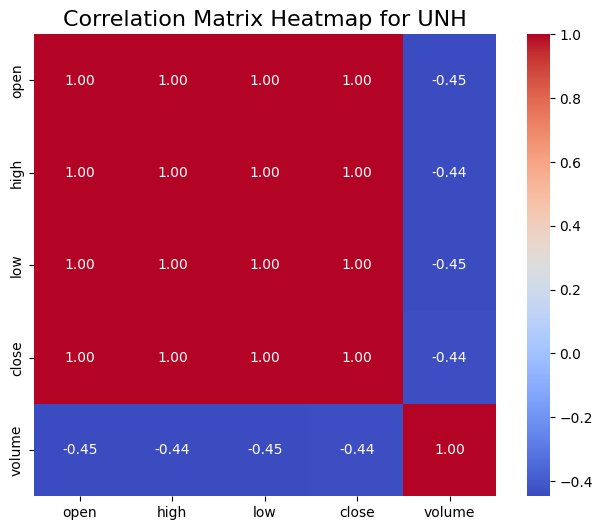

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


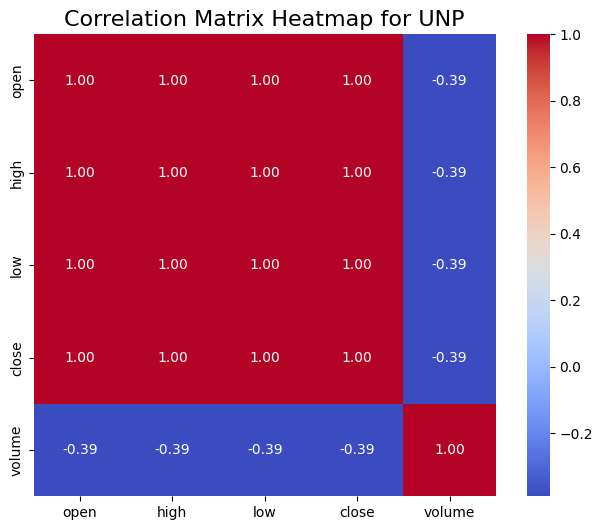

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


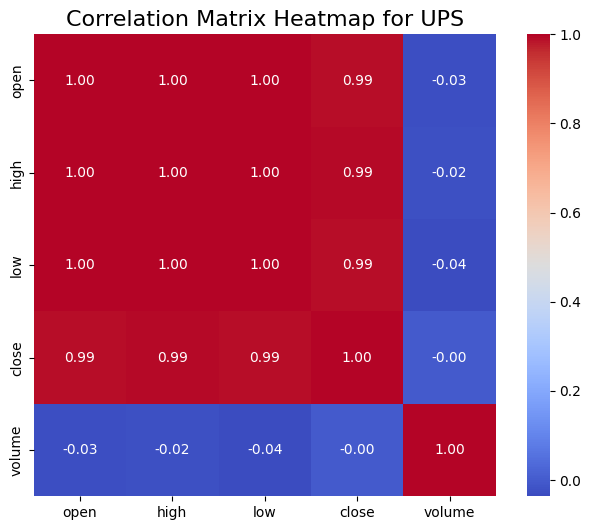

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


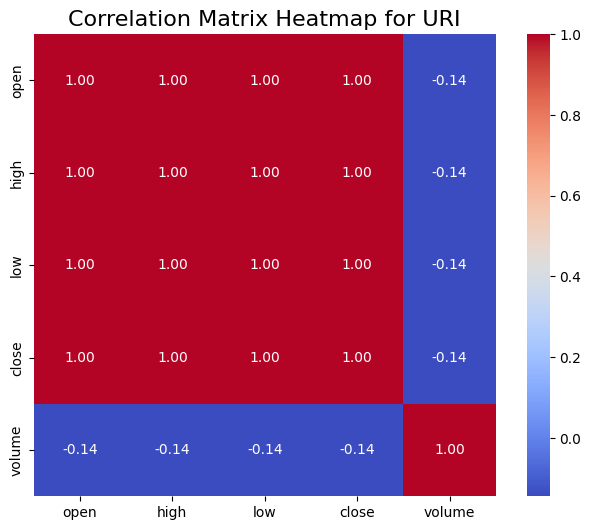

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


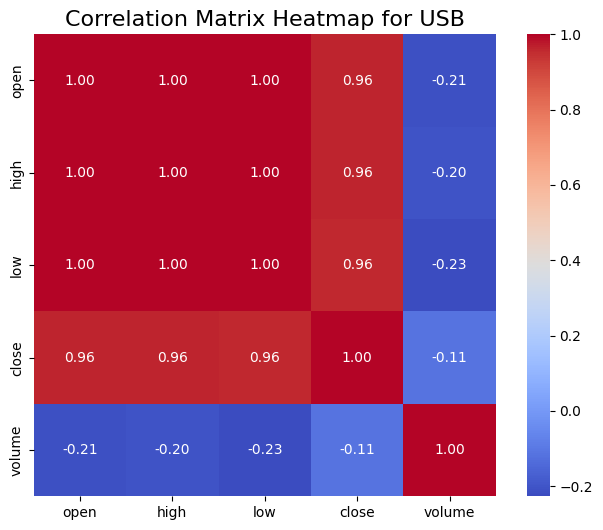

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


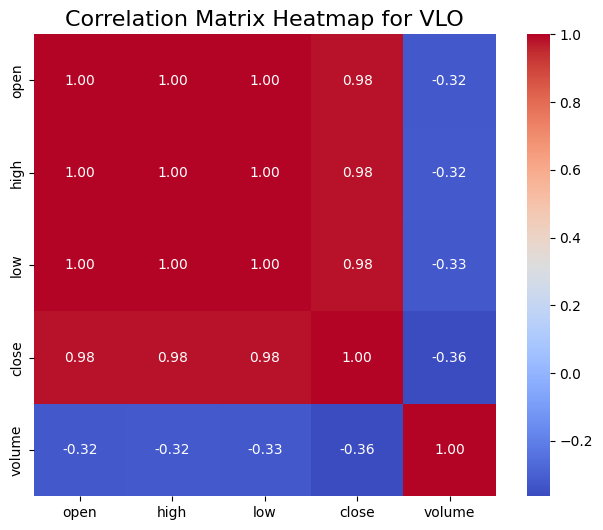

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


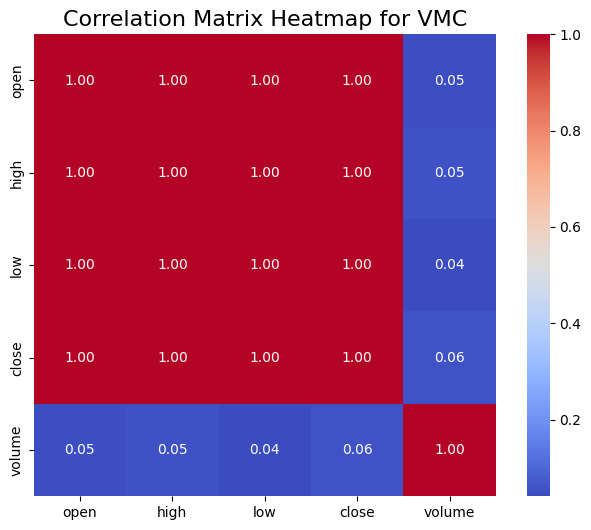

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


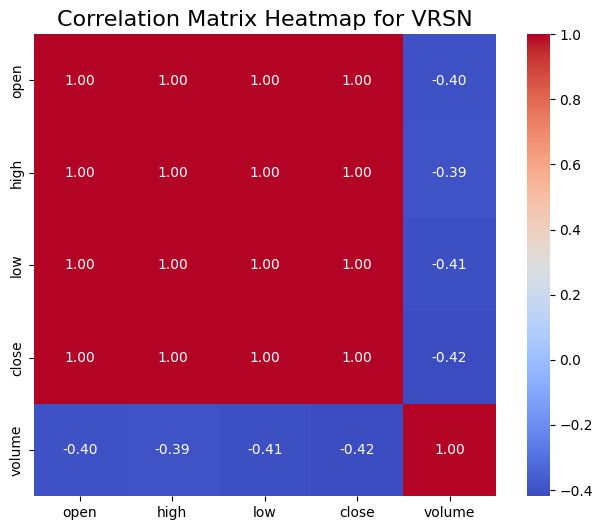

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


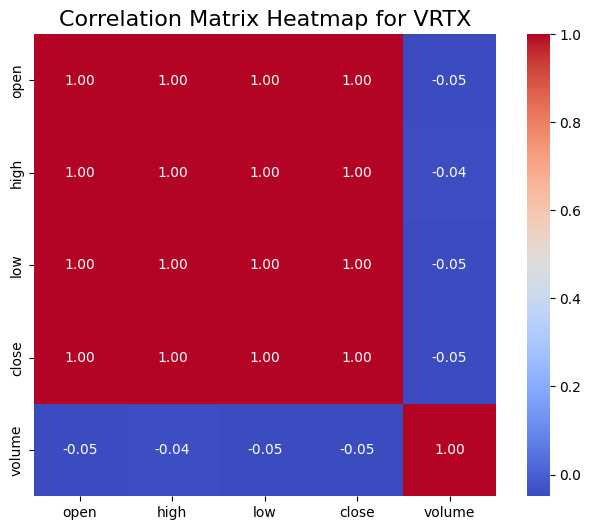

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


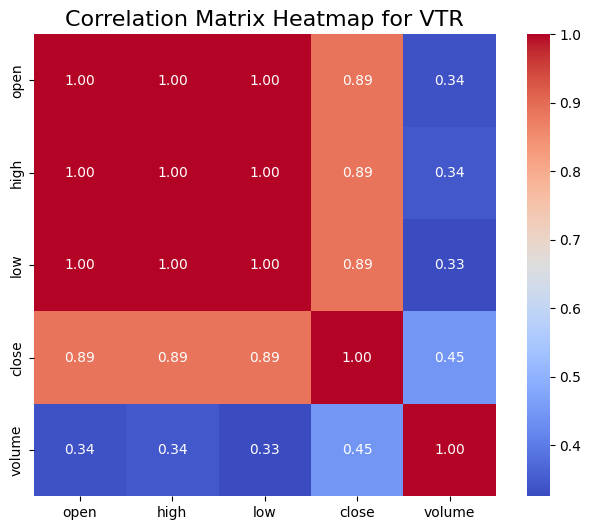

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


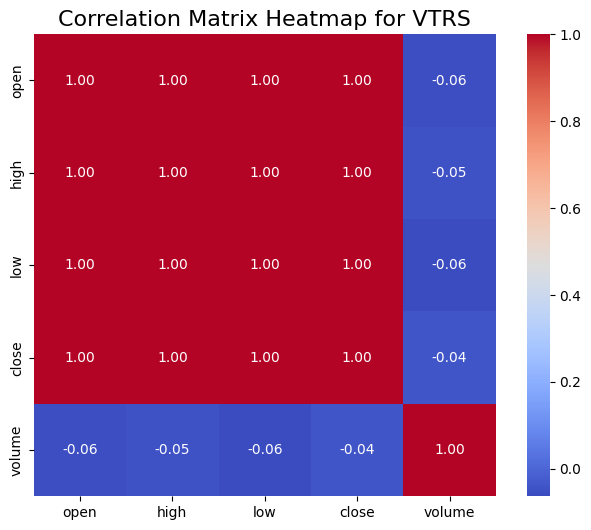

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


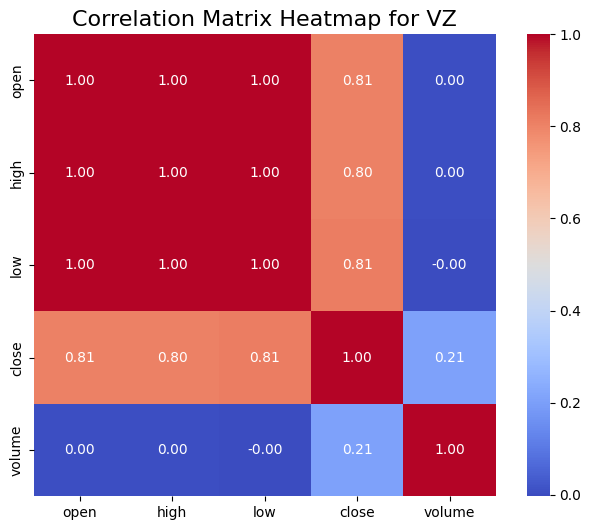

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


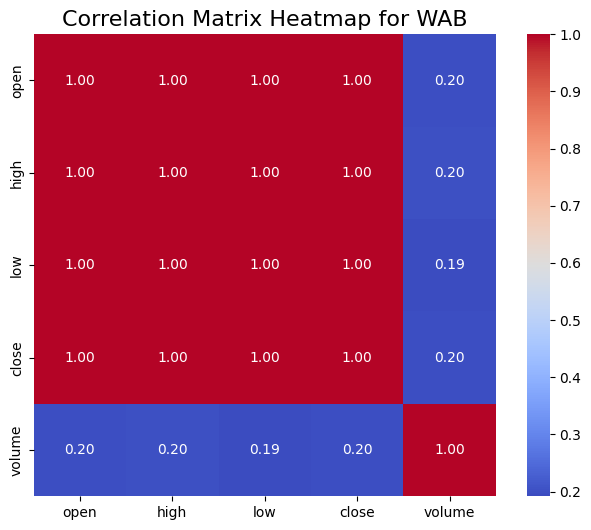

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


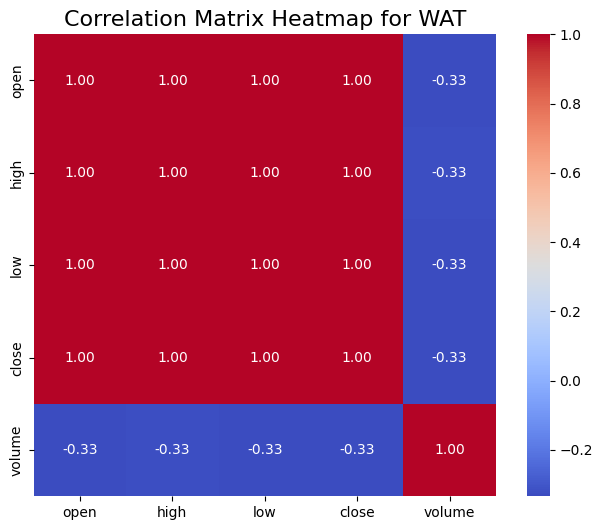

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


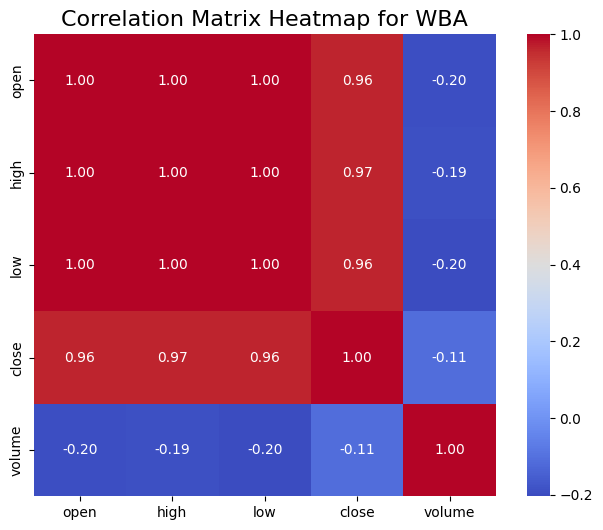

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


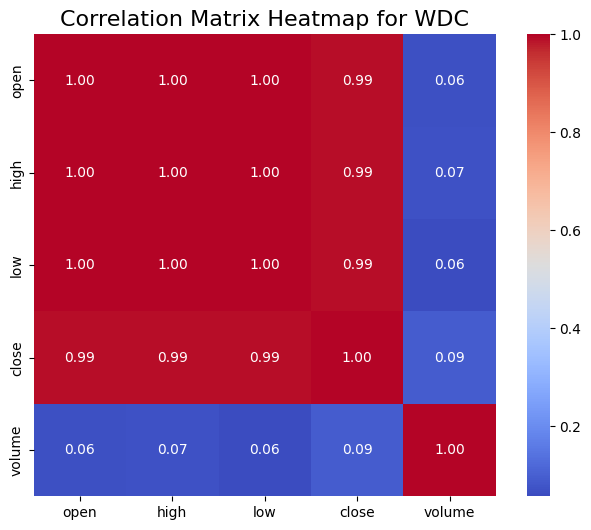

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


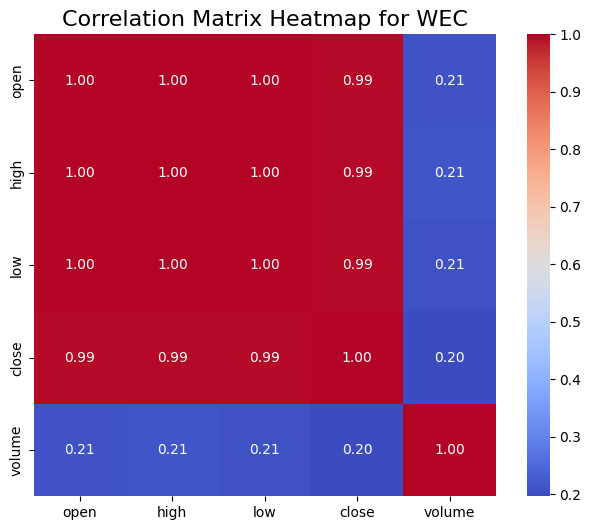

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


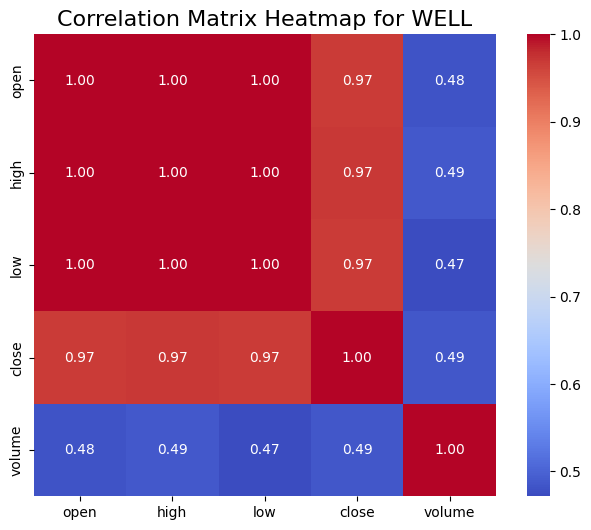

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


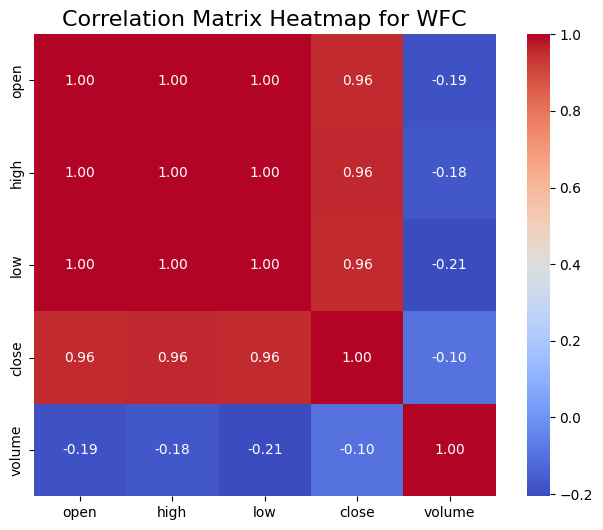

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


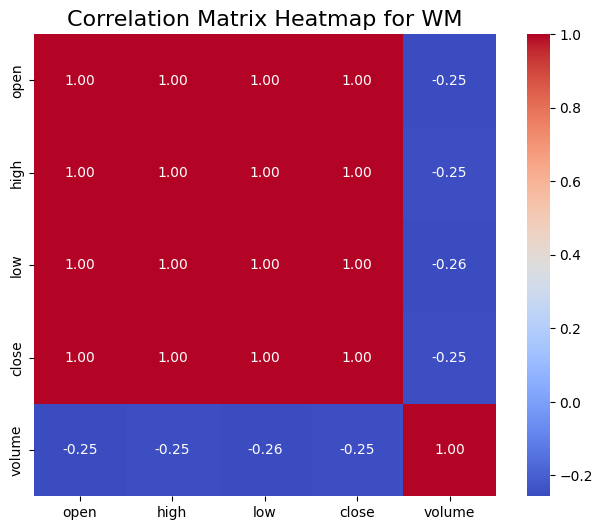

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


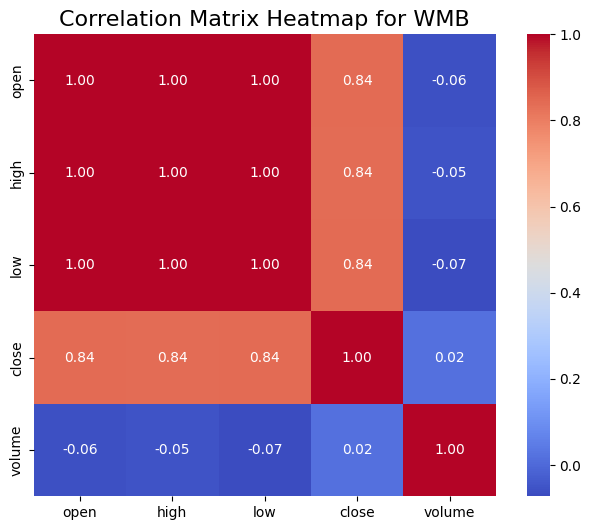

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


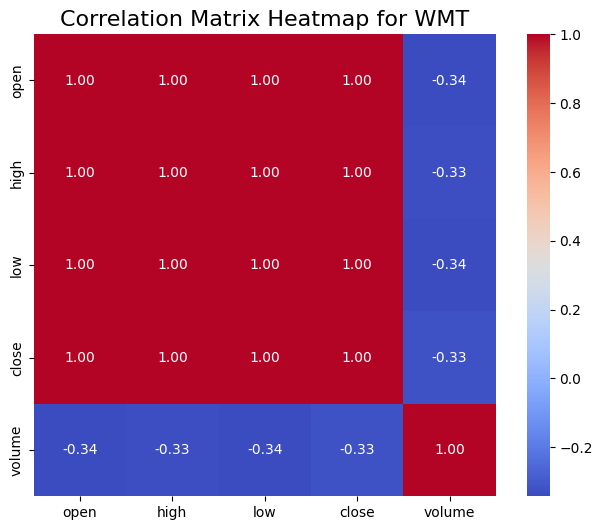

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


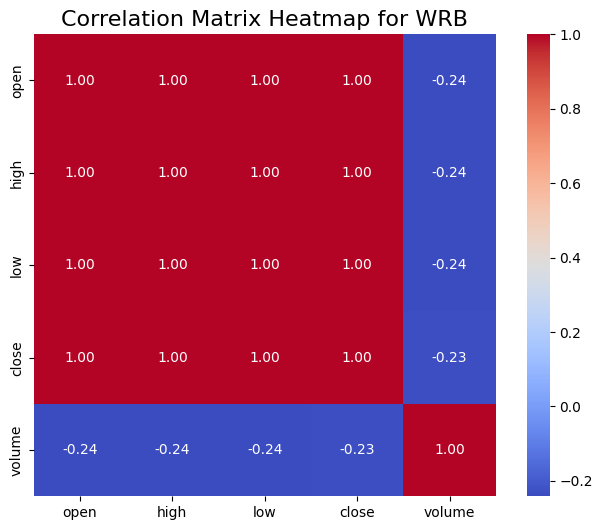

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


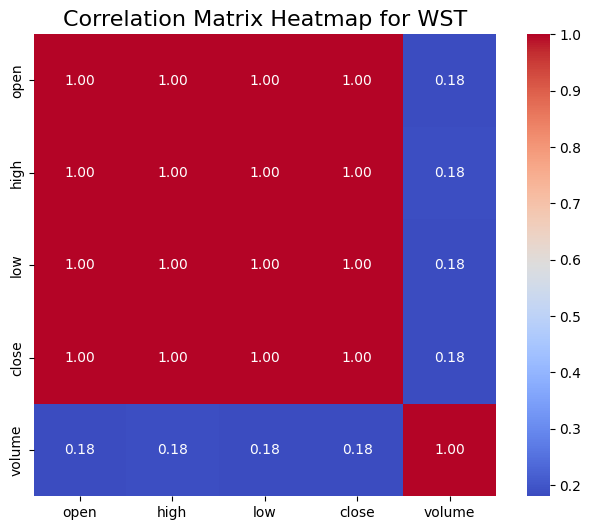

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


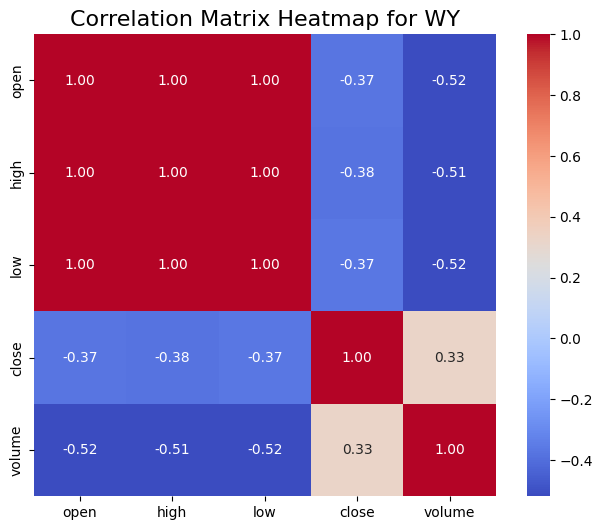

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


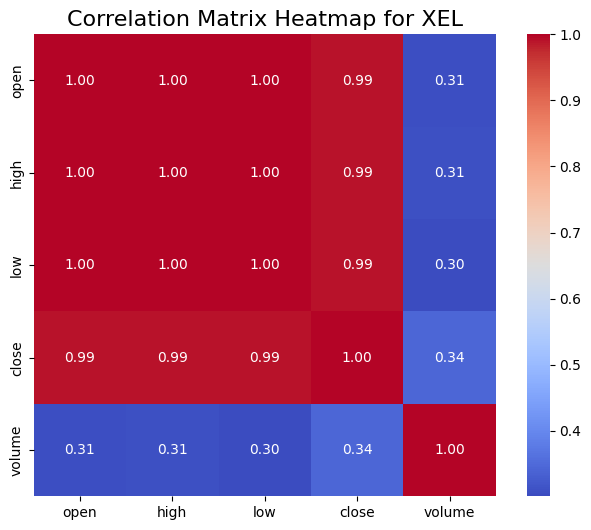

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


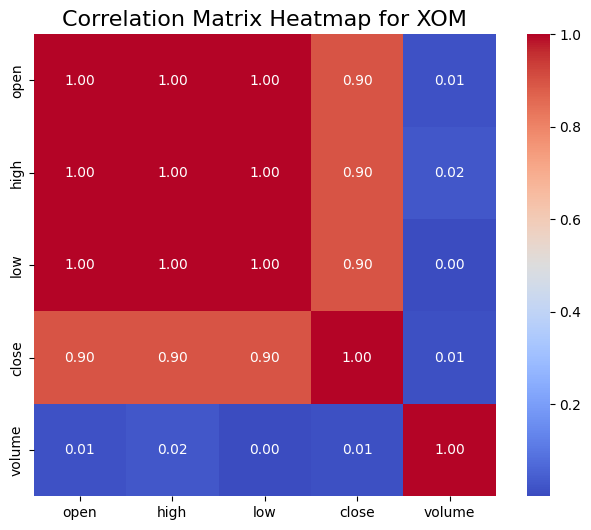

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


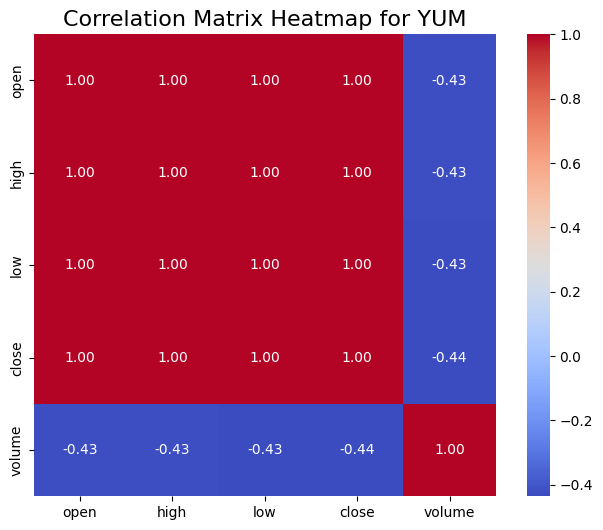

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


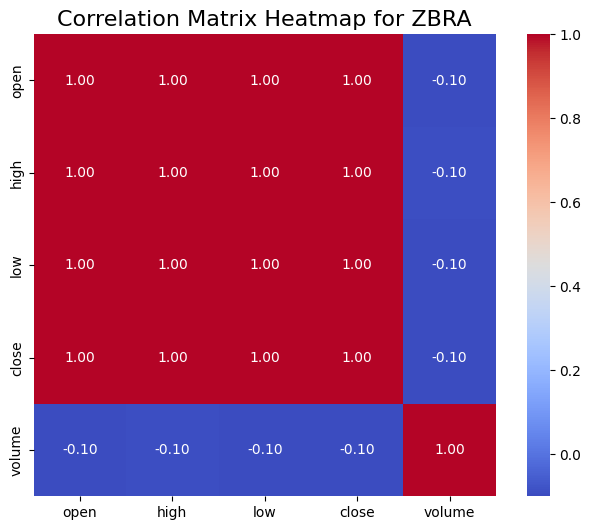

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


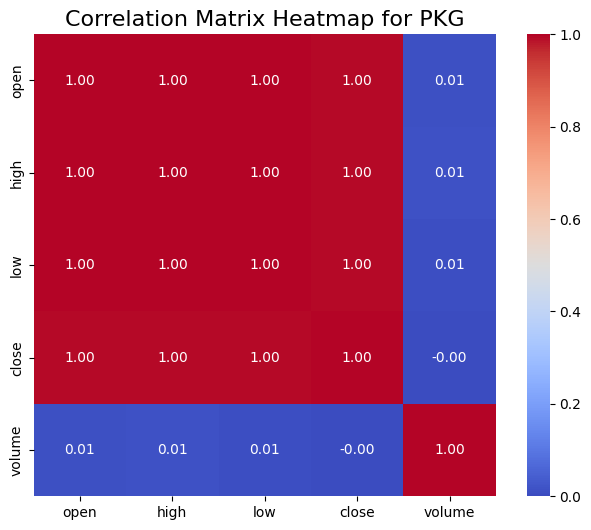

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


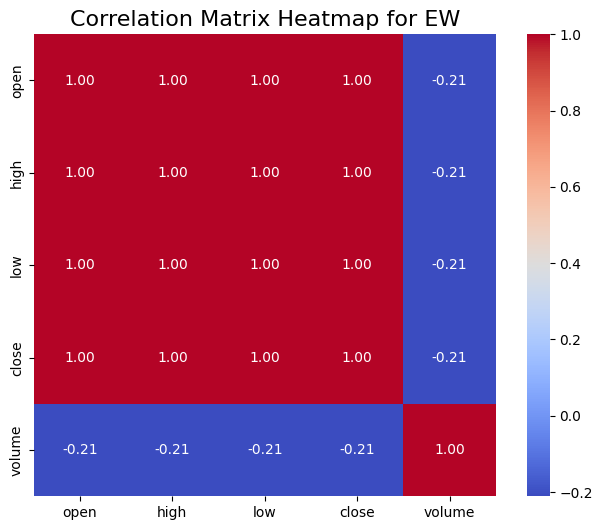

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


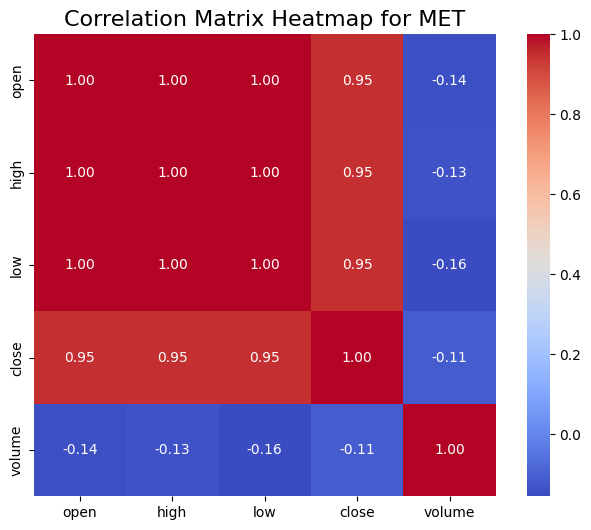

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


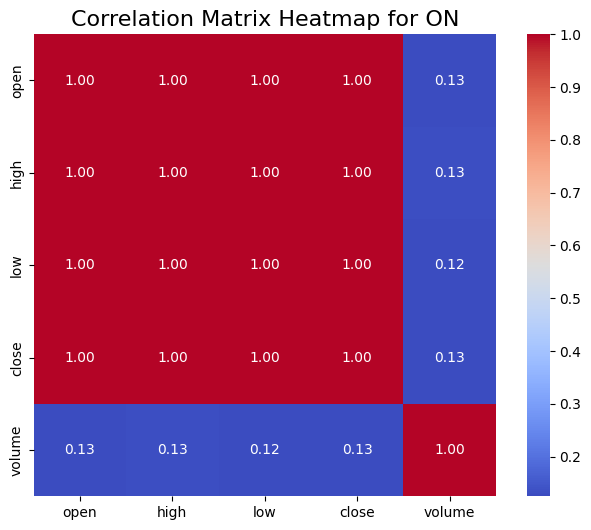

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


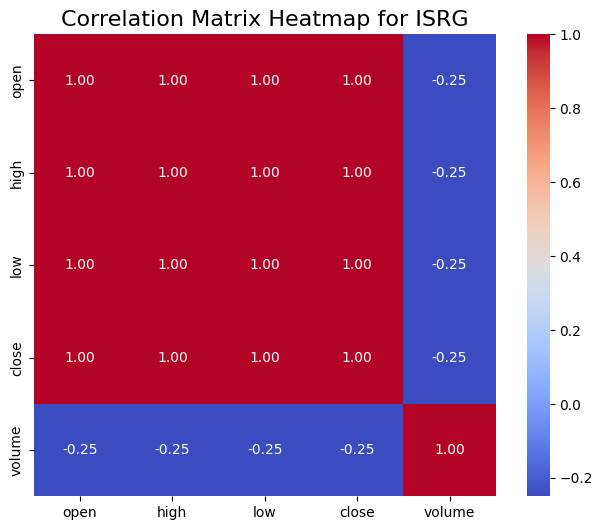

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


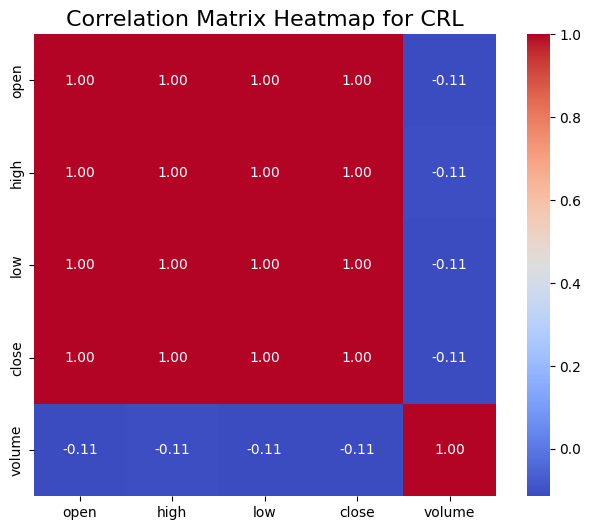

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


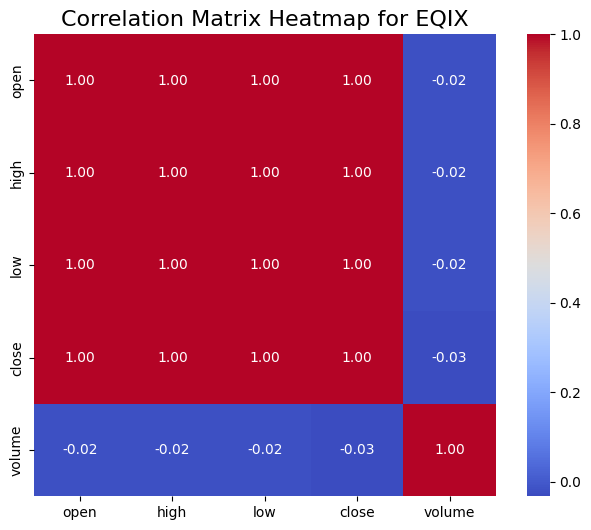

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


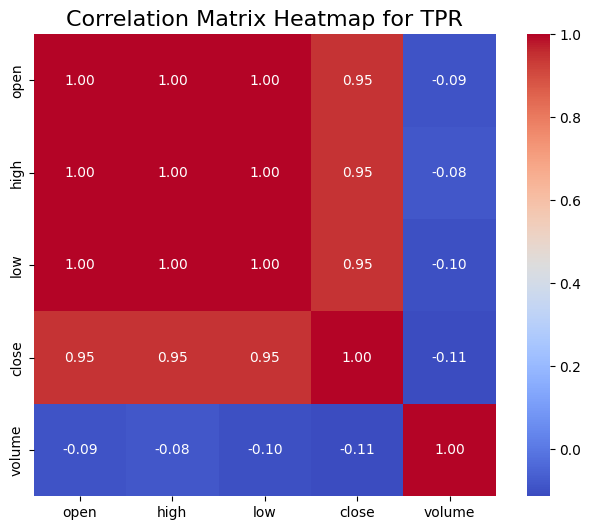

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


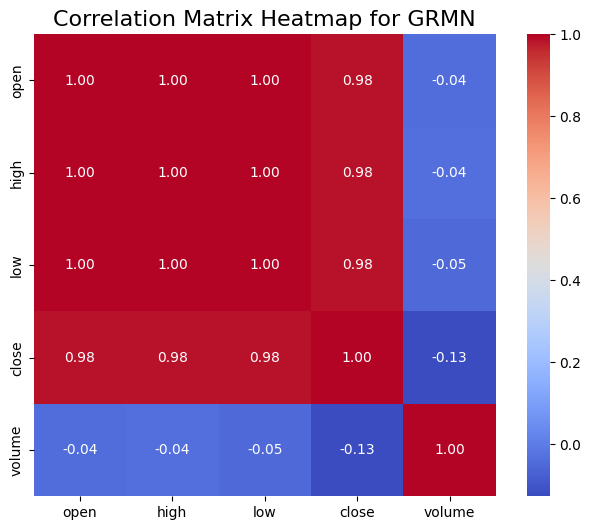

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


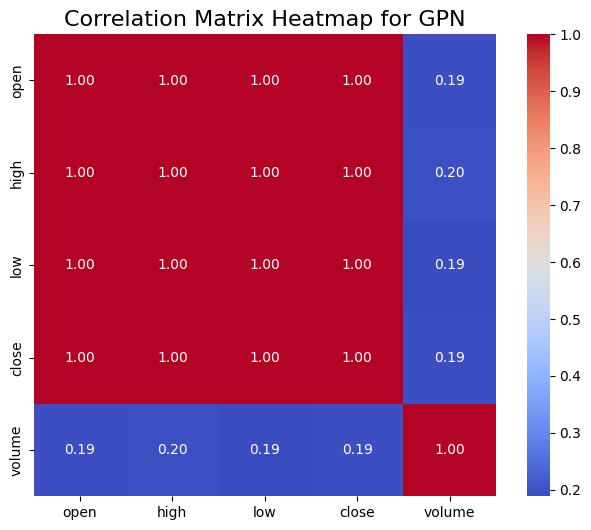

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


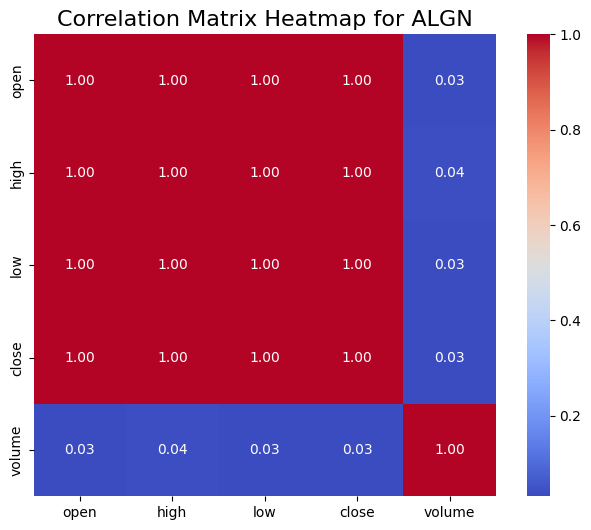

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


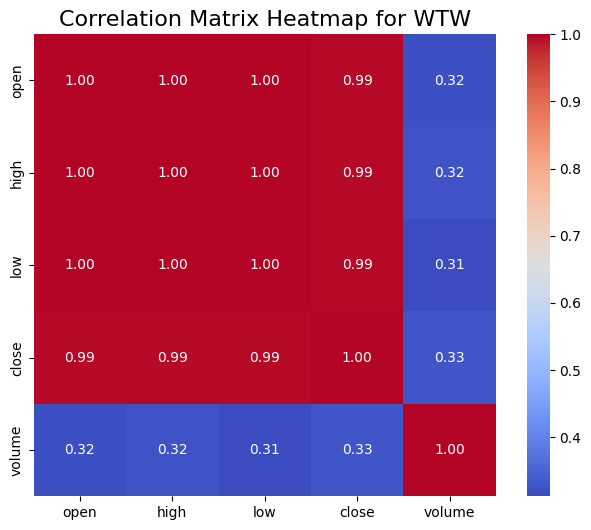

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


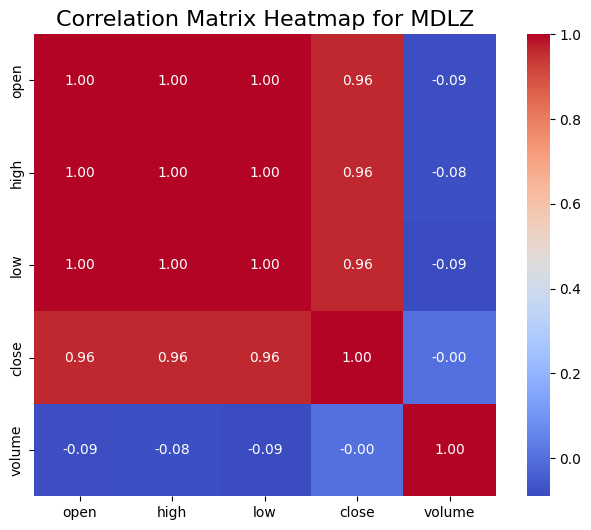

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


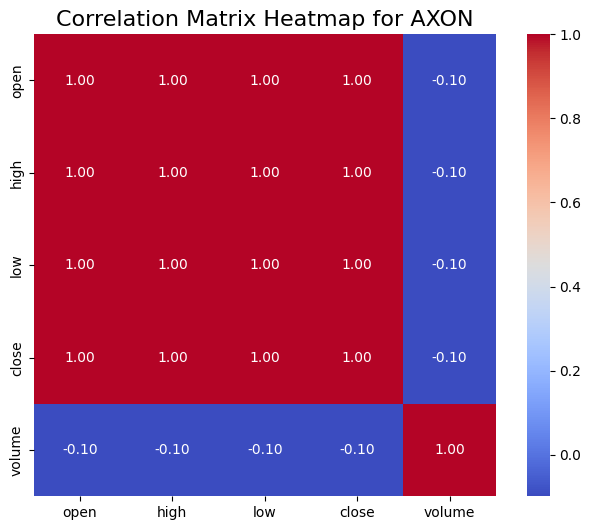

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


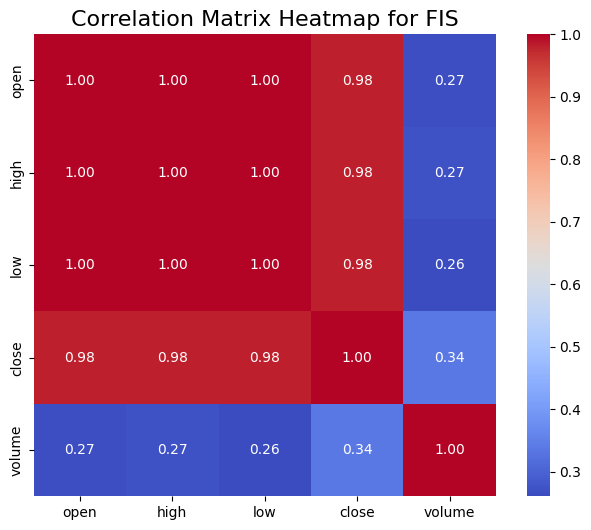

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


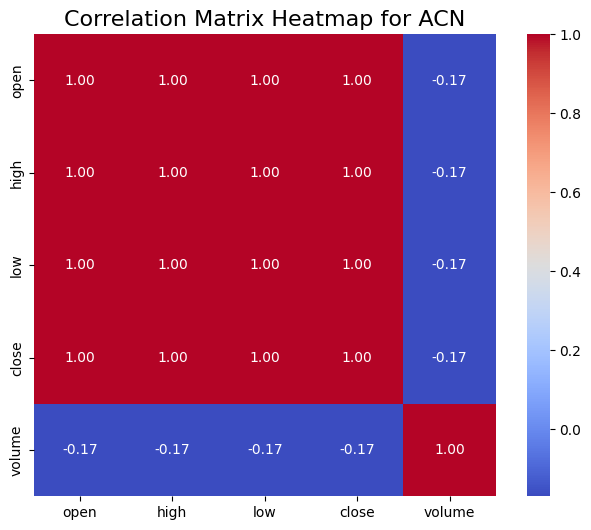

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


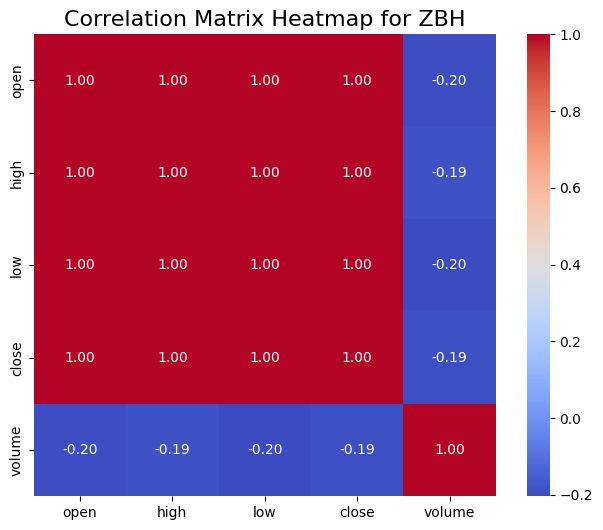

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


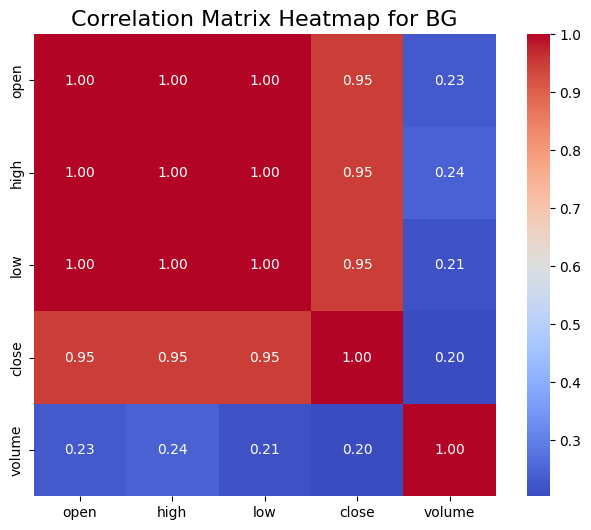

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


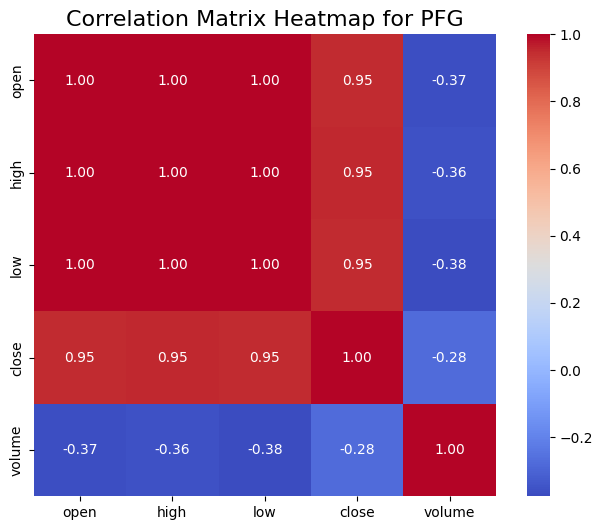

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


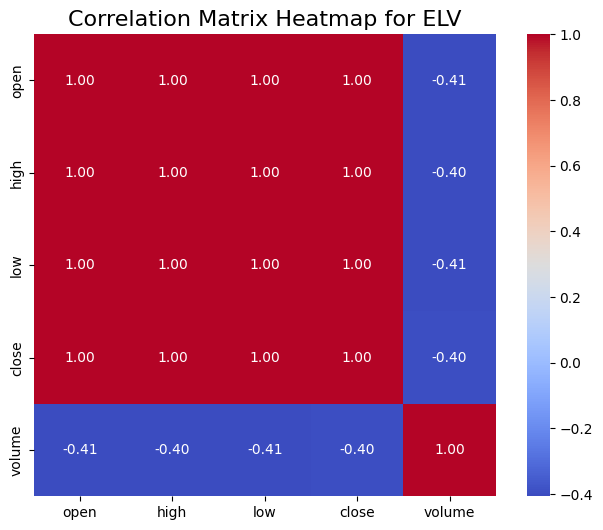

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


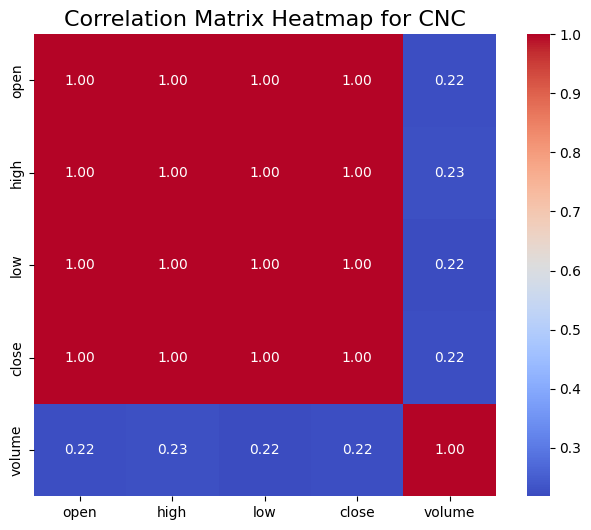

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


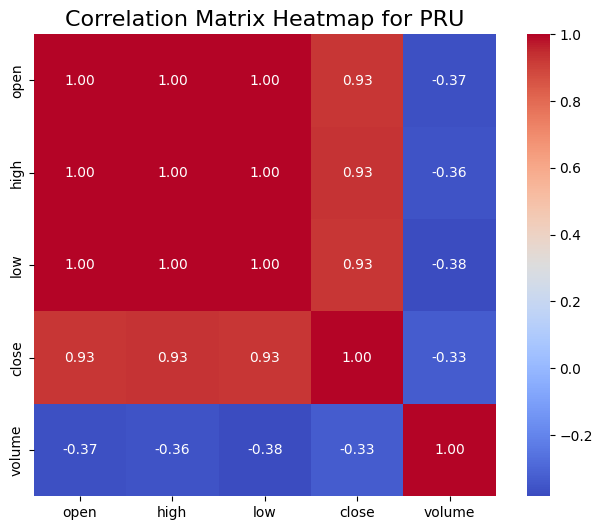

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


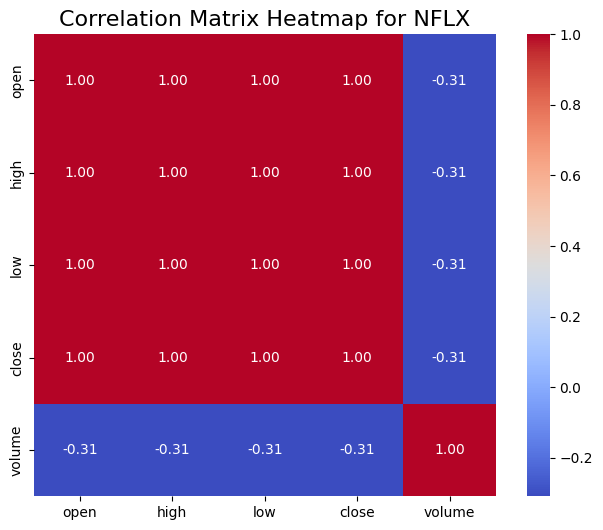

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


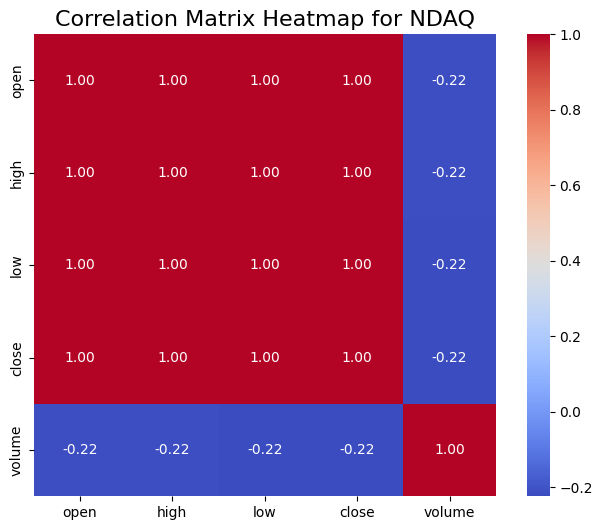

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


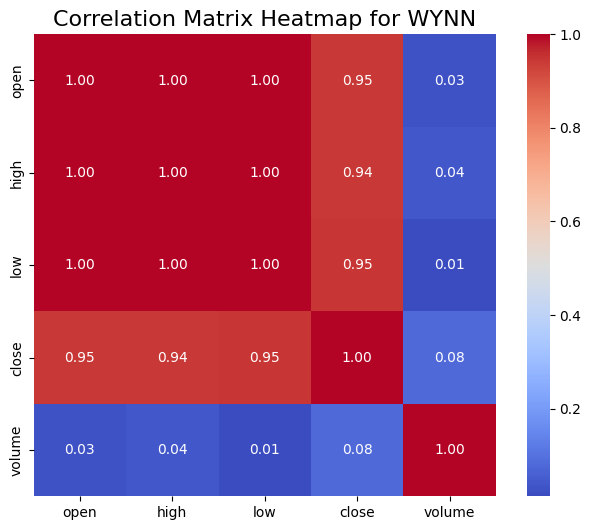

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


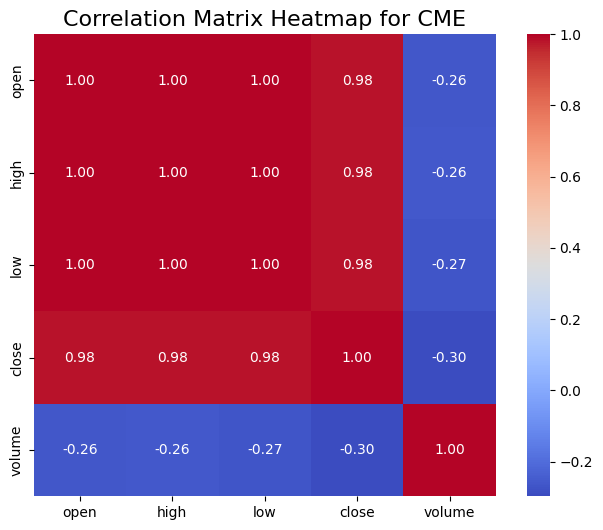

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


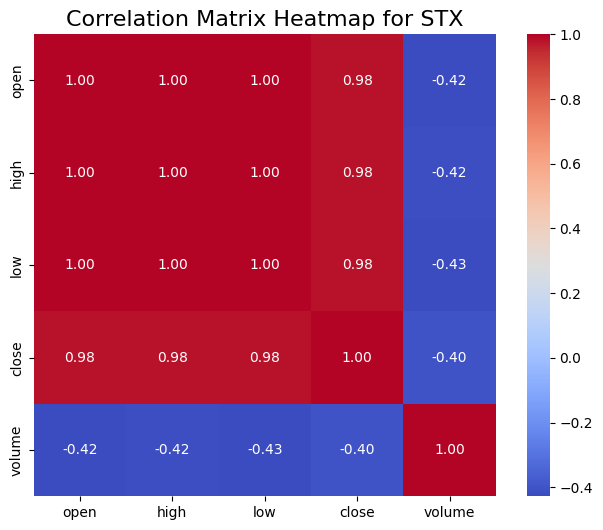

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


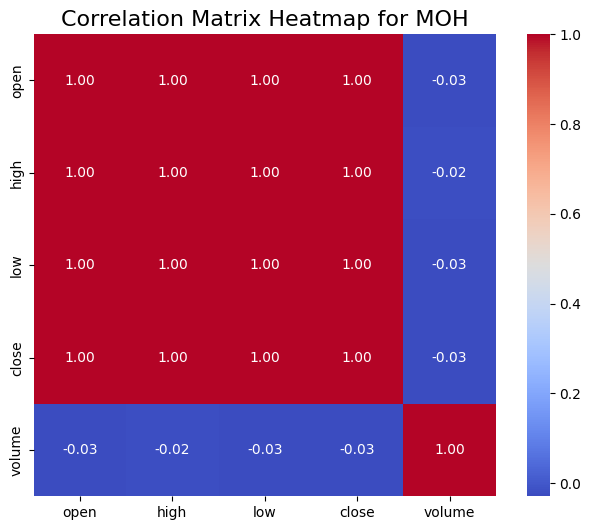

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


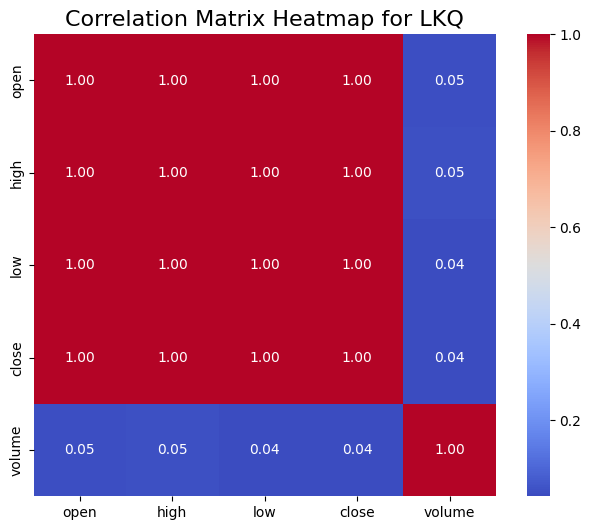

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


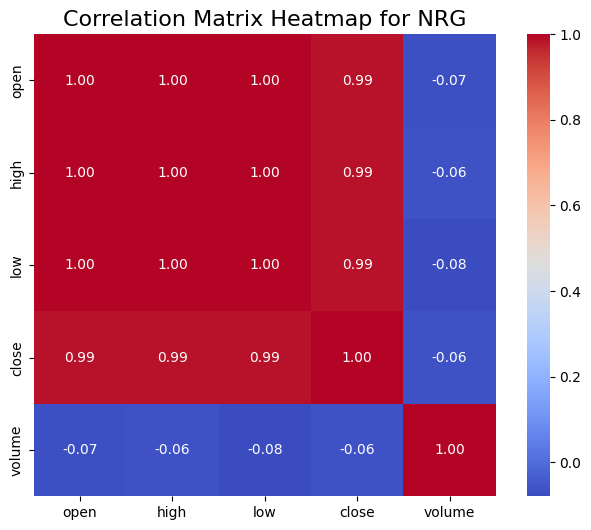

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


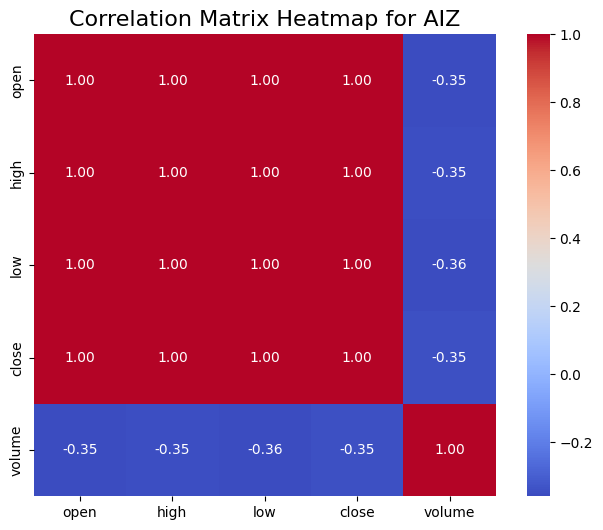

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


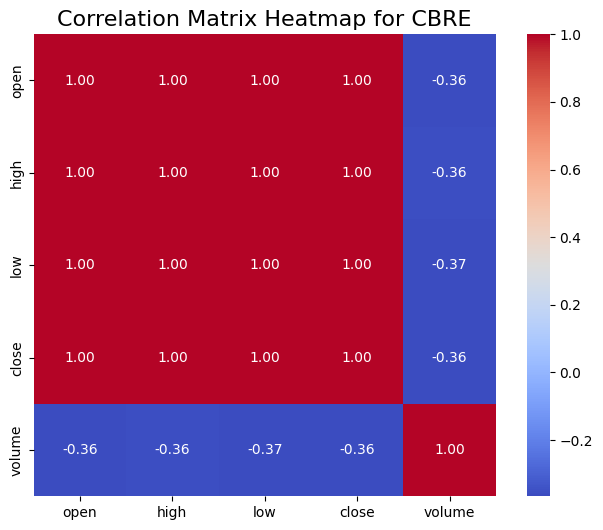

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


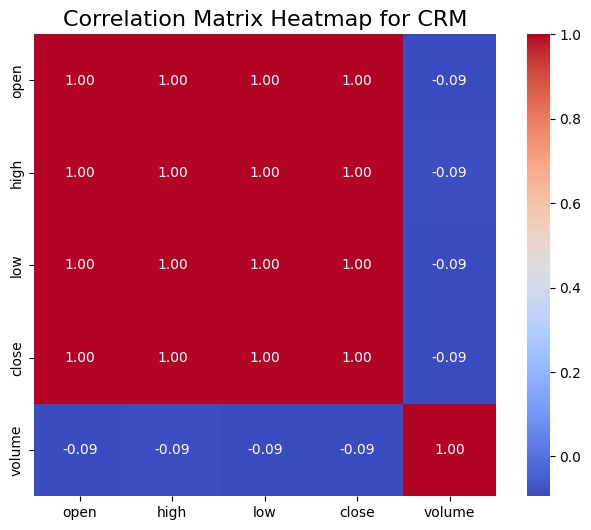

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


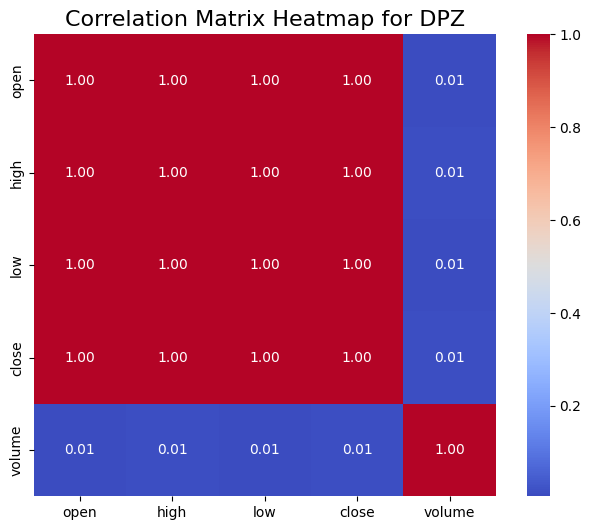

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


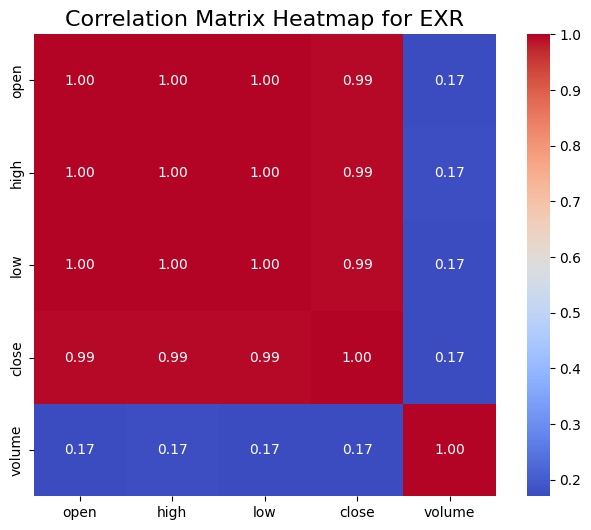

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


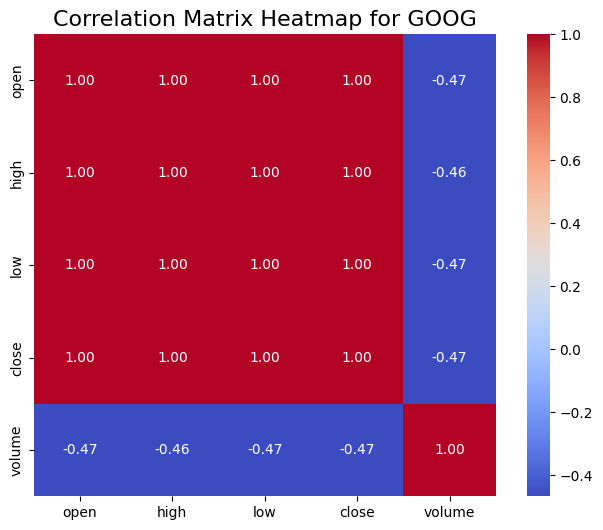

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


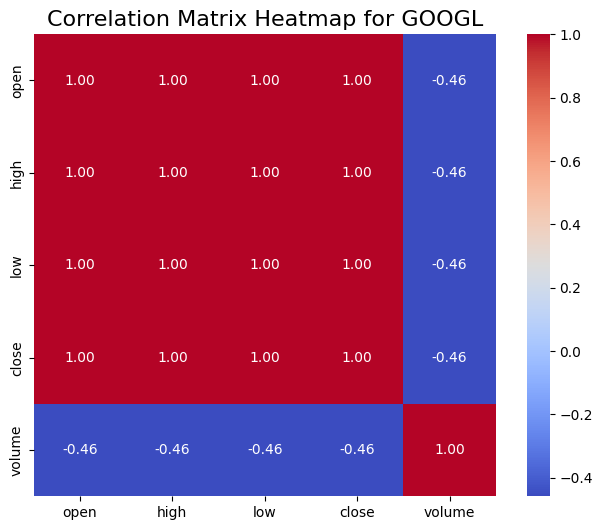

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


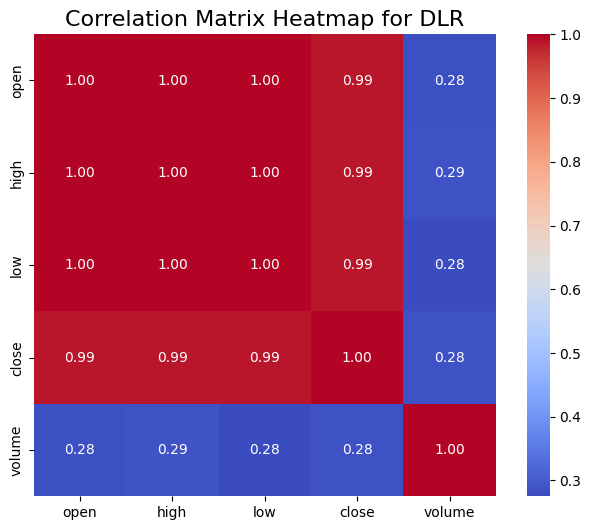

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


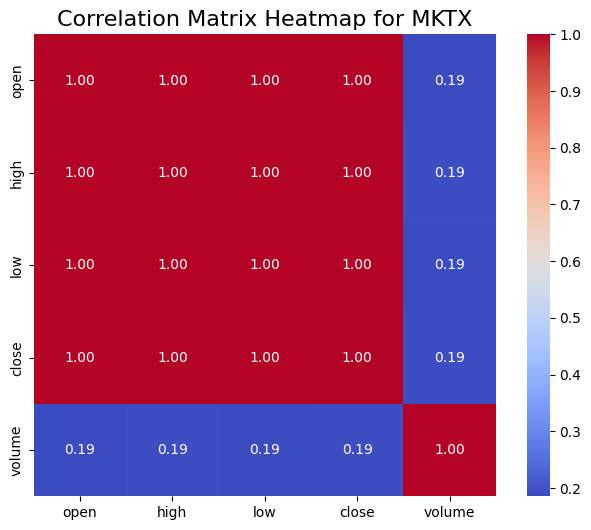

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


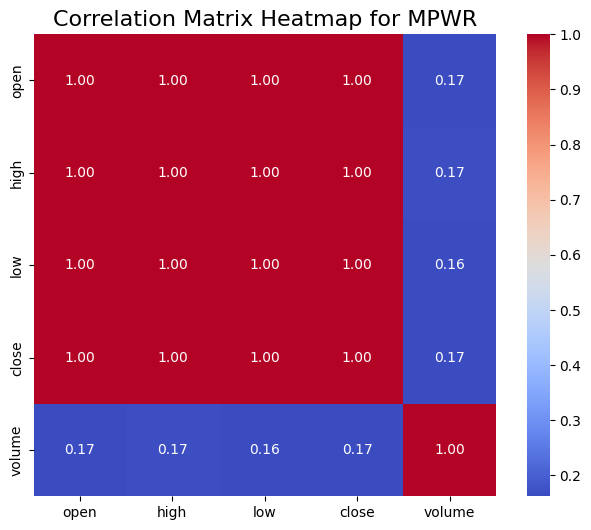

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


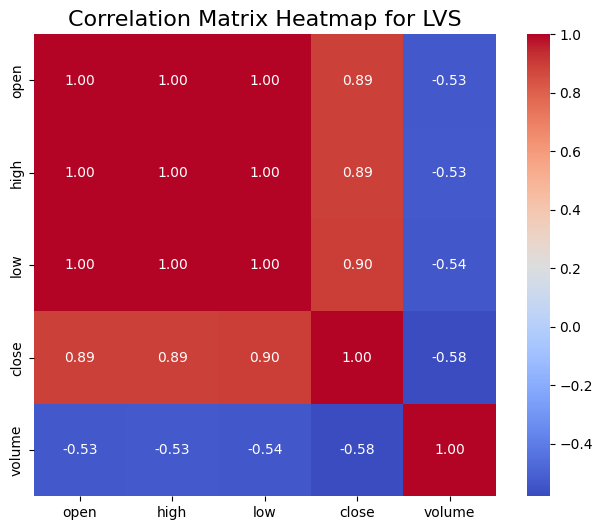

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


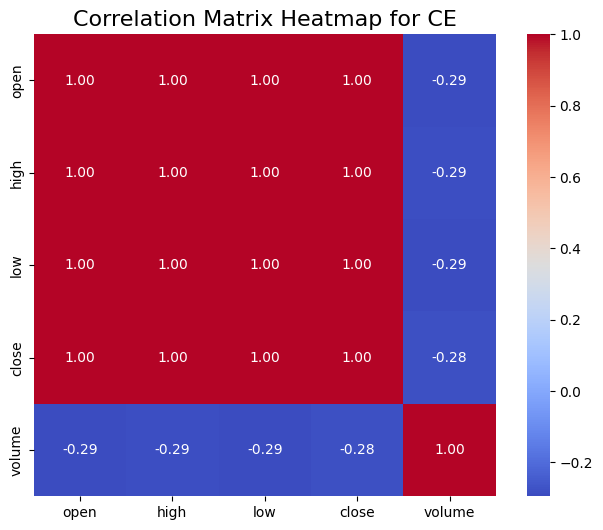

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


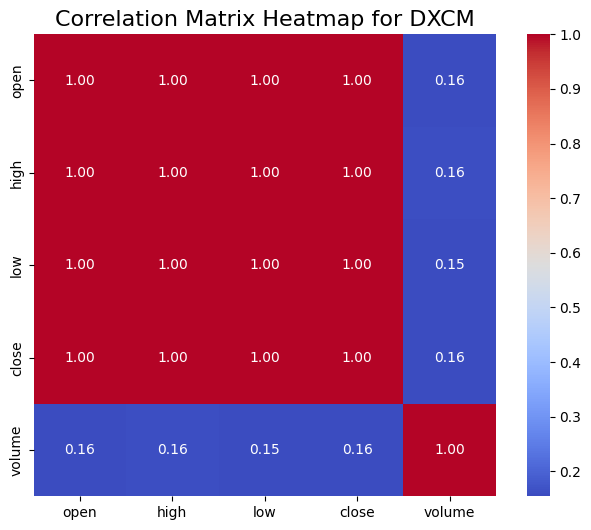

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


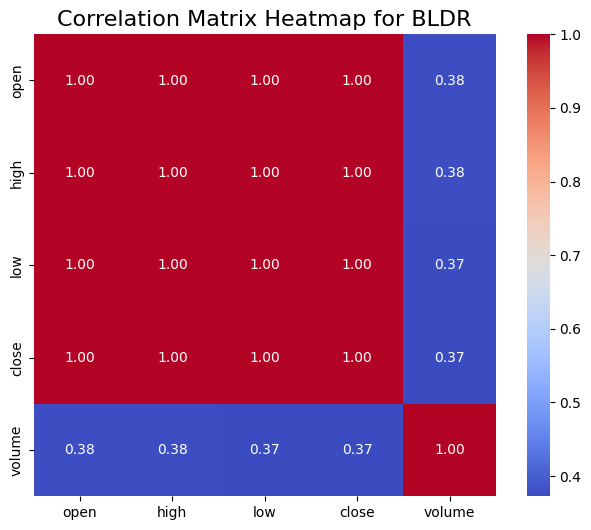

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


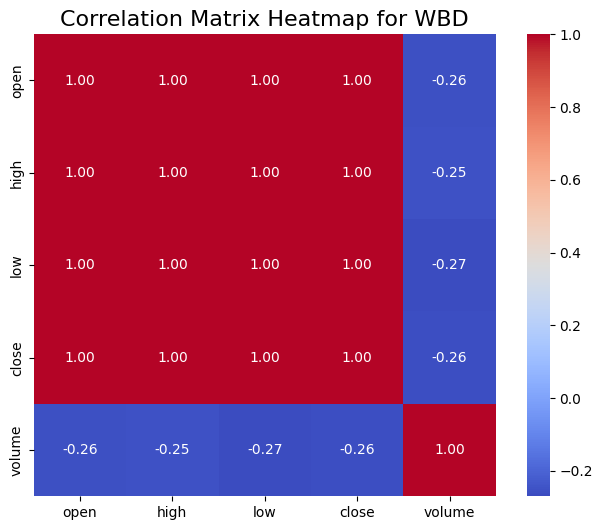

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


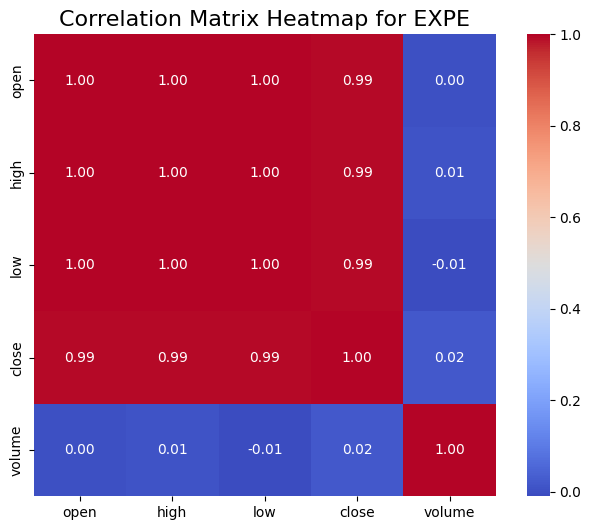

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


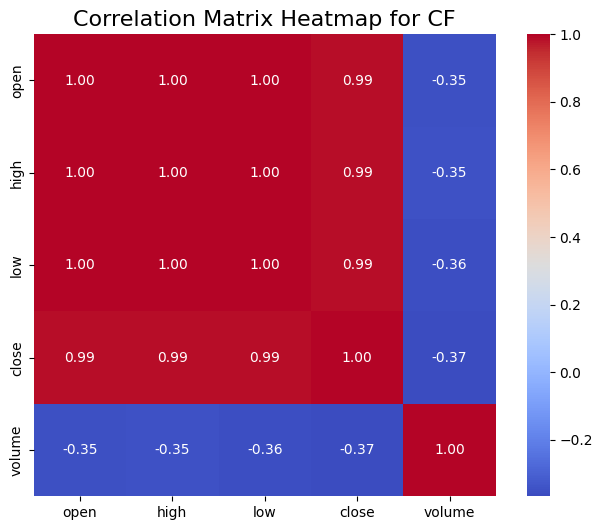

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


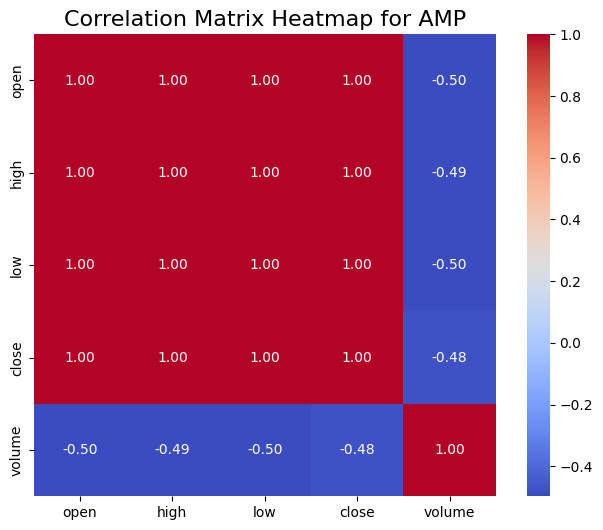

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


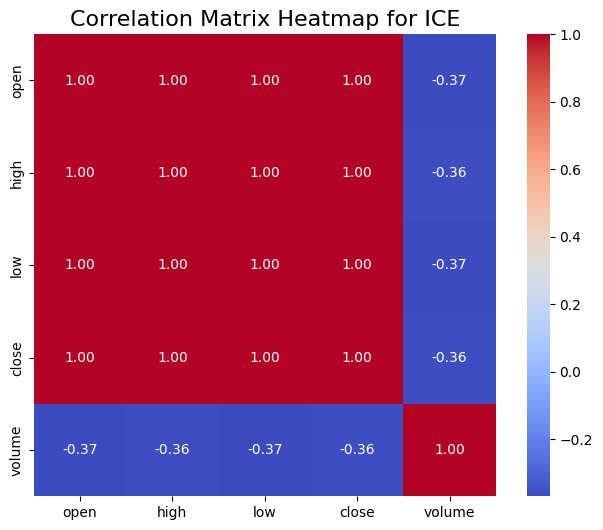

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


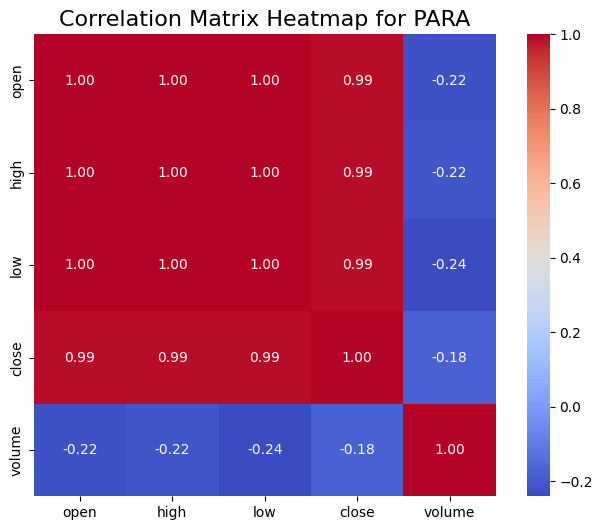

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


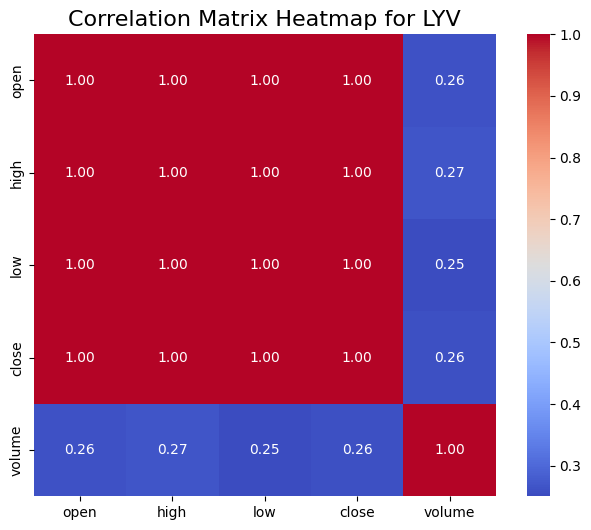

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


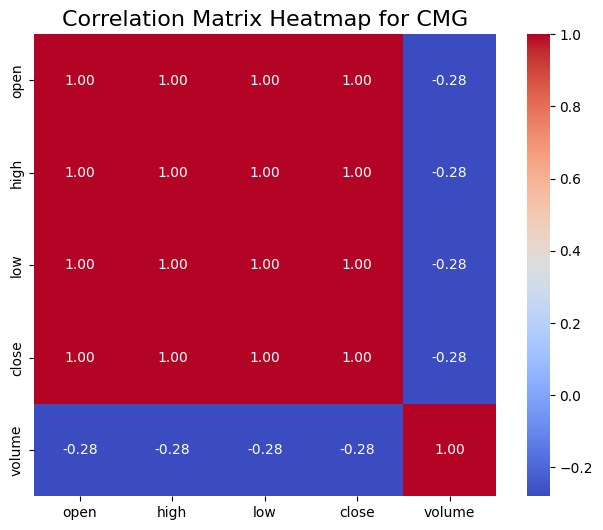

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


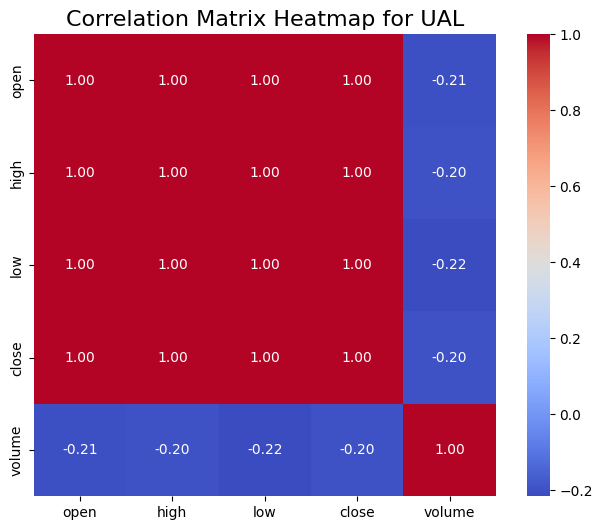

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


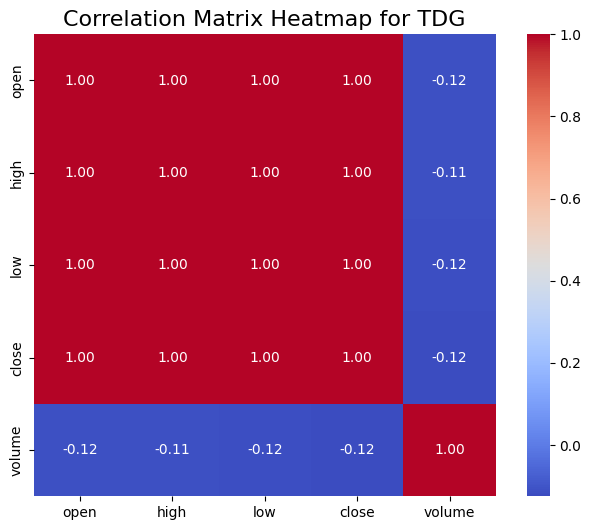

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


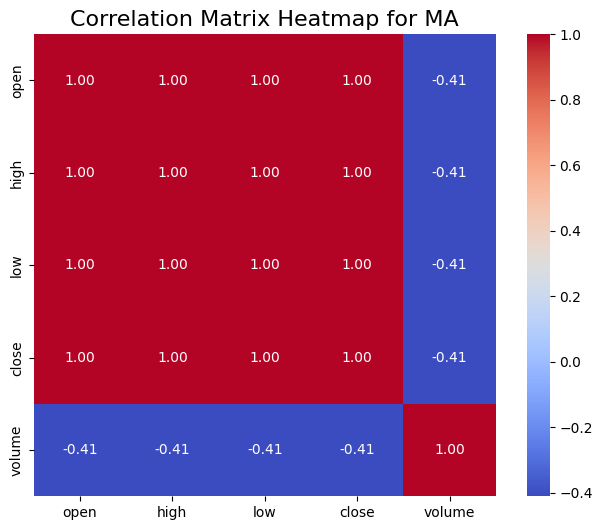

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


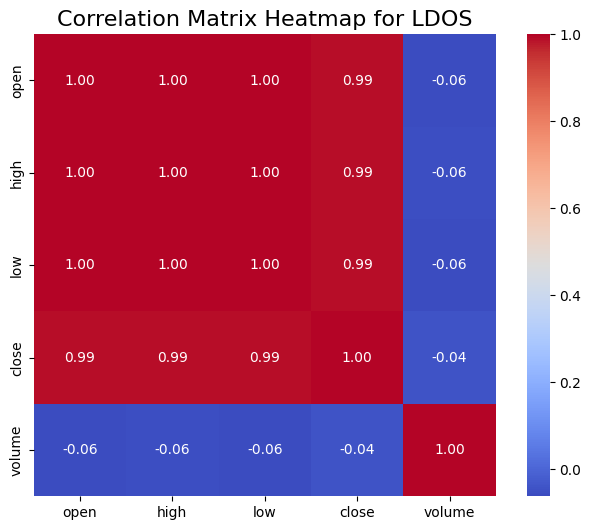

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


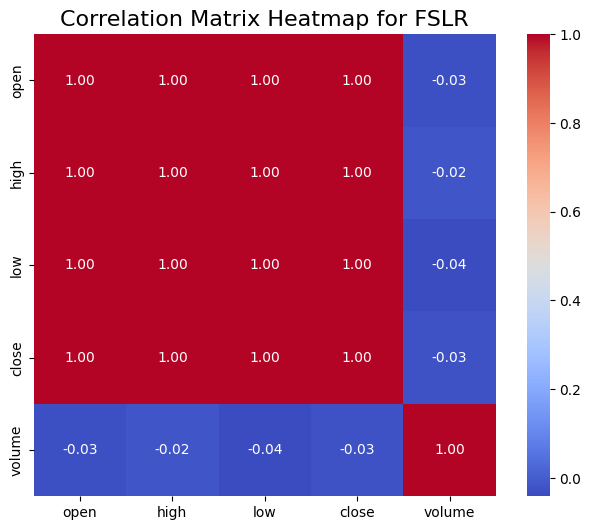

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


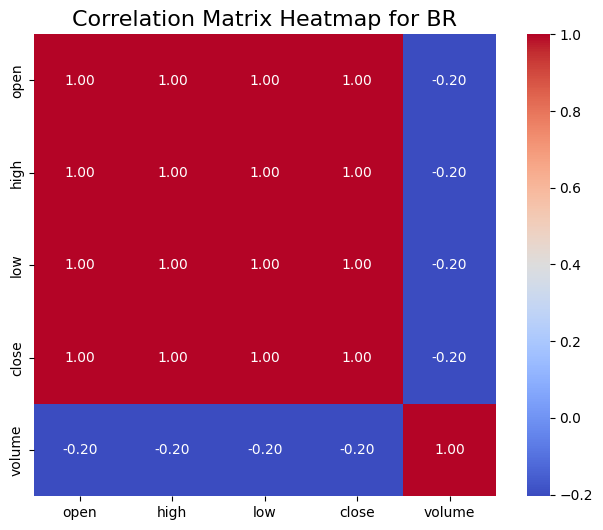

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


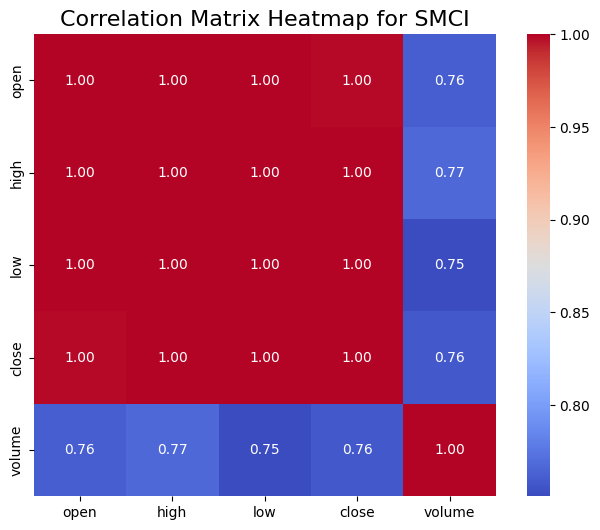

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


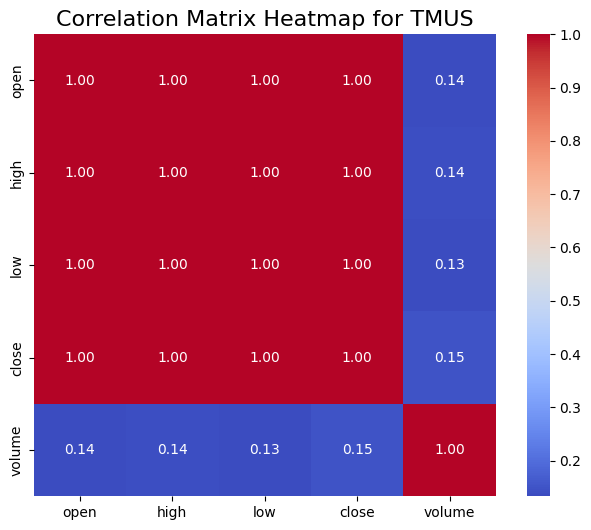

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


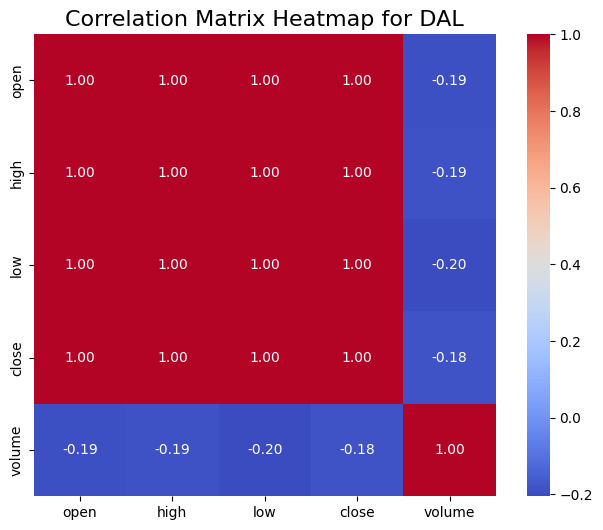

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


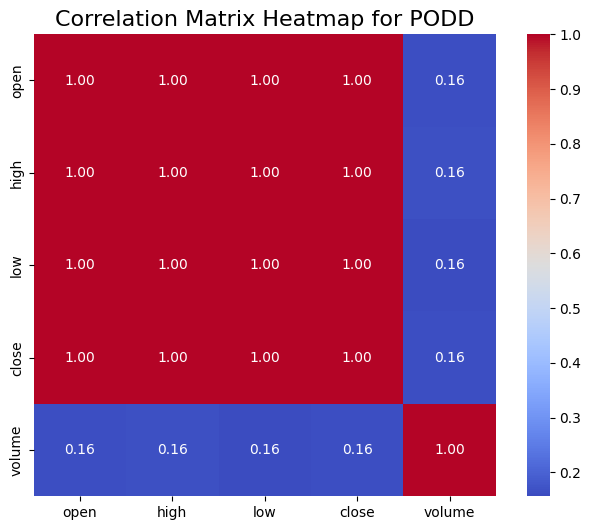

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


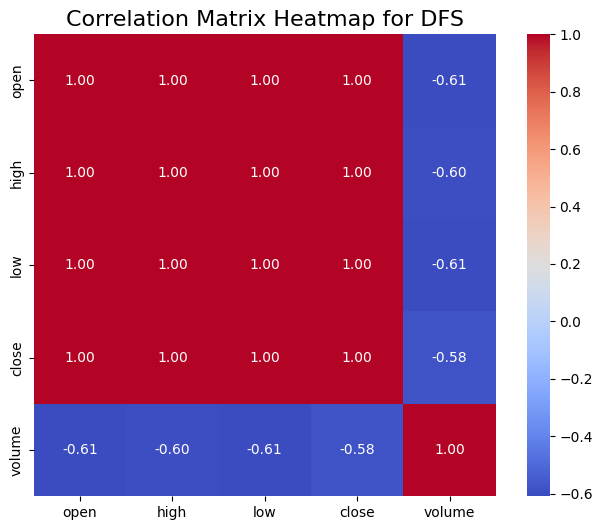

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


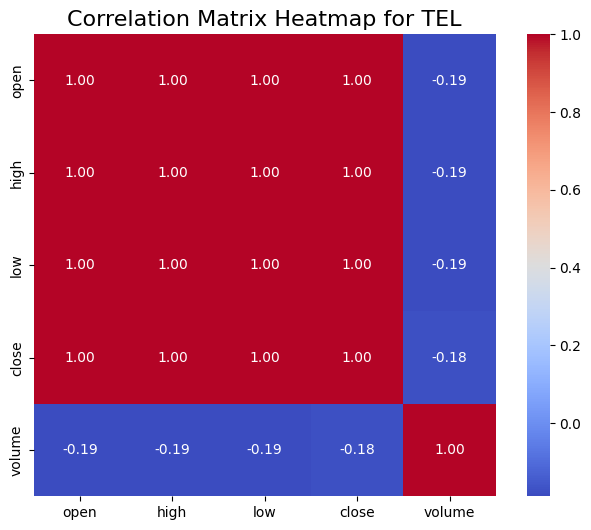

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


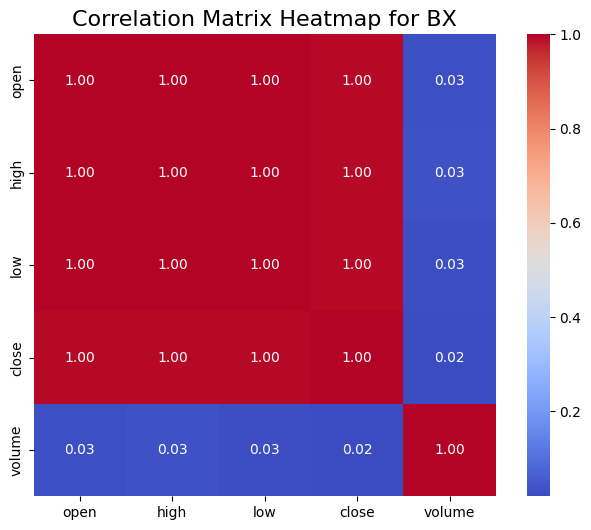

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


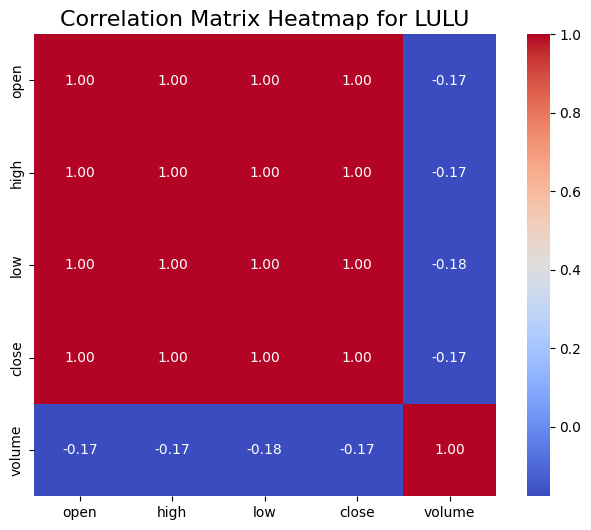

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


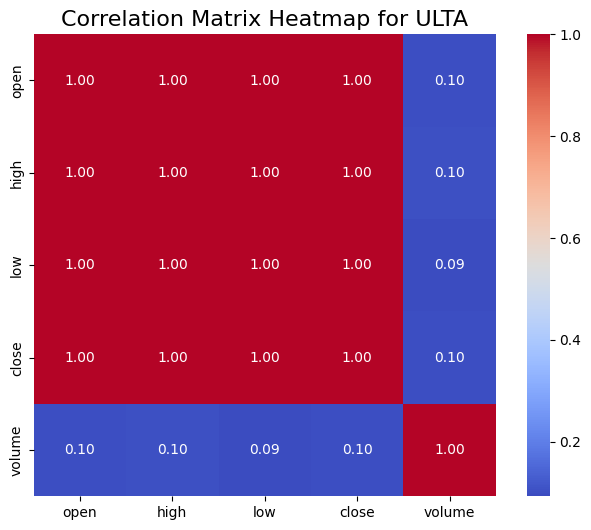

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


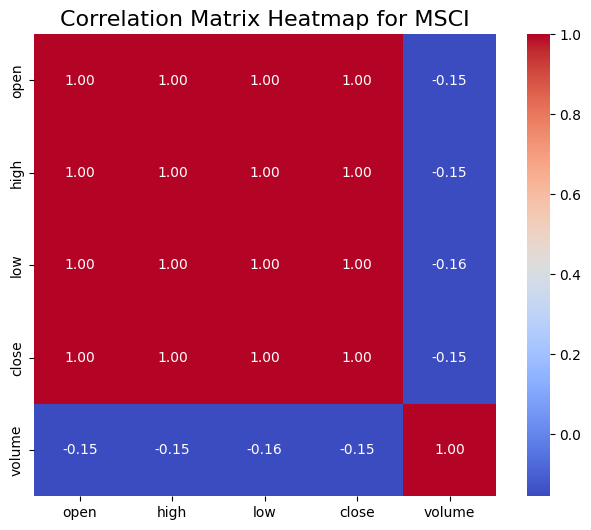

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


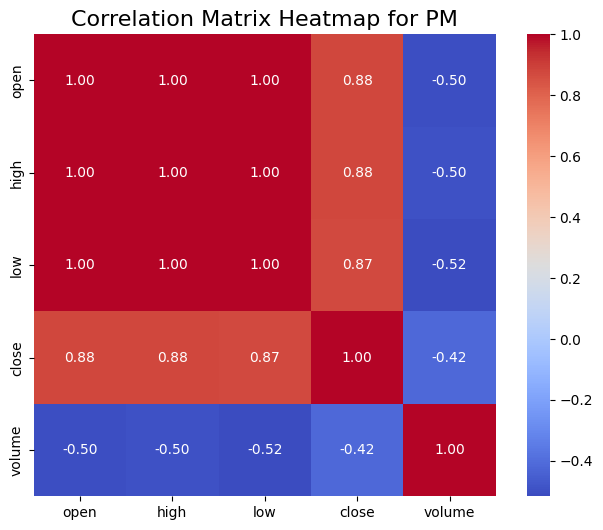

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


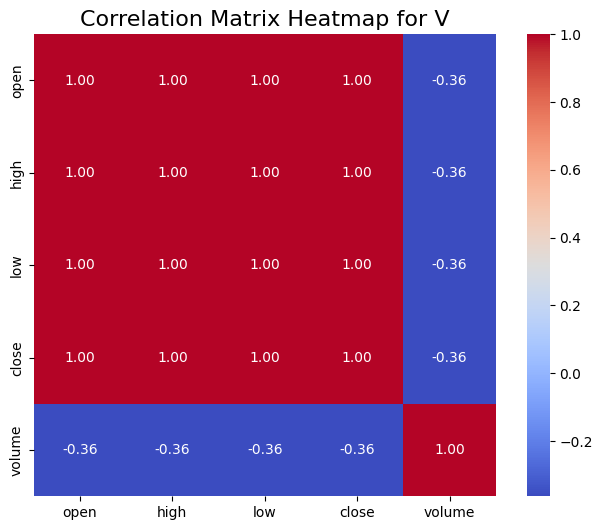

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


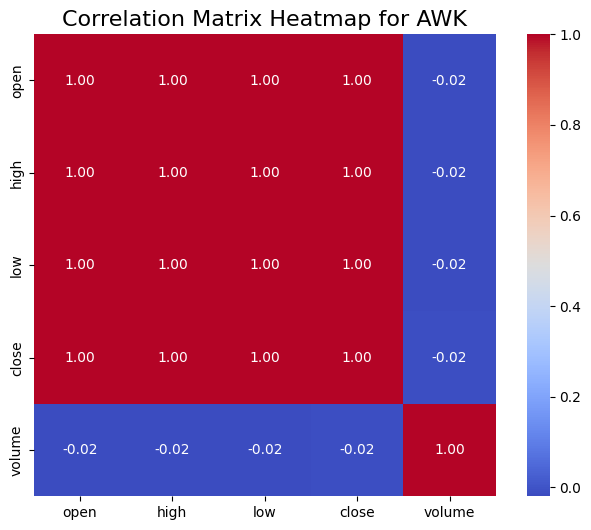

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


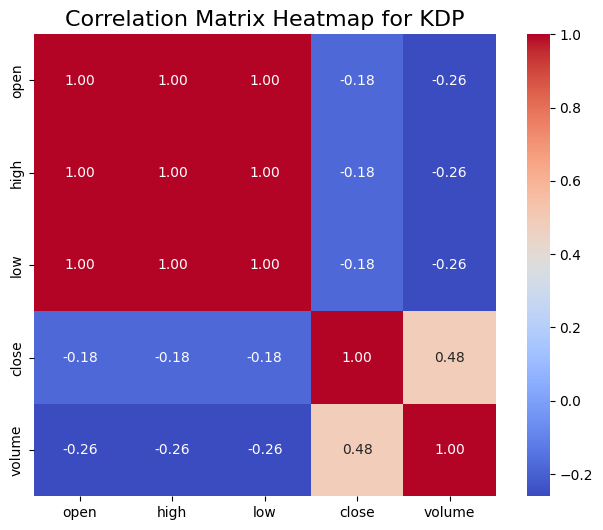

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


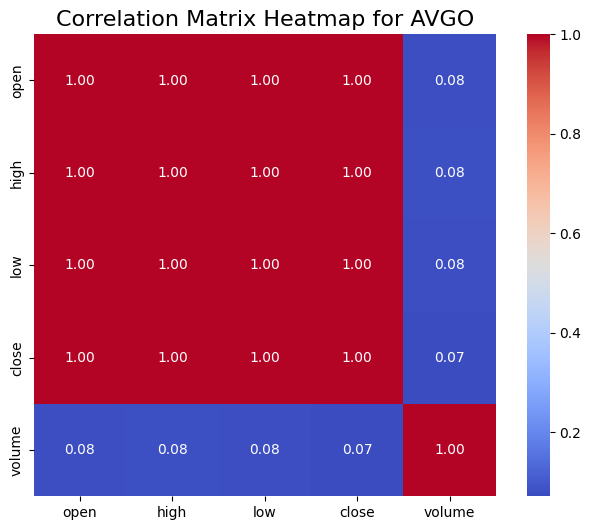

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


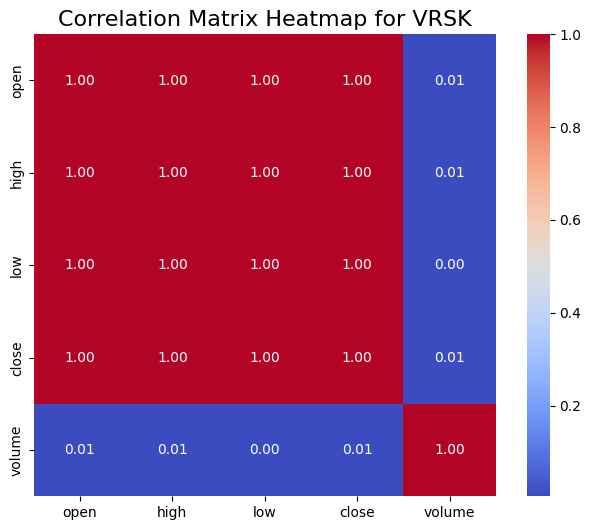

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


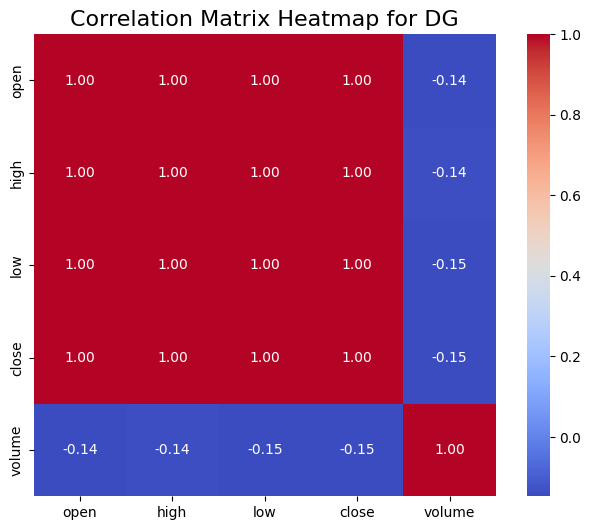

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


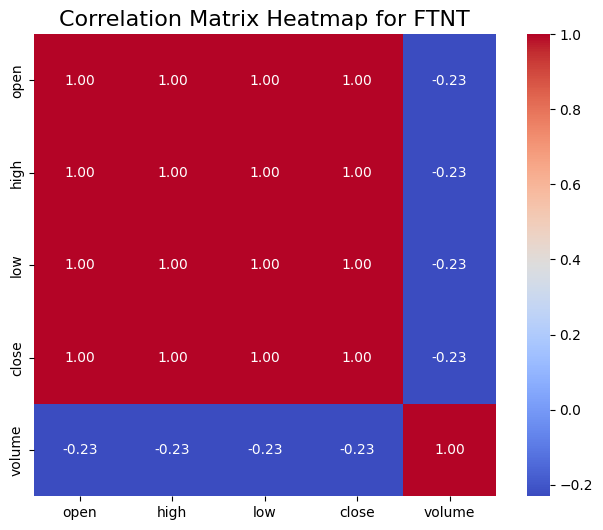

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


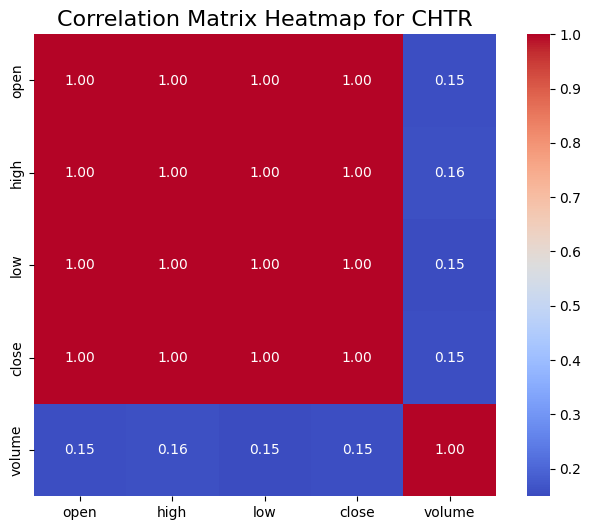

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


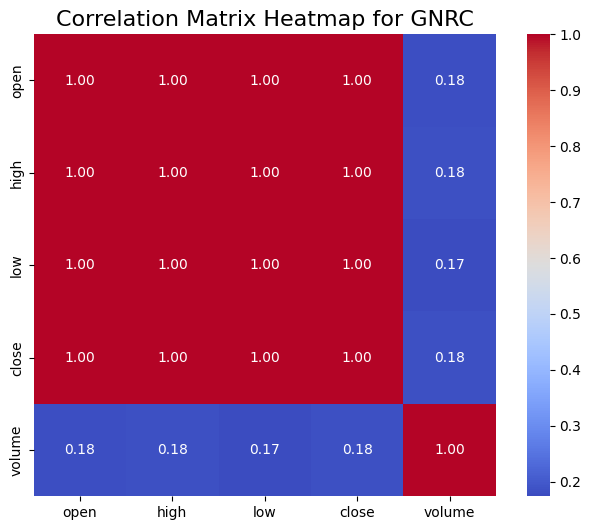

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


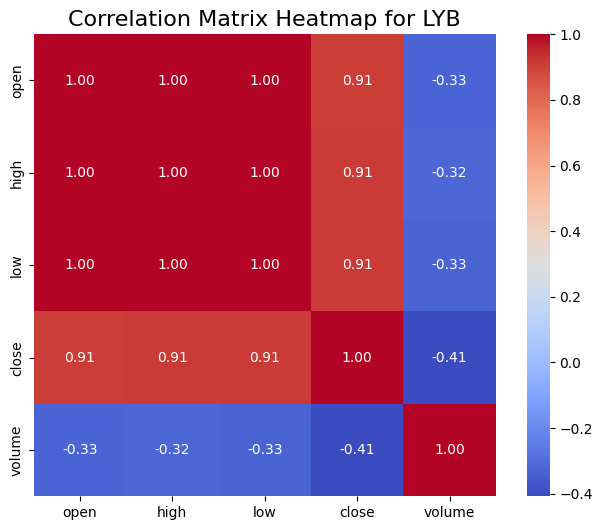

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


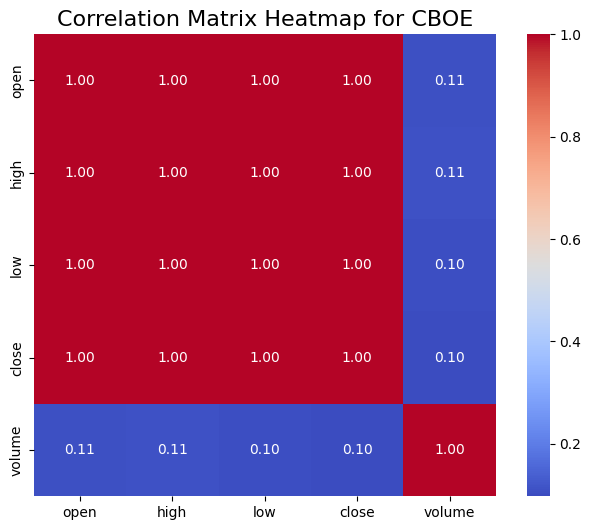

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


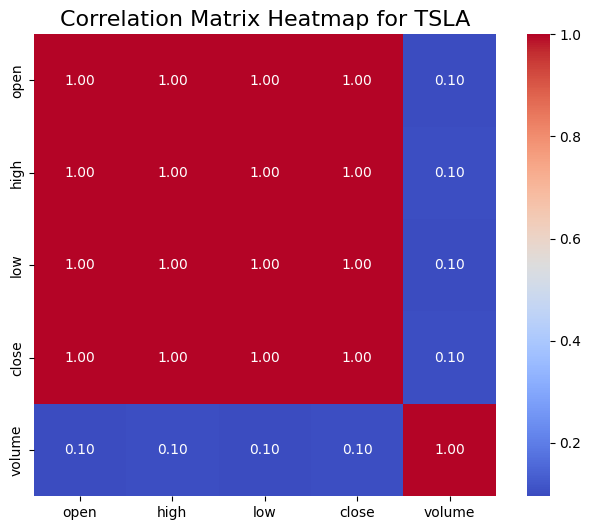

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


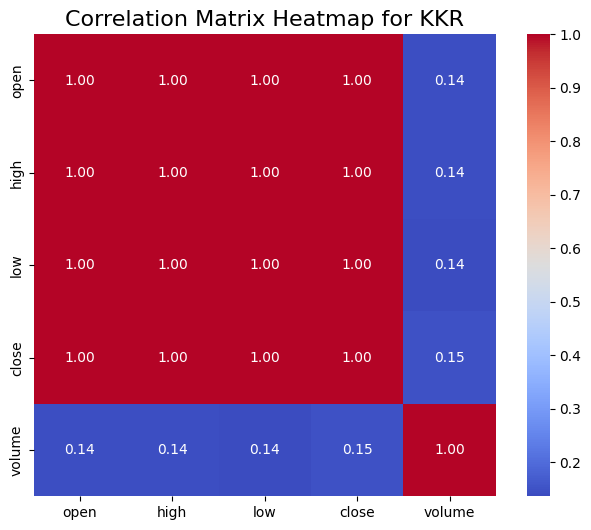

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


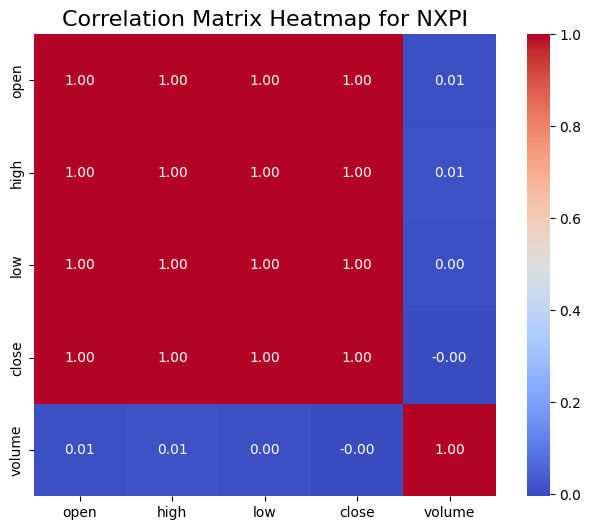

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


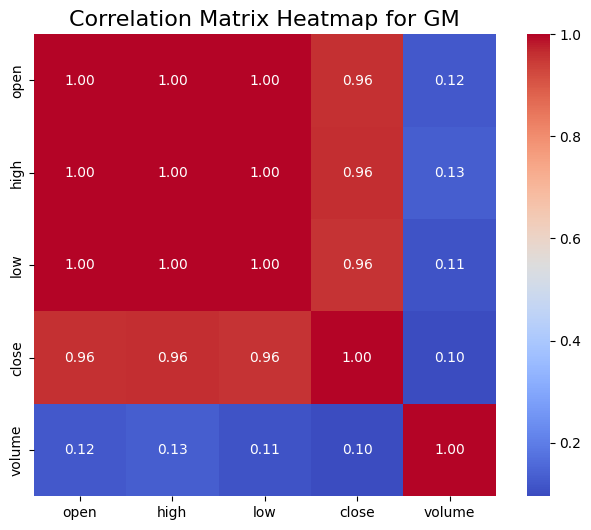

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


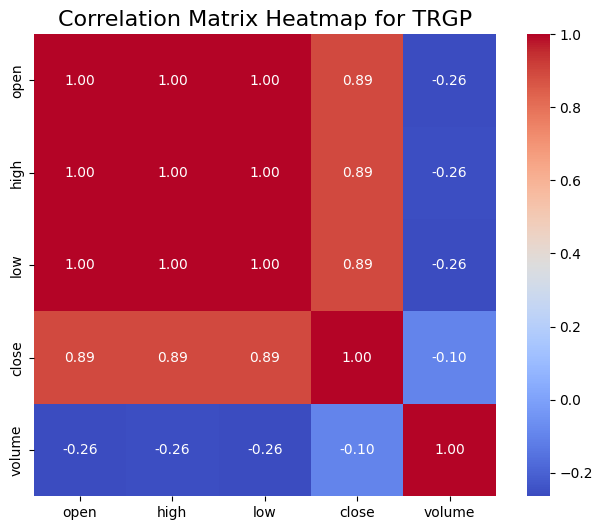

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


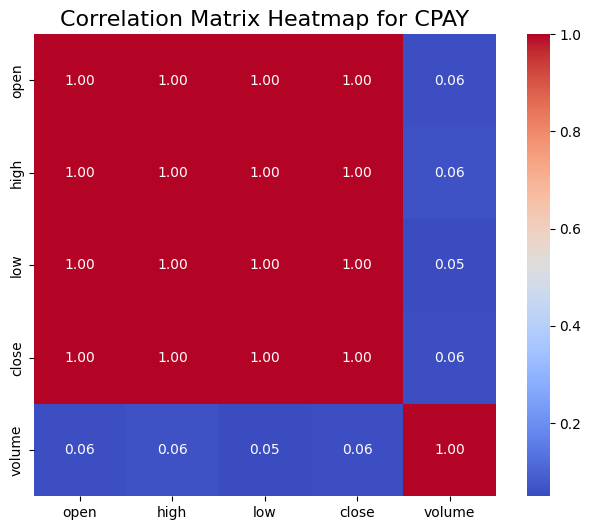

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


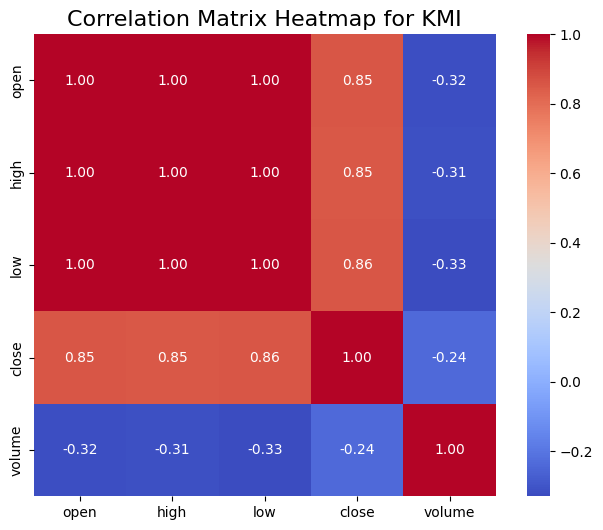

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


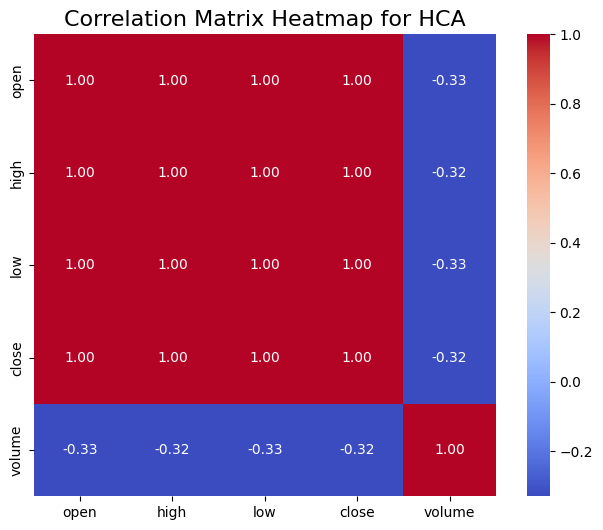

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


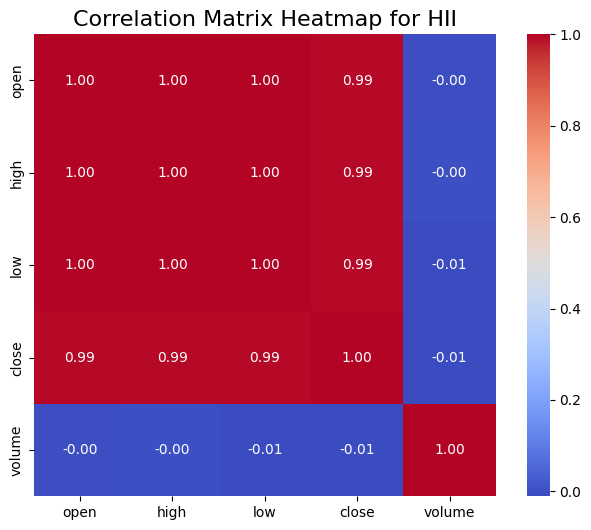

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


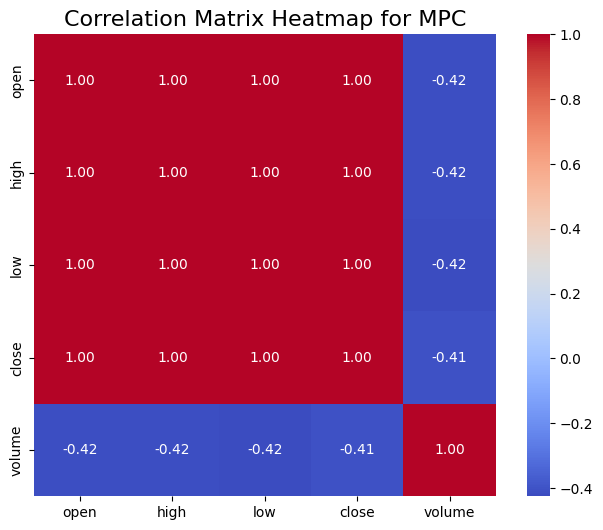

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


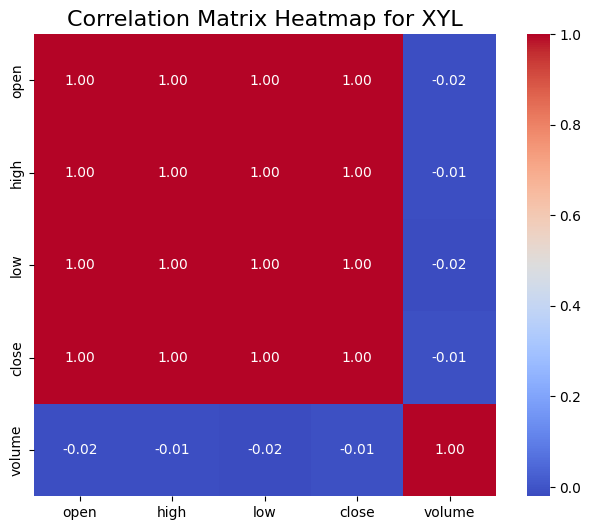

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


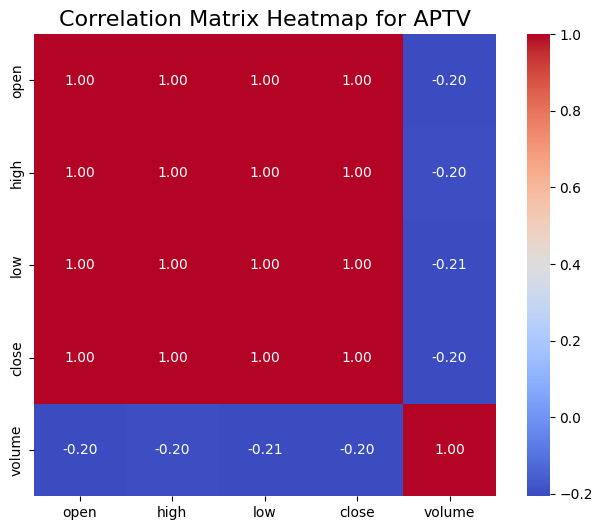

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


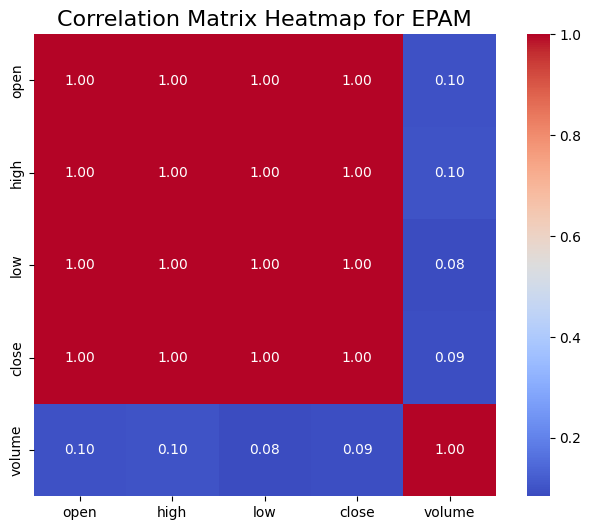

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


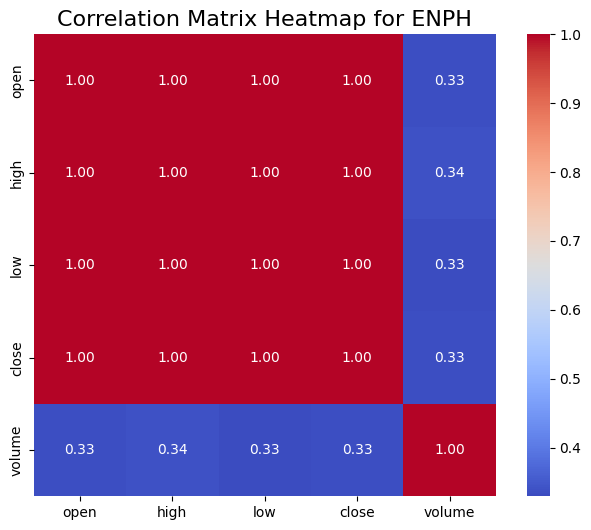

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


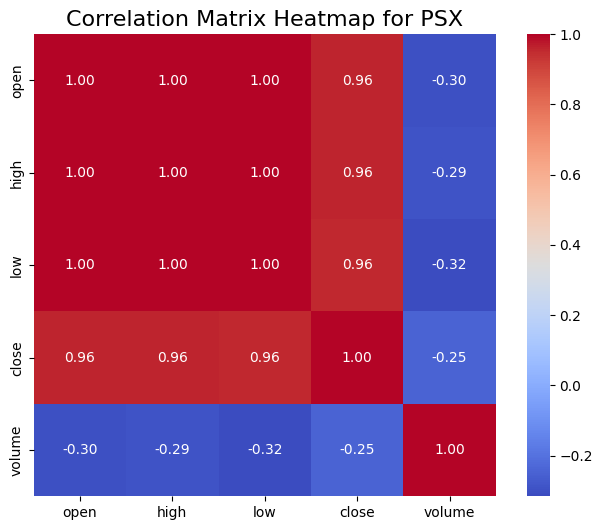

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


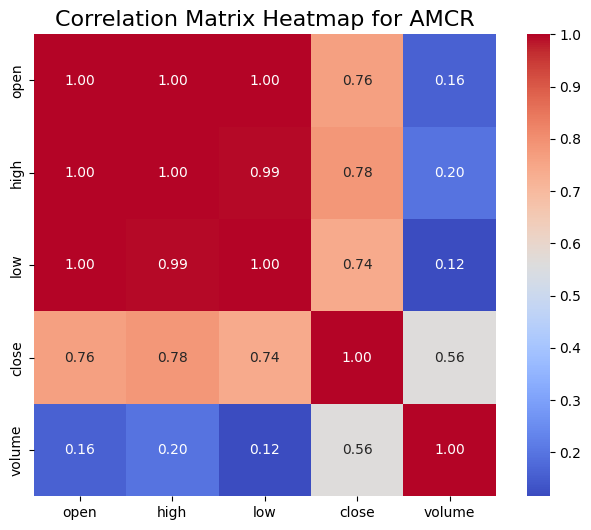

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


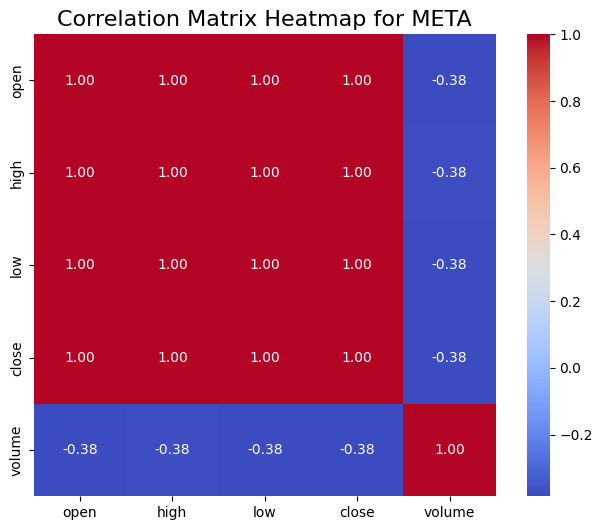

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


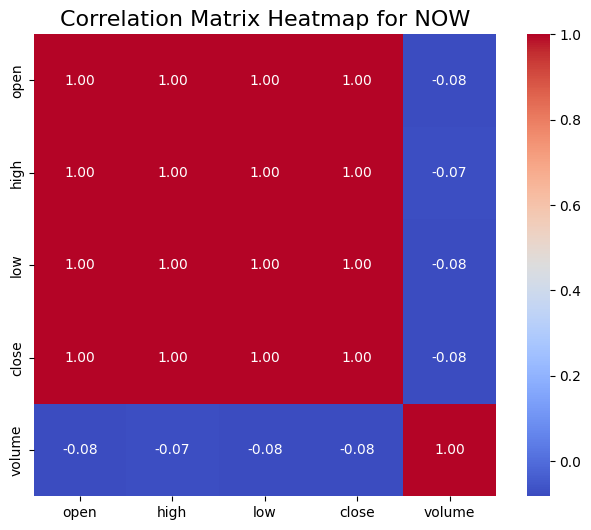

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


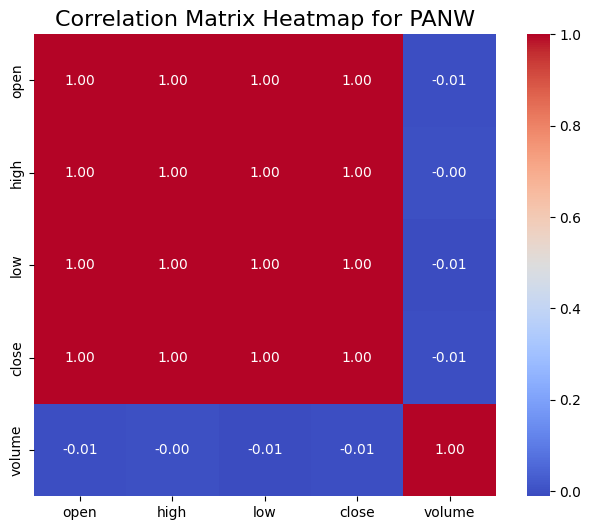

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


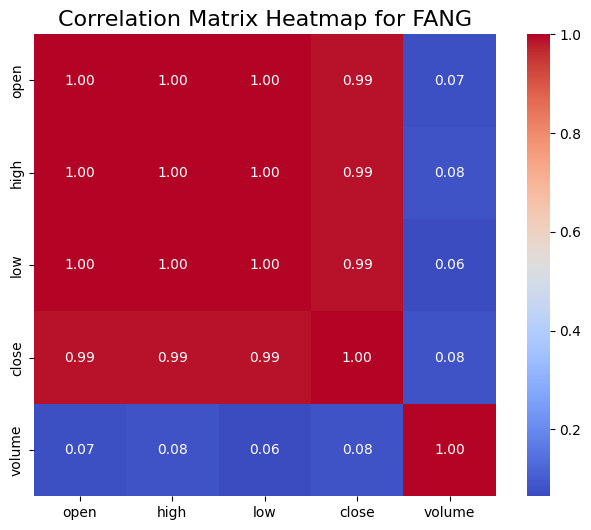

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


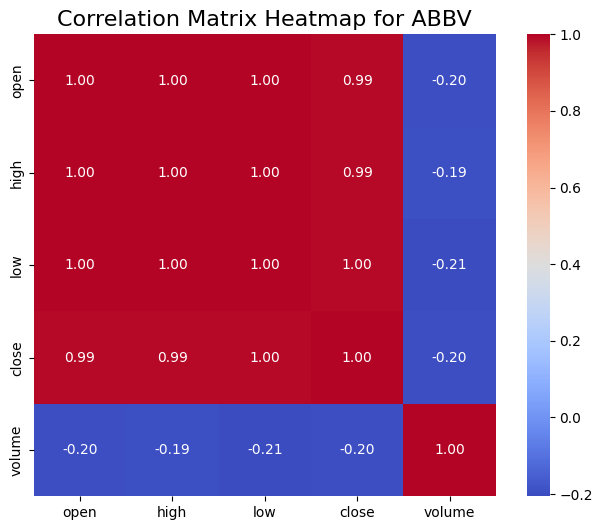

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


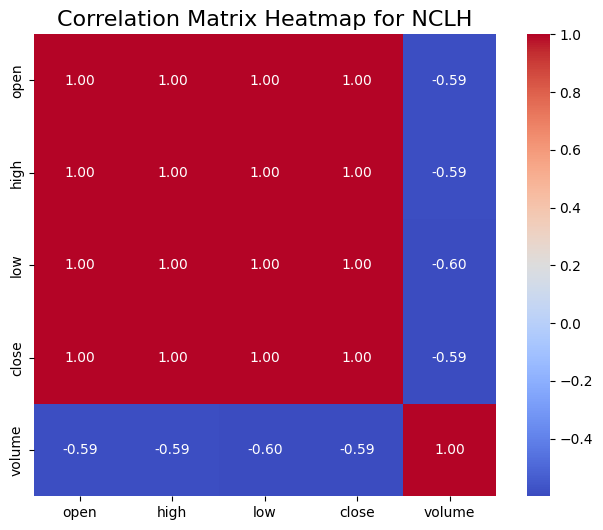

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


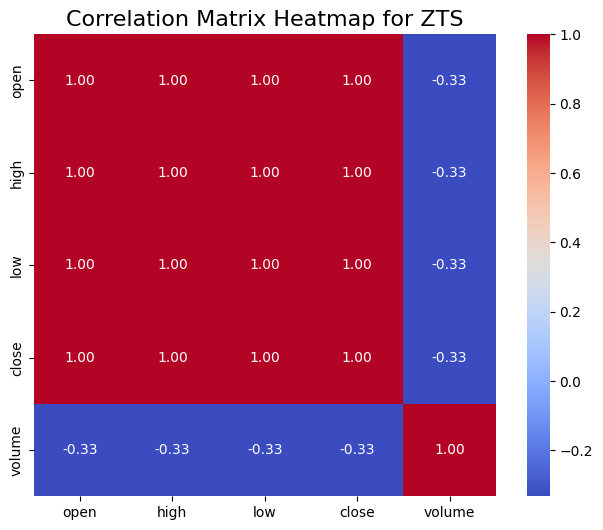

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


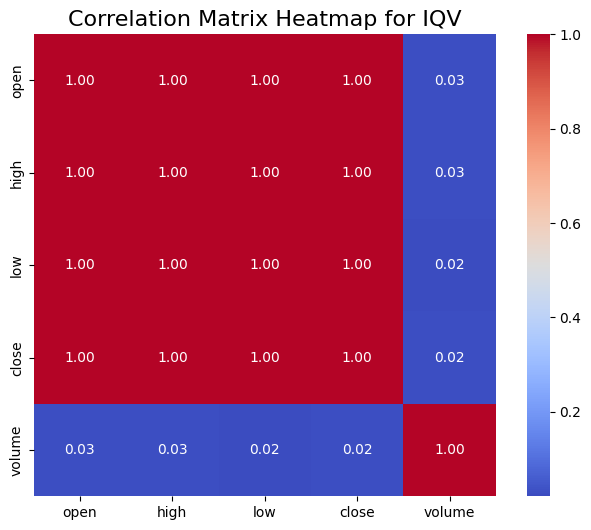

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


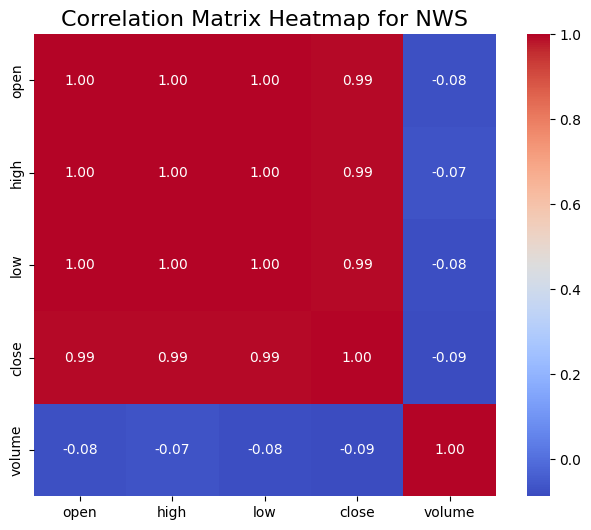

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


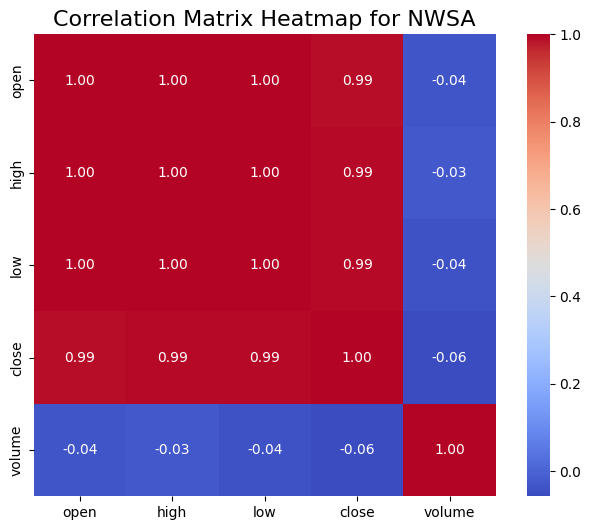

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


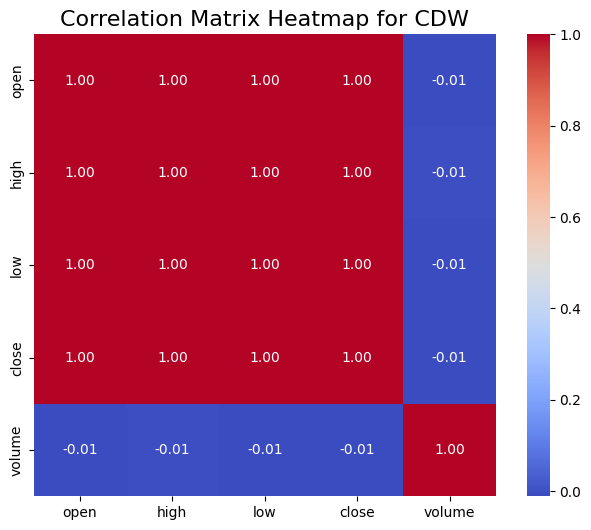

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


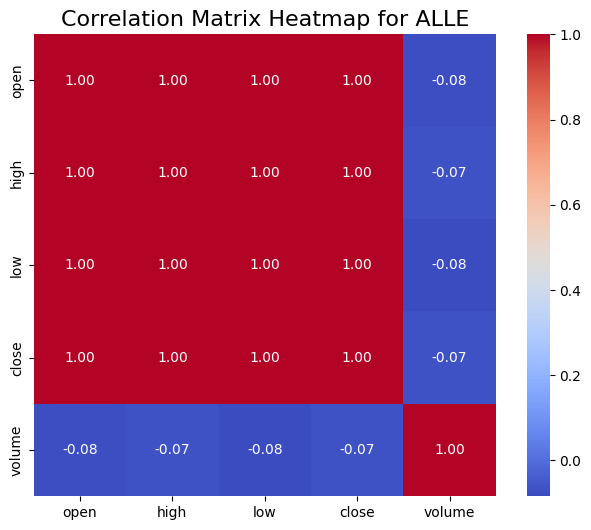

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


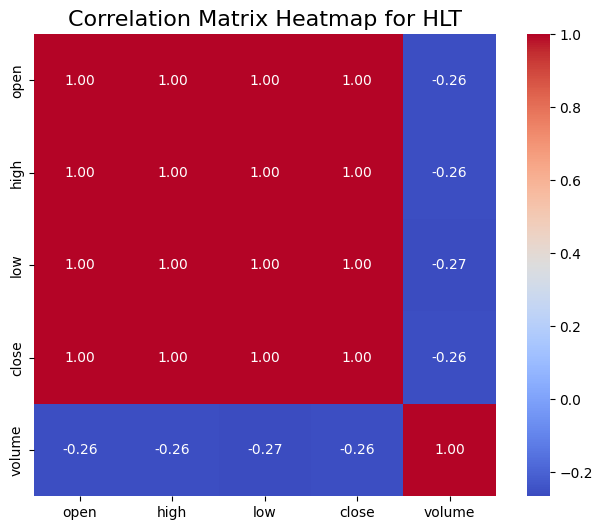

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


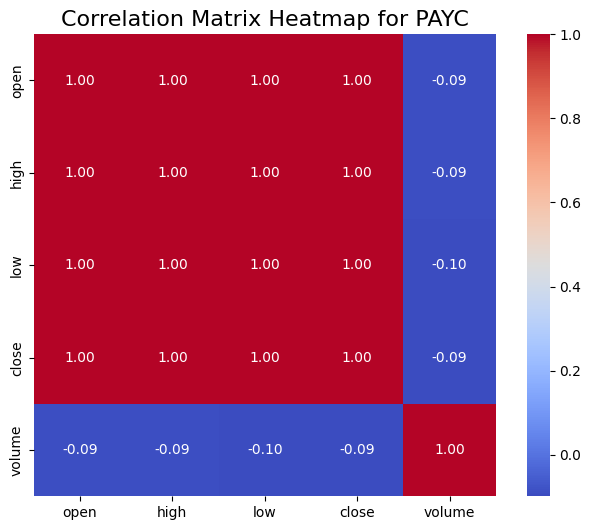

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


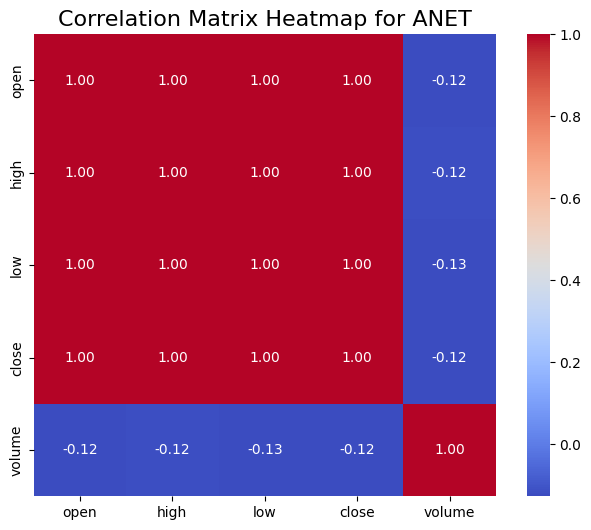

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


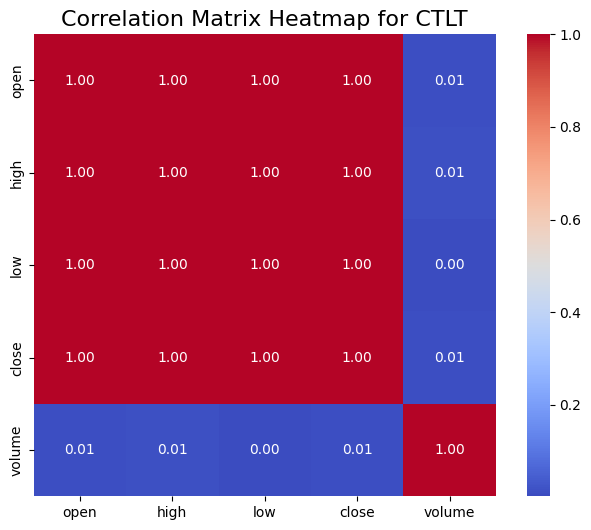

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


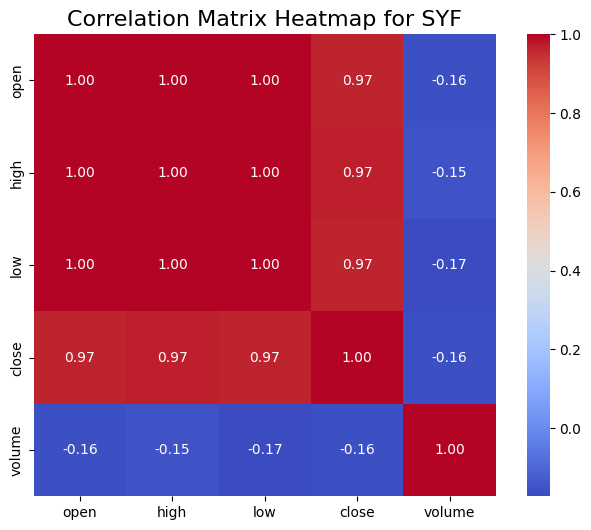

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


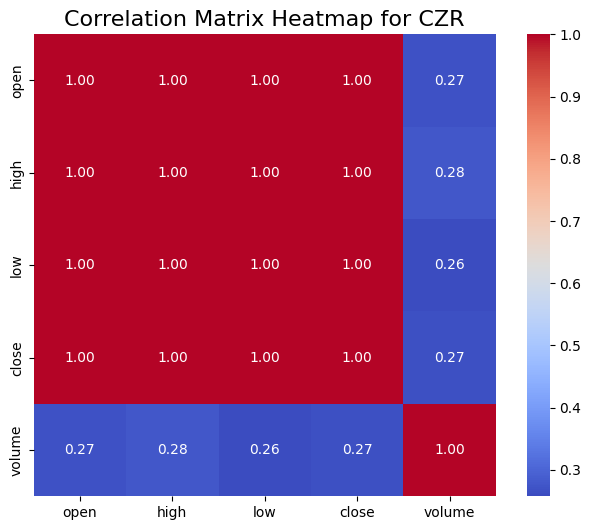

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


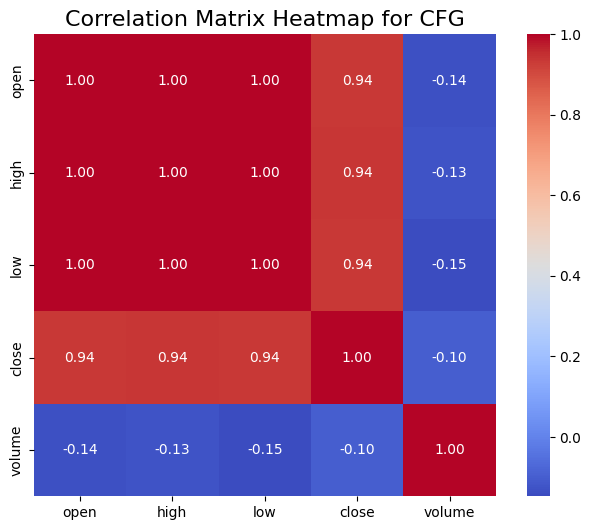

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


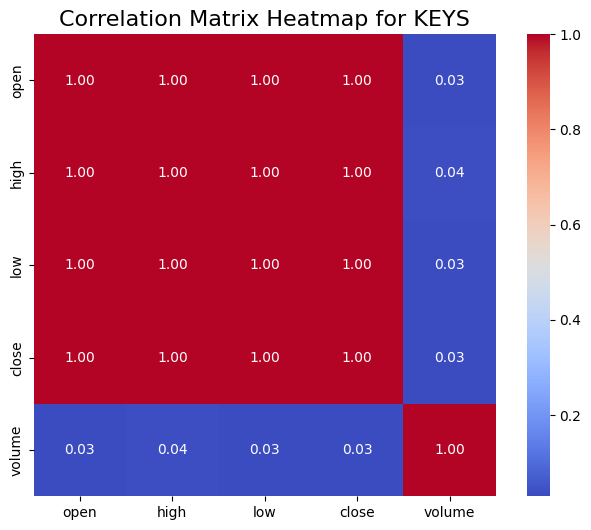

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


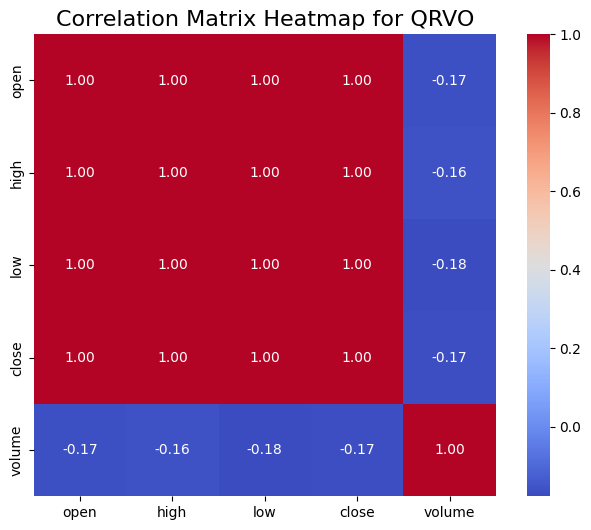

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


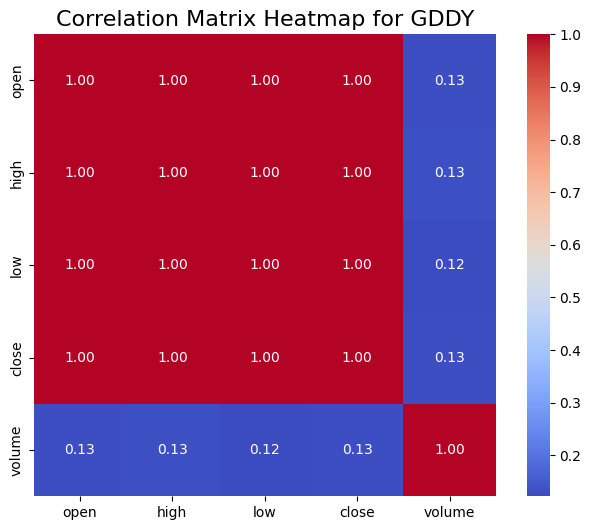

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


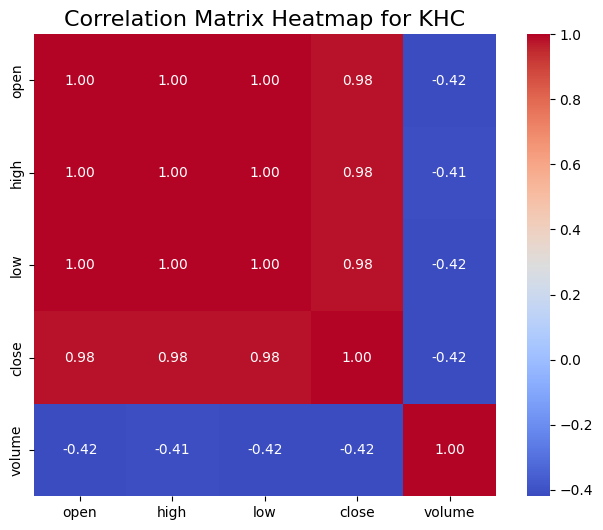

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


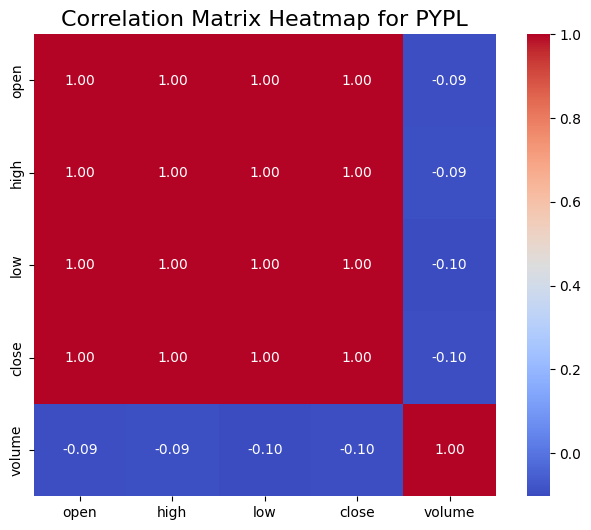

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


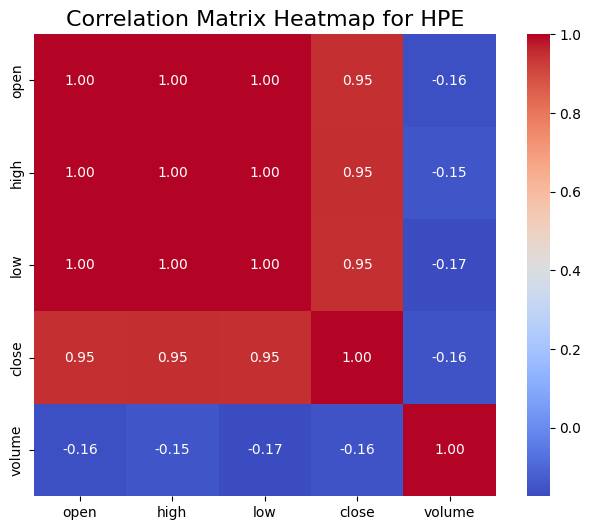

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


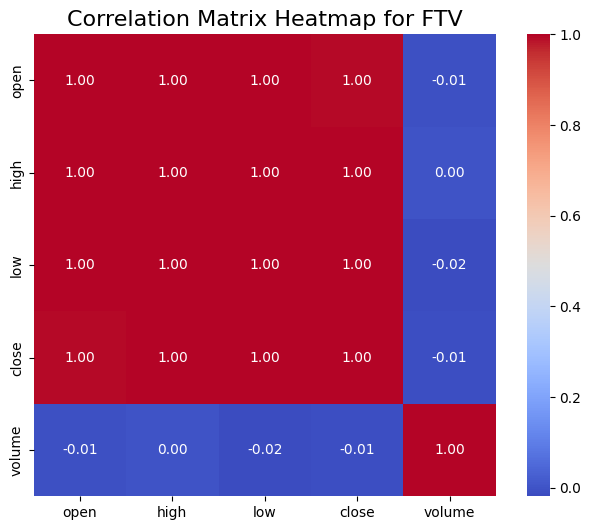

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


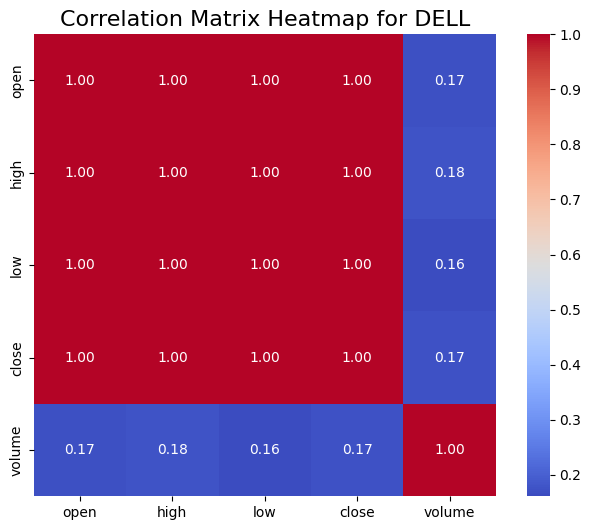

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


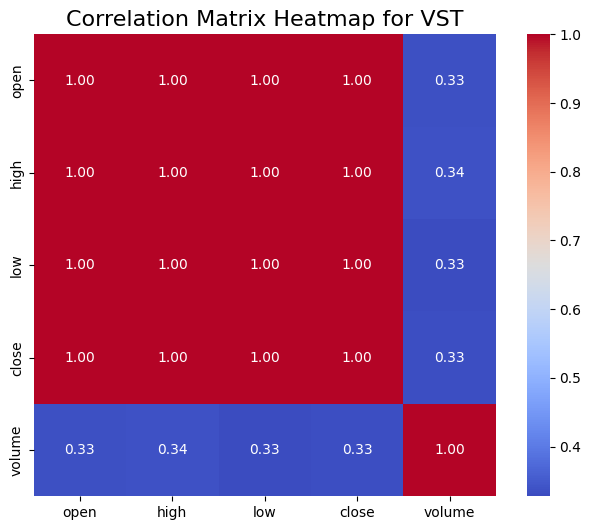

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


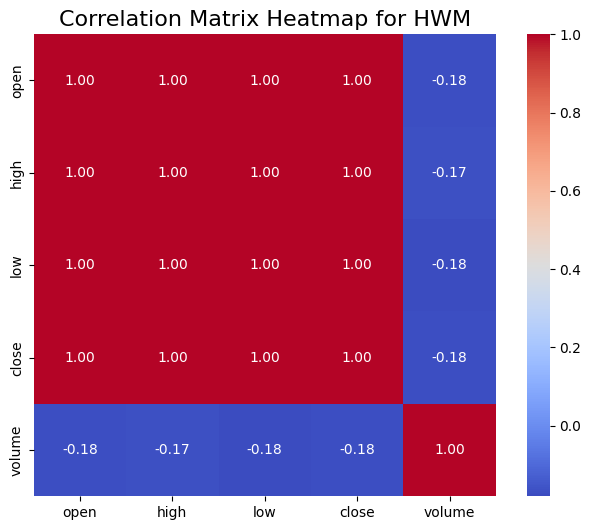

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


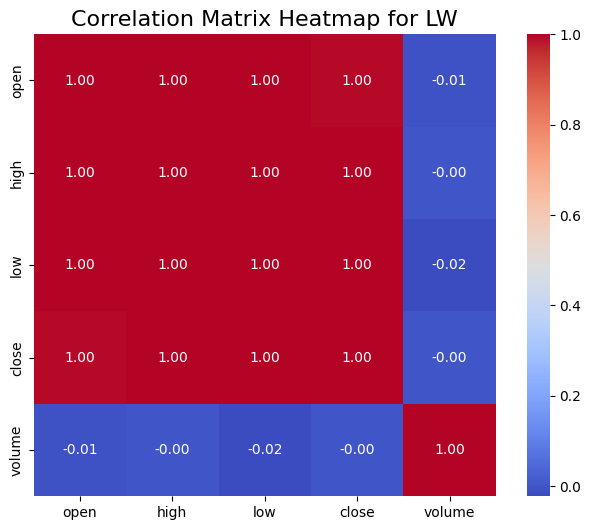

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


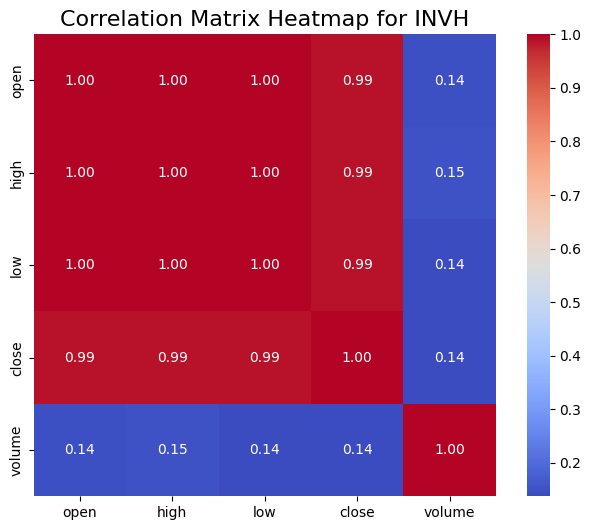

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


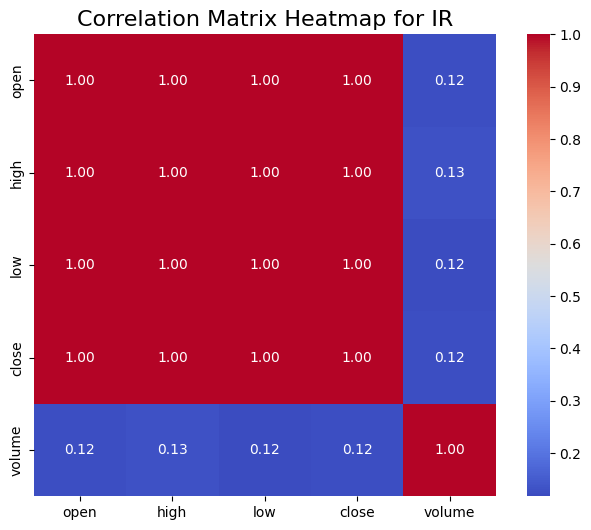

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


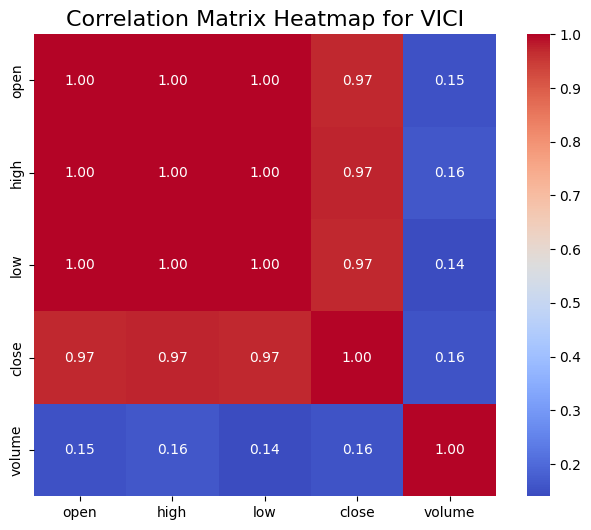

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


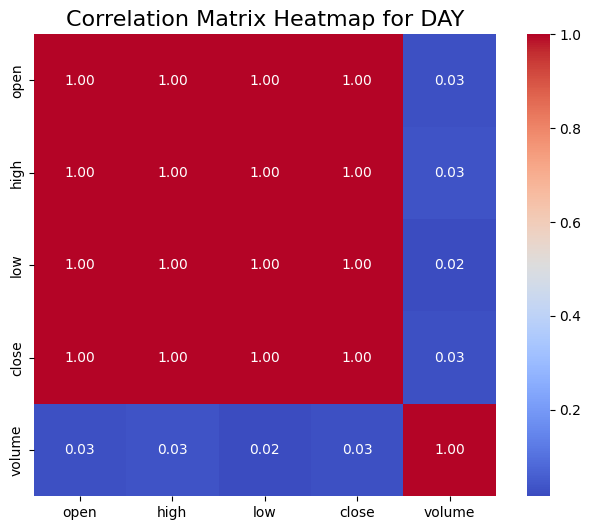

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


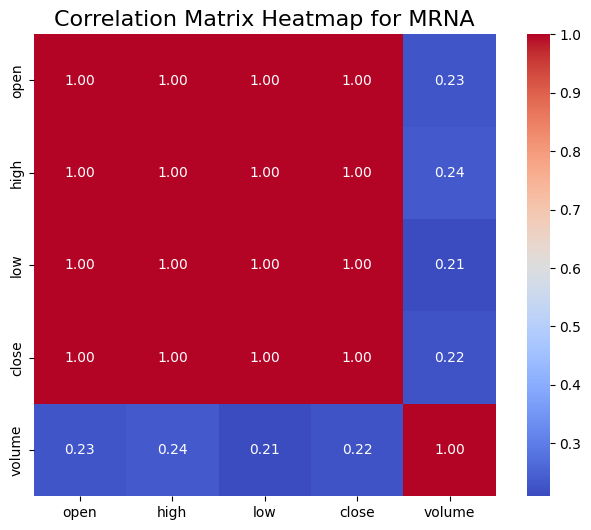

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


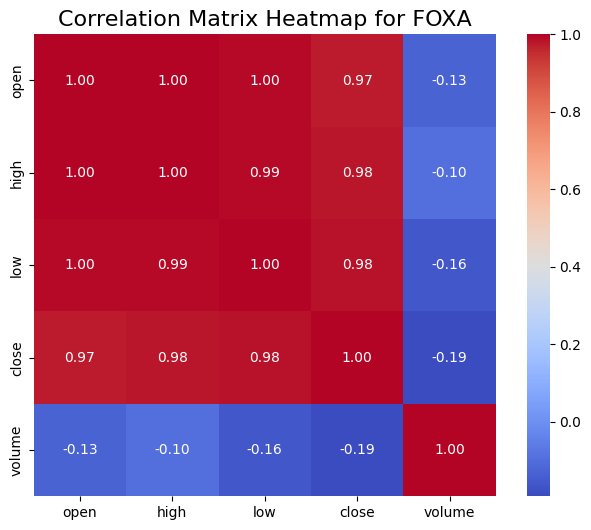

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


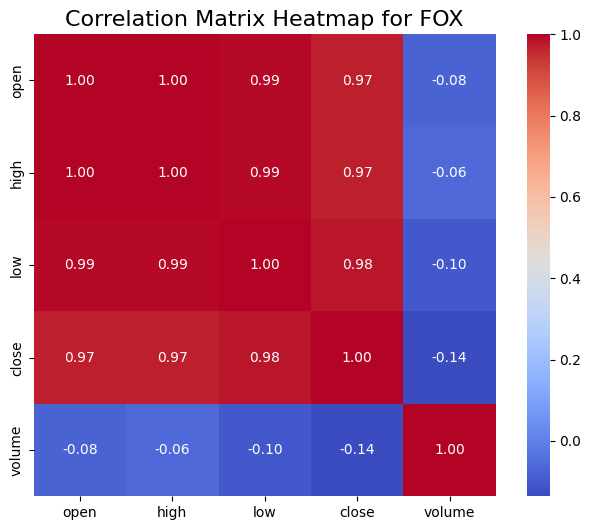

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


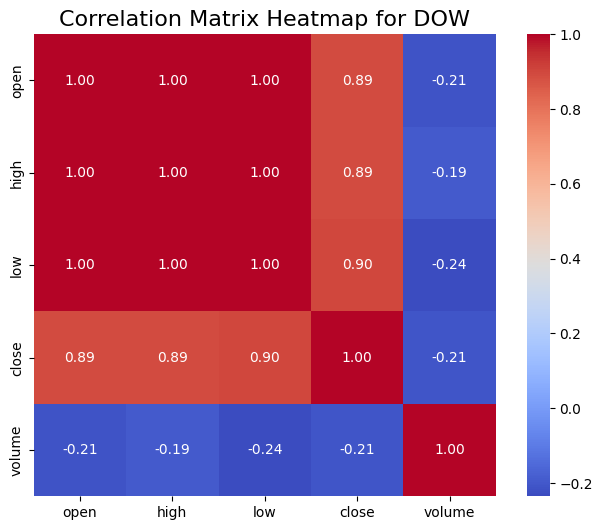

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


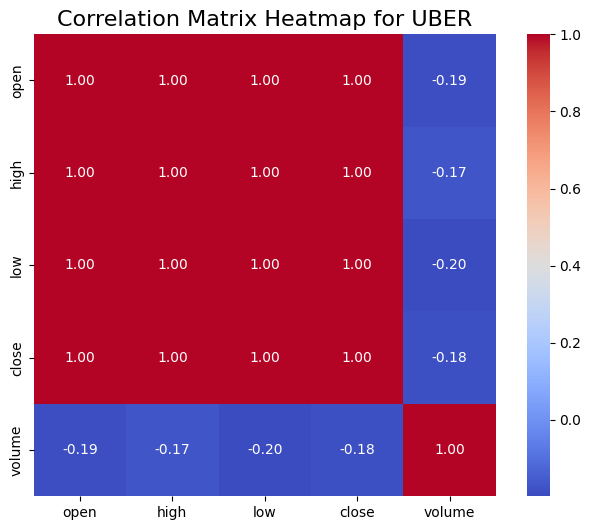

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


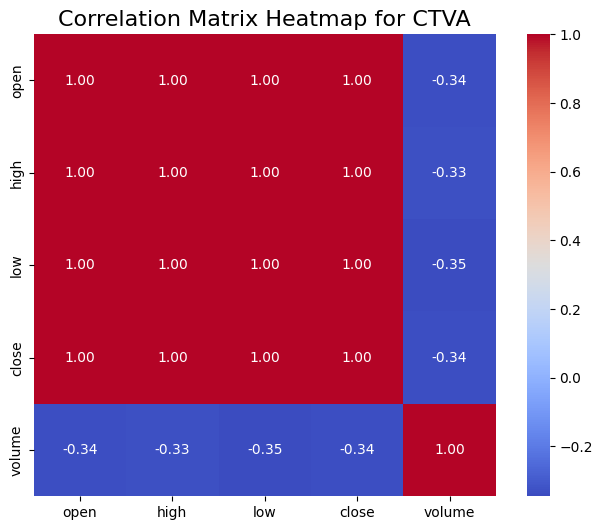

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


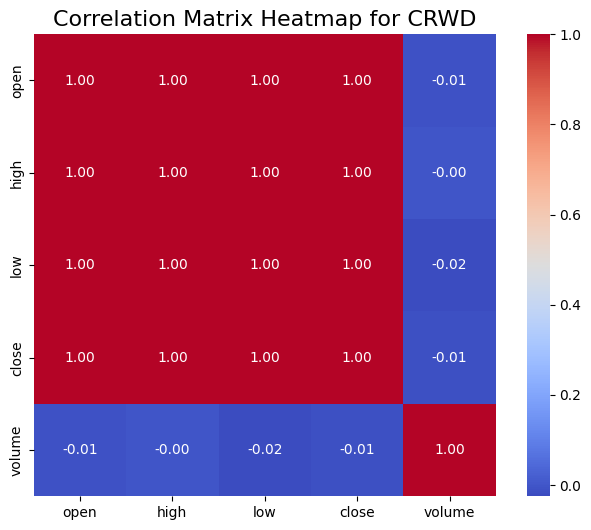

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


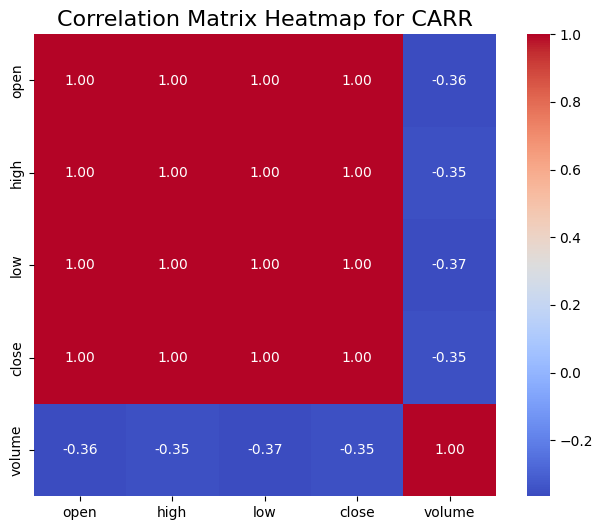

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


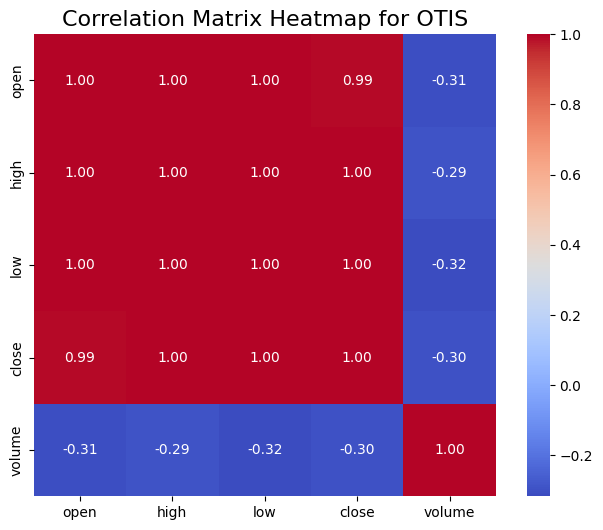

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


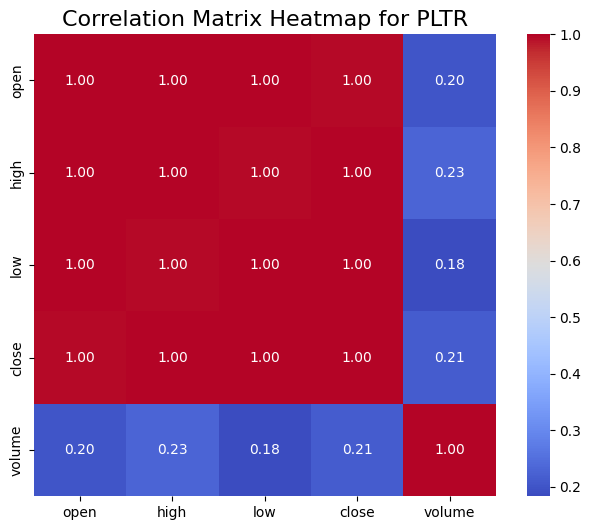

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


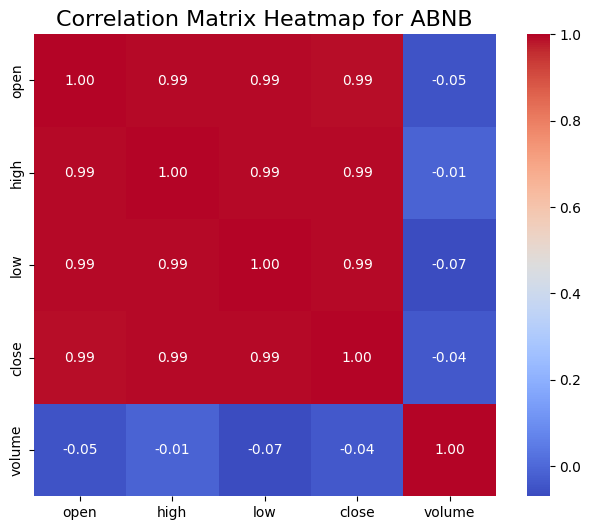

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


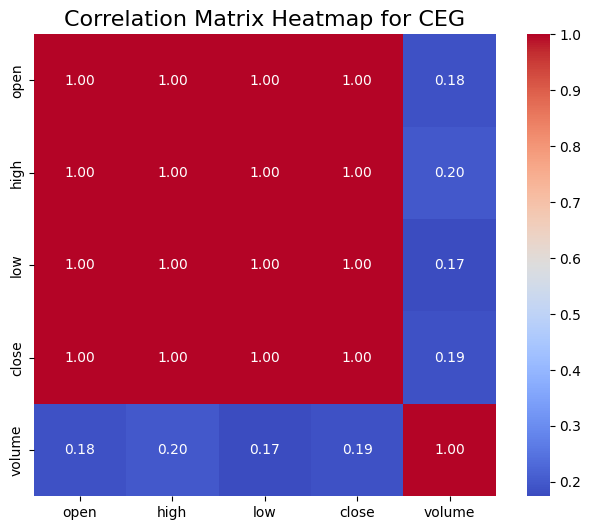

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


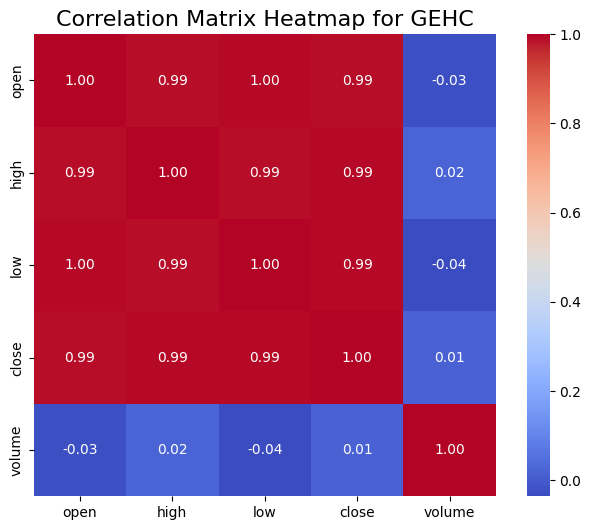

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


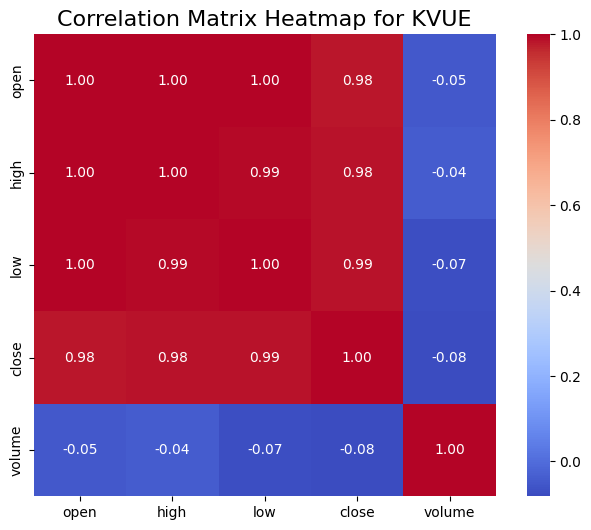

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


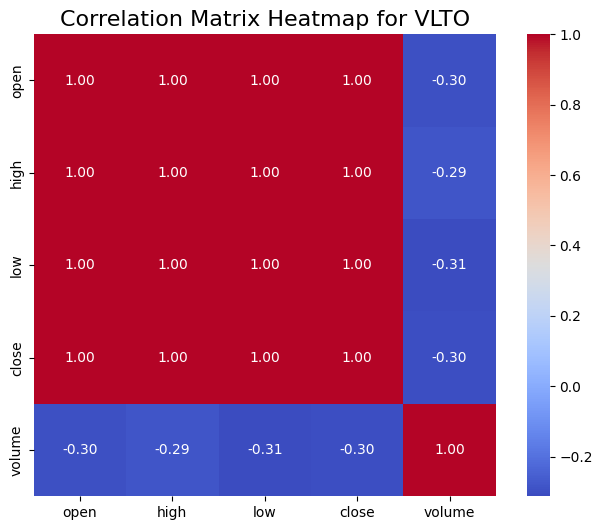

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


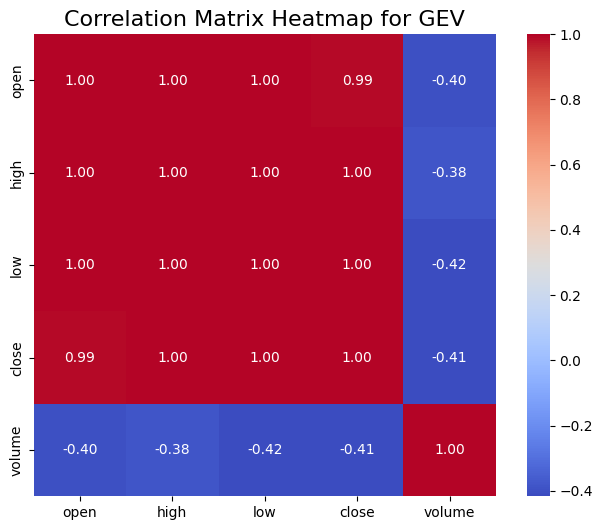

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


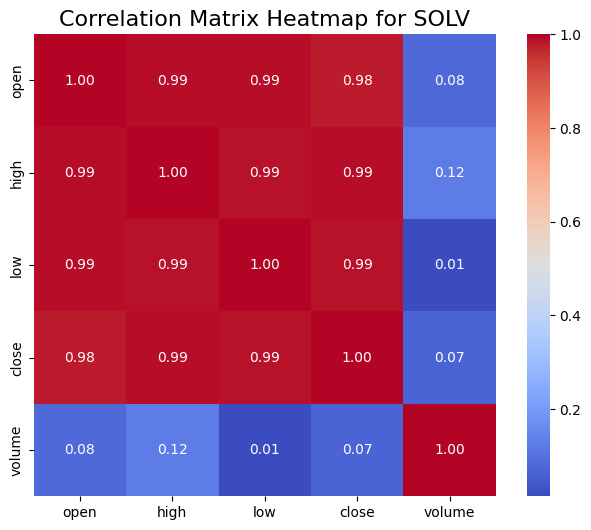

/tmp/ipykernel_17033/4277788042.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')


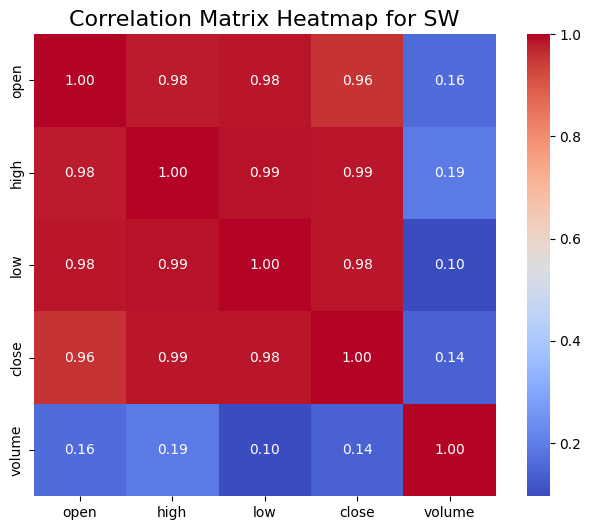

In [39]:
# Group by context_id and compute correlation matrices
for context in data['context_id'].unique():
    subset = data[data['context_id'] == context]
    
    # Convert columns to numeric for the subset
    subset[columns_to_convert] = subset[columns_to_convert].apply(pd.to_numeric, errors='coerce')
    
    # Calculate correlation matrix
    correlation_matrix = subset[columns_to_convert].corr()
    
    # Visualize the correlation matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True)
    plt.title(f'Correlation Matrix Heatmap for {context}', fontsize=16)
    plt.show()


# 6. Trading Volume Over Time

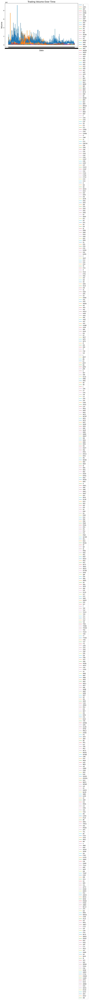

In [47]:
# Line plot for trading volume over time
plt.figure(figsize=(10, 6))

for context_id in data['context_id'].unique():
    subset = data[data['context_id'] == context_id]
    plt.plot(subset['date'], subset['volume'], label=context_id)

plt.title('Trading Volume Over Time', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Volume', fontsize=14)
#plt.legend(loc='best')
plt.legend( loc='upper left', bbox_to_anchor=(1, 1), fontsize=10)
plt.show()


# 7.  Closing prices for each stock over time

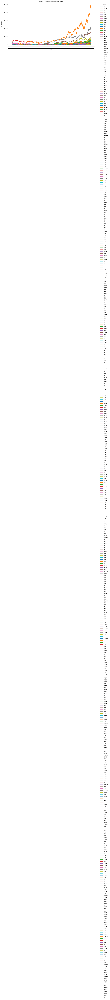

In [41]:
# Plot closing prices for each stock over time
plt.figure(figsize=(12, 6))
for ticker in data['context_id'].unique():
    subset = data[data['context_id'] == ticker]
    plt.plot(subset['date'], subset['close'], label=ticker)

plt.title('Stock Closing Prices Over Time')
plt.xlabel('Date')
plt.ylabel('Closing Price')
plt.legend(title="Stock", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


# Distributiob of the features

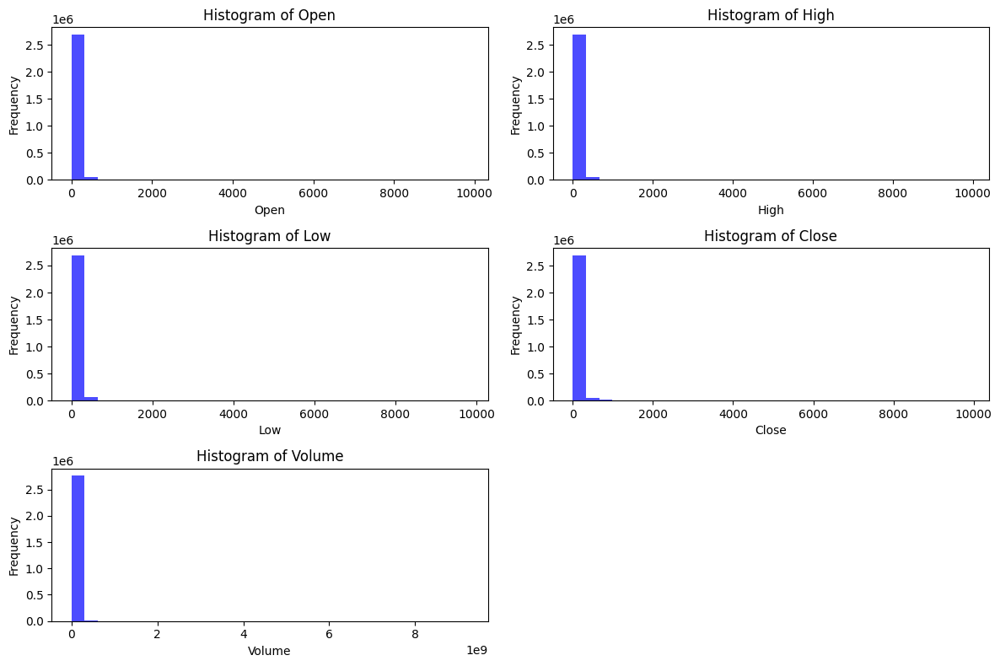

In [43]:
import matplotlib.pyplot as plt

# Set up the figure size
plt.figure(figsize=(12, 8))

# List of features to plot
features = ['open', 'high', 'low', 'close', 'volume']

# Create a histogram for each feature
for i, feature in enumerate(features):
    plt.subplot(3, 2, i + 1)  # 3 rows, 2 columns
    plt.hist(data[feature], bins=30, color='blue', alpha=0.7)
    plt.title(f'Distribution of {feature.capitalize()}')
    plt.xlabel(feature.capitalize())
    plt.ylabel('Frequency')

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()


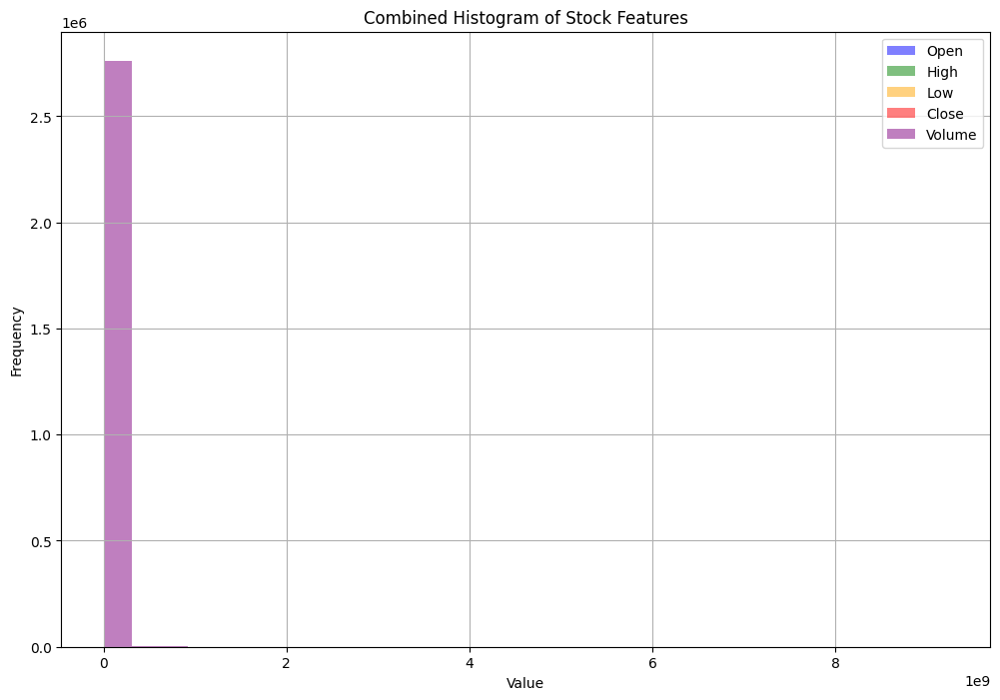

In [44]:
import matplotlib.pyplot as plt

# Set up the figure size
plt.figure(figsize=(12, 8))

# Colors for each feature
colors = ['blue', 'green', 'orange', 'red', 'purple']

# Plot each feature in the same histogram
for feature, color in zip(['open', 'high', 'low', 'close', 'volume'], colors):
    plt.hist(data[feature], bins=30, color=color, alpha=0.5, label=feature.capitalize())

# Adding titles and labels
plt.title('Distribution of Stock Features')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.legend()  # Show legend to distinguish between features
plt.grid(True)  # Add grid for better readability

# Show the plot
plt.show()


# MODEL DEVELOPMENT

In [49]:
!pip install pandas numpy matplotlib yfinance scipy


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 939.5/939.5 kB 5.2 MB/s eta 0:00:00m eta 0:00:010:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.0/101.0 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 112.2/112.2 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 6.2 MB/s eta 0:00:000:00:01m eta 0:00:01
  Created wheel for peewee: filename=peewee-3.17.7-cp312-cp312-linux_x86_64.whl size=302044 sha256=8b23e98f008df436d320876d6ea1b8187f8576866ce72e774ec2def7bc99efc4
  Stored in directory: /home/bathsheba/.cache/pip/wheels/d8/b7/b5/bc5cfc21613ff88ce55cf4151a9f32e23bd8f4a2c4d51e7c8b
Successfully built peewee


In [50]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import yfinance as yf
from scipy.optimize import minimize


In [55]:


# Load the dataset (make sure to specify the correct file path)
file_path = "/home/bathsheba/Downloads/stock_sample_data.xlsx" # Adjust this to your file location
data = pd.read_csv(file_path, sep='\t', header=None)

# Assign appropriate column names
data.columns = ['date', 'open', 'high', 'low', 'close', 'volume', 'context_id', 'day']

print(data.head())

/tmp/ipykernel_17033/2217282822.py:5: DtypeWarning: Columns (1,2,3,4,5,7) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv(file_path, sep='\t', header=None)


         date                open                high                 low  \
0        date                open                high                 low   
1  2000-01-03   56.33047103881836   56.46459197998047      48.19384765625   
2  2000-01-03  0.9363840222358704   1.004464030265808  0.9079239964485168   
3  2000-01-03  15.823756217956543  16.160432815551758  15.599306106567383   
4  2000-01-03  1.4097219705581665  1.4166669845581055   1.263888955116272   

                close     volume  context_id  day  
0               close     volume  context_id  day  
1  43.463035583496094    4674353           A    0  
2  0.8440040349960327  535796800        AAPL    0  
3    8.32724380493164   10635087         ABT    0  
4  1.2777780294418335     433800        ACGL    0  


In [56]:
# Get unique ticker symbols from the context_id column
tickers = data['context_id'].unique().tolist()

# Display the ticker symbols
print(tickers)


['context_id', 'A', 'AAPL', 'ABT', 'ACGL', 'ADBE', 'ADI', 'ADM', 'ADP', 'ADSK', 'AEE', 'AEP', 'AES', 'AFL', 'AIG', 'AJG', 'AKAM', 'ALB', 'ALL', 'AMAT', 'AMD', 'AME', 'AMGN', 'AMT', 'AMZN', 'ANSS', 'AON', 'AOS', 'APA', 'APD', 'APH', 'ARE', 'ATO', 'AVB', 'AVY', 'AXP', 'AZO', 'BA', 'BAC', 'BALL', 'BAX', 'BBWI', 'BBY', 'BDX', 'BEN', 'BF-B', 'BIIB', 'BK', 'BKNG', 'BKR', 'BLK', 'BMY', 'BRK-B', 'BRO', 'BSX', 'BWA', 'BXP', 'C', 'CAG', 'CAH', 'CAT', 'CB', 'CCI', 'CCL', 'CDNS', 'CHD', 'CHRW', 'CI', 'CINF', 'CL', 'CLX', 'CMCSA', 'CMI', 'CMS', 'CNP', 'COF', 'COO', 'COP', 'COR', 'COST', 'CPB', 'CPRT', 'CPT', 'CSCO', 'CSGP', 'CSX', 'CTAS', 'CTRA', 'CTSH', 'CVS', 'CVX', 'D', 'DD', 'DE', 'DECK', 'DGX', 'DHI', 'DHR', 'DIS', 'DLTR', 'DOC', 'DOV', 'DRI', 'DTE', 'DUK', 'DVA', 'DVN', 'EA', 'EBAY', 'ECL', 'ED', 'EFX', 'EG', 'EIX', 'EL', 'EMN', 'EMR', 'EOG', 'EQR', 'EQT', 'ERIE', 'ES', 'ESS', 'ETN', 'ETR', 'EVRG', 'EXC', 'EXPD', 'F', 'FAST', 'FCX', 'FDS', 'FDX', 'FE', 'FFIV', 'FI', 'FICO', 'FITB', 'FMC', 'FR

In [86]:
import pandas as pd

# Load the dataset (make sure to specify the correct file path)
file_path = "/home/bathsheba/Downloads/stock_sample_data.xlsx"  # Adjust this to your file location
data = pd.read_csv(file_path, sep='\t')  # Use the appropriate separator

# Assign column names
data.columns = ['date', 'open', 'high', 'low', 'close', 'volume', 'context_id', 'day']

# Convert relevant columns to numeric, handling non-numeric values
data['open'] = pd.to_numeric(data['open'], errors='coerce')
data['high'] = pd.to_numeric(data['high'], errors='coerce')
data['low'] = pd.to_numeric(data['low'], errors='coerce')
data['close'] = pd.to_numeric(data['close'], errors='coerce')
data['volume'] = pd.to_numeric(data['volume'], errors='coerce')

# Display all rows of the dataset
print("All rows of the dataset:")
display(data)  # Display the entire DataFrame

# Get basic information about the dataset
print("\nBasic information about the dataset:")
df_info = data.info()  # Get information about the DataFrame
display(pd.DataFrame(df_info))  # Convert info to DataFrame and display

# Check for missing values
print("\nMissing values in the dataset:")
df_missing = data.isnull().sum()  # Check for missing values
display(pd.DataFrame(df_missing, columns=['Missing Values']))

All rows of the dataset:


,date,open,high,low,close,volume,context_id,day
0,2000-01-03,56.330471,56.464592,48.193848,43.463036,4674353,A,0
1,2000-01-03,0.936384,1.004464,0.907924,0.844004,535796800,AAPL,0
2,2000-01-03,15.823756,16.160433,15.599306,8.327244,10635087,ABT,0
3,2000-01-03,1.409722,1.416667,1.263889,1.277778,433800,ACGL,0
4,2000-01-03,16.812500,16.875000,16.062500,16.274672,7384400,ADBE,0
...,...,...,...,...,...,...,...,...
2770135,2024-10-15,137.630005,138.469894,137.210007,137.785004,347338,XYL,1
2770136,2024-10-15,134.210007,134.669998,132.723999,133.779999,513843,YUM,1
2770137,2024-10-15,103.510002,105.970001,103.785004,105.294998,436167,ZBH,1
2770138,2024-10-15,376.739990,380.034393,374.040009,374.859985,143956,ZBRA,1



Basic information about the dataset:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2770140 entries, 0 to 2770139
Data columns (total 8 columns):
 #   Column      Dtype  
---  ------      -----  
 0   date        object 
 1   open        float64
 2   high        float64
 3   low         float64
 4   close       float64
 5   volume      int64  
 6   context_id  object 
 7   day         int64  
dtypes: float64(4), int64(2), object(2)
memory usage: 169.1+ MB


""



Missing values in the dataset:


,Missing Values
date,0
open,0
high,0
low,0
close,0
volume,0
context_id,0
day,0


In [70]:
# Get unique ticker symbols from the context_id column
tickers = data['context_id'].unique().tolist()

# Define the start and end dates
start_date = '2000-01-03'
end_date = '2010-06-25'

# Fetch the adjusted close prices for the tickers
stock_data = yf.download(tickers, start=start_date, end=end_date)['Adj Close']

# Print the fetched data
print(stock_data)

[*********************100%***********************]  503 of 503 completed

68 Failed downloads:
['TRGP', 'PSX', 'CRWD', 'AMCR', 'CEG', 'PANW', 'ALLE', 'LW', 'NWS', 'SOLV', 'GDDY', 'SW', 'TSLA', 'UBER', 'PLTR', 'CZR', 'GEHC', 'NOW', 'GEV', 'MRNA', 'ABBV', 'HII', 'META', 'OTIS', 'NCLH', 'KVUE', 'PAYC', 'KMI', 'FANG', 'MPC', 'NXPI', 'EPAM', 'KKR', 'IQV', 'VST', 'HCA', 'DOW', 'CFG', 'ENPH', 'HWM', 'DELL', 'INVH', 'ANET', 'CTVA', 'NWSA', 'DAY', 'ZTS', 'CDW', 'PYPL', 'APTV', 'SYF', 'CTLT', 'CPAY', 'VLTO', 'CARR', 'FTV', 'IR', 'ABNB', 'HLT', 'FOX', 'VICI', 'KHC', 'XYL', 'KEYS', 'QRVO', 'HPE', 'GM', 'FOXA']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2000-01-03 -> 2010-06-25) (Yahoo error = "Data doesn\'t exist for startDate = 946875600, endDate = 1277438400")')


Ticker                             A      AAPL  ABBV  ABNB        ABT  \
Date                                                                    
2000-01-03 00:00:00+00:00  44.290768  0.844004   NaN   NaN   8.288182   
2000-01-04 00:00:00+00:00  40.907444  0.772846   NaN   NaN   8.051378   
2000-01-05 00:00:00+00:00  38.369949  0.784155   NaN   NaN   8.036572   
2000-01-06 00:00:00+00:00  36.908974  0.716296   NaN   NaN   8.317785   
2000-01-07 00:00:00+00:00  39.984726  0.750226   NaN   NaN   8.406587   
...                              ...       ...   ...   ...        ...   
2010-06-18 00:00:00+00:00  21.290197  8.265904   NaN   NaN  17.068583   
2010-06-21 00:00:00+00:00  21.172678  8.148282   NaN   NaN  16.904097   
2010-06-22 00:00:00+00:00  20.904997  8.259269   NaN   NaN  16.795591   
2010-06-23 00:00:00+00:00  20.872358  8.172410   NaN   NaN  16.645107   
2010-06-24 00:00:00+00:00  20.082376  8.112996   NaN   NaN  16.610106   

Ticker                         ACGL        ACN    

# 68 remaining tickers that failed

In [87]:
import yfinance as yf
import pandas as pd

# Remaining list of tickers
original_tickers = [
    'TRGP', 'PSX', 'CRWD', 'AMCR', 'CEG', 'PANW', 'ALLE', 'LW', 'NWS', 'SOLV', 
    'GDDY', 'SW', 'TSLA', 'UBER', 'PLTR', 'CZR', 'GEHC', 'NOW', 'GEV', 'MRNA', 
    'ABBV', 'HII', 'META', 'OTIS', 'NCLH', 'KVUE', 'PAYC', 'KMI', 'FANG', 'MPC', 
    'NXPI', 'EPAM', 'KKR', 'IQV', 'VST', 'HCA', 'DOW', 'CFG', 'ENPH', 'HWM', 
    'DELL', 'INVH', 'ANET', 'CTVA', 'NWSA', 'DAY', 'ZTS', 'CDW', 'PYPL', 
    'APTV', 'SYF', 'CTLT', 'CPAY', 'VLTO', 'CARR', 'FTV', 'IR', 'ABNB', 
    'HLT', 'FOX', 'VICI', 'KHC', 'XYL', 'KEYS', 'QRVO', 'HPE', 'GM', 'FOXA'
]

# Define the start and end dates
start_date = '2000-01-03'
end_date = '2010-06-25'

# Fetch data, handling potential failures
data = yf.download(original_tickers, start=start_date, end=end_date)

# Identify failed downloads
failed_tickers = data.columns[data.isna().all()].tolist()

# Filter out failed tickers
successful_tickers = [ticker for ticker in original_tickers if ticker not in failed_tickers]

# Fetch data again without failed tickers
if successful_tickers:  # Check if there are any tickers left to download
    print("Fetching data for successful tickers...")
    data = yf.download(successful_tickers, start=start_date, end=end_date)
else:
    print("No valid tickers available for download.")

# Display the data
print(data)


[*********************100%***********************]  68 of 68 completed

68 Failed downloads:
['HCA', 'KEYS', 'KMI', 'HII', 'GEV', 'AMCR', 'TRGP', 'IQV', 'NWSA', 'NWS', 'QRVO', 'FOXA', 'KHC', 'PSX', 'APTV', 'GDDY', 'MRNA', 'FANG', 'ABNB', 'LW', 'XYL', 'UBER', 'CDW', 'DOW', 'CRWD', 'ENPH', 'CPAY', 'HWM', 'HPE', 'HLT', 'CFG', 'DELL', 'NCLH', 'ZTS', 'GM', 'META', 'SYF', 'SOLV', 'INVH', 'CEG', 'OTIS', 'CZR', 'SW', 'CTLT', 'VLTO', 'KVUE', 'PLTR', 'CTVA', 'FOX', 'VICI', 'MPC', 'PYPL', 'PANW', 'IR', 'DAY', 'EPAM', 'GEHC', 'VST', 'ANET', 'NXPI', 'PAYC', 'FTV', 'ALLE', 'NOW', 'KKR', 'CARR', 'ABBV', 'TSLA']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2000-01-03 -> 2010-06-25) (Yahoo error = "Data doesn\'t exist for startDate = 946875600, endDate = 1277438400")')
[**********************82%**************         ]  56 of 68 completed

Fetching data for successful tickers...


[*********************100%***********************]  68 of 68 completed

68 Failed downloads:
['KKR', 'ALLE', 'CARR', 'ABBV', 'NOW', 'FTV', 'TSLA', 'XYL', 'IQV', 'TRGP', 'ENPH', 'HLT', 'CFG', 'IR', 'ZTS', 'DAY', 'PSX', 'MPC', 'GDDY', 'VST', 'MRNA', 'ABNB', 'LW', 'SOLV', 'UBER', 'CDW', 'DOW', 'HPE', 'CPAY', 'CRWD', 'GEV', 'HWM', 'NWSA', 'DELL', 'QRVO', 'GM', 'AMCR', 'META', 'SYF', 'NCLH', 'INVH', 'CEG', 'OTIS', 'CZR', 'SW', 'CTLT', 'VLTO', 'KVUE', 'PLTR', 'CTVA', 'FOX', 'NWS', 'VICI', 'APTV', 'PYPL', 'PANW', 'FOXA', 'KHC', 'EPAM', 'GEHC', 'FANG', 'NXPI', 'PAYC', 'ANET', 'HCA', 'KEYS', 'HII', 'KMI']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2000-01-03 -> 2010-06-25) (Yahoo error = "Data doesn\'t exist for startDate = 946875600, endDate = 1277438400")')


Empty DataFrame
Columns: [(Adj Close, ABBV), (Adj Close, ABNB), (Adj Close, ALLE), (Adj Close, AMCR), (Adj Close, ANET), (Adj Close, APTV), (Adj Close, CARR), (Adj Close, CDW), (Adj Close, CEG), (Adj Close, CFG), (Adj Close, CPAY), (Adj Close, CRWD), (Adj Close, CTLT), (Adj Close, CTVA), (Adj Close, CZR), (Adj Close, DAY), (Adj Close, DELL), (Adj Close, DOW), (Adj Close, ENPH), (Adj Close, EPAM), (Adj Close, FANG), (Adj Close, FOX), (Adj Close, FOXA), (Adj Close, FTV), (Adj Close, GDDY), (Adj Close, GEHC), (Adj Close, GEV), (Adj Close, GM), (Adj Close, HCA), (Adj Close, HII), (Adj Close, HLT), (Adj Close, HPE), (Adj Close, HWM), (Adj Close, INVH), (Adj Close, IQV), (Adj Close, IR), (Adj Close, KEYS), (Adj Close, KHC), (Adj Close, KKR), (Adj Close, KMI), (Adj Close, KVUE), (Adj Close, LW), (Adj Close, META), (Adj Close, MPC), (Adj Close, MRNA), (Adj Close, NCLH), (Adj Close, NOW), (Adj Close, NWS), (Adj Close, NWSA), (Adj Close, NXPI), (Adj Close, OTIS), (Adj Close, PANW), (Adj Close, P

# Calculation of Returns

In [88]:
# Calculate daily returns
returns = data.pct_change().dropna()

# Calculate covariance matrix
cov_matrix = returns.cov()


/home/bathsheba/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:520: RuntimeWarning: Mean of empty slice.
  avg = a.mean(axis, **keepdims_kw)
/home/bathsheba/anaconda3/lib/python3.12/site-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/home/bathsheba/anaconda3/lib/python3.12/site-packages/pandas/core/frame.py:11211: RuntimeWarning: Degrees of freedom <= 0 for slice
  base_cov = np.cov(mat.T, ddof=ddof)
/home/bathsheba/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: divide by zero encountered in divide
  c *= np.true_divide(1, fact)
/home/bathsheba/anaconda3/lib/python3.12/site-packages/numpy/lib/function_base.py:2748: RuntimeWarning: invalid value encountered in multiply
  c *= np.true_divide(1, fact)


In [89]:
def portfolio_performance(weights, returns):
    portfolio_return = np.sum(weights * returns.mean()) * 252  # Annualized return
    portfolio_stddev = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights))) * np.sqrt(252)  # Annualized risk
    return portfolio_return, portfolio_stddev


In [76]:
import numpy as np

def portfolio_performance(weights, returns):
    # Calculate expected portfolio return
    portfolio_return = np.sum(weights * returns.mean()) * 252  # Annualized return
    # Calculate portfolio volatility (risk)
    portfolio_stddev = np.sqrt(np.dot(weights.T, np.dot(returns.cov() * 252, weights)))  # Annualized risk
    return portfolio_return, portfolio_stddev




# Optimal weights of  sample tickers(14)

In [101]:
import yfinance as yf
import numpy as np
import pandas as pd
from scipy.optimize import minimize

# Fetch adjusted close prices (ensure 'data' is your DataFrame of valid tickers)
# Example tickers
#tickers = ['AAPL', 'MSFT', 'GOOGL']  # replace with your valid tickers
tickers = [
    'A', 'ABT', 'ACGL', 'ADBE', 'ADI', 'ADM', 'ADP', 
    'ADSK', 'AEE', 'AEP', 'AES', 'AFL', 'AIG', 
    'AJG', 'AKAM'
]


start_date = '2000-01-03'
end_date = '2010-06-25'
data = yf.download(tickers, start=start_date, end=end_date)['Adj Close']

# Calculate daily returns
returns = data.pct_change().dropna()

# Portfolio performance function
def portfolio_performance(weights, returns):
    portfolio_return = np.sum(weights * returns.mean()) * 252  # Annualized return
    portfolio_stddev = np.sqrt(np.dot(weights.T, np.dot(returns.cov() * 252, weights)))  # Annualized risk
    return portfolio_return, portfolio_stddev

# Minimize volatility function
def minimize_volatility(weights):
    return portfolio_performance(weights, returns)[1]

# Constraints and bounds
constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})  # Sum of weights = 1
bounds = tuple((0, 1) for _ in range(len(tickers)))  # No short selling

# Initial guess
initial_weights = [1. / len(tickers)] * len(tickers)

# Optimize
optimal_results = minimize(minimize_volatility, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints)

# Optimal weights
optimal_weights = optimal_results.x
print("Optimal Portfolio Weights: ", optimal_weights)


[*********************100%***********************]  15 of 15 completed


Optimal Portfolio Weights:  [1.52346549e-02 2.14040325e-01 1.81625015e-01 0.00000000e+00
 1.27291657e-03 3.65640355e-02 1.11334014e-01 9.59748132e-03
 2.92432771e-01 1.01474547e-18 2.66984785e-18 0.00000000e+00
 9.70699758e-19 1.37898787e-01 7.11168863e-18]


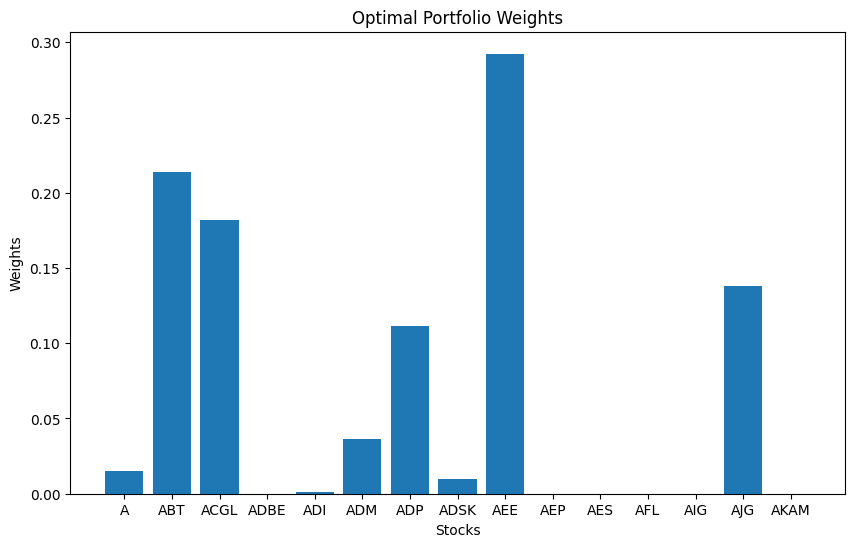

In [102]:

# Bar plot of optimal weights
plt.figure(figsize=(10, 6))
plt.bar(tickers, optimal_weights)
plt.title('Optimal Portfolio Weights')
plt.xlabel('Stocks')
plt.ylabel('Weights')
plt.show()

# Lets use large data

In [94]:
import yfinance as yf
import numpy as np
import pandas as pd
from scipy.optimize import minimize

# Load your CSV file into a DataFrame
# Example: data = pd.read_csv('your_data_file.csv')
# data = pd.read_csv('your_data_file.csv')

file_path = "/home/bathsheba/Downloads/stock_sample_data.xlsx"  # Adjust this to your file location
data = pd.read_csv(file_path, sep='\t')

# Strip whitespace from column names
data.columns = data.columns.str.strip()

# Print column names for debugging
print("DataFrame Columns:", data.columns.tolist())

# Check if 'context_id' exists and get unique tickers
if 'context_id' in data.columns:
    tickers = data['context_id'].unique().tolist()
else:
    raise KeyError("The 'context_id' column is not present in the DataFrame.")

# Print the unique tickers for verification
print("Unique Tickers:", tickers)

# Define the date range for fetching stock data
start_date = '2000-01-03'
end_date = '2010-06-25'

# Fetch adjusted close prices from Yahoo Finance
try:
    stock_data = yf.download(tickers, start=start_date, end=end_date)['Adj Close']
except Exception as e:
    print(f"Error fetching data: {e}")
    stock_data = pd.DataFrame()  # Empty DataFrame in case of error

# Ensure we have data before proceeding
if not stock_data.empty:
    # Calculate daily returns
    returns = stock_data.pct_change().dropna()

    # Portfolio performance function
    def portfolio_performance(weights, returns):
        portfolio_return = np.sum(weights * returns.mean()) * 252  # Annualized return
        portfolio_stddev = np.sqrt(np.dot(weights.T, np.dot(returns.cov() * 252, weights)))  # Annualized risk
        return portfolio_return, portfolio_stddev

    # Minimize volatility function
    def minimize_volatility(weights):
        return portfolio_performance(weights, returns)[1]

    # Constraints and bounds
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})  # Sum of weights = 1
    bounds = tuple((0, 1) for _ in range(len(tickers)))  # No short selling

    # Initial guess
    initial_weights = [1. / len(tickers)] * len(tickers)

    # Optimize
    optimal_results = minimize(minimize_volatility, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints)

    # Optimal weights
    optimal_weights = optimal_results.x
    print("Optimal Portfolio Weights: ", optimal_weights)
else:
    print("No stock data available for optimization.")


[                       0%                       ]

DataFrame Columns: ['date', 'open', 'high', 'low', 'close', 'volume', 'context_id', 'day']
Unique Tickers: ['A', 'AAPL', 'ABT', 'ACGL', 'ADBE', 'ADI', 'ADM', 'ADP', 'ADSK', 'AEE', 'AEP', 'AES', 'AFL', 'AIG', 'AJG', 'AKAM', 'ALB', 'ALL', 'AMAT', 'AMD', 'AME', 'AMGN', 'AMT', 'AMZN', 'ANSS', 'AON', 'AOS', 'APA', 'APD', 'APH', 'ARE', 'ATO', 'AVB', 'AVY', 'AXP', 'AZO', 'BA', 'BAC', 'BALL', 'BAX', 'BBWI', 'BBY', 'BDX', 'BEN', 'BF-B', 'BIIB', 'BK', 'BKNG', 'BKR', 'BLK', 'BMY', 'BRK-B', 'BRO', 'BSX', 'BWA', 'BXP', 'C', 'CAG', 'CAH', 'CAT', 'CB', 'CCI', 'CCL', 'CDNS', 'CHD', 'CHRW', 'CI', 'CINF', 'CL', 'CLX', 'CMCSA', 'CMI', 'CMS', 'CNP', 'COF', 'COO', 'COP', 'COR', 'COST', 'CPB', 'CPRT', 'CPT', 'CSCO', 'CSGP', 'CSX', 'CTAS', 'CTRA', 'CTSH', 'CVS', 'CVX', 'D', 'DD', 'DE', 'DECK', 'DGX', 'DHI', 'DHR', 'DIS', 'DLTR', 'DOC', 'DOV', 'DRI', 'DTE', 'DUK', 'DVA', 'DVN', 'EA', 'EBAY', 'ECL', 'ED', 'EFX', 'EG', 'EIX', 'EL', 'EMN', 'EMR', 'EOG', 'EQR', 'EQT', 'ERIE', 'ES', 'ESS', 'ETN', 'ETR', 'EVRG', 'E

[*********************100%***********************]  503 of 503 completed

68 Failed downloads:
['TRGP', 'PSX', 'CRWD', 'AMCR', 'CEG', 'PANW', 'ALLE', 'LW', 'NWS', 'SOLV', 'GDDY', 'SW', 'TSLA', 'UBER', 'CZR', 'PLTR', 'GEHC', 'NOW', 'MRNA', 'GEV', 'ABBV', 'HII', 'NCLH', 'OTIS', 'META', 'KVUE', 'PAYC', 'KMI', 'FANG', 'MPC', 'NXPI', 'EPAM', 'KKR', 'IQV', 'VST', 'HCA', 'DOW', 'ENPH', 'HWM', 'DELL', 'CFG', 'INVH', 'ANET', 'CTVA', 'NWSA', 'CDW', 'ZTS', 'DAY', 'PYPL', 'APTV', 'SYF', 'CTLT', 'CPAY', 'VLTO', 'CARR', 'FTV', 'IR', 'ABNB', 'HLT', 'FOX', 'VICI', 'KHC', 'KEYS', 'XYL', 'QRVO', 'HPE', 'GM', 'FOXA']: YFPricesMissingError('$%ticker%: possibly delisted; no price data found  (1d 2000-01-03 -> 2010-06-25) (Yahoo error = "Data doesn\'t exist for startDate = 946875600, endDate = 1277438400")')
/tmp/ipykernel_17033/3450279354.py:42: FutureWarning: The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA value

Optimal Portfolio Weights:  [0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807 0.00198807
 0.00198807 0.00198807 0.00198807 

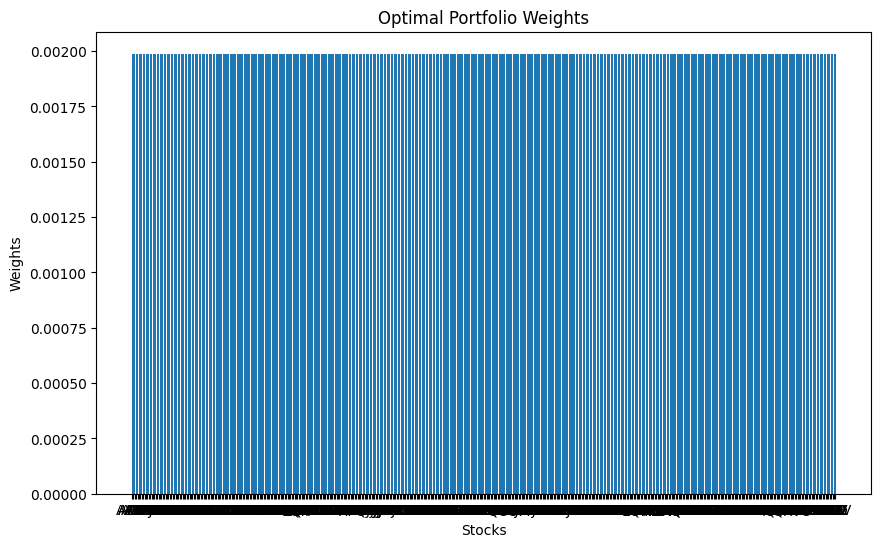

In [95]:
# Bar plot of optimal weights
plt.figure(figsize=(10, 6))
plt.bar(tickers, optimal_weights)
plt.title('Optimal Portfolio Weights')
plt.xlabel('Stocks')
plt.ylabel('Weights')
plt.show()


In [96]:
portfolio_return, portfolio_volatility = portfolio_performance(optimal_weights, returns)

print("Optimal Weights:")
for ticker, weight in zip(tickers, optimal_weights):
    print(f"{ticker}: {weight:.2%}")

print(f"\nExpected Portfolio Return: {portfolio_return:.2%}")
print(f"Expected Portfolio Volatility: {portfolio_volatility:.2%}")


Optimal Weights:
A: 0.20%
AAPL: 0.20%
ABT: 0.20%
ACGL: 0.20%
ADBE: 0.20%
ADI: 0.20%
ADM: 0.20%
ADP: 0.20%
ADSK: 0.20%
AEE: 0.20%
AEP: 0.20%
AES: 0.20%
AFL: 0.20%
AIG: 0.20%
AJG: 0.20%
AKAM: 0.20%
ALB: 0.20%
ALL: 0.20%
AMAT: 0.20%
AMD: 0.20%
AME: 0.20%
AMGN: 0.20%
AMT: 0.20%
AMZN: 0.20%
ANSS: 0.20%
AON: 0.20%
AOS: 0.20%
APA: 0.20%
APD: 0.20%
APH: 0.20%
ARE: 0.20%
ATO: 0.20%
AVB: 0.20%
AVY: 0.20%
AXP: 0.20%
AZO: 0.20%
BA: 0.20%
BAC: 0.20%
BALL: 0.20%
BAX: 0.20%
BBWI: 0.20%
BBY: 0.20%
BDX: 0.20%
BEN: 0.20%
BF-B: 0.20%
BIIB: 0.20%
BK: 0.20%
BKNG: 0.20%
BKR: 0.20%
BLK: 0.20%
BMY: 0.20%
BRK-B: 0.20%
BRO: 0.20%
BSX: 0.20%
BWA: 0.20%
BXP: 0.20%
C: 0.20%
CAG: 0.20%
CAH: 0.20%
CAT: 0.20%
CB: 0.20%
CCI: 0.20%
CCL: 0.20%
CDNS: 0.20%
CHD: 0.20%
CHRW: 0.20%
CI: 0.20%
CINF: 0.20%
CL: 0.20%
CLX: 0.20%
CMCSA: 0.20%
CMI: 0.20%
CMS: 0.20%
CNP: 0.20%
COF: 0.20%
COO: 0.20%
COP: 0.20%
COR: 0.20%
COST: 0.20%
CPB: 0.20%
CPRT: 0.20%
CPT: 0.20%
CSCO: 0.20%
CSGP: 0.20%
CSX: 0.20%
CTAS: 0.20%
CTRA: 0.20%
CTSH: 0.

# API

In [103]:
!pip install Flask


In [ ]:
from flask import Flask, request, jsonify
import numpy as np

app = Flask(__name__)

# Dummy optimization function (replace with actual optimization code)
def optimize_portfolio(tickers):
    # Example of an optimization function that returns weights for the given tickers
    # You should replace this with your actual optimization logic.
    num_tickers = len(tickers)
    # Generate random weights as an example (replace with real portfolio weights)
    weights = np.random.dirichlet(np.ones(num_tickers), size=1)[0]
    return dict(zip(tickers, weights))

# Define the route for optimization
@app.route('/optimize', methods=['POST'])
def get_optimal_portfolio():
    try:
        # Get the data (list of tickers) from the POST request
        data = request.json
        tickers = data.get('tickers', [])
        
        if not tickers:
            return jsonify({"error": "Tickers list is missing"}), 400
        
        # Get optimized portfolio weights
        portfolio_weights = optimize_portfolio(tickers)
        
        # Return the result as JSON
        return jsonify({
            "tickers": tickers,
            "weights": portfolio_weights
        }), 200
    except Exception as e:
        return jsonify({"error": str(e)}), 500

# Run the app
if __name__ == '__main__':
    app.run(host='0.0.0.0', port=5000)


 * Serving Flask app '__main__'
 * Debug mode: off


 * Running on all addresses (0.0.0.0)
 * Running on http://127.0.0.1:5000
 * Running on http://192.168.1.101:5000
Press CTRL+C to quit
127.0.0.1 - - [22/Oct/2024 17:40:35] "GET /your_endpoint_here HTTP/1.1" 404 -
127.0.0.1 - - [22/Oct/2024 17:54:25] "POST /optimize HTTP/1.1" 500 -
127.0.0.1 - - [22/Oct/2024 17:54:39] "POST /optimize HTTP/1.1" 200 -
127.0.0.1 - - [22/Oct/2024 18:07:03] "POST /optimize HTTP/1.1" 200 -


In [ ]:
import requests

# Replace with your local server URL (same as the one your Flask app is running on)
url = 'http://192.168.1.101:5000/optimize'

# Example list of tickers (you can adjust the tickers to what your API expects)
data = {
    'tickers': ['AAPL', 'GOOGL', 'MSFT', 'AMZN', 'FB']  # List of stock tickers
}

# Send POST request
response = requests.post(url, json=data)

# Check if the request was successful
if response.status_code == 200:
    # Get the response (optimized portfolio weights)
    print(response.json())  # Print the portfolio weights received from the API
else:
    # Print the error if the request was not successful
    print(f"Error: {response.status_code}")
    print(response.text)


In [ ]:

import requests
import json

# Define the API endpoint
url = 'http://127.0.0.1:5000/optimize'

# Prepare the data you want to send (this should match the expected input of your API)
data = {
    'tickers': ['ABT', 'ACGL', 'ADBE', 'ADI', 'ADM', 'ADP', 'ADSK', 'AEE', 'AEP', 'AES', 'AFL', 'AIG', 'AJG', 'AKAM']
}

# Send a POST request to the Flask API
response = requests.post(url, json=data)

# Check if the request was successful
if response.status_code == 200:
    # Parse the JSON response
    output = response.json()
    print("Response from API:", output)
else:
    print("Error:", response.status_code, response.text)


In [ ]:
if response.status_code == 200:
    output = response.json()
    print("Response from API:", output)
else:
    print("Error:", response.status_code, response.text)



In [2]:
import requests
import json

# Define the API endpoint
url = 'http://127.0.0.1:5000/optimize'

# Prepare the data you want to send (this should match the expected input of your API)
data = {
    'tickers': ['ABT', 'ACGL']
}

# Send a POST request to the Flask API
response = requests.post(url, json=data)

# Check if the request was successful
if response.status_code == 200:
    # Parse the JSON response
    output = response.json()
    print("Response from API:", output)
else:
    print("Error:", response.status_code, response.text)


Response from API: {'tickers': ['ABT', 'ACGL'], 'weights': {'ABT': 0.5, 'ACGL': 0.5}}


# Use larger quantity for tickers

In [4]:
pip install yfinance Flask numpy pandas scipy


Note: you may need to restart the kernel to use updated packages.


In [3]:
import numpy as np
import pandas as pd
import yfinance as yf
from flask import Flask, request, jsonify
from scipy.optimize import minimize

app = Flask(__name__)

def fetch_data(tickers):
    # Fetch historical stock prices for the last year
    data = yf.download(tickers, period='1y')['Adj Close']
    # Calculate daily returns
    returns = data.pct_change().dropna()
    return returns

def calculate_optimal_weights(returns, budget):
    # Number of assets (stocks)
    num_assets = len(returns.columns)
    
    # Calculate expected returns and covariance matrix
    expected_returns = returns.mean()
    covariance_matrix = returns.cov()

    # Define the objective function to minimize (negative Sharpe ratio)
    def objective(weights):
        portfolio_return = np.dot(weights, expected_returns)  # Expected return of the portfolio
        portfolio_variance = np.dot(weights.T, np.dot(covariance_matrix, weights))  # Portfolio variance
        return -portfolio_return / np.sqrt(portfolio_variance)  # Maximize the Sharpe ratio

    # Constraints: weights must sum to 1
    constraints = {'type': 'eq', 'fun': lambda weights: np.sum(weights) - 1}
    # Bounds for weights (each weight must be between 0 and 1)
    bounds = tuple((0, 1) for _ in range(num_assets))

    # Initial guess (equal distribution)
    initial_weights = [1.0 / num_assets] * num_assets

    # Optimization
    result = minimize(objective, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints)

    # Scale the weights according to the initial budget
    scaled_weights = result.x * budget  # Scale the weights to the budget
    return scaled_weights

@app.route('/optimize', methods=['POST'])
def optimize_portfolio():
    data = request.json
    tickers = data['tickers']
    budget = data['budget']  # Get the budget from the request data
    
    # Fetch stock data and calculate returns
    returns = fetch_data(tickers)
    
    # Calculate optimal weights scaled to the budget
    optimal_weights = calculate_optimal_weights(returns, budget)
    
    # Create a response with weights
    weights_dict = {tickers[i]: optimal_weights[i] for i in range(len(tickers))}
    return jsonify({'tickers': tickers, 'weights': weights_dict})

if __name__ == '__main__':
    app.run(debug=True)


 * Serving Flask app '__main__'
 * Debug mode: on


 * Running on http://127.0.0.1:5000
Press CTRL+C to quit
 * Restarting with stat
0.00s - Debugger warning: It seems that frozen modules are being used, which may
0.00s - make the debugger miss breakpoints. Please pass -Xfrozen_modules=off
0.00s - to python to disable frozen modules.
0.00s - Note: Debugging will proceed. Set PYDEVD_DISABLE_FILE_VALIDATION=1 to disable this validation.
Traceback (most recent call last):
  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "/home/bathsheba/anaconda3/lib/python3.12/site-packages/ipykernel_launcher.py", line 17, in <module>
    app.launch_new_instance()
  File "/home/bathsheba/anaconda3/lib/python3.12/site-packages/traitlets/config/application.py", line 1074, in launch_instance
    app.initialize(argv)
  File "/home/bathsheba/anaconda3/lib/python3.12/site-packages/traitlets/config/application.py", line 118, in inner
    return method(app, *args, **kwargs)
           ^^^^^^^^^^^^^^^^

SystemExit: 1